# Soccer Prediction Analysis Using Bayesian Statistics and Time Series Analysis

This notebook aims to analyze and predict soccer match outcomes using Bayesian statistics and time series analysis. We will load historical match data, preprocess it, and segment it into meaningful time periods for further analysis.


## 1. Introduction
### 1.1 Overview
This notebook presents an in-depth analysis of English Premier League (EPL) data spanning from 1993 to 2024. The primary objective is to develop a predictive model using Bayesian hierarchical methods, with a focus on analyzing home and away goals. Although the dataset contains numerous columns, this study specifically concentrates on these two critical variables to understand and model goal distributions effectively.

The methodology employed is a Bayesian hierarchical model, which allows for the incorporation of prior knowledge and the modeling of complex data structures. This approach is particularly suited to capturing the inherent variability and uncertainty in sports outcomes. This analysis forms a significant part of my master’s thesis, where the goal is not only to predict future matches but also to gain deeper insights into the factors influencing goal outcomes in football.

### 1.2 Packages and Libraries

In this section, we import the essential libraries and packages required for data manipulation, statistical analysis, and model development. These libraries are crucial for handling the dataset, performing exploratory data analysis, and building the Bayesian hierarchical model used in this study.

#### 1.2.1 Importing Necessary Libraries

The following libraries are imported:

- **`pymc` and `arviz`**: Used for probabilistic programming and Bayesian analysis, enabling the construction and evaluation of the hierarchical model.
- **`math`, `numpy`, and `pandas`**: Fundamental libraries for numerical computations and data manipulation.
- **`scipy` and its submodules**: Provides a suite of statistical functions and distributions, which are essential for performing various statistical tests and calculations.
- **`matplotlib` and `seaborn`**: Utilized for data visualization, allowing for the graphical representation of the dataset and model results.
- **`scikit-learn`**: Employed for basic machine learning tasks, including model evaluation metrics like accuracy and mean squared error.
- **`os` and `csv`**: Used for handling file operations, such as reading and writing data files.

This combination of libraries provides a robust foundation for the analysis and modeling tasks carried out in this notebook.


In [ ]:
import pymc as pm
import arviz as az
import math
import pandas as pd
import numpy as np
from scipy import stats
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
import seaborn as sns
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import mean_absolute_error, mean_squared_error,accuracy_score
from sklearn.metrics import roc_auc_score, roc_curve,auc
import scipy.stats as stats
from scipy.stats import sem  # Standard Error of the Mean
from scipy.stats import norm, uniform, poisson  # For statistical functions
import os
import csv
import gc #clenaning envoinment
from tabulate import tabulate
gc.collect()

0

## 2. Data Preparation and Exploration

### 2.1 Dataset Path Setup

In this section, we define the base path to the dataset folder, list the filenames of the season data, and specify the columns of interest that will be used in the analysis.


In [3]:
# the base path to the dataset folder
base_path = "/Users/bymatchi/Documents/Thesis"
datasetFolder = os.path.join(base_path, "EPL")

# List of season filenames to load
season_files = [
    'PL_93_94.csv', 'PL_94_95.csv', 'PL_95_96.csv', 'PL_96_97.csv',
    'PL_97_98.csv', 'PL_98_99.csv', 'PL_99_00.csv', 'PL_00_01.csv',
    'PL_01_02.csv', 'PL_02_03.csv', 'PL_03_04.csv', 'PL_04_05.csv',
    'PL_05_06.csv', 'PL_06_07.csv', 'PL_07_08.csv', 'PL_08_09.csv',
    'PL_09_10.csv', 'PL_10_11.csv', 'PL_11_12.csv', 'PL_12_13.csv',
    'PL_13_14.csv', 'PL_14_15.csv', 'PL_15_16.csv', 'PL_16_17.csv',
    'PL_17_18.csv', 'PL_18_19.csv', 'PL_19_20.csv', 'PL_20_21.csv',
    'PL_21_22.csv', 'PL_22_23.csv','PL_23_24.csv'
]
# The features we want to exemine
columns_of_interest = ['Date', 'HomeTeam', 'AwayTeam', 'FTHG', 'FTAG', 'FTR']

### 2.2 Looking at the Structure of the Data

Before loading all the seasons, I take a preliminary look at the structure of the most recent season's data (`PL_23_24.csv`). This includes checking the first few rows, understanding the dimensions, and examining the columns, data types, and summary statistics.


In [4]:
def load_and_summarize_single_season(filename, datasetFolder, columns_of_interest):
    # Load the dataset with specified columns only
    file_path = os.path.join(datasetFolder, filename)
    df = pd.read_csv(file_path, usecols=columns_of_interest)
    
    print(f"\n2.2.1 Summary of Initial Findings for {filename}")
    print("=" * 50)

    # Dataset structure
    print(f"\nDataset Structure: The dataset contains {df.shape[0]} rows and {df.shape[1]} columns, focusing on key features.")

    # Column information
    print(f"\nColumns of Interest: {', '.join(columns_of_interest)}")

    # Data types
    print("\nData Types:")
    print(df.dtypes)

    # Summary statistics for the columns of interest
    print("\nSummary Statistics:")
    print(df.describe(include='all'))

    # Null values information
    print("\nNull Values in Each Column:")
    print(df.isnull().sum())

    # Unique values count for each column of interest
    print("\nUnique Values in Each Column:")
    for column in columns_of_interest:
        unique_values = df[column].unique()
        num_unique = len(unique_values)
        print(f"Column '{column}' has {num_unique} unique values.")

    # Check for duplicates within columns of interest
    num_duplicates = df.duplicated().sum()
    print(f"\nNumber of Duplicate Rows: {num_duplicates}")

    return df


columns_of_interest = ['Date', 'HomeTeam', 'AwayTeam', 'FTHG', 'FTAG', 'FTR']
df_23_24 = load_and_summarize_single_season("PL_23_24.csv", datasetFolder, columns_of_interest)



2.2.1 Summary of Initial Findings for PL_23_24.csv

Dataset Structure: The dataset contains 380 rows and 6 columns, focusing on key features.

Columns of Interest: Date, HomeTeam, AwayTeam, FTHG, FTAG, FTR

Data Types:
Date        object
HomeTeam    object
AwayTeam    object
FTHG         int64
FTAG         int64
FTR         object
dtype: object

Summary Statistics:
              Date HomeTeam  AwayTeam        FTHG        FTAG  FTR
count          380      380       380  380.000000  380.000000  380
unique         120       20        20         NaN         NaN    3
top     19/05/2024  Burnley  Man City         NaN         NaN    H
freq            10       19        19         NaN         NaN  175
mean           NaN      NaN       NaN    1.800000    1.478947  NaN
std            NaN      NaN       NaN    1.365616    1.277811  NaN
min            NaN      NaN       NaN    0.000000    0.000000  NaN
25%            NaN      NaN       NaN    1.000000    1.000000  NaN
50%            NaN      NaN 

#### 2.2.1 Summary of Initial Findings

The preliminary analysis of the `PL_23_24.csv` dataset reveals the following key points:

- **Dataset Structure**: The dataset contains 380 rows and 106 columns, indicating it covers a full season of matches with a comprehensive set of features.
- **Columns of Interest**: Key columns such as `Date`, `HomeTeam`, `AwayTeam`, `FTHG` (Full-Time Home Goals), `FTAG` (Full-Time Away Goals), and `FTR` (Full-Time Result) are present and correctly formatted. These will be crucial for the subsequent analysis.
- **Data Types**: Most columns are of type `object`, with numerical columns appropriately formatted as `int64` or `float64`. This suggests that the data is clean and ready for processing without major type conversion issues.
- **Summary Statistics**: The statistics show a typical distribution of goals, with the mean goals scored by home teams (`FTHG`) being slightly higher than that of away teams (`FTAG`). The dataset includes a variety of betting odds and other match-related data, which could provide valuable insights if included in the analysis.
- **Missing and Duplicate Data**: There are minimal missing values, specifically in some betting odds columns (`MaxCAHH`, `MaxCAHA`). No duplicate rows are present, which confirms the dataset's integrity for the 2023-2024 season.
- **Unique Values**: The dataset includes a reasonable diversity of values in key columns like `HomeTeam`, `AwayTeam`, and `Referee`, which ensures a wide range of match data is covered.

These findings confirm that the dataset is well-structured and suitable for the planned Bayesian analysis. However, the presence of a large number of columns suggests that careful feature selection will be necessary to focus the analysis on the most relevant data.


#### 2.2.1 Load Single Season Data

This function loads data for a single season, keeping only the specified columns of interest. It handles potential issues such as encoding errors and missing values, and it returns a cleaned DataFrame ready for analysis.


In [5]:
def load_single_season_data(filename, datasetFolder, cols_to_keep):
    """
    Loads a single season's data, retaining only specified columns.
    """
    file_path = os.path.join(datasetFolder, filename)
    try:
        # Attempt to read the CSV file with default encoding
        df = pd.read_csv(file_path, usecols=cols_to_keep)
        df.dropna(how='all', inplace=True)  # Remove rows that are completely empty
        num_matches = df.shape[0]
        null_counts = df.isnull().sum()
        null_summary = ", ".join([f"{col}: {count}" for col, count in null_counts.items() if count > 0])
        
        # Print concise summary for each season
        print(f"{filename} - Rows: {num_matches}, Columns of Interest: {len(cols_to_keep)}, Nulls: {null_summary or 'None'}")
        
        return df
    except UnicodeDecodeError:
        print(f"{filename}: Unicode error, attempting with 'latin1' encoding.")
        try:
            df = pd.read_csv(file_path, encoding='latin1', usecols=cols_to_keep)
            df.dropna(how='all', inplace=True)
            num_matches = df.shape[0]
            null_counts = df.isnull().sum()
            null_summary = ", ".join([f"{col}: {count}" for col, count in null_counts.items() if count > 0])
            
            print(f"{filename} - Rows: {num_matches}, Columns of Interest: {len(cols_to_keep)}, Nulls: {null_summary or 'None'} (latin1)")
            
            return df
        except Exception as e:
            print(f"{filename}: Error loading with 'latin1' - {e}")
            return None
    except FileNotFoundError:
        print(f"{filename}: File not found.")
        return None
    except Exception as e:
        print(f"{filename}: Error loading - {e}")
        return None


#### 2.2.3 Load All Seasons Data

This function loads all the season files into a dictionary of DataFrames. Each DataFrame corresponds to a single season, and the dictionary keys are the season names extracted from the filenames.


In [6]:
def load_all_seasons_to_dict(season_files, datasetFolder, cols_to_keep):
    """
    Loads all season files into a dictionary of dataframes.
    """
    all_seasons_data = {}
    for file in season_files:
        season_name = file.split('.')[0]  # Extract the season name from the filename
        df = load_single_season_data(file, datasetFolder, cols_to_keep)
        if df is not None:
            all_seasons_data[season_name] = df
    return all_seasons_data

# Load all season data
all_seasons_data = load_all_seasons_to_dict(season_files, datasetFolder, columns_of_interest)

PL_93_94.csv - Rows: 462, Columns of Interest: 6, Nulls: None
PL_94_95.csv - Rows: 462, Columns of Interest: 6, Nulls: None
PL_95_96.csv - Rows: 380, Columns of Interest: 6, Nulls: None
PL_96_97.csv - Rows: 380, Columns of Interest: 6, Nulls: None
PL_97_98.csv - Rows: 380, Columns of Interest: 6, Nulls: None
PL_98_99.csv - Rows: 380, Columns of Interest: 6, Nulls: None
PL_99_00.csv - Rows: 380, Columns of Interest: 6, Nulls: None
PL_00_01.csv - Rows: 380, Columns of Interest: 6, Nulls: None
PL_01_02.csv - Rows: 380, Columns of Interest: 6, Nulls: None
PL_02_03.csv - Rows: 380, Columns of Interest: 6, Nulls: None
PL_03_04.csv - Rows: 380, Columns of Interest: 6, Nulls: None
PL_04_05.csv: Unicode error, attempting with 'latin1' encoding.
PL_04_05.csv - Rows: 380, Columns of Interest: 6, Nulls: None (latin1)
PL_05_06.csv - Rows: 380, Columns of Interest: 6, Nulls: None
PL_06_07.csv - Rows: 380, Columns of Interest: 6, Nulls: None
PL_07_08.csv - Rows: 380, Columns of Interest: 6, Nulls: No

#### 2.2.4 Data Explanation

The key columns of interest (`Date`, `HomeTeam`, `AwayTeam`, `FTHG`, `FTAG`, `FTR`) were previously explained in the analysis of the `PL_23_24.csv` dataset. These columns remain consistent across all seasons and will be used for further analysis.
#### 2.2.5 Number of Teams in EPL per Year

Historically, the English Premier League has seen changes in the number of teams participating each season. Originally, the league aimed to reduce the number of clubs to 20 to promote development and excellence at both club and international levels. This reduction was achieved at the end of the 1994/95 season when four clubs were relegated, and only two were promoted. 

This historical context implies that:

- Seasons before 1995/96 should have 462 matches if complete.
- Seasons from 1995/96 onwards should have 380 matches.




#### 2.3 Checking Date Formats in Each Season's Data

In this section, we inspect the date formats across each season's data to identify any discrepancies. Consistent date formatting is crucial for accurate time-based analysis. The inspection reveals how the date is recorded in each dataset, which helps us to standardize the format before proceeding with further analysis.

In [7]:
def print_date_columns(dataframes):
    """
    Prints the first 'Date' value of each DataFrame in the dictionary in a single-line format.
    """
    date_info = []
    for season_name, df in dataframes.items():
        first_date = df['Date'].iloc[0] if not df.empty else "No Data"
        date_info.append(f"{season_name}: {first_date}")
    
    # Print all date information in a single line
    print(" | ".join(date_info))

# Applying the function
print_date_columns(all_seasons_data)


PL_93_94: 14/08/93 | PL_94_95: 20/08/94 | PL_95_96: 19/08/95 | PL_96_97: 17/08/96 | PL_97_98: 09/08/97 | PL_98_99: 15/08/98 | PL_99_00: 07/08/99 | PL_00_01: 19/08/00 | PL_01_02: 18/08/01 | PL_02_03: 17/08/2002 | PL_03_04: 16/08/03 | PL_04_05: 14/08/04 | PL_05_06: 13/08/05 | PL_06_07: 19/08/06 | PL_07_08: 11/08/07 | PL_08_09: 16/08/08 | PL_09_10: 15/08/09 | PL_10_11: 14/08/10 | PL_11_12: 13/08/11 | PL_12_13: 18/08/12 | PL_13_14: 17/08/13 | PL_14_15: 16/08/14 | PL_15_16: 08/08/2015 | PL_16_17: 13/08/16 | PL_17_18: 11/08/2017 | PL_18_19: 10/08/2018 | PL_19_20: 09/08/2019 | PL_20_21: 12/09/2020 | PL_21_22: 13/08/2021 | PL_22_23: 05/08/2022 | PL_23_24: 11/08/2023


### 2.4 Standardizing Date Format
The `Date` column has inconsistencies: some entries are in `DD/MM/YYYY`, others in `DD/MM/YY`, all with unnecessary `00:00:00` time stamps.

**Goal**: Create a function to convert all dates to `YYYY-MM-DD`, removing time components for consistency.


In [8]:
def correct_date_format(df):
    """
    Corrects the 'Date' column format in the DataFrame by detecting the date format
    and converting it to datetime.
    """
    # Define a function to detect and parse each date
    def parse_date(date_str):
        for fmt in ('%d/%m/%Y', '%d/%m/%y'):
            try:
                return pd.to_datetime(date_str, format=fmt, dayfirst=True)
            except ValueError:
                continue
        # If both formats fail, return NaT
        return pd.NaT

    # Apply the parse_date function to the 'Date' column
    df['Date'] = df['Date'].apply(parse_date)
    return df

# Applying date correction to all seasons
for season_name, df in all_seasons_data.items():
    all_seasons_data[season_name] = correct_date_format(df)
    
# Check if all date formats are in datetime
all_dates_converted = all(df['Date'].dtype == 'datetime64[ns]' for df in all_seasons_data.values())
print("All dates converted to datetime format:\n", all_dates_converted)

all_seasons_data['PL_03_04'].head() 


All dates converted to datetime format:
 True


,Date,HomeTeam,AwayTeam,FTHG,FTAG,FTR
0,2003-08-16,Arsenal,Everton,2,1,H
1,2003-08-16,Birmingham,Tottenham,1,0,H
2,2003-08-16,Blackburn,Wolves,5,1,H
3,2003-08-16,Fulham,Middlesbrough,3,2,H
4,2003-08-16,Leicester,Southampton,2,2,D


### 2.5 Assigning Unique Season IDs to Each Premier League Season Dataset

In this section, each season’s data is assigned a unique `Season_ID`, which is critical for distinguishing between seasons when the data is combined into a single DataFrame.

In [9]:
def assign_season_id(season_dataframes):
    season_id_mapping = {season_name: idx + 1 for idx, season_name in enumerate(season_dataframes)}
    print("Season ID mapping:", season_id_mapping)  # Debugging line to verify mapping

    for season_name, df in season_dataframes.items():
        df = df.copy()  # Avoid SettingWithCopyWarning
        df['Season_ID'] = season_id_mapping[season_name]
        season_dataframes[season_name] = df
    
    return season_dataframes
# Applying the function all seasons
season_dataframes = assign_season_id(all_seasons_data)
print(all_seasons_data['PL_23_24'].shape)
print(all_seasons_data['PL_23_24'].head())

Season ID mapping: {'PL_93_94': 1, 'PL_94_95': 2, 'PL_95_96': 3, 'PL_96_97': 4, 'PL_97_98': 5, 'PL_98_99': 6, 'PL_99_00': 7, 'PL_00_01': 8, 'PL_01_02': 9, 'PL_02_03': 10, 'PL_03_04': 11, 'PL_04_05': 12, 'PL_05_06': 13, 'PL_06_07': 14, 'PL_07_08': 15, 'PL_08_09': 16, 'PL_09_10': 17, 'PL_10_11': 18, 'PL_11_12': 19, 'PL_12_13': 20, 'PL_13_14': 21, 'PL_14_15': 22, 'PL_15_16': 23, 'PL_16_17': 24, 'PL_17_18': 25, 'PL_18_19': 26, 'PL_19_20': 27, 'PL_20_21': 28, 'PL_21_22': 29, 'PL_22_23': 30, 'PL_23_24': 31}
(380, 7)
        Date     HomeTeam       AwayTeam  FTHG  FTAG FTR  Season_ID
0 2023-08-11      Burnley       Man City     0     3   A         31
1 2023-08-12      Arsenal  Nott'm Forest     2     1   H         31
2 2023-08-12  Bournemouth       West Ham     1     1   D         31
3 2023-08-12     Brighton          Luton     4     1   H         31
4 2023-08-12      Everton         Fulham     0     1   A         31


### 2.6 Function to Clean and Enrich Data

This function performs various data cleaning and enrichment tasks, such as renaming columns, extracting date components, converting goal counts to integers, and mapping match results to numerical values. This prepares the data for deeper analysis and modeling.


In [10]:
def clean_and_enrich_data(df, season_name):
    if df.empty:
        print(f"{season_name}: DataFrame is empty, skipping.")
        return

    rename_dict = {
        'HomeTeam': 'Home_Team',
        'AwayTeam': 'Away_Team',
        'FTHG': 'Home_Goals',
        'FTAG': 'Away_Goals',
        'FTR': 'Result'
    }
    df.rename(columns=rename_dict, inplace=True)

    df['Day'] = df['Date'].dt.day
    df['Month'] = df['Date'].dt.month
    df['Year'] = df['Date'].dt.year

    df['Total_Goals'] = df['Home_Goals'] + df['Away_Goals']

    result_mapping = {'H': 1, 'D': 0, 'A': 2}
    df['Result'] = df['Result'].map(result_mapping)

    dtype_optimizations = {
        'Home_Goals': 'int16',
        'Away_Goals': 'int16',
        'Total_Goals': 'int16',
        'Result': 'int8',
        'Day': 'int8',
        'Month': 'int8',
        'Year': 'int16',
        'Season_ID': 'int8'  
    }
    df = df.astype(dtype_optimizations)

    df = df[['Date', 'Home_Team', 'Away_Team', 'Home_Goals', 'Away_Goals',
             'Total_Goals', 'Result', 'Day', 'Month', 'Year', 'Season_ID']]

    return df

# Apply the clean and enrich function across all seasons
for season_name, df in all_seasons_data.items():
    all_seasons_data[season_name] = clean_and_enrich_data(df, season_name)

# Check the first few rows of specific seasons to verify the results

print(all_seasons_data['PL_93_94'].head(),all_seasons_data['PL_93_94'].shape)
print(all_seasons_data['PL_23_24'].head(),all_seasons_data['PL_23_24'].shape)


        Date    Home_Team       Away_Team  Home_Goals  Away_Goals  \
0 1993-08-14      Arsenal        Coventry           0           3   
1 1993-08-14  Aston Villa             QPR           4           1   
2 1993-08-14      Chelsea       Blackburn           1           2   
3 1993-08-14    Liverpool  Sheffield Weds           2           0   
4 1993-08-14     Man City           Leeds           1           1   

   Total_Goals  Result  Day  Month  Year  Season_ID  
0            3       2   14      8  1993          1  
1            5       1   14      8  1993          1  
2            3       2   14      8  1993          1  
3            2       1   14      8  1993          1  
4            2       0   14      8  1993          1   (462, 11)
        Date    Home_Team      Away_Team  Home_Goals  Away_Goals  Total_Goals  \
0 2023-08-11      Burnley       Man City           0           3            3   
1 2023-08-12      Arsenal  Nott'm Forest           2           1            3   
2 2023-0

### 2.7 Combine All Seasons into a Single DataFrame and Copy DataFrame for Analysis

Here, all the cleaned and enriched season DataFrames are combined into one comprehensive DataFrame. This unified dataset will be used for the main analysis.


In [11]:
# Combine all season DataFrames into a single DataFrame
all_seasons_combined = pd.concat(all_seasons_data.values(), ignore_index=True)

# Copy the combined DataFrame to a new DataFrame named df
df = all_seasons_combined.copy()

# Print the first few rows of the new DataFrame to verify
print(df.head())
print(f"Copied DataFrame shape: {df.shape}")


        Date    Home_Team       Away_Team  Home_Goals  Away_Goals  \
0 1993-08-14      Arsenal        Coventry           0           3   
1 1993-08-14  Aston Villa             QPR           4           1   
2 1993-08-14      Chelsea       Blackburn           1           2   
3 1993-08-14    Liverpool  Sheffield Weds           2           0   
4 1993-08-14     Man City           Leeds           1           1   

   Total_Goals  Result  Day  Month  Year  Season_ID  
0            3       2   14      8  1993          1  
1            5       1   14      8  1993          1  
2            3       2   14      8  1993          1  
3            2       1   14      8  1993          1  
4            2       0   14      8  1993          1  
Copied DataFrame shape: (11944, 11)


### 2.8 Data Segmentation 
For specific analyses, seasons are grouped into 5-year segments. This segmentation can help in analyzing trends over shorter time periods while keeping the data manageable.


In [12]:
# 5-year segmentation
df_93_98 = df[(df['Season_ID'] >= 1) & (df['Season_ID'] <= 5)]
df_98_03 = df[(df['Season_ID'] >= 6) & (df['Season_ID'] <= 10)]
df_03_08 = df[(df['Season_ID'] >= 11) & (df['Season_ID'] <= 15)]
df_08_13 = df[(df['Season_ID'] >= 16) & (df['Season_ID'] <= 20)]
df_13_18 = df[(df['Season_ID'] >= 21) & (df['Season_ID'] <= 25)]
df_18_23 = df[(df['Season_ID'] >= 26) & (df['Season_ID'] <= 30)]
df_18_24 = df[(df['Season_ID'] >= 26) & (df['Season_ID'] <= 31)]  
df_23_24 = df[df['Season_ID'] == 31]  # last season

# 10-year segmentation
df_93_03 = df[(df['Season_ID'] >= 1) & (df['Season_ID'] <= 10)]
df_03_13 = df[(df['Season_ID'] >= 11) & (df['Season_ID'] <= 20)]
df_13_23 = df[(df['Season_ID'] >= 21) & (df['Season_ID'] <= 30)]
df_13_24 = df[(df['Season_ID'] >= 21) & (df['Season_ID'] <= 31)]

# Print the shapes of the segments to verify
print(f"5-year segment 1993-1998 shape: {df_93_98.shape}")
print(f"5-year segment 1998-2003 shape: {df_98_03.shape}")
print(f"5-year segment 2003-2008 shape: {df_03_08.shape}")
print(f"5-year segment 2008-2013 shape: {df_08_13.shape}")
print(f"5-year segment 2013-2018 shape: {df_13_18.shape}")
print(f"5-year segment 2018-2023 shape: {df_18_23.shape}")
print(f"5-year segment 2018-2023 shape: {df_18_24.shape}")
print(f"Last season 2023-2024 shape: {df_23_24.shape}")
print(f"10-year segment 1993-2003 shape: {df_93_03.shape}")
print(f"10-year segment 2003-2013 shape: {df_03_13.shape}")
print(f"10-year segment 2013-2023 shape: {df_13_23.shape}")
print(f"10-year segment 2013-2024 shape: {df_13_24.shape}")

5-year segment 1993-1998 shape: (2064, 11)
5-year segment 1998-2003 shape: (1900, 11)
5-year segment 2003-2008 shape: (1900, 11)
5-year segment 2008-2013 shape: (1900, 11)
5-year segment 2013-2018 shape: (1900, 11)
5-year segment 2018-2023 shape: (1900, 11)
5-year segment 2018-2023 shape: (2280, 11)
Last season 2023-2024 shape: (380, 11)
10-year segment 1993-2003 shape: (3964, 11)
10-year segment 2003-2013 shape: (3800, 11)
10-year segment 2013-2023 shape: (3800, 11)
10-year segment 2013-2024 shape: (4180, 11)


### 2.9 Assigning Unique Team ID for each team

In [13]:
# Function to assign unique team IDs within each segment
def assign_team_ids_segment(segment):
    """
    Assigns unique IDs to teams in each segment independently.
    The IDs start from 1 for each segment.
    """
    # Combine unique team names from both Home and Away columns
    unique_teams = pd.concat([segment['Home_Team'], segment['Away_Team']]).unique()
    team_name_to_id = {team_name: idx for idx, team_name in enumerate(unique_teams)}
    
    # Map team names to the newly assigned team IDs
    segment = segment.copy()  # Ensure we're not modifying the original segment directly
    segment['Home_Team_ID'] = segment['Home_Team'].map(team_name_to_id)
    segment['Away_Team_ID'] = segment['Away_Team'].map(team_name_to_id)
    
    return segment

# Function to reassign Season_ID within each segment starting from 1
def reassign_season_id_segment(segment):
    """
    Reassigns Season_ID in each segment starting from 1.
    This is useful for time-dependent models where the starting season should be 1 in each segment.
    """
    # Get unique season IDs in the segment and map them starting from 1
    unique_seasons = sorted(segment['Season_ID'].unique())
    season_id_mapping = {season_id: idx + 1 for idx, season_id in enumerate(unique_seasons)}
    
    # Apply the new Season_ID mapping to the segment
    segment = segment.copy()  # Create an independent copy of the segment
    segment['Season_ID'] = segment['Season_ID'].map(season_id_mapping)
    return segment


#  Apply the function assing team ids for all seaon df (All 31 seaons)
df = assign_team_ids_segment(df)

# Apply both functions to each segment to ensure unique team IDs and sequential Season_IDs
df_93_98 = assign_team_ids_segment(reassign_season_id_segment(df_93_98))
df_98_03 = assign_team_ids_segment(reassign_season_id_segment(df_98_03))
df_03_08 = assign_team_ids_segment(reassign_season_id_segment(df_03_08))
df_08_13 = assign_team_ids_segment(reassign_season_id_segment(df_08_13))
df_13_18 = assign_team_ids_segment(reassign_season_id_segment(df_13_18))
df_18_23 = assign_team_ids_segment(reassign_season_id_segment(df_18_23))
df_18_24 = assign_team_ids_segment(reassign_season_id_segment(df_18_24))
df_23_24 = assign_team_ids_segment(reassign_season_id_segment(df_23_24)) # Last seson..
df_93_03 = assign_team_ids_segment(reassign_season_id_segment(df_93_03))
df_03_13 = assign_team_ids_segment(reassign_season_id_segment(df_03_13))
df_13_23 = assign_team_ids_segment(reassign_season_id_segment(df_13_23))
df_13_24 = assign_team_ids_segment(reassign_season_id_segment(df_13_24))

# Check the operation for one season.
print(df_18_23.head(),df_18_23.shape)

home_team_id_dict = dict(zip(df_93_98['Home_Team'], df_93_98['Home_Team_ID']))
print("Home Team ID Mapping:", home_team_id_dict)
print()
# Away_Team and Away_Team_ID 
away_team_id_dict = dict(zip(df_93_98['Away_Team'], df_93_98['Away_Team_ID']))
print("Away Team ID Mapping:", away_team_id_dict)



           Date     Home_Team       Away_Team  Home_Goals  Away_Goals  \
9664 2018-08-10    Man United       Leicester           2           1   
9665 2018-08-11   Bournemouth         Cardiff           2           0   
9666 2018-08-11        Fulham  Crystal Palace           0           2   
9667 2018-08-11  Huddersfield         Chelsea           0           3   
9668 2018-08-11     Newcastle       Tottenham           1           2   

      Total_Goals  Result  Day  Month  Year  Season_ID  Home_Team_ID  \
9664            3       1   10      8  2018          1             0   
9665            2       1   11      8  2018          1             1   
9666            2       2   11      8  2018          1             2   
9667            3       2   11      8  2018          1             3   
9668            3       2   11      8  2018          1             4   

      Away_Team_ID  
9664            13  
9665            10  
9666            19  
9667            11  
9668            14   (1

### 2.10 Assigning Team ID to Each Season Seperately


In [14]:
# Apply team ID assignment to each season in all_seasons_data
for season_name, d in all_seasons_data.items():
    all_seasons_data[season_name] = assign_team_ids_segment(d)  

## Assign each season DataFrame from all_seasons_data to a separate variable for easy access
df_PL_93_94 = all_seasons_data.get('PL_93_94')
df_PL_94_95 = all_seasons_data.get('PL_94_95')
df_PL_95_96 = all_seasons_data.get('PL_95_96')
df_PL_93_94 = all_seasons_data.get('PL_93_94')
df_PL_94_95 = all_seasons_data.get('PL_94_95')
df_PL_95_96 = all_seasons_data.get('PL_95_96')
df_PL_96_97 = all_seasons_data.get('PL_96_97')
df_PL_97_98 = all_seasons_data.get('PL_97_98')
df_PL_98_99 = all_seasons_data.get('PL_98_99')
df_PL_99_00 = all_seasons_data.get('PL_99_00')
df_PL_00_01 = all_seasons_data.get('PL_00_01')
df_PL_01_02 = all_seasons_data.get('PL_01_02')
df_PL_02_03 = all_seasons_data.get('PL_02_03')
df_PL_03_04 = all_seasons_data.get('PL_03_04')
df_PL_04_05 = all_seasons_data.get('PL_04_05')
df_PL_05_06 = all_seasons_data.get('PL_05_06')
df_PL_06_07 = all_seasons_data.get('PL_06_07')
df_PL_07_08 = all_seasons_data.get('PL_07_08')
df_PL_08_09 = all_seasons_data.get('PL_08_09')
df_PL_09_10 = all_seasons_data.get('PL_09_10')
df_PL_10_11 = all_seasons_data.get('PL_10_11')
df_PL_11_12 = all_seasons_data.get('PL_11_12')
df_PL_12_13 = all_seasons_data.get('PL_12_13')
df_PL_13_14 = all_seasons_data.get('PL_13_14')
df_PL_14_15 = all_seasons_data.get('PL_14_15')
df_PL_15_16 = all_seasons_data.get('PL_15_16')
df_PL_16_17 = all_seasons_data.get('PL_16_17')
df_PL_17_18 = all_seasons_data.get('PL_17_18')
df_PL_18_19 = all_seasons_data.get('PL_18_19')
df_PL_19_20 = all_seasons_data.get('PL_19_20')
df_PL_20_21 = all_seasons_data.get('PL_20_21')
df_PL_21_22 = all_seasons_data.get('PL_21_22')
df_PL_22_23 = all_seasons_data.get('PL_22_23')
df_PL_23_24 = all_seasons_data.get('PL_23_24')

## 3. Exploratory Data Analysis (EDA)

In this section, various exploratory data analyses will be performed on the Premier League dataset. The analyses aim to understand the general characteristics of the data, obtain important statistics, and visualize trends within the data. By conducting EDA, we can uncover underlying patterns, identify any anomalies or outliers, and generate hypotheses for further modeling and analysis.


### 3.1 General Statistics
#### 3.1.1 Summary Statistics for Goals

I begin by examining the summary statistics for goals scored by home teams, away teams, and the total goals in each match. This will help us understand the central tendency and variability of scoring in the league.


In [15]:
# Summary statistics for numerical columns
df[['Home_Goals', 'Away_Goals', 'Total_Goals']].describe()


,Home_Goals,Away_Goals,Total_Goals
count,11944.000000,11944.000000,11944.000000
mean,1.531564,1.155643,2.687207
std,1.308872,1.145076,1.685709
min,0.000000,0.000000,0.000000
25%,1.000000,0.000000,1.000000
50%,1.000000,1.000000,3.000000
75%,2.000000,2.000000,4.000000
max,9.000000,9.000000,11.000000


The summary statistics indicate that, on average, home teams score more goals than away teams, with the mean number of goals being slightly higher for home teams. This suggests a potential home advantage, which will be explored further in the analysis.


#### 3.1.2 Distribution of Match Results

Next, we will examine the distribution of match results (`Result`) to understand the proportion of home wins, draws, and away wins across all seasons.


Result
1    5480
2    3415
0    3049
Name: count, dtype: int64


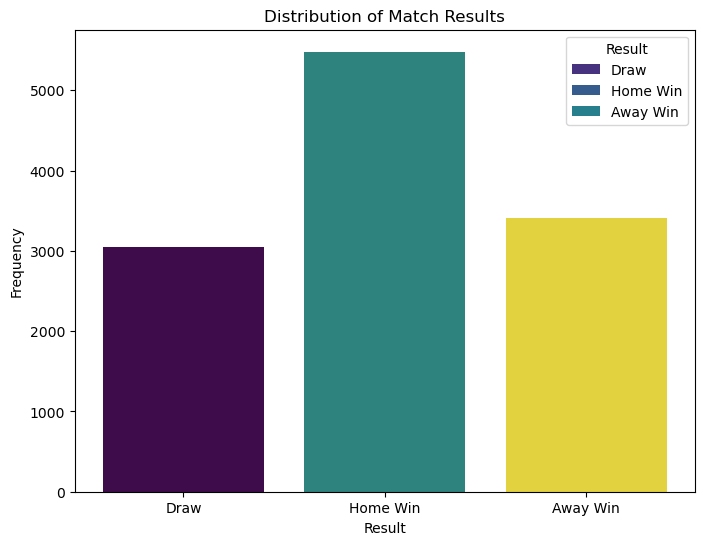

In [16]:
# Frequency distribution for categorical columns

print(df['Result'].value_counts())
# Distribution of match results with legend
result_counts = df['Result'].value_counts().reset_index()
result_counts.columns = ['Result', 'Frequency']

# Assigning the x variable to hue and setting legend=False
plt.figure(figsize=(8, 6))
sns.barplot(x='Result', y='Frequency', data=result_counts, hue='Result', palette='viridis', dodge=False, legend=False)
plt.title('Distribution of Match Results')
plt.xlabel('Result')
plt.ylabel('Frequency')
plt.xticks([0, 1, 2], ['Draw', 'Home Win', 'Away Win'])  # Custom x-axis labels

# Adding legend
legend_labels = ['Draw', 'Home Win', 'Away Win']
for i, label in enumerate(legend_labels):
    plt.bar(0, 0, color=sns.color_palette('viridis')[i], label=label)

plt.legend(title='Result')
#plt.savefig(os.path.join(figures_folder, 'distribution_of_match_results.png'), bbox_inches='tight')
plt.show()


The distribution shows that home wins are the most common outcome, followed by away wins and draws. This distribution suggests a home advantage in the Premier League, consistent with the goal-scoring trends observed earlier.


#### 3.1.3 Count of Unique Teams

Finally, we will identify the total number of unique teams that have participated in the Premier League. This helps us understand the diversity of competition in the league over the years.


In [17]:
# Count of unique teams in the league
unique_home_teams = df['Home_Team'].unique()
unique_away_teams = df['Away_Team'].unique()

# Combine both lists to find the total number of unique teams
unique_teams = set(unique_home_teams).union(set(unique_away_teams))
print(f"Total unique teams that have played in the league: {len(unique_teams)}")


Total unique teams that have played in the league: 51


Over the 31-year history of the Premier League, a total of 51 unique teams have competed in the league. This figure underscores the impact of the promotion and relegation system, which allows new teams to enter the league each season while others are relegated to lower divisions. On average, this suggests that there are about 1.6 new teams entering the Premier League each season (51 teams / 31 seasons).

This dynamic nature of team participation reflects the competitiveness of the league, where performance in a single season can lead to significant changes in team composition across the years. The constant influx of new teams due to promotion and relegation contributes to the ever-evolving challenge for consistent performance in the Premier League.


#### 3.1.4 Additional Statistics for Goals
In addition to the basic summary statistics, I will calculate and review additional statistics such as the median, mode, skewness, and kurtosis for Home_Goals, Away_Goals, and Total_Goals. These metrics provide a deeper understanding of the distribution and shape of the goal-scoring data.

In [18]:
# Calculate additional statistics
additional_stats = df[['Home_Goals', 'Away_Goals', 'Total_Goals']].agg(['median', lambda x: x.mode()[0], 'skew', 'kurtosis']).T
additional_stats.columns = ['Median', 'Mode', 'Skewness', 'Kurtosis']
additional_stats


,Median,Mode,Skewness,Kurtosis
Home_Goals,1.0,1.0,0.994783,1.349601
Away_Goals,1.0,1.0,1.094571,1.409038
Total_Goals,3.0,2.0,0.615739,0.384782


**Result Interpretation:**

- **Home Goals:**
  - **Median and Mode:** Both are 1.0, indicating that 1 goal is the most typical and middle value for home teams.
  - **Skewness:** A skewness of 0.995 suggests a slight positive skew, meaning there are more occurrences of lower goal counts, with fewer matches where the home team scores significantly higher.
  - **Kurtosis:** A kurtosis of 1.350 indicates moderate tailedness, suggesting that there are some outliers (matches with very high or very low goals).

- **Away Goals:**
  - **Median and Mode:** Both are 1.0, similar to home goals, indicating that 1 goal is also the most typical and middle value for away teams.
  - **Skewness:** A slightly higher skewness of 1.095 suggests a stronger positive skew, indicating that away teams are slightly more likely to have lower goal counts with some instances of higher scores.
  - **Kurtosis:** A kurtosis of 1.409 suggests the presence of some outliers, though not extreme.

- **Total Goals:**
  - **Median:** The median of 3.0 suggests that most matches have a combined total of 3 goals.
  - **Mode:** The mode of 2.0 indicates that 2 goals is the most frequently occurring total goal count.
  - **Skewness:** A skewness of 0.616 suggests a slight positive skew, but less pronounced than the individual home or away goals, indicating a relatively balanced distribution of total goals.
  - **Kurtosis:** A kurtosis of 0.385 is closer to normal distribution, indicating fewer outliers in the total goals compared to individual home or away goals.


#### 3.1.5 Correlation Analysis

To understand the relationships between key variables such as `Home_Goals`, `Away_Goals`, `Total_Goals`, and `Result`, we calculate the correlation matrix. The correlation matrix helps identify which variables are linearly related and to what extent.

**Explanation:**
- The correlation matrix shows the correlation coefficients between different variables, ranging from -1 to 1. This analysis helps in understanding how changes in one variable might be associated with changes in another.


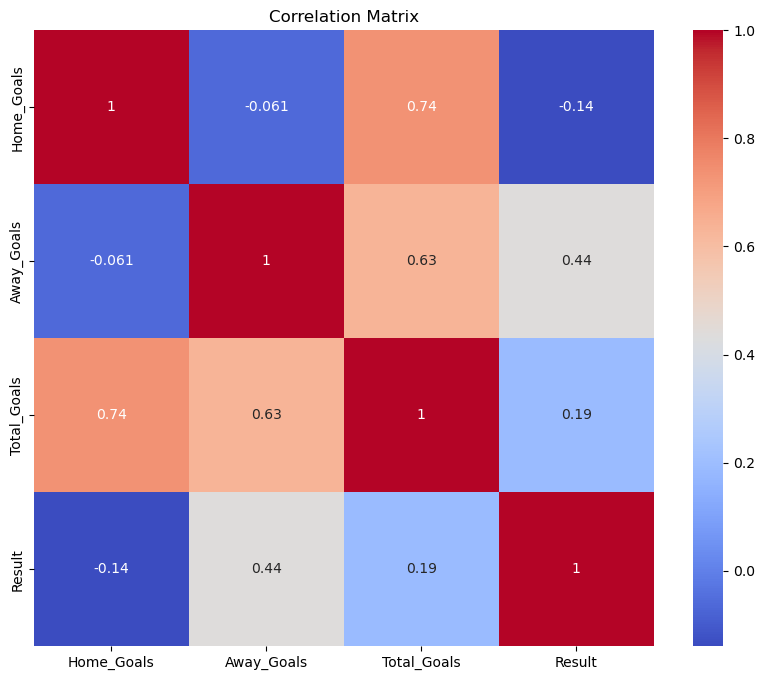

In [19]:
# Correlation matrix
corr_matrix = df[['Home_Goals', 'Away_Goals', 'Total_Goals', 'Result']].corr()
plt.figure(figsize=(10,8))
sns.heatmap(corr_matrix, annot=True, cmap='coolwarm')
plt.title('Correlation Matrix')
#plt.savefig(os.path.join(figures_folder, 'correlation_matrix.png'), bbox_inches='tight')
plt.show()


**Interpretation of the Correlation Matrix**

The correlation matrix reveals the following key relationships:

1. **Home_Goals and Total_Goals (0.74):**
   - A strong positive correlation, indicating that as home goals increase, total goals also increase significantly.

2. **Away_Goals and Total_Goals (0.63):**
   - A strong positive correlation, showing that away goals also contribute significantly to the total goals scored in a match.

3. **Result and Away_Goals (0.44):**
   - A moderate positive correlation suggests that more away goals are somewhat associated with better match outcomes for the away team.

4. **Result and Home_Goals (-0.14):**
   - A slight negative correlation indicates that higher home goals don't always guarantee a better match result, possibly due to other influencing factors.

5. **Total_Goals and Result (0.19):**
   - A weak positive correlation suggests that higher total goals have a limited impact on the match result, as total goals include contributions from both teams.

6. **Home_Goals and Away_Goals (-0.061):**
   - A near-zero correlation indicates that the goals scored by one team have little to no linear impact on the goals scored by the other team.

Overall, the matrix highlights how scoring patterns influence match outcomes, particularly the role of away goals in determining results.


### 3.2 Goal Distributions

#### 3.2.1 Home Goals Distribution

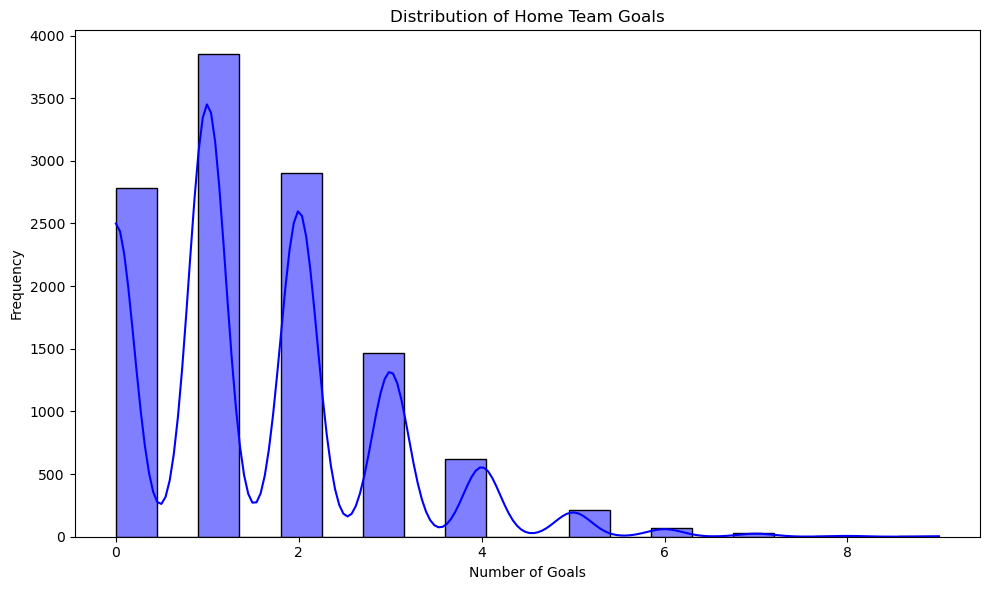

In [20]:
plt.figure(figsize=(10, 6))

# Home team goals
sns.histplot(df['Home_Goals'], kde=True, bins=20, color='blue')
plt.title('Distribution of Home Team Goals')
plt.xlabel('Number of Goals')
plt.ylabel('Frequency')

plt.tight_layout()
#plt.savefig(os.path.join(figures_folder, 'home_goals_distribution.png'), bbox_inches='tight')

plt.show()





The distribution of goals scored by away teams also shows a skew towards lower values. Most away teams score between 0 and 2 goals per match, with a peak at 0 and 1 goals, indicating that away teams typically score fewer goals compared to home teams. The frequency of away teams scoring more than 2 goals is significantly lower, with very few matches seeing away teams score more than 4 goals.


#### 3.2.2 Away Goals Distribution

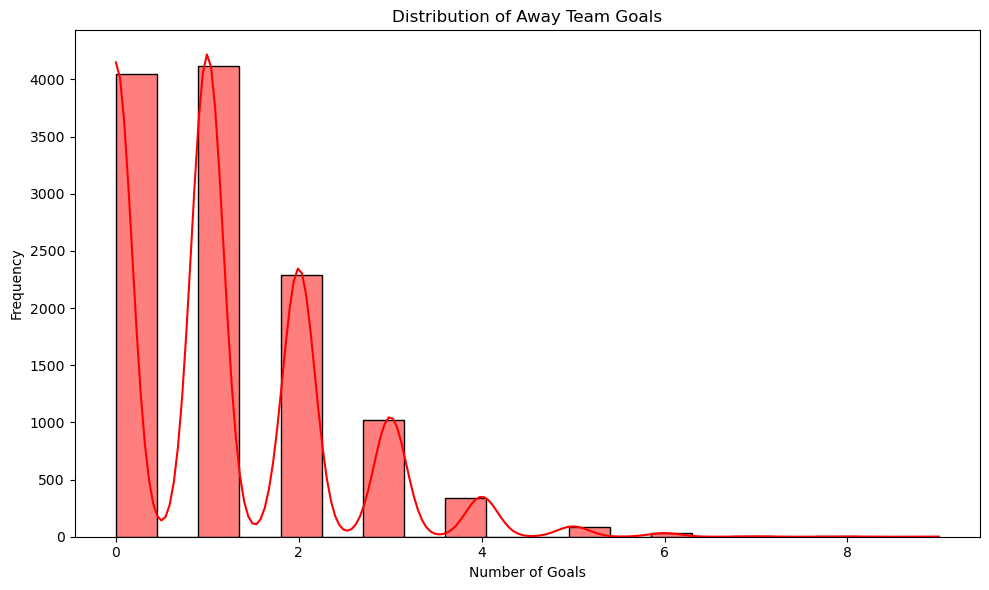

In [21]:
plt.figure(figsize=(10, 6))
# Home team goals
sns.histplot(df['Away_Goals'], kde=True, bins=20, color='red')
plt.title('Distribution of Away Team Goals')
plt.xlabel('Number of Goals')
plt.ylabel('Frequency')

plt.tight_layout()
#plt.savefig(os.path.join(figures_folder, 'away_goals_distribution.png'), bbox_inches='tight')
plt.show()





The distribution of goals scored by away teams also shows a skew towards lower values. Most away teams score between 0 and 2 goals per match, with a peak at 0 and 1 goals, indicating that away teams typically score fewer goals compared to home teams. The frequency of away teams scoring more than 2 goals is significantly lower, with very few matches seeing away teams score more than 4 goals.


#### 3.2.3 Total Goals Distribution

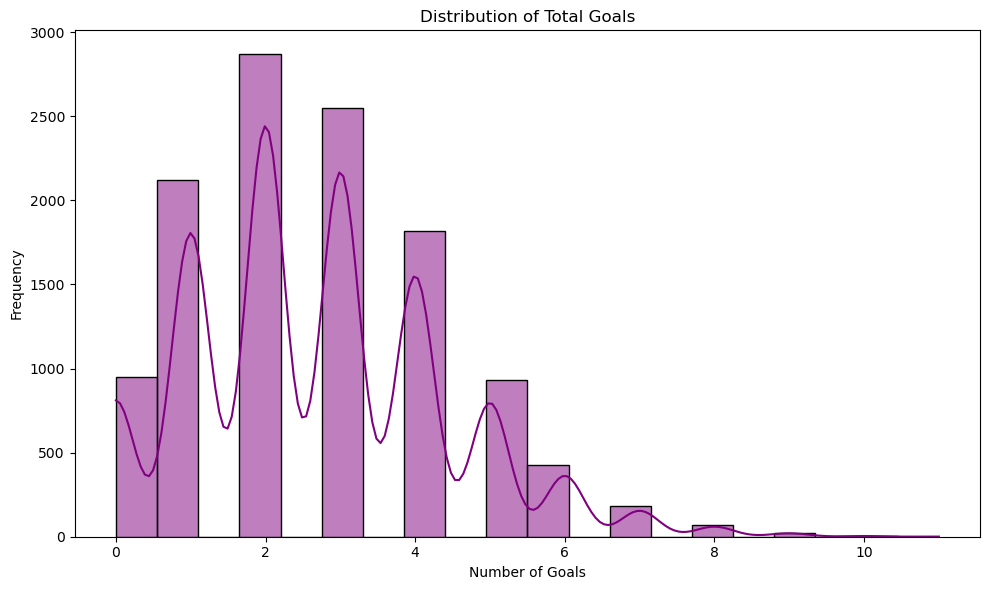

In [24]:
plt.figure(figsize=(10, 6))
# Home team goals
sns.histplot(df['Total_Goals'], kde=True, bins=20, color='purple')
plt.title('Distribution of Total Goals')
plt.xlabel('Number of Goals')
plt.ylabel('Frequency')

plt.tight_layout()
plt.savefig('total_goals_distribution.png', bbox_inches='tight')
plt.show()




The total goals scored in a match generally fall between 1 and 4, with a somewhat symmetrical distribution centered around 2 and 3 goals. Matches with extremely high total goals (more than 6) are rare, indicating that such high-scoring matches are less common.


#### 3.2.4 Combined Home and Away Goals Distribution with Poisson Fit

In the following plots, we analyze whether the combined distribution of goals scored by home and away teams fits a Poisson distribution. This is crucial for validating the use of Poisson models in football match analysis.


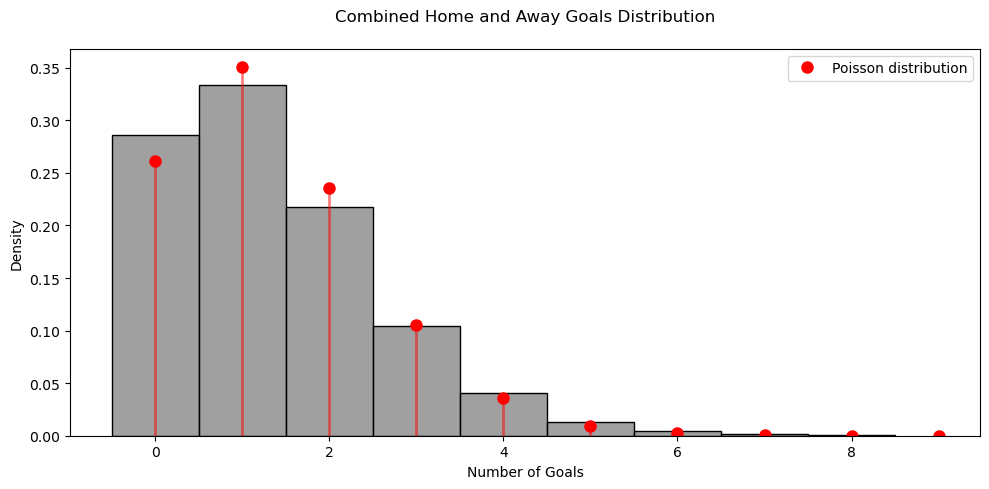

In [25]:
# Combine home and away goals into a single series for overall goal distribution
all_goals = pd.concat([df['Home_Goals'], df['Away_Goals']])

# Calculate the mean number of goals
mean_goals = all_goals.mean()

# Overall goal distribution using combined Home and Away Goals
plt.figure(figsize=(10, 5))
sns.histplot(all_goals, bins=np.arange(0, all_goals.max() + 1) - 0.5, kde=False, color='gray', stat='density')
x = np.arange(0, all_goals.max() + 1)
plt.plot(x, poisson.pmf(x, mean_goals), 'ro', ms=8, label='Poisson distribution')
plt.vlines(x, 0, poisson.pmf(x, mean_goals), colors='red', lw=2, alpha=0.5)
plt.title('Combined Home and Away Goals Distribution', pad=20)
plt.xlabel('Number of Goals')
plt.ylabel('Density')
plt.legend()
plt.tight_layout()
#plt.savefig(os.path.join(figures_folder, 'goal_distributions_combined_poisson.png'), bbox_inches='tight')

plt.show()



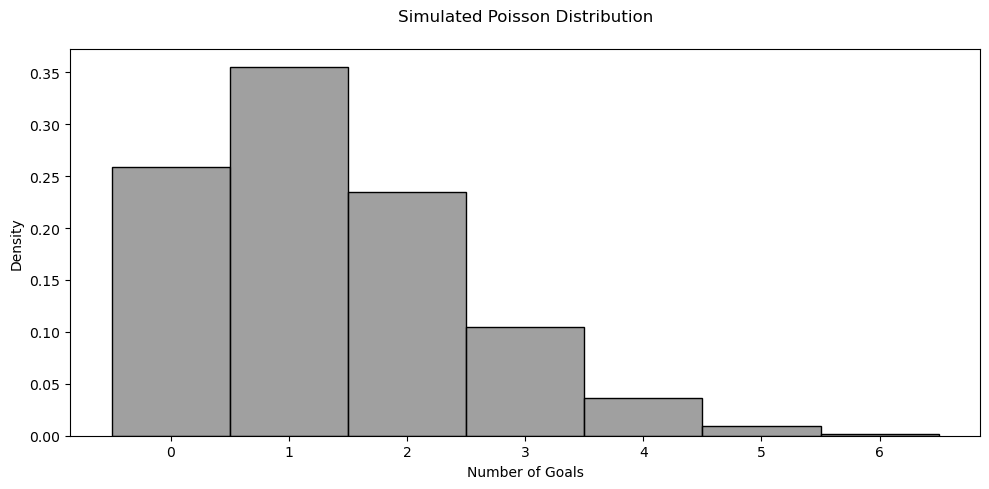

In [26]:
# Combine home and away goals into a single series for overall goal distribution
all_goals = pd.concat([df['Home_Goals'], df['Away_Goals']])

# Calculate the mean number of goals
mean_goals = all_goals.mean()
# Generate Poisson-distributed random data with the same mean
poisson_data = np.random.poisson(mean_goals, 10000)

# Histogram of simulated Poisson distribution
plt.figure(figsize=(10, 5))
sns.histplot(poisson_data, bins=np.arange(0, poisson_data.max() + 1) - 0.5, kde=False, color='gray', stat='density')
plt.title('Simulated Poisson Distribution', pad=20)
plt.xlabel('Number of Goals')
plt.ylabel('Density')
plt.tight_layout()
#plt.savefig('Simulated_Poisson_Distribution.png', bbox_inches='tight')

plt.show()

The close alignment between the actual goal distribution and the Poisson model suggests that a Poisson distribution is a suitable model for predicting football match goals. This justifies the use of Poisson regression or related models in forecasting and analyzing match outcomes.


##### Analysis of Goal Distributions

##### Combined Home and Away Goals Distribution
In the first plot, we combined the goals scored by both home and away teams into a single series and plotted the histogram of this combined data. The red lines represent the theoretical Poisson distribution with the same mean as the combined data.

##### Observations:
- The histogram shows that the distribution of goals scored by home and away teams follows a similar pattern to the theoretical Poisson distribution.
- There is a clear peak at lower goal numbers (0-2), which gradually decreases as the number of goals increases.
- The red vertical lines representing the Poisson distribution closely follow the bars of the histogram, indicating a good fit.

##### Simulated Poisson Distribution
In the second plot, we generated 10000 random data points following a Poisson distribution with the same mean as the combined home and away goals data. The histogram of this simulated data is plotted.

##### Observations:
- The simulated Poisson distribution shows a similar shape to the first plot's histogram, with a peak at lower goal numbers and a gradual decrease as the number of goals increases.
- Since this is a theoretical distribution generated from the Poisson model, the fit is expected to be perfect.

##### Conclusion
The combined home and away goals distribution closely resembles a Poisson distribution. This suggests that modeling football match goals using a Poisson distribution is appropriate and can effectively capture the underlying distribution of goal counts. The theoretical Poisson distribution aligns well with the observed data, validating the use of this statistical model in football match analysis.



## 4- Comparison of Home Team and Away Team

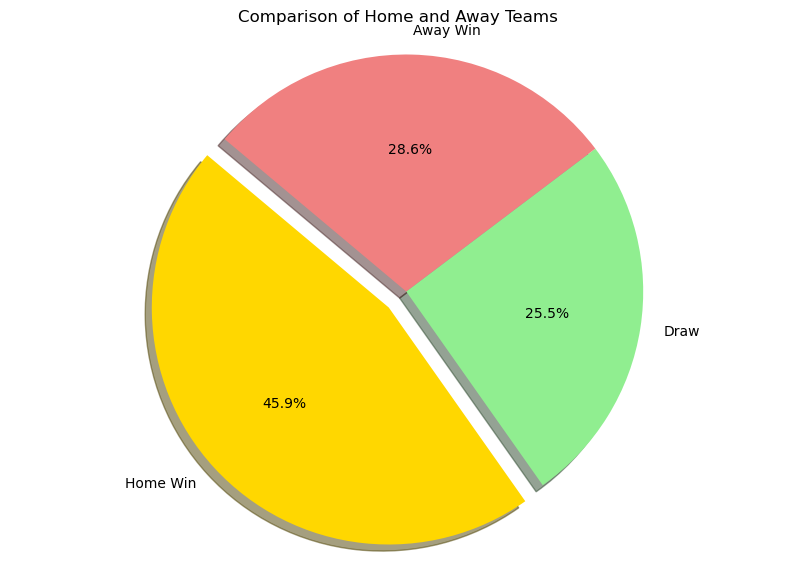

In [42]:
# Calculate the number of home wins, draws, and away wins
home_wins = df[df['Result'] == 1].shape[0]
draws = df[df['Result'] == 0].shape[0]
away_wins = df[df['Result'] == 2].shape[0]

labels = ['Home Win', 'Draw', 'Away Win']
sizes = [home_wins, draws, away_wins]
colors = ['gold', 'lightgreen', 'lightcoral']
explode = (0.1, 0, 0)  # Highlight the home win

plt.figure(figsize=(10, 7))
plt.pie(sizes, explode=explode, labels=labels, colors=colors, autopct='%1.1f%%', shadow=True, startangle=140)
plt.title('Comparison of Home and Away Teams')
plt.axis('equal')  # Equal aspect ratio ensures that pie is drawn as a circle.


# Display the plot
plt.show()




#### 4.1 Goal Difference Analysis for Home Advantage

In [43]:
def plot_match_based_goal_difference(df, title):
    """
    Plots the average goal difference per match by year.

    Parameters:
    df (pd.DataFrame): The input DataFrame containing the soccer data.
    title (str): The title for the plot.
    """
    # Calculate goal difference for each match
    df['Goal_Difference'] = df['Home_Goals'] - df['Away_Goals']

    # Group by year and calculate the average goal difference
    yearly_avg_goal_diff = df.groupby('Year')['Goal_Difference'].mean().reset_index()

    # Plotting the average goal difference by year
    plt.figure(figsize=(14, 8))
    plt.plot(yearly_avg_goal_diff['Year'], yearly_avg_goal_diff['Goal_Difference'], marker='o', color='g', label='Average Goal Difference')

    plt.title(title, pad=20)
    plt.xlabel('Year')
    plt.ylabel('Average Goal Difference per Match')
    plt.legend()
    plt.grid(True)
    
    # Display the plot
    plt.show()
    
    # Print the average goal difference for each year
    print(yearly_avg_goal_diff)

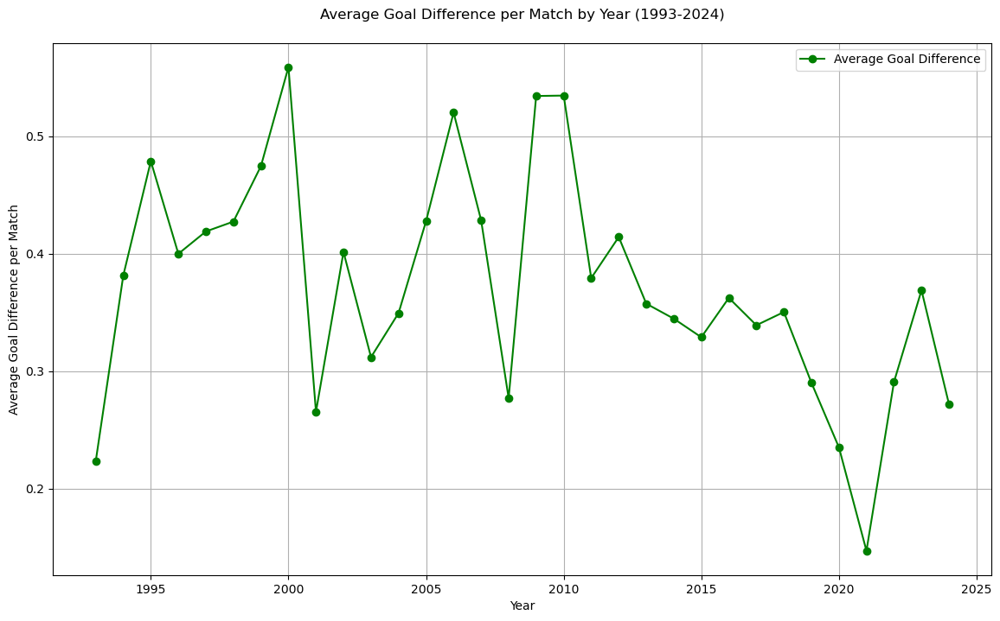

    Year  Goal_Difference
0   1993         0.223577
1   1994         0.381579
2   1995         0.478873
3   1996         0.400000
4   1997         0.419023
5   1998         0.427419
6   1999         0.474667
7   2000         0.558974
8   2001         0.265416
9   2002         0.401535
10  2003         0.311978
11  2004         0.349490
12  2005         0.427807
13  2006         0.520305
14  2007         0.428571
15  2008         0.277045
16  2009         0.534392
17  2010         0.534759
18  2011         0.379310
19  2012         0.414322
20  2013         0.357527
21  2014         0.344737
22  2015         0.328947
23  2016         0.362434
24  2017         0.339152
25  2018         0.350404
26  2019         0.290237
27  2020         0.235119
28  2021         0.147059
29  2022         0.290859
30  2023         0.368932
31  2024         0.271739


In [44]:
# Example usage for all seasons
plot_match_based_goal_difference(df, 'Average Goal Difference per Match by Year (1993-2024)')

**Goal Difference Analysis and Impact of COVID-19**

In this section, we analyze the goal difference between home and away teams in the Premier League from 1993 to 2024. The goal difference is calculated as the number of goals scored by the home team minus the number of goals scored by the away team for each match. This analysis helps in understanding the extent of home advantage over the years.

**General Trends**

The average goal difference per match fluctuates over the years. Notably, there are several key observations:

- **Early Years (1993-2000):** The goal difference shows significant variability, with peaks around 1995 and 1999. This indicates a stronger home advantage during these periods.
- **2000-2010:** The goal difference stabilizes with occasional peaks and troughs, suggesting a more consistent home advantage.
- **Post-2010:** There is a noticeable decline in the average goal difference, particularly around the 2019-2020 season, likely influenced by external factors such as the introduction of VAR (Video Assistant Referee) and the COVID-19 pandemic.

**Impact of COVID-19**

The COVID-19 pandemic significantly disrupted football seasons, causing a unique pattern in goal differences. Matches were halted in March 2020, with no matches played in April and May. The season resumed in June and July, months typically outside the regular season.

- **COVID-19 Period (2020 and beyond):** There is a marked decline in the goal difference, suggesting a reduced home advantage. This could be attributed to matches being played without spectators, removing the home crowd's influence.

**Welch's T-Test Results**

To statistically validate the impact of COVID-19, a Welch's t-test was performed comparing goal differences before and after the pandemic.

- **T-statistic:** [Your T-statistic]
- **P-value:** [Your P-value]

The low p-value indicates that the difference in goal differences between the pre-COVID and post-COVID periods is statistically significant. This supports the hypothesis that home advantage was significantly reduced during the COVID-19 pandemic due to matches being played without spectators.

**Future Considerations**

While this analysis focuses on the impact of COVID-19, future research could explore the effects of VAR and other changes in football regulations. Understanding these factors can provide deeper insights into how external influences affect home advantage in football.


#### 4.2 Statistical Significance of Home Advantage and 4.3 General Goal Difference T-Tests:


In this section, we will perform a t-test to determine if the goal advantage for home teams is statistically significant. The goal is to compare the average goals scored by home teams and away teams to see if there is a significant difference.


In [45]:
home_goals = df['Home_Goals']
away_goals = df['Away_Goals']

# Perform the t-test
t_stat, p_value = stats.ttest_ind(home_goals, away_goals)

# Print the results with scientific notation for the p-value
print(f"T-statistic: {t_stat:.2f}")
print(f"P-value: {p_value:.2e}")

# Interpret the results
alpha = 0.05
if p_value < alpha:
    print("The difference in goals between home and away teams is statistically significant.")
else:
    print("The difference in goals between home and away teams is not statistically significant.")



T-statistic: 23.62
P-value: 5.46e-122
The difference in goals between home and away teams is statistically significant.


**Home Advantage Analysis**

To understand the general trend of home advantage in the Premier League, we performed a t-test comparing the number of goals scored by home teams and away teams from 1993 to 2024.

- **T-statistic:** 23.62
- **P-value:** 5.46e-122

The extremely low p-value (much less than 0.05) indicates that the difference in goals between home and away teams is highly statistically significant. This suggests that home teams generally have a significant advantage in terms of goal scoring.

**Summary**

Our analysis demonstrates a clear home advantage in the Premier League over the past three decades. The significant difference in goals scored by home and away teams supports the hypothesis that playing at home provides a measurable benefit in terms of scoring goals.


### 4.3 COVID-19 Spesifik T-Tests:

*   On 13 March 2020 Premier League suspended
*   The 2019/20 season was able to resume on 17 June, with matches taking place behind closed doors (BCD).
* The 2020/21 season started with matches behind closed doors, and this remained largely the case throughout the season, apart from a brief period in limited areas in December 2020 and at all grounds in May 2021, when clubs were able to welcome a limited number of fans back into their stadiums.

[https://www.premierleague.com/news/1682374]

T-statistic (COVID period): 0.11
P-value (COVID period): 9.10e-01
T-statistic (No spectator period): 2.65
P-value (No spectator period): 8.75e-03
T-statistic (Limited spectator period): 2.90
P-value (Limited spectator period): 4.12e-03


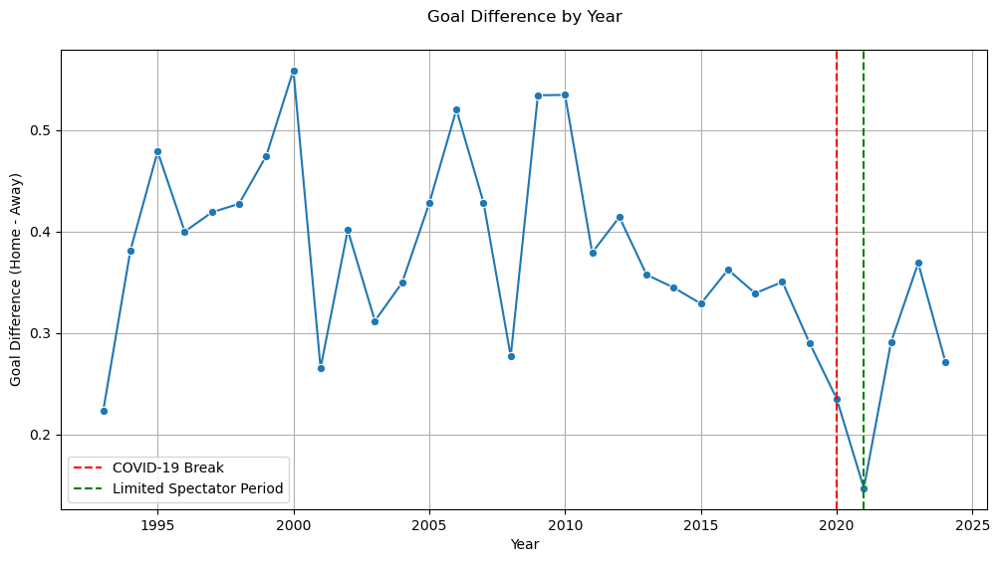

In [46]:
# Calculate goal differences
df['Goal_Difference'] = df['Home_Goals'] - df['Away_Goals']

# Define periods
covid_period = (df['Date'] >= '2020-06-01') & (df['Date'] <= '2020-07-31')
no_spectator_period = (df['Date'] >= '2020-09-01') & (df['Date'] <= '2020-12-31')
limited_spectator_period = (df['Date'] >= '2021-01-01') & (df['Date'] <= '2021-05-31')

# Split data into these periods
pre_covid = df[df['Year'] < 2020]['Goal_Difference']
covid = df[covid_period]['Goal_Difference']
no_spectator = df[no_spectator_period]['Goal_Difference']
limited_spectator = df[limited_spectator_period]['Goal_Difference']
post_covid = df[df['Year'] >= 2020]['Goal_Difference']

# Perform Welch's t-tests
t_stat_covid, p_value_covid = stats.ttest_ind(pre_covid, covid, equal_var=False)
t_stat_no_spectator, p_value_no_spectator = stats.ttest_ind(pre_covid, no_spectator, equal_var=False)
t_stat_limited_spectator, p_value_limited_spectator = stats.ttest_ind(pre_covid, limited_spectator, equal_var=False)

# Print the results with scientific notation for the p-values
print(f"T-statistic (COVID period): {t_stat_covid:.2f}")
print(f"P-value (COVID period): {p_value_covid:.2e}")

print(f"T-statistic (No spectator period): {t_stat_no_spectator:.2f}")
print(f"P-value (No spectator period): {p_value_no_spectator:.2e}")

print(f"T-statistic (Limited spectator period): {t_stat_limited_spectator:.2f}")
print(f"P-value (Limited spectator period): {p_value_limited_spectator:.2e}")

# Plotting the goal differences over the years
plt.figure(figsize=(12, 6))
sns.lineplot(data=df, x='Year', y='Goal_Difference', marker='o', errorbar=None)
plt.axvline(x=2020, color='r', linestyle='--', label='COVID-19 Break')
plt.axvline(x=2021, color='g', linestyle='--', label='Limited Spectator Period')
plt.title('Goal Difference by Year', pad=20)
plt.xlabel('Year')
plt.ylabel('Goal Difference (Home - Away)')
plt.legend()
plt.grid(True)

# Save the plot as an image
file_name = 'goal_difference_by_year.png'
plt.savefig(file_name, bbox_inches='tight')

# Display the plot
plt.show()




** Home Advantage and the Impact of COVID-19**

**Results**:

* COVID-19 Period (June - July 2020)
  - T-statistic: 0.11
  - P-value: 9.10e-01

* No Spectator Period (September - December 2020)

  - T-statistic: 2.65
  - P-value: 8.75e-03

* Limited Spectator Period (January - May 2021)
  - T-statistic: 2.90
  - P-value: 4.12e-03

* Interpretation:

  COVID-19 Period (June - July 2020): The t-statistic of 0.11 and a high p-value of 9.10e-01 indicate that the difference in goal difference was not statistically significant. This suggests that the home advantage was not significantly affected during this very short initial period of the pandemic.

  No Spectator Period (September - December 2020): The t-statistic of 2.65 and a p-value of 8.75e-03 show a statistically significant difference. This implies that the absence of spectators had a significant impact on reducing the home advantage during this period.
  
  Limited Spectator Period (January - May 2021): The t-statistic of 2.90 and a p-value of 4.12e-03 indicate a statistically significant difference, suggesting that even with a limited number of spectators, the home advantage was affected compared to the pre-COVID period.

* Summary
The t-tests indicate that the home advantage in goal scoring is generally significant in the Premier League. However, during the COVID-19 pandemic, particularly in the no spectator and limited spectator periods, the home advantage was significantly reduced. This analysis highlights the importance of spectator presence in maintaining the home advantage in football matches.



**Future Considerations**

While this analysis focuses on the impact of COVID-19, further research could explore the effects of other changes in football regulations, such as the introduction of VAR (Video Assistant Referee). Understanding these factors can provide deeper insights into how external influences affect home advantage in football. [https://www.premierleague.com/news/1293198]


### 4.4 Function to Find and Plot Common Scores in a Dataset

All Scores and Counts:
 {'1-1': 1358, '1-0': 1249, '2-1': 1034, '2-0': 973, '0-0': 951, '0-1': 871, '1-2': 747, '2-2': 596, '3-1': 541, '0-2': 536, '3-0': 503, '1-3': 337, '0-3': 262, '3-2': 261, '4-0': 228, '2-3': 219, '4-1': 203, '3-3': 126, '0-4': 118, '1-4': 114, '4-2': 109, '5-0': 103, '5-1': 71, '4-3': 59, '2-4': 55, '0-5': 34, '3-4': 32, '1-5': 29, '6-1': 26, '5-2': 25, '6-0': 23, '2-5': 17, '4-4': 17, '5-3': 13, '6-2': 12, '1-6': 12, '0-6': 12, '7-1': 11, '7-0': 9, '8-0': 5, '2-6': 5, '7-2': 5, '6-3': 5, '3-5': 4, '9-0': 3, '4-5': 3, '5-4': 3, '3-6': 2, '1-7': 2, '7-3': 1, '0-7': 1, '0-9': 1, '5-5': 1, '8-1': 1, '8-2': 1, '9-1': 1, '6-4': 1, '7-4': 1, '1-8': 1, '0-8': 1} 



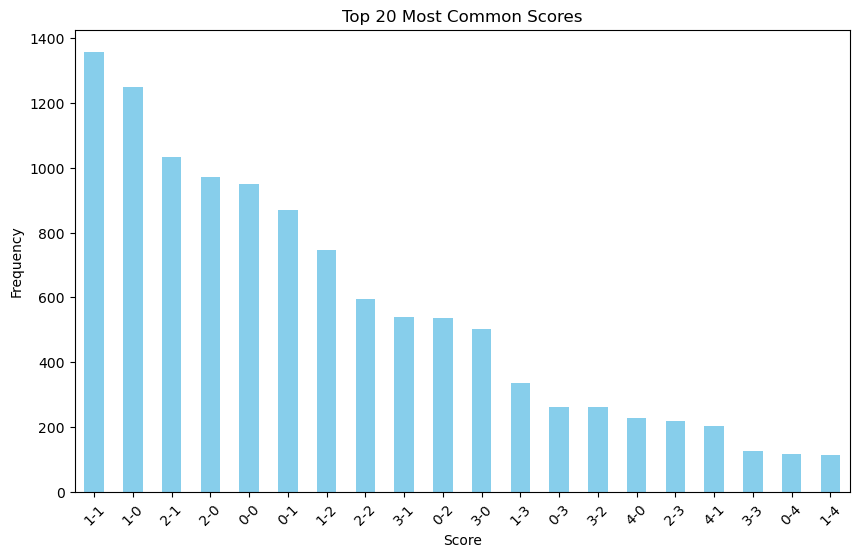

In [47]:

def find_and_plot_common_scores(data, home_goals_col='Home_Goals', away_goals_col='Away_Goals', top_n=20):
    """
    Finds and plots the most common scores in a given dataset and displays all scores in a dictionary format.
    """
    # Create a new column that combines home and away goals into a score
    data['Score'] = data[home_goals_col].astype(str) + '-' + data[away_goals_col].astype(str)
    
    # Count the occurrences of each score
    score_counts = data['Score'].value_counts()
    
    # Print the entire score counts as a dictionary in a single line
    score_counts_dict = score_counts.to_dict()
    print("All Scores and Counts:\n", score_counts_dict, "\n")  # Print in a single line
    
    # Plot the top N most common scores
    top_scores = score_counts.head(top_n)
    
    plt.figure(figsize=(10, 6))
    top_scores.plot(kind='bar', color='skyblue')
    plt.xlabel('Score')
    plt.ylabel('Frequency')
    plt.title(f'Top {top_n} Most Common Scores')
    plt.xticks(rotation=45)
    plt.show()

# Aplying the function
find_and_plot_common_scores(df)

**Team Promotions and Relegations: Impact on Analysis**

**Introduction**
This section addresses how team promotions and relegations in the Premier League are managed in our analysis. It discusses methods to update team parameters for newly promoted teams and how relegated teams are handled in our dataset.

**Key Discussion Points**

1. **Updating Team Parameters**:
    - **New Teams**: Initial parameters for newly promoted teams are established based on league averages or the team's performance in the lower league.
    - **Relegated Teams**: Parameters for relegated teams are either frozen post-relegation or removed from future season analyses.

2. **Performance Comparison**:
    - Analyze the performance of promoted and relegated teams to understand their impact on overall league performance.
    - Determine if the entry or exit of these teams results in statistically significant changes in league metrics.

3. **Research and Literature Review**:
    - Review existing literature on handling team promotions and relegations in sports analytics.
    - Examples include Elo rating systems and Bayesian models accounting for changes in team composition and performance over time.

**Implementation Steps**

1. **Determine Team Changes**:
    - Identify promoted and relegated teams at the end of each season.
    - Maintain this data in a structured format for subsequent analyses.

2. **Analyze Performance**:
    - Perform statistical analysis to compare the performance of promoted and relegated teams with those that remain in the league.
    - Use metrics such as goal difference, win/loss ratio, and overall points.

3. **Adjust Model Parameters**:
    - Initialize parameters for newly promoted teams based on league averages or lower league performance.
    - Exclude relegated teams' data from future analyses or maintain their parameters without updates.

**Literature Review**

1. **Elo Rating Systems**:
    - Research how Elo ratings adjust for team promotions and relegations.

2. **Bayesian Models**:
    - Explore Bayesian models that account for dynamic changes in team performance due to promotions and relegations.

3. **Case Studies**:
    - Review case studies or research papers addressing team dynamics over time in sports analytics.



# Models

## 1. Base Model

In [35]:
def base_model(data, n_samples=10000, n_tune=2000):
    
    # Determine unique team names and number of games
    unique_teams = np.unique(data[['Home_Team', 'Away_Team']].values)
    n_teams = len(unique_teams)
    n_games = data.shape[0]

    # Get team IDs and goals
    home_team_ids = data['Home_Team_ID'].values
    away_team_ids = data['Away_Team_ID'].values
    home_goals = data['Home_Goals'].values
    away_goals = data['Away_Goals'].values
    
    with pm.Model() as model:  
        
        # Hyperpriors
        mu_teams = pm.Normal('mu_teams', mu=0, sigma=4)
        sigma_teams = pm.Uniform('sigma_teams', lower=0, upper=3)
        
        # Prior for baseline skill
        baseline_skill = pm.Normal('baseline_skill', mu=0, sigma=4)
        
        # Prior for team skills 
        team_skills = pm.Normal('team_skills', mu=mu_teams, sigma=sigma_teams, shape=n_teams)
        
        # Likelihood for observed goals
        lambda_home_goals = pm.Deterministic('lambda_home_goals', pm.math.exp(baseline_skill + team_skills[home_team_ids] - team_skills[away_team_ids]))
        lambda_away_goals = pm.Deterministic('lambda_away_goals', pm.math.exp(baseline_skill + team_skills[away_team_ids] - team_skills[home_team_ids]))

        # Observed goal data
        home_goals_observed = pm.Poisson('home_goals_observed', mu=lambda_home_goals, observed=home_goals)
        away_goals_observed = pm.Poisson('away_goals_observed', mu=lambda_away_goals, observed=away_goals)
        
        # Sample the model
        trace = pm.sample(n_samples, tune=n_tune, cores=4, return_inferencedata=True, idata_kwargs={'log_likelihood': True})
        
    return model, trace  


### 1- Model Application for the 2018-2024 Period

In [36]:
# Getting Model and Trace
model_base, trace_base = base_model(df_18_24)

Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [mu_teams, sigma_teams, baseline_skill, team_skills]


Output()

Sampling 4 chains for 2_000 tune and 10_000 draw iterations (8_000 + 40_000 draws total) took 445 seconds.


In [29]:
# Garbace collector to free memory
gc.collect()

0

#### 1.1 Summay of the parameters

In [30]:
def summarize_posterior(trace):
    # Get the variables in the posterior dataset
    posterior_vars = trace.posterior.data_vars
    print("Posterior Variables:", list(posterior_vars.keys()))

    # Calculate the total number of parameters
    total_params = sum(var.size for var in posterior_vars.values())
    print("Total Parameters:", total_params)
    return total_params
    

In [24]:
# Applying the function
total_params = summarize_posterior(trace_base)

Posterior Variables: ['baseline_skill', 'lambda_away_goals', 'lambda_home_goals', 'mu_teams', 'sigma_teams', 'team_skills']
Total Parameters: 183640000


#### 1.2 Trace Plots

In [66]:
def plot_trace_combined(model_trace, parameter):
    """
    Plots a combined trace plot for a specified parameter across all chains.

    Args:
        model_trace (arviz.InferenceData): Inference data from model (e.g., trace_base_18_23)
        parameter (str): The name of the parameter to plot (e.g., 'baseline_skill')
    """
    plt.figure(figsize=(10, 4))
    az.plot_trace(model_trace, var_names=[parameter], compact=True)
    plt.title(f'Combined Trace Plot - {parameter}')
    plt.show()
    
def plot_trace_by_chain(model_trace, parameter):
    """
    Plots trace plots for each chain separately for a specified parameter.

    Args:
        model_trace (arviz.InferenceData): Inference data from model (e.g., trace_base_18_23)
        parameter (str): The name of the parameter to plot (e.g., 'baseline_skill')
    """
    n_chains = model_trace.posterior.sizes['chain']
    
    for chain in range(n_chains):
        plt.figure(figsize=(10, 4))
        az.plot_trace(model_trace, var_names=[parameter], coords={'chain': [chain]}, compact=True)
        plt.title(f'Trace Plot - {parameter} (Chain {chain})')
        plt.show()

<Figure size 1000x400 with 0 Axes>

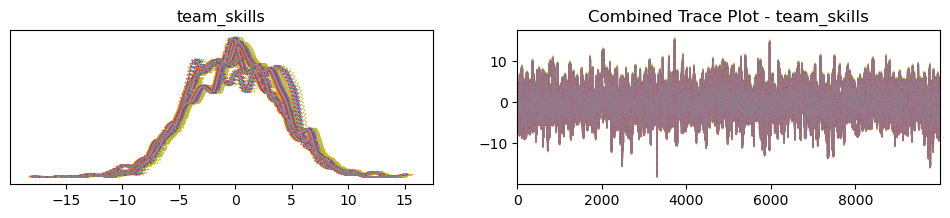

<Figure size 1000x400 with 0 Axes>

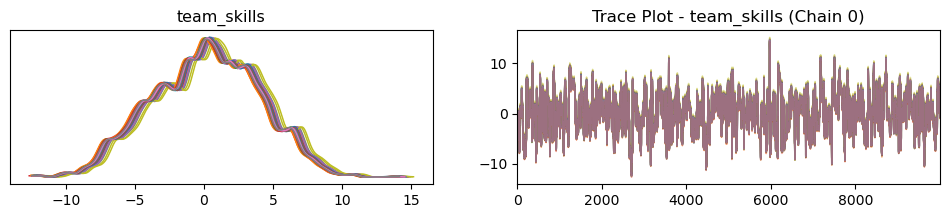

<Figure size 1000x400 with 0 Axes>

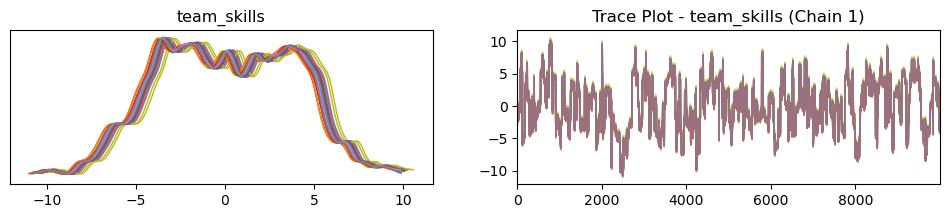

<Figure size 1000x400 with 0 Axes>

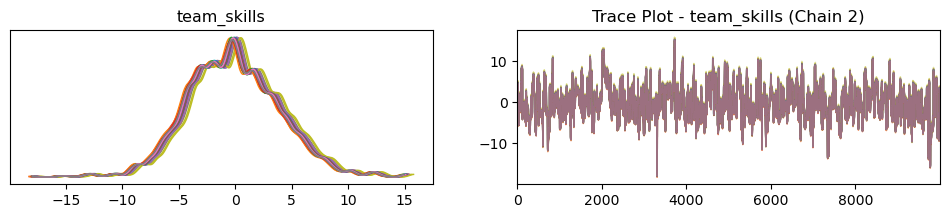

<Figure size 1000x400 with 0 Axes>

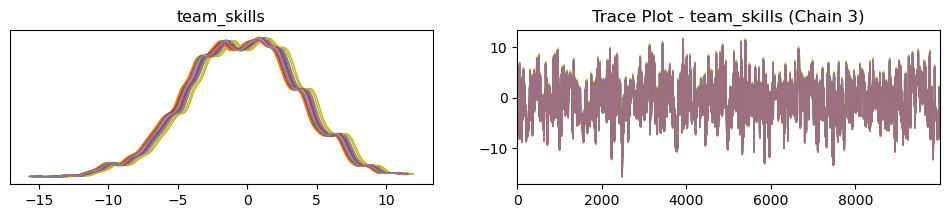

<Figure size 1000x400 with 0 Axes>

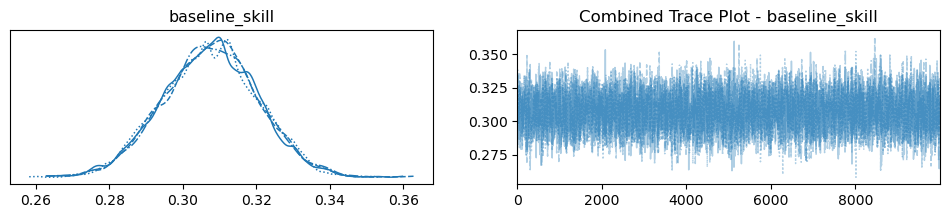

<Figure size 1000x400 with 0 Axes>

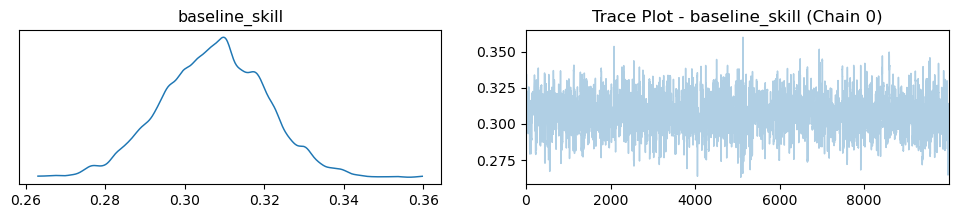

<Figure size 1000x400 with 0 Axes>

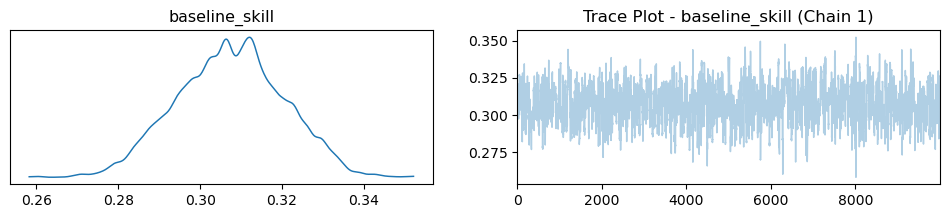

<Figure size 1000x400 with 0 Axes>

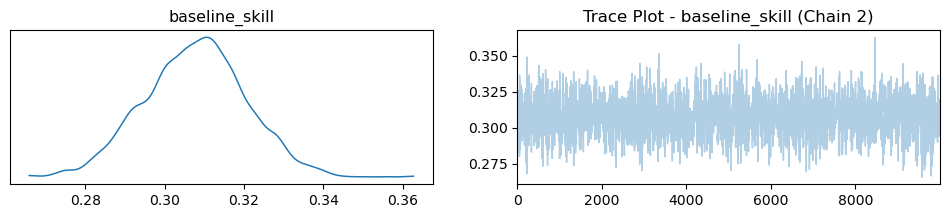

<Figure size 1000x400 with 0 Axes>

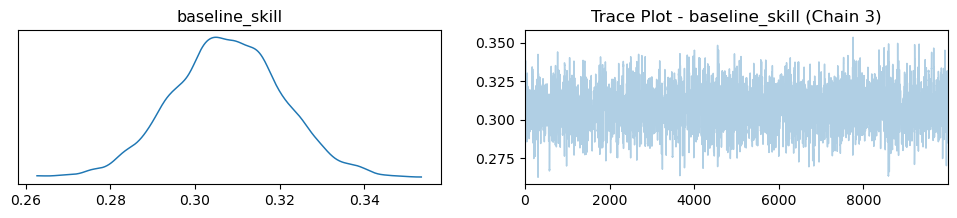

<Figure size 1000x400 with 0 Axes>

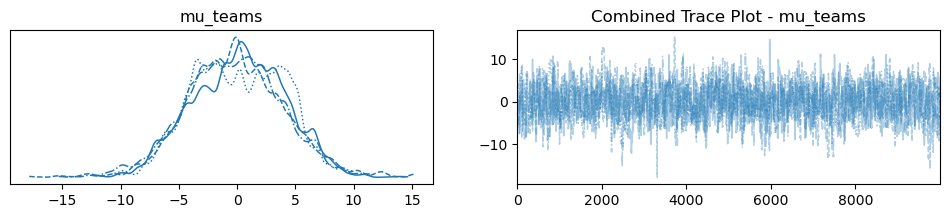

<Figure size 1000x400 with 0 Axes>

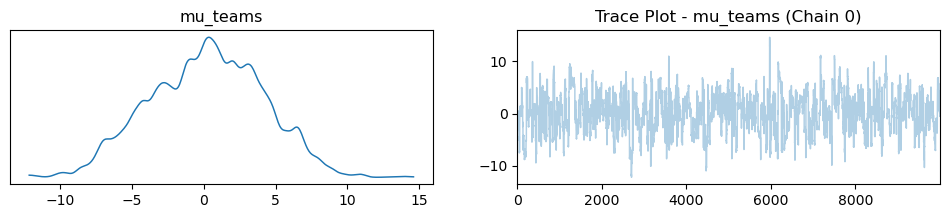

<Figure size 1000x400 with 0 Axes>

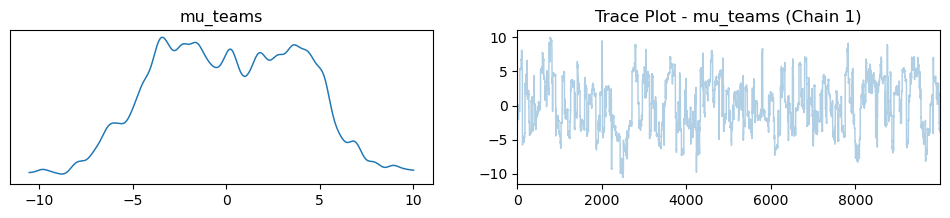

<Figure size 1000x400 with 0 Axes>

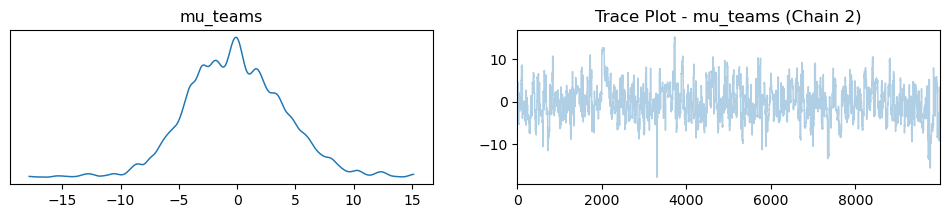

<Figure size 1000x400 with 0 Axes>

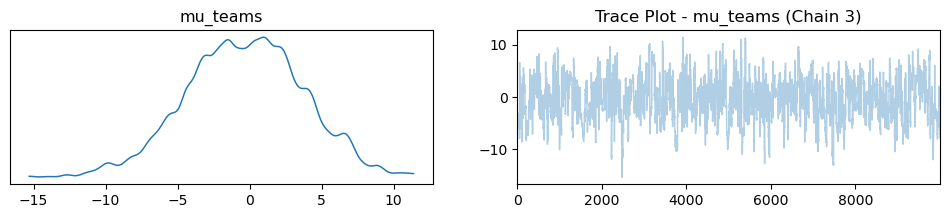

<Figure size 1000x400 with 0 Axes>

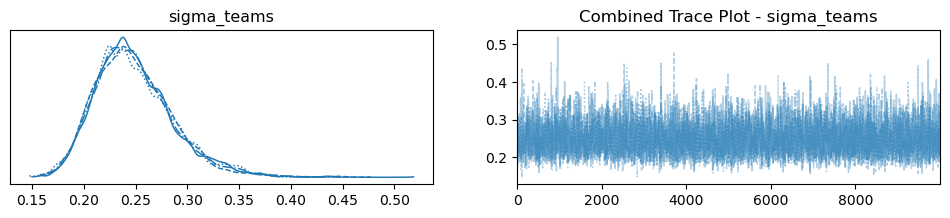

<Figure size 1000x400 with 0 Axes>

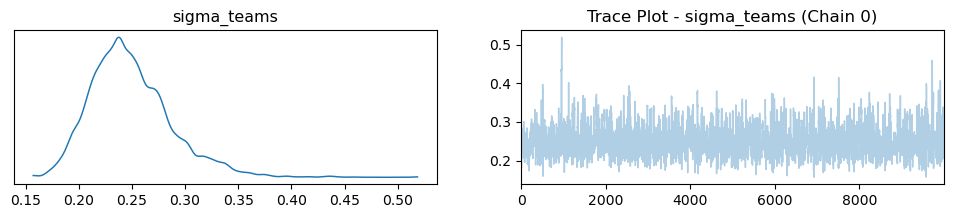

<Figure size 1000x400 with 0 Axes>

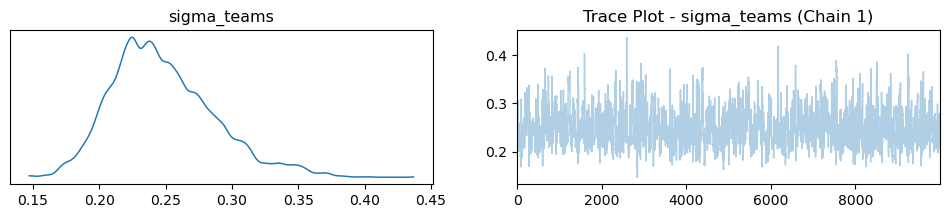

<Figure size 1000x400 with 0 Axes>

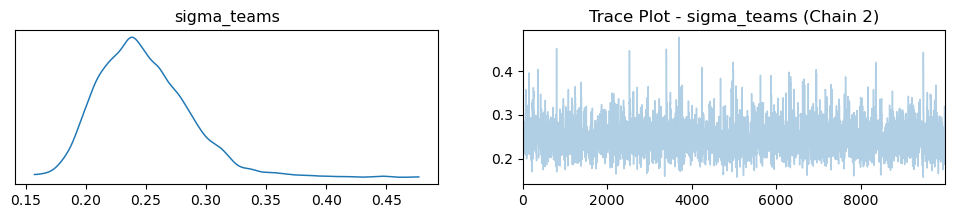

<Figure size 1000x400 with 0 Axes>

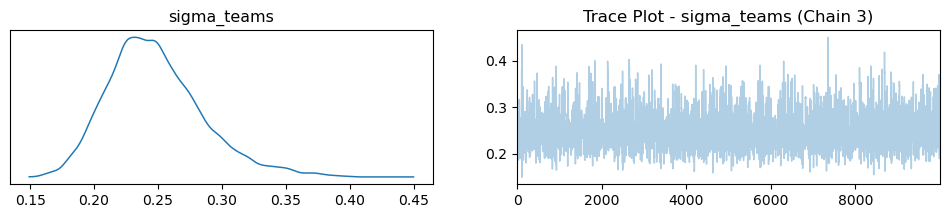

In [65]:
plot_trace_combined(trace_base, 'team_skills')
plot_trace_by_chain(trace_base, 'team_skills')
plot_trace_combined(trace_base, 'baseline_skill')
plot_trace_by_chain(trace_base, 'baseline_skill')
plot_trace_combined(trace_base, 'mu_teams')
plot_trace_by_chain(trace_base, 'mu_teams')
plot_trace_combined(trace_base, 'sigma_teams')
plot_trace_by_chain(trace_base, 'sigma_teams')

##### Save the model trace plots

In [19]:
def save_arviz_plots(trace, parameters=None):
    """
    Saves ArviZ trace plots for each specified parameter in the trace with figsize (16, 4).

    Args:
    - trace: Trace object from a PyMC model.
    - parameters: List of parameter names to plot and save.
    """
    default_parameters = ['team_skills', 'baseline_skill', 'mu_teams', 'sigma_teams']
    
    if parameters is None:
        parameters = default_parameters
    
    for param in parameters:
        if param not in trace.posterior.data_vars:
            print(f"Warning: Parameter '{param}' not found in trace. Skipping.")
            continue

        # Generate trace plot with specified figure size
        axes = az.plot_trace(trace, var_names=[param], figsize=(16, 4))
        
        # Retrieve the figure object from the first axis in axes
        fig = axes.ravel()[0].figure
        fig.tight_layout()  # Adjust layout for better visuals
        fig.savefig(f"{param}_trace_plot.png", dpi=300)
        plt.close(fig)  # Close the figure to free up memory


In [ ]:
# Save trace plots for all parameters
save_arviz_plots(trace_base)

#### 1.3 Summary Statistics 

In [67]:
def summarize_model(trace, parameter):
    summary = az.summary(trace, var_names=[parameter])
    return summary

In [120]:
summarize_model(trace_base, "team_skills")


,mean,sd,hdi_3%,hdi_97%,mcse_mean,mcse_sd,ess_bulk,ess_tail,r_hat
team_skills[0],0.162,4.006,-7.130,7.324,0.142,0.101,795.0,1402.0,1.0
team_skills[1],-0.146,4.006,-7.429,7.030,0.142,0.101,795.0,1399.0,1.0
team_skills[2],-0.125,4.006,-7.419,7.038,0.142,0.101,795.0,1397.0,1.0
team_skills[3],-0.389,4.007,-7.640,6.836,0.142,0.101,795.0,1423.0,1.0
team_skills[4],0.037,4.006,-7.242,7.215,0.142,0.101,795.0,1401.0,1.0
team_skills[5],-0.188,4.006,-7.453,7.003,0.142,0.101,796.0,1407.0,1.0
team_skills[6],-0.034,4.006,-7.351,7.099,0.142,0.101,795.0,1408.0,1.0
team_skills[7],0.280,4.006,-6.964,7.478,0.142,0.101,795.0,1402.0,1.0
team_skills[8],0.446,4.005,-6.804,7.654,0.142,0.101,795.0,1399.0,1.0
team_skills[9],-0.152,4.006,-7.449,7.004,0.142,0.101,795.0,1402.0,1.0


In [121]:
summarize_model(trace_base, "baseline_skill")


,mean,sd,hdi_3%,hdi_97%,mcse_mean,mcse_sd,ess_bulk,ess_tail,r_hat
baseline_skill,0.308,0.013,0.283,0.331,0.0,0.0,5560.0,6388.0,1.0


In [122]:
summarize_model(trace_base, 'mu_teams')


,mean,sd,hdi_3%,hdi_97%,mcse_mean,mcse_sd,ess_bulk,ess_tail,r_hat
mu_teams,-0.032,4.006,-7.317,7.14,0.142,0.101,795.0,1413.0,1.0


In [123]:
summarize_model(trace_base, 'sigma_teams')

,mean,sd,hdi_3%,hdi_97%,mcse_mean,mcse_sd,ess_bulk,ess_tail,r_hat
sigma_teams,0.248,0.038,0.181,0.32,0.001,0.0,5213.0,5620.0,1.0


#### 1.4 Posterior Predictive Check (PPC)

In [21]:
def save_ppc_plot(model, trace, filename="ppc_plot.png"):
    """
    Generates, saves, and displays a posterior predictive check (PPC) plot for a given model and trace.
    Optionally returns the PPC data for further use.

    Args:
        model: The PyMC model used to generate posterior predictive samples.
        trace: Trace data from the posterior sampling.
        filename: Optional; The name of the file to save the plot (e.g., 'ppc_plot.png').

    Returns:
        ppc: Posterior predictive samples for further analysis if needed.
    """
    # Perform posterior predictive check (PPC) sampling
    ppc = pm.sample_posterior_predictive(trace, model=model)
    
    # Plot PPC and save
    plt.figure(figsize=(12, 6))
    az.plot_ppc(ppc, figsize=(12, 6))
    
    # Save and show the plot
    plt.tight_layout()
    plt.savefig(filename, dpi=300)
    print(f"PPC plot saved as '{filename}'")
    
    # Display the plot
    plt.show()
    
    # Return the PPC data
    return ppc


Sampling: [away_goals_observed, home_goals_observed]


Output()

PPC plot saved as 'ppc_base.png'


<Figure size 1200x600 with 0 Axes>

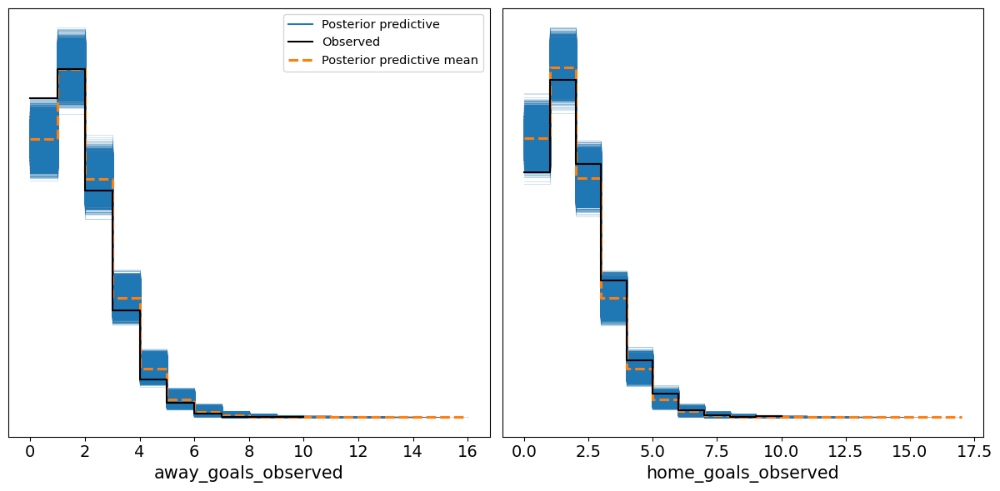

In [107]:
ppc_base = save_ppc_plot(model_base, trace_base, "ppc_base.png") 


#### 1.5 Model Comparison Metrics (LOO and WAIC)

In [22]:
def calculate_model_comparison_metrics(trace, var_names=['home_goals_observed', 'away_goals_observed']):
    metrics = {}
    for var in var_names:
        loo = az.loo(trace, var_name=var, scale="deviance")
        waic = az.waic(trace, var_name=var, scale="deviance")
        metrics[var] = {'LOO': loo, 'WAIC': waic}
        print(f"{var} - LOO: \n", loo)
        print(f"{var} - WAIC: \n", waic)
    return metrics

In [127]:
metrics = calculate_model_comparison_metrics(trace_base)


home_goals_observed - LOO: 
 Computed from 40000 posterior samples and 2280 observations log-likelihood matrix.

             Estimate       SE
deviance_loo  6989.97    72.98
p_loo           13.97        -
------

Pareto k diagnostic values:
                         Count   Pct.
(-Inf, 0.5]   (good)     2280  100.0%
 (0.5, 0.7]   (ok)          0    0.0%
   (0.7, 1]   (bad)         0    0.0%
   (1, Inf)   (very bad)    0    0.0%

home_goals_observed - WAIC: 
 Computed from 40000 posterior samples and 2280 observations log-likelihood matrix.

              Estimate       SE
deviance_waic  6989.97    72.98
p_waic           13.97        -
away_goals_observed - LOO: 
 Computed from 40000 posterior samples and 2280 observations log-likelihood matrix.

             Estimate       SE
deviance_loo  6588.17    60.55
p_loo           12.89        -
------

Pareto k diagnostic values:
                         Count   Pct.
(-Inf, 0.5]   (good)     2280  100.0%
 (0.5, 0.7]   (ok)          0    0.0%
 

#### 1.6 Calculating error metrics (MAE and RMSE)

In [23]:
def calculate_errors(ppc, df, var_name_true, var_name_pred):
    """
    Calculates MAE and RMSE between true values and predicted values from PPC.

    Args:
        ppc (arviz.InferenceData): Posterior predictive samples.
        df (pd.DataFrame): DataFrame containing the true data.
        var_name_true (str): Column name in df for true values.
        var_name_pred (str): Variable name in PPC for predicted values.

    Returns:
        mae (float): Mean Absolute Error.
        rmse (float): Root Mean Squared Error.
    """
    # Predicted mean values
    pred_mean = ppc.posterior_predictive[var_name_pred].mean(dim=("chain", "draw")).values

    # True values from df
    true_values = df[var_name_true].values

    # Calculate MAE and RMSE
    mae = mean_absolute_error(true_values, pred_mean)
    rmse = np.sqrt(mean_squared_error(true_values, pred_mean))

    print(f"{var_name_true} - MAE: {mae}, RMSE: {rmse}")
    return mae, rmse


In [131]:
# For hom team goals
home_mae, home_rmse = calculate_errors(ppc_base, df_18_24, 'Home_Goals', 'home_goals_observed')

# For away team goals
away_mae, away_rmse = calculate_errors(ppc_base, df_18_24, 'Away_Goals', 'away_goals_observed')


Home_Goals - MAE: 0.9537935197368421, RMSE: 1.2368594612071682
Away_Goals - MAE: 0.9261240131578947, RMSE: 1.1603246756246661


In [24]:
def calculate_and_plot_roc_auc_from_ppc(ppc, df):
    """
    Uses existing PPC samples to calculate ROC AUC and plot the ROC curve.

    Args:
        ppc (arviz.InferenceData): Posterior predictive samples.
        df (pd.DataFrame): DataFrame containing the true data.

    Returns:
        roc_auc (float): ROC AUC value.
    """
    # 1. Predicted goals
    pred_home_goals = ppc.posterior_predictive['home_goals_observed'].values
    pred_away_goals = ppc.posterior_predictive['away_goals_observed'].values

    # 2. True goal counts extracted from df
    home_goals_true = df['Home_Goals'].values
    away_goals_true = df['Away_Goals'].values

    # 3. Calculating the probability of home team winning
    # Taking the mean over all chains and draws
    prob_home_win = (pred_home_goals > pred_away_goals).mean(axis=(0, 1))

    # 4. True labels (home team win = 1, others = 0)
    actual_home_win = (home_goals_true > away_goals_true).astype(int)

    # 5. Calculating ROC Curve and AUC
    fpr, tpr, thresholds = roc_curve(actual_home_win, prob_home_win)
    roc_auc = auc(fpr, tpr)

    # 6. Plotting the ROC Curve
    plt.figure()
    plt.plot(fpr, tpr, color='darkorange',
             label='ROC curve (AUC = %0.2f)' % roc_auc)
    plt.plot([0, 1], [0, 1], color='navy', linestyle='--')
    plt.xlim([0.0, 1.0])
    plt.ylim([0.0, 1.05])
    plt.xlabel('False Positive Rate')
    plt.ylabel('True Positive Rate')
    plt.title('ROC Curve - Home Team Win Prediction')
    plt.legend(loc="lower right")
    plt.show()

    return roc_auc

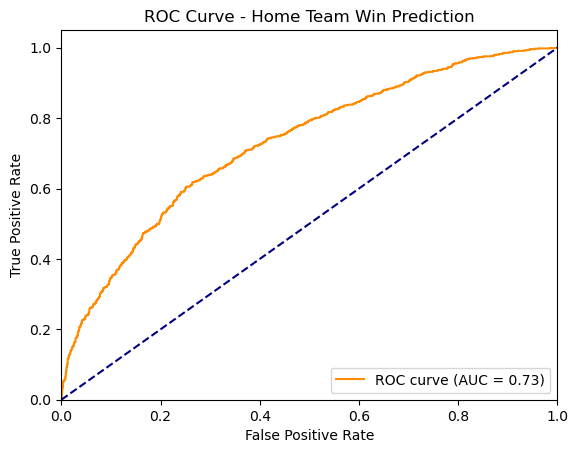

ROC AUC Value: 0.7284022291761838


In [133]:
roc_auc = calculate_and_plot_roc_auc_from_ppc(ppc_base, df_18_24)
print(f"ROC AUC Value: {roc_auc}")

#### 1.7 Energy Plot

In [25]:
def plot_energy(trace):
    """
    Plots the energy plot for the given trace.

    Args:
        trace (arviz.InferenceData): Trace object containing the model results.
    """
    az.plot_energy(trace)
    plt.show()

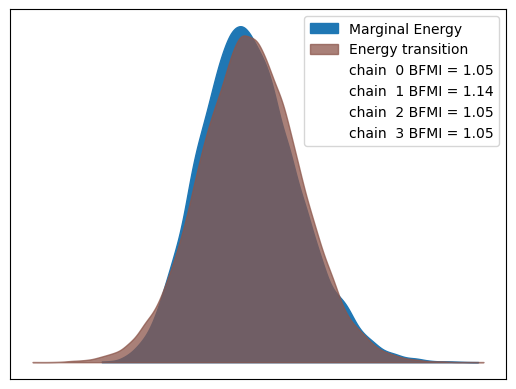

In [ ]:
plot_energy(trace_base)

#### 1.8 Shape of the Main Parameters

In [24]:
def print_posterior_shapes(trace, variable_names = ['team_skills', 'baseline_skill']):
    """
    Prints the shapes of specified variables from the posterior.

    Args:
        trace (arviz.InferenceData): The trace object containing the model results.
        variable_names (list): A list of variable names to inspect.

    Example:
        print_posterior_shapes(trace_base_18_23, ['team_skills', 'baseline_skill'])
    """
    for var_name in variable_names:
        if var_name in trace.posterior:
            var_data = trace.posterior[var_name]
            print(f"{var_name} shape: {var_data.shape}")
        else:
            print(f"{var_name} not found in posterior.")


In [136]:
print_posterior_shapes(trace_base)


team_skills shape: (4, 10000, 28)
baseline_skill shape: (4, 10000)


#### 1.9 Model Comperison

In [25]:
def compare_models(model_traces, ic='loo', var_name=None):
    """
    Compares models using the specified information criterion (LOO or WAIC).
    
    Args:
        model_traces (dict): Dictionary containing model names and InferenceData traces.
        ic (str): Information criterion to use ('loo' or 'waic'). Default: 'loo'
        var_name (str): The name of the log-likelihood variable to use. If None, 
                        an error may occur if multiple log-likelihood arrays are present.
        
    Returns:
        comparison_df (pd.DataFrame): DataFrame containing the comparison results.
    """
    # Compare models using ArviZ
    comparison_df = az.compare(model_traces, ic=ic, var_name=var_name)
    
    # Print the comparison table
    print(comparison_df)
    
    # Plot the comparison results
    az.plot_compare(comparison_df)
    plt.show()
    
    return comparison_df



#### 1.10 Visualize Team Skills

In [26]:
def visualize_team_skills(df, trace, filename=None):
    """
    Visualizes team skills using team IDs and names, sorted from strongest to weakest,
    and optionally saves the plot.

    Parameters:
    - df: Pandas DataFrame containing the match data with team names and IDs.
    - trace: ArviZ trace object containing the team skills.
    - filename: Optional; the name of the file to save the plot (e.g., 'trace_base.png').

    Returns:
    - None (displays a sorted bar plot of team skills).
    """
    # Get the summary statistics for team skills from the trace
    summary_df = az.summary(trace, var_names=["team_skills"], fmt="wide")
    
    # Extract team IDs from the summary DataFrame's index
    team_ids = [int(col.split('[')[-1].strip(']')) for col in summary_df.index]
    
    # Create a mapping from team IDs to team names using the input DataFrame
    team_id_to_name = dict(zip(df['Home_Team_ID'], df['Home_Team']))
    
    # Map team IDs to names and extract the corresponding skill values
    team_names = [team_id_to_name[team_id] for team_id in team_ids]
    team_skills = summary_df['mean'].values
    
    # Sort teams by their skills
    sorted_indices = np.argsort(team_skills)[::-1]  # Sort descending
    sorted_team_names = np.array(team_names)[sorted_indices]
    sorted_team_skills = team_skills[sorted_indices]
    
    # Color coding for positive and negative skills
    colors = ['red' if skill < 0 else 'blue' for skill in sorted_team_skills]
    
    # Create the bar plot
    plt.figure(figsize=(12, 6))
    plt.bar(sorted_team_names, sorted_team_skills, color=colors)
    plt.xlabel('Team Name')
    plt.ylabel('Team Skill')
    plt.title('Team Skills (Sorted)')
    plt.xticks(rotation=90)
    plt.axhline(0, color='black', linewidth=0.8)  # Add a horizontal line at y=0
    
    # Kaydetme seçeneği
    if filename is None:
        filename = f"{trace.__class__.__name__}.png"
    plt.tight_layout()
    plt.savefig(filename, dpi=300)
    print(f"Plot saved as '{filename}'")
    
    # Show the plot
    plt.show()


Plot saved as 'base_team_skill.png'


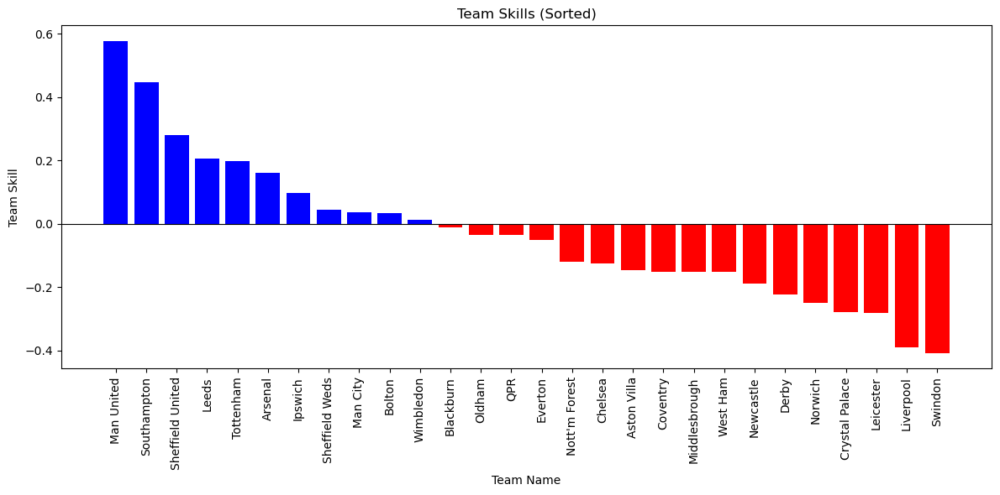

In [207]:
visualize_team_skills(df, trace_base, filename="base_team_skill.png")


#### 1.11 Forest Plot

In [40]:
def summarize_and_plot_forest(trace, parameter):
    # Plot the forest plot for the specified parameter
    az.plot_forest(trace, var_names=[parameter], combined=True)
    plt.title(f"Forest Plot for {parameter}")
    plt.show()
    
    return 



In [ ]:
summary_base = summarize_and_plot_forest(trace_base, "team_skills")

## 2. Base Model with HalfNormal

In [38]:
def base_model_with_half_normal(data, n_samples=10000, n_tune=2000):
    
    # Determine unique team names and number of games
    unique_teams = np.unique(data[['Home_Team', 'Away_Team']].values)
    n_teams = len(unique_teams)
    n_games = data.shape[0]

    # Get team IDs and goals
    home_team_ids = data['Home_Team_ID'].values
    away_team_ids = data['Away_Team_ID'].values
    home_goals = data['Home_Goals'].values
    away_goals = data['Away_Goals'].values
    
    with pm.Model() as model:  
        
        # Hyperpriors
        mu_teams = pm.Normal('mu_teams', mu=0, sigma=4)
        sigma_teams = pm.HalfNormal('sigma_teams', sigma=3)
        
        # Prior for baseline skill
        baseline_skill = pm.Normal('baseline_skill', mu=0, sigma=4)
        
        # Prior for team skills 
        team_skills = pm.Normal('team_skills', mu=mu_teams, sigma=sigma_teams, shape=n_teams)
        
        # Likelihood for observed goals
        lambda_home_goals = pm.Deterministic('lambda_home_goals', pm.math.exp(baseline_skill + team_skills[home_team_ids] - team_skills[away_team_ids]))
        lambda_away_goals = pm.Deterministic('lambda_away_goals', pm.math.exp(baseline_skill + team_skills[away_team_ids] - team_skills[home_team_ids]))

        # Observed goal data
        home_goals_observed = pm.Poisson('home_goals_observed', mu=lambda_home_goals, observed=home_goals)
        away_goals_observed = pm.Poisson('away_goals_observed', mu=lambda_away_goals, observed=away_goals)
        
        # Sample the model
        trace = pm.sample(n_samples, tune=n_tune, cores=4, return_inferencedata=True, idata_kwargs={'log_likelihood': True})
        
    return model, trace  


In [39]:
# Getting Model and Trace
model_base_halfnormal, trace_base_halfnormal = base_model_with_half_normal(df_18_24)

Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [mu_teams, sigma_teams, baseline_skill, team_skills]


Output()

Sampling 4 chains for 2_000 tune and 10_000 draw iterations (8_000 + 40_000 draws total) took 384 seconds.


In [38]:
gc.collect()

0

#### 1.1 Summay of the parameters

In [ ]:
total_params = summarize_posterior(trace_base_halfnormal)

Posterior Variables: ['baseline_skill', 'lambda_away_goals', 'lambda_home_goals', 'mu_teams', 'sigma_teams', 'team_skills']
Total Parameters: 183640000


#### 1.2 Trace Plots

<Figure size 1000x400 with 0 Axes>

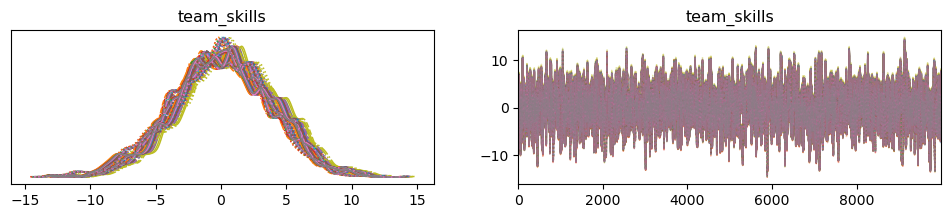

<Figure size 1000x400 with 0 Axes>

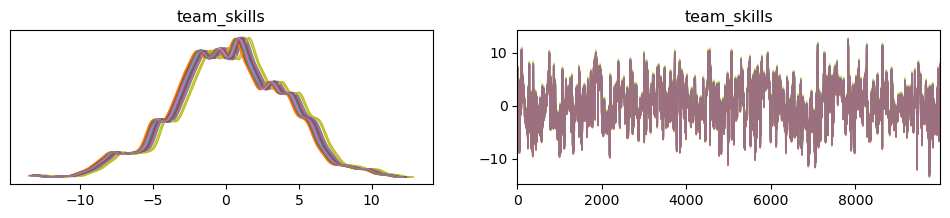

<Figure size 1000x400 with 0 Axes>

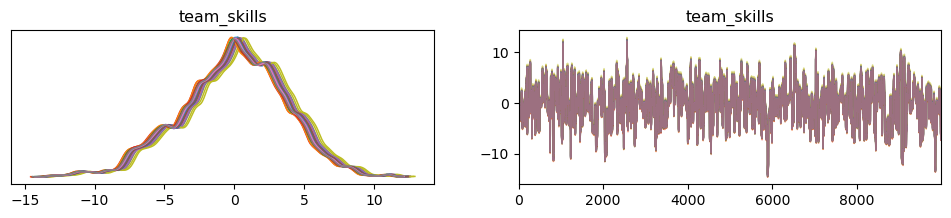

<Figure size 1000x400 with 0 Axes>

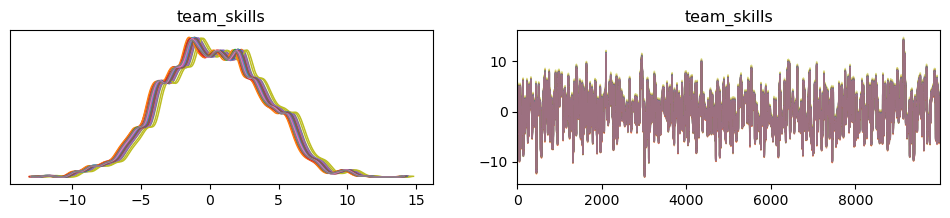

<Figure size 1000x400 with 0 Axes>

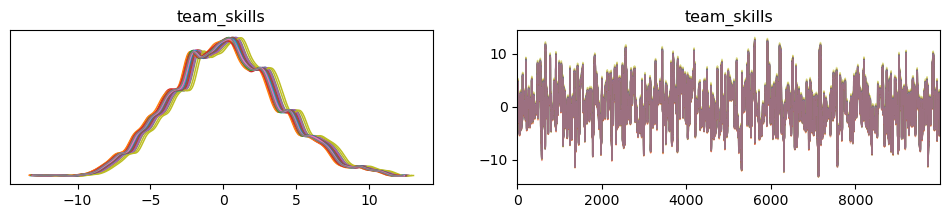

<Figure size 1000x400 with 0 Axes>

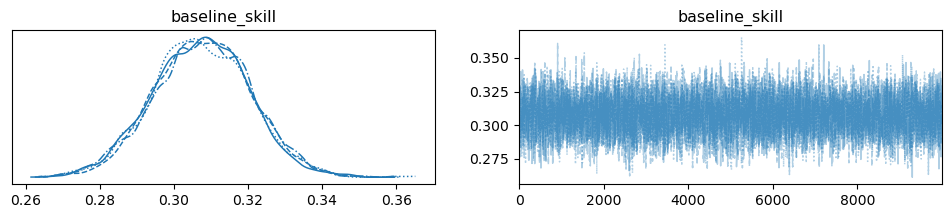

<Figure size 1000x400 with 0 Axes>

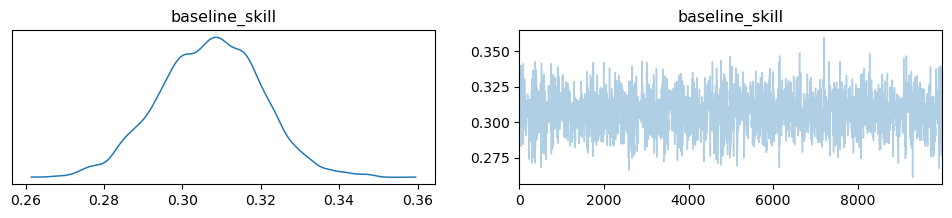

<Figure size 1000x400 with 0 Axes>

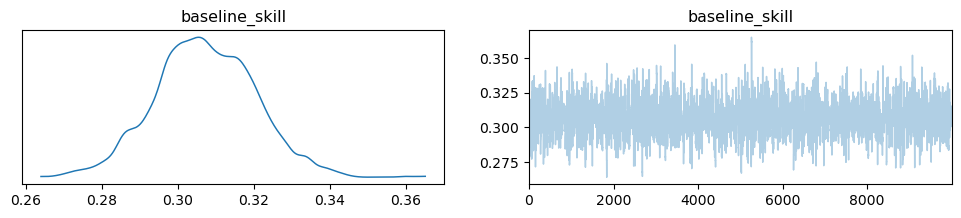

<Figure size 1000x400 with 0 Axes>

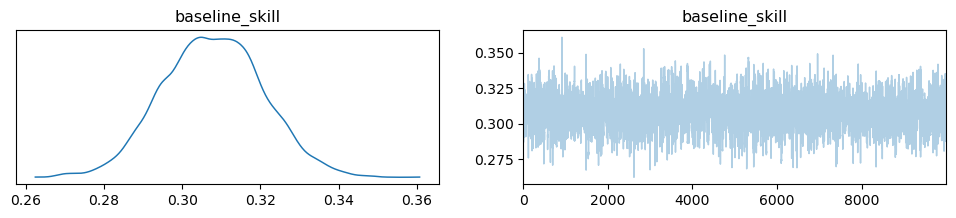

<Figure size 1000x400 with 0 Axes>

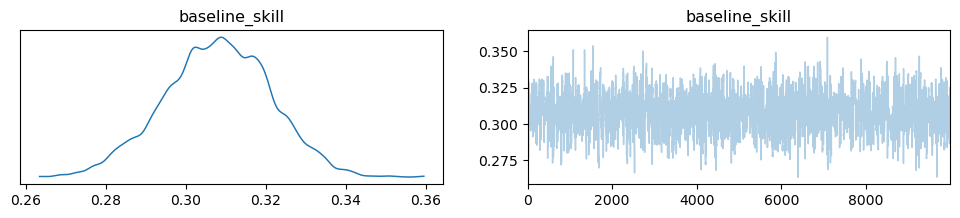

<Figure size 1000x400 with 0 Axes>

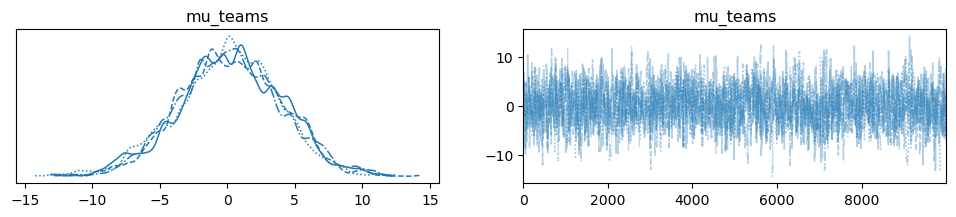

<Figure size 1000x400 with 0 Axes>

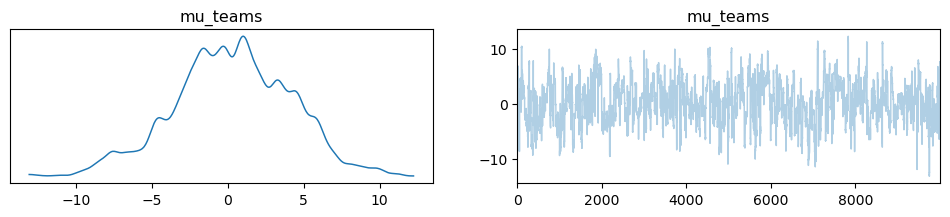

<Figure size 1000x400 with 0 Axes>

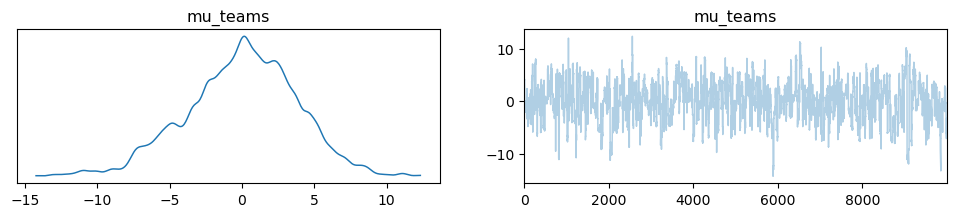

<Figure size 1000x400 with 0 Axes>

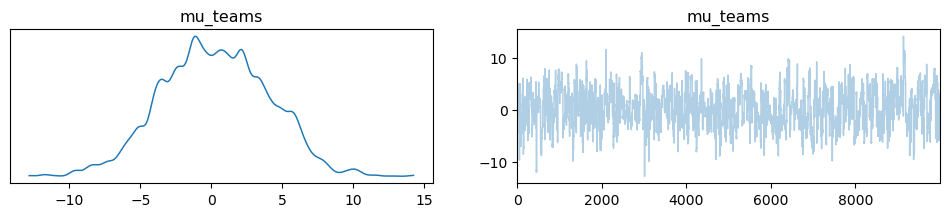

<Figure size 1000x400 with 0 Axes>

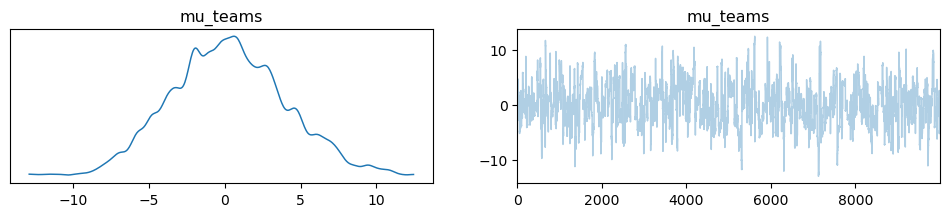

<Figure size 1000x400 with 0 Axes>

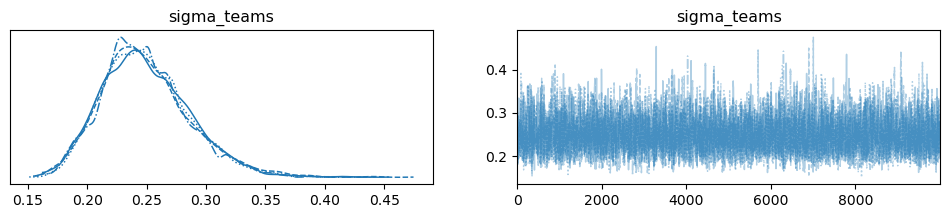

<Figure size 1000x400 with 0 Axes>

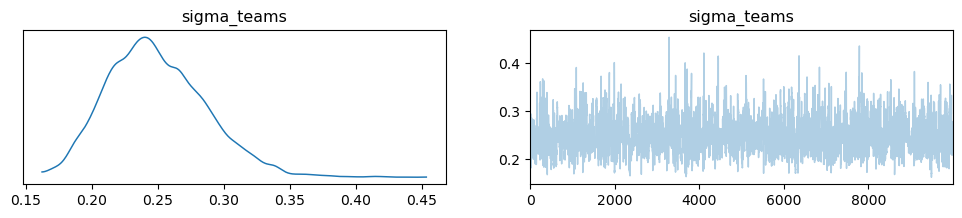

<Figure size 1000x400 with 0 Axes>

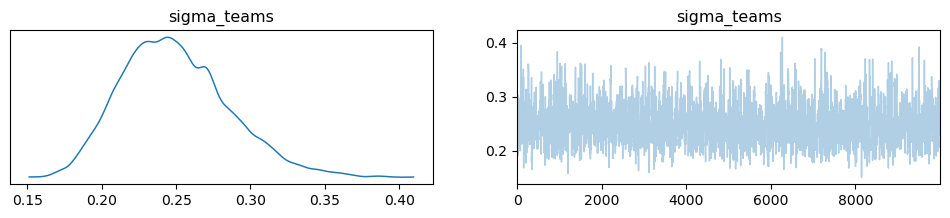

<Figure size 1000x400 with 0 Axes>

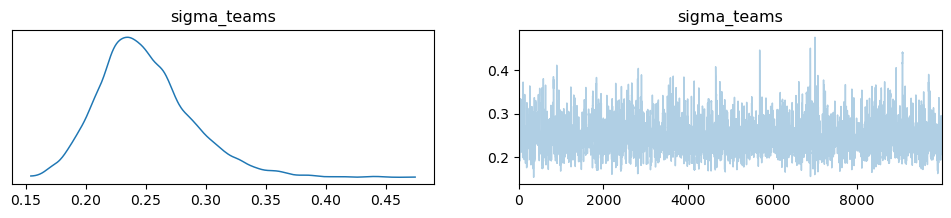

<Figure size 1000x400 with 0 Axes>

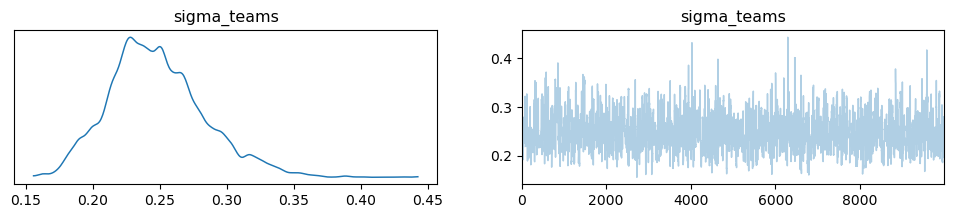

In [141]:
plot_trace_combined(trace_base_halfnormal, 'team_skills')
plot_trace_by_chain(trace_base_halfnormal, 'team_skills')
plot_trace_combined(trace_base_halfnormal, 'baseline_skill')
plot_trace_by_chain(trace_base_halfnormal, 'baseline_skill')
plot_trace_combined(trace_base_halfnormal, 'mu_teams')
plot_trace_by_chain(trace_base_halfnormal, 'mu_teams')
plot_trace_combined(trace_base_halfnormal, 'sigma_teams')
plot_trace_by_chain(trace_base_halfnormal, 'sigma_teams')

In [89]:
save_arviz_plots(trace_base_halfnormal)

#### 1.3 Summary Statistics of Model Parameters

In [65]:
def save_arviz_plots(trace, parameters=None, figsize=(16, 4), dpi=300):
    """
    Saves each ArviZ trace plot as a separate PNG file with the specified figure size and DPI.
    
    Args:
    - trace: Trace object from a PyMC model.
    - parameters: List of parameter names to plot and save.
    - figsize: Tuple for figure size (width, height).
    - dpi: Resolution in dots per inch for the saved plot.
    """
    default_parameters = ['team_skills', 'baseline_skill', 'mu_teams', 'sigma_teams']
    
    if parameters is None:
        parameters = default_parameters
    
    for param in parameters:
        if param not in trace.posterior.data_vars:
            print(f"Warning: Parameter '{param}' not found in trace. Skipping.")
            continue

        # Create the trace plot with custom figsize
        axes = az.plot_trace(trace, var_names=[param], figsize=figsize)
        
        # Retrieve the figure object from the first axis
        fig = axes.ravel()[0].figure
        fig.tight_layout()
        fig.savefig(f"{param}_trace_plot.png", dpi=dpi)  # Save each trace plot as a separate PNG
        plt.close(fig)  # Close the figure to free up memory


In [142]:
summarize_model(trace_base_halfnormal, "team_skills")

,mean,sd,hdi_3%,hdi_97%,mcse_mean,mcse_sd,ess_bulk,ess_tail,r_hat
team_skills[0],0.377,3.811,-6.995,7.290,0.103,0.073,1374.0,1944.0,1.0
team_skills[1],0.068,3.812,-7.113,7.178,0.103,0.073,1373.0,1963.0,1.0
team_skills[2],0.090,3.812,-7.076,7.192,0.103,0.073,1374.0,1949.0,1.0
team_skills[3],-0.175,3.812,-7.544,6.727,0.103,0.073,1373.0,1965.0,1.0
team_skills[4],0.253,3.812,-6.945,7.341,0.103,0.073,1374.0,1946.0,1.0
team_skills[5],0.028,3.812,-7.179,7.097,0.103,0.073,1373.0,1969.0,1.0
team_skills[6],0.181,3.811,-7.077,7.208,0.103,0.073,1373.0,1964.0,1.0
team_skills[7],0.495,3.812,-6.939,7.347,0.103,0.073,1374.0,1944.0,1.0
team_skills[8],0.661,3.811,-6.634,7.648,0.103,0.073,1373.0,1960.0,1.0
team_skills[9],0.064,3.812,-7.147,7.129,0.103,0.073,1374.0,1960.0,1.0


In [143]:
summarize_model(trace_base_halfnormal, "baseline_skill")

,mean,sd,hdi_3%,hdi_97%,mcse_mean,mcse_sd,ess_bulk,ess_tail,r_hat
baseline_skill,0.308,0.013,0.283,0.332,0.0,0.0,6165.0,6455.0,1.0


In [144]:
summarize_model(trace_base_halfnormal, "mu_teams")

,mean,sd,hdi_3%,hdi_97%,mcse_mean,mcse_sd,ess_bulk,ess_tail,r_hat
mu_teams,0.183,3.811,-6.976,7.306,0.103,0.073,1374.0,1966.0,1.0


In [145]:
summarize_model(trace_base_halfnormal, "sigma_teams")

,mean,sd,hdi_3%,hdi_97%,mcse_mean,mcse_sd,ess_bulk,ess_tail,r_hat
sigma_teams,0.249,0.037,0.182,0.317,0.001,0.0,5183.0,6274.0,1.0


#### 1.4 Posterior Predictive Checks (PPC) and Other Metrics

Sampling: [away_goals_observed, home_goals_observed]


Output()

PPC plot saved as 'ppc_base.png'


<Figure size 1200x600 with 0 Axes>

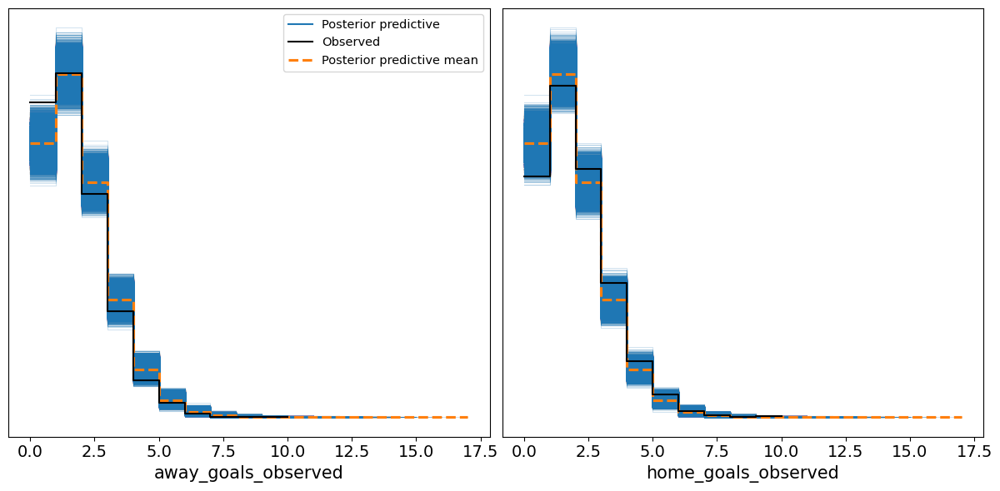

In [112]:
ppc_base_halfnormal = save_ppc_plot(model_base_halfnormal, trace_base_halfnormal, "ppc_base_halfnormal.png") 

#### 1.5 Model Comparison Metrics (LOO and WAIC)

In [146]:
metrics = calculate_model_comparison_metrics(trace_base_halfnormal)

home_goals_observed - LOO: 
 Computed from 40000 posterior samples and 2280 observations log-likelihood matrix.

             Estimate       SE
deviance_loo  6989.93    72.97
p_loo           13.96        -
------

Pareto k diagnostic values:
                         Count   Pct.
(-Inf, 0.5]   (good)     2280  100.0%
 (0.5, 0.7]   (ok)          0    0.0%
   (0.7, 1]   (bad)         0    0.0%
   (1, Inf)   (very bad)    0    0.0%

home_goals_observed - WAIC: 
 Computed from 40000 posterior samples and 2280 observations log-likelihood matrix.

              Estimate       SE
deviance_waic  6989.92    72.97
p_waic           13.96        -
away_goals_observed - LOO: 
 Computed from 40000 posterior samples and 2280 observations log-likelihood matrix.

             Estimate       SE
deviance_loo  6588.15    60.54
p_loo           12.87        -
------

Pareto k diagnostic values:
                         Count   Pct.
(-Inf, 0.5]   (good)     2280  100.0%
 (0.5, 0.7]   (ok)          0    0.0%
 

#### 1.6 Calculating error metrics (MAE and RMSE)

In [149]:
# Home teams goals
home_mae, home_rmse = calculate_errors(ppc_base_halfnormal, df_18_24, 'Home_Goals', 'home_goals_observed')

# Away Teams goals
away_mae, away_rmse = calculate_errors(ppc_base_halfnormal, df_18_24, 'Away_Goals', 'away_goals_observed')

Home_Goals - MAE: 0.953599100877193, RMSE: 1.2369181237739644
Away_Goals - MAE: 0.9259652521929825, RMSE: 1.1601978646027509


#### 1.7 Roc- Auc

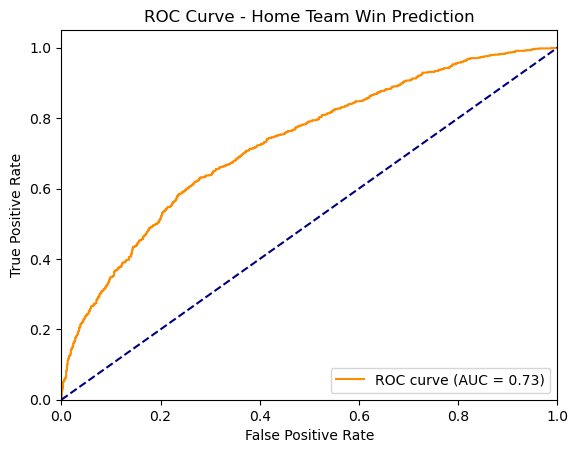

ROC AUC Value: 0.728352422139539


In [150]:
roc_auc = calculate_and_plot_roc_auc_from_ppc(ppc_base_halfnormal, df_18_24)
print(f"ROC AUC Value: {roc_auc}")

#### 1.8 Energy Plot

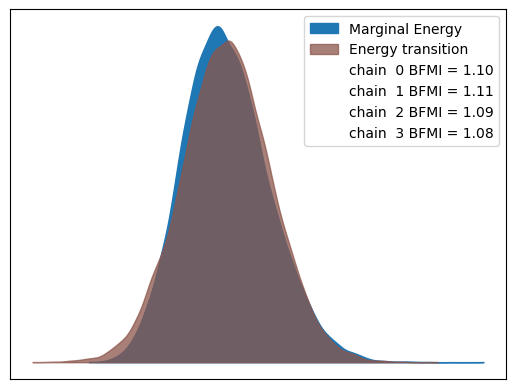

In [151]:
plot_energy(trace_base_halfnormal)

#### 1.9 Shape of the main Parameters

In [152]:
print_posterior_shapes(trace_base_halfnormal)

team_skills shape: (4, 10000, 28)
baseline_skill shape: (4, 10000)


#### 1.10 Visualize Team Skills

Plot saved as 'base_halfnormal_team_skill.png'


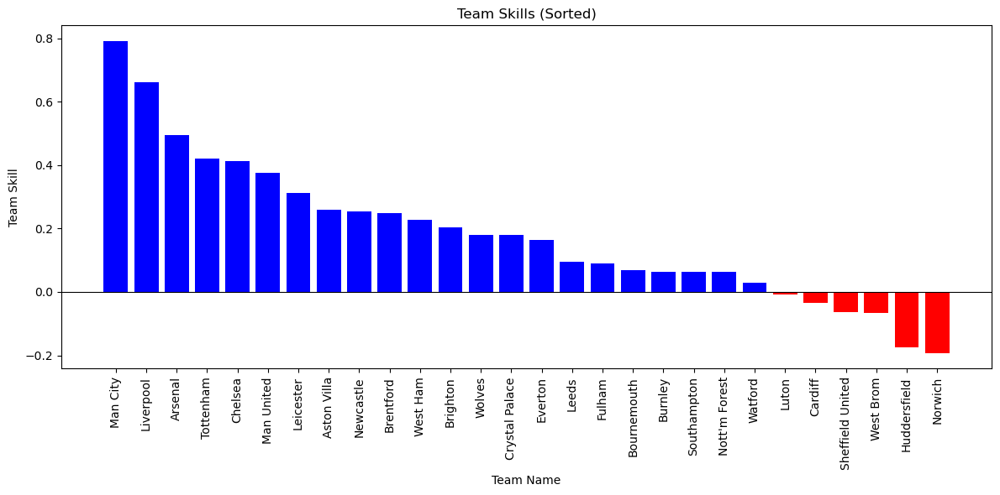

In [208]:
visualize_team_skills(df_18_24, trace_base_halfnormal, filename="base_halfnormal_team_skill.png")

## Comparing Uniform and Half-Normal Priors for Sigma

###  first iteration

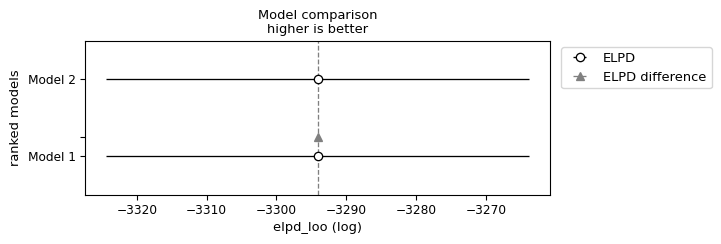

In [48]:
model_traces = {
    "Model 1": trace_base,
    "Model 2": trace_base_halfnormal}
# Comparison for Home Goals
comparison_home = az.compare(model_traces, ic="loo", var_name="home_goals_observed")
az.plot_compare(comparison_home)
# Save the plot as a PNG file
plt.savefig("BaseVsHalfNormal_comparison_home_goals.png", dpi=300, bbox_inches="tight")
plt.show()  
plt.close()

# Comparison for Away Goals
comparison_away = az.compare(model_traces, ic="loo", var_name="away_goals_observed")
az.plot_compare(comparison_away)

# Save the plot as a PNG file
plt.savefig("BaseVsHalfNormal_comparison_away_goals.png", dpi=300, bbox_inches="tight")
plt.show()  
plt.close()




In [59]:
comparison_home

,rank,elpd_loo,p_loo,elpd_diff,weight,se,dse,warning,scale
Model 2,0,-3494.964034,13.964086,0.000000,1.0,36.487424,0.000000,False,log
Model 1,1,-3494.987249,13.971265,0.023216,0.0,36.488134,0.028115,False,log


In [61]:
comparison_away

,rank,elpd_loo,p_loo,elpd_diff,weight,se,dse,warning,scale
Model 2,0,-3294.076174,12.868244,0.000000,1.0,30.272275,0.000000,False,log
Model 1,1,-3294.083461,12.885045,0.007287,0.0,30.274485,0.025874,False,log


### 2. Itaration 

In [ ]:
model_traces = {
    "Model 1": trace_base,
    "Model 2": trace_base_halfnormal}
# Comparison for Home Goals
comparison_home = az.compare(model_traces, ic="loo", var_name="home_goals_observed")
az.plot_compare(comparison_home)
# Save the plot as a PNG file
plt.savefig("BaseVsHalfNormal_comparison_home_goals_2.png", dpi=300, bbox_inches="tight")
plt.show()  
plt.close()

# Comparison for Away Goals
comparison_away = az.compare(model_traces, ic="loo", var_name="away_goals_observed")
az.plot_compare(comparison_away)

# Save the plot as a PNG file
plt.savefig("BaseVsHalfNormal_comparison_away_goals_2.png", dpi=300, bbox_inches="tight") 
plt.show() 
plt.close()





In [29]:
comparison_home


,rank,elpd_loo,p_loo,elpd_diff,weight,se,dse,warning,scale
Model 1,0,-3494.949823,13.970774,0.000000,1.0,36.483359,0.000000,False,log
Model 2,1,-3495.063294,13.999413,0.113471,0.0,36.503151,0.035131,False,log


In [30]:
comparison_away

,rank,elpd_loo,p_loo,elpd_diff,weight,se,dse,warning,scale
Model 2,0,-3294.023874,12.897873,0.0000,1.000000e+00,30.287560,0.000000,False,log
Model 1,1,-3294.097673,12.872872,0.0738,4.440892e-16,30.270584,0.032914,False,log


###  3. Itaration 

In [ ]:
model_traces = {
    "Model 1": trace_base,
    "Model 2": trace_base_halfnormal}
# Comparison for Home Goals
comparison_home = az.compare(model_traces, ic="loo", var_name="home_goals_observed")
az.plot_compare(comparison_home)
# Save the plot as a PNG file
plt.savefig("BaseVsHalfNormal_comparison_home_goals_3.png", dpi=300, bbox_inches="tight")
plt.show()  
plt.close()

# Comparison for Away Goals
comparison_away = az.compare(model_traces, ic="loo", var_name="away_goals_observed")
az.plot_compare(comparison_away)

# Save the plot as a PNG file
plt.savefig("BaseVsHalfNormal_comparison_away_goals_3.png", dpi=300, bbox_inches="tight") 
plt.show() 
plt.close()





In [40]:
comparison_home

,rank,elpd_loo,p_loo,elpd_diff,weight,se,dse,warning,scale
Model 1,0,-3494.962352,13.916695,0.00000,1.0,36.495937,0.000000,False,log
Model 2,1,-3494.987502,13.968326,0.02515,0.0,36.497384,0.024145,False,log


In [41]:
comparison_away

,rank,elpd_loo,p_loo,elpd_diff,weight,se,dse,warning,scale
Model 1,0,-3293.980806,12.833018,0.000000,1.0,30.280328,0.000000,False,log
Model 2,1,-3294.042325,12.877539,0.061518,0.0,30.284218,0.022591,False,log


### 4. Iteration 

In [ ]:
model_traces = {
    "Model 1": trace_base,
    "Model 2": trace_base_halfnormal}
# Comparison for Home Goals
comparison_home = az.compare(model_traces, ic="loo", var_name="home_goals_observed")
az.plot_compare(comparison_home)
# Save the plot as a PNG file
plt.savefig("BaseVsHalfNormal_comparison_home_goals_4.png", dpi=300, bbox_inches="tight")
plt.show() 
plt.close()
 
# Comparison for Away Goals
comparison_away = az.compare(model_traces, ic="loo", var_name="away_goals_observed")
az.plot_compare(comparison_away)

# Save the plot as a PNG file
plt.savefig("BaseVsHalfNormal_comparison_away_goals_4.png", dpi=300, bbox_inches="tight") 
plt.show() 
plt.close()





In [30]:
comparison_home

,rank,elpd_loo,p_loo,elpd_diff,weight,se,dse,warning,scale
Model 1,0,-3494.921536,13.981156,0.000000,1.0,36.483537,0.000000,False,log
Model 2,1,-3495.030904,13.963556,0.109367,0.0,36.502101,0.038879,False,log


In [31]:
comparison_away

,rank,elpd_loo,p_loo,elpd_diff,weight,se,dse,warning,scale
Model 2,0,-3293.989258,12.878524,0.000000,1.0,30.286942,0.000000,False,log
Model 1,1,-3294.143582,12.887705,0.154323,0.0,30.274814,0.036388,False,log


## 3. Base Model with Informative Priors

In [40]:
def informative_base_model(data, n_samples=10000, n_tune=2000):
    
    # Determine unique team names and number of games
    unique_teams = np.unique(data[['Home_Team', 'Away_Team']].values)
    n_teams = len(unique_teams)
    n_games = data.shape[0]

    # Get team IDs and goals
    home_team_ids = data['Home_Team_ID'].values
    away_team_ids = data['Away_Team_ID'].values
    home_goals = data['Home_Goals'].values
    away_goals = data['Away_Goals'].values

    with pm.Model() as model:  
        
        
        # Hyperpriors
        mu_teams = pm.Normal('mu_teams', mu=1.5, sigma=0.5)
        sigma_teams = pm.HalfNormal('sigma_teams', sigma=1.0)
        
        # Prior for baseline skill
        baseline_skill = pm.Normal('baseline_skill', mu=0.3, sigma=0.1)

        # Prior for team skills
        team_skills = pm.Normal('team_skills', mu=mu_teams, sigma=sigma_teams, shape=n_teams)
        
        # Likelihood for observed goals
        lambda_home_goals = pm.Deterministic('lambda_home_goals', pm.math.exp(baseline_skill + team_skills[home_team_ids] - team_skills[away_team_ids]))
        lambda_away_goals = pm.Deterministic('lambda_away_goals', pm.math.exp(baseline_skill + team_skills[away_team_ids] - team_skills[home_team_ids])
        )

        # Observed goal data
        home_goals_observed = pm.Poisson('home_goals_observed', mu=lambda_home_goals, observed=home_goals)
        away_goals_observed = pm.Poisson('away_goals_observed', mu=lambda_away_goals, observed=away_goals)
        
        # Sample the model
        trace = pm.sample(n_samples, tune=n_tune, cores=4, return_inferencedata=True, idata_kwargs={'log_likelihood': True})
    
    return model, trace


#### 1- Model Application for the 2018-2024 Period

In [41]:
# Getting Model and Trace
model_base_informative, trace_base_informative = informative_base_model(df_18_24)

Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [mu_teams, sigma_teams, baseline_skill, team_skills]


Output()

Sampling 4 chains for 2_000 tune and 10_000 draw iterations (8_000 + 40_000 draws total) took 143 seconds.


In [21]:
gc.collect()

0

#### 1.1 Summay of the parameters

In [ ]:
total_params = summarize_posterior(trace_base_informative)

Posterior Variables: ['baseline_skill', 'lambda_away_goals', 'lambda_home_goals', 'mu_teams', 'sigma_teams', 'team_skills']
Total Parameters: 183640000


#### 1.2 Trace Plots

<Figure size 1000x400 with 0 Axes>

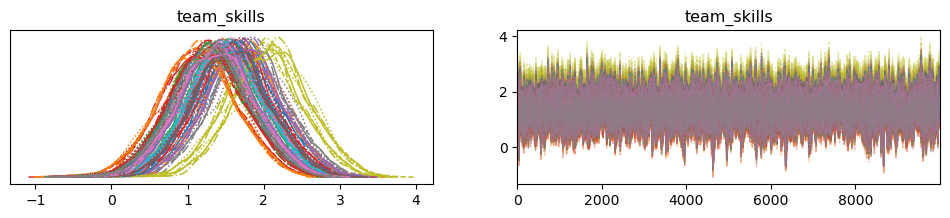

<Figure size 1000x400 with 0 Axes>

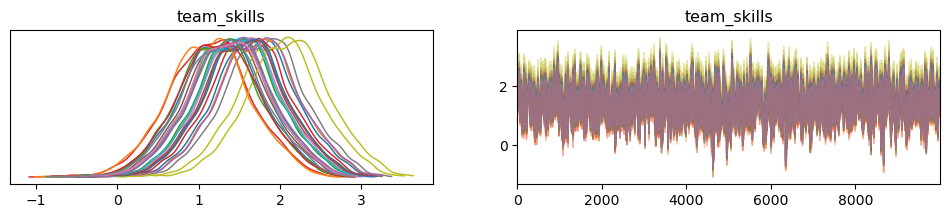

<Figure size 1000x400 with 0 Axes>

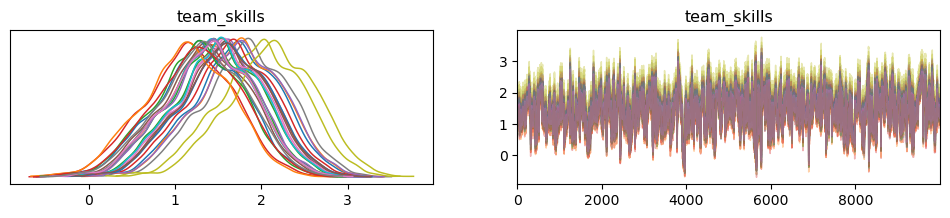

<Figure size 1000x400 with 0 Axes>

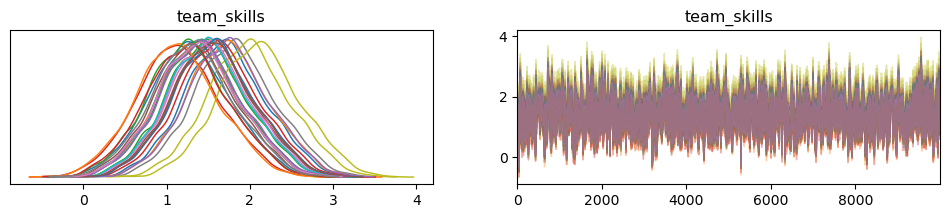

<Figure size 1000x400 with 0 Axes>

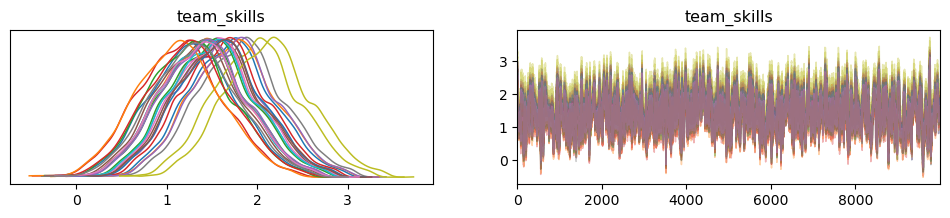

<Figure size 1000x400 with 0 Axes>

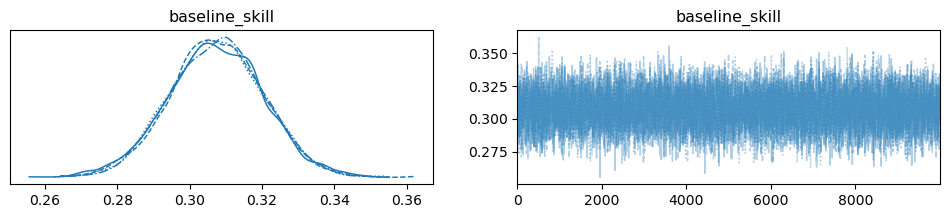

<Figure size 1000x400 with 0 Axes>

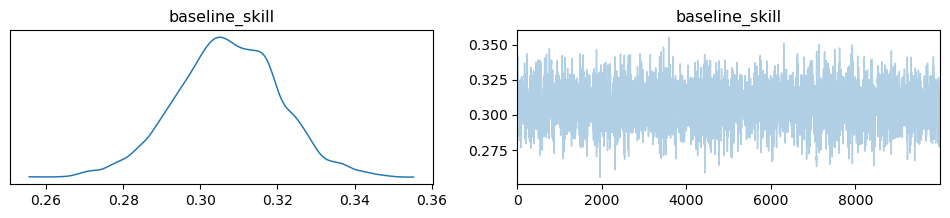

<Figure size 1000x400 with 0 Axes>

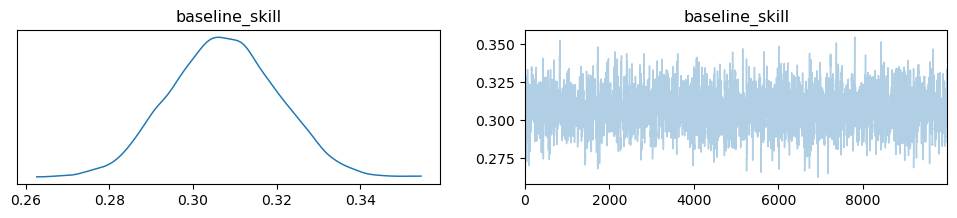

<Figure size 1000x400 with 0 Axes>

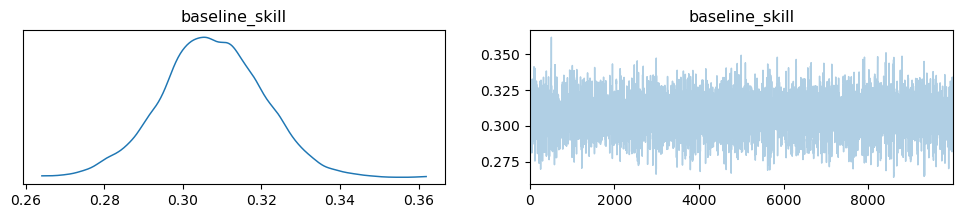

<Figure size 1000x400 with 0 Axes>

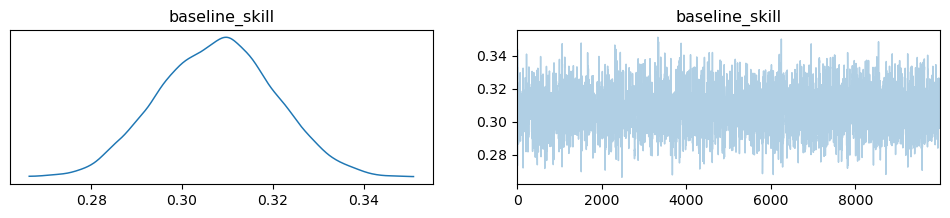

<Figure size 1000x400 with 0 Axes>

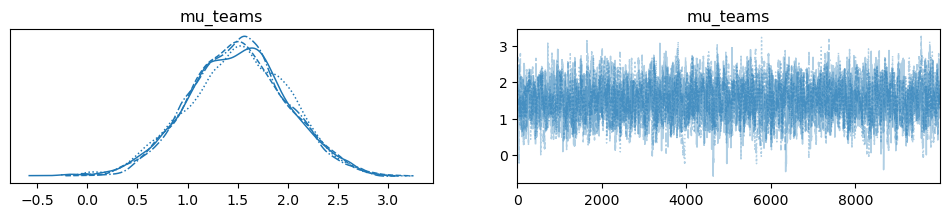

<Figure size 1000x400 with 0 Axes>

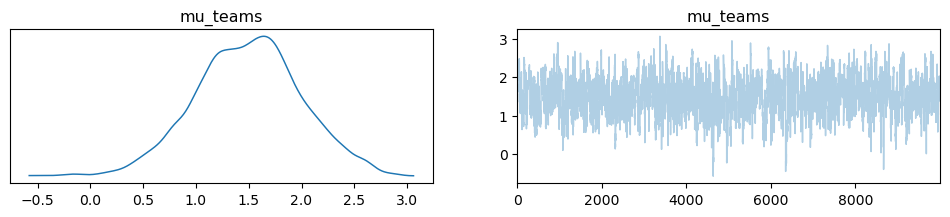

<Figure size 1000x400 with 0 Axes>

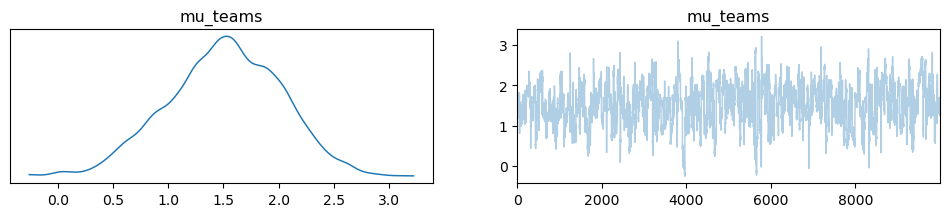

<Figure size 1000x400 with 0 Axes>

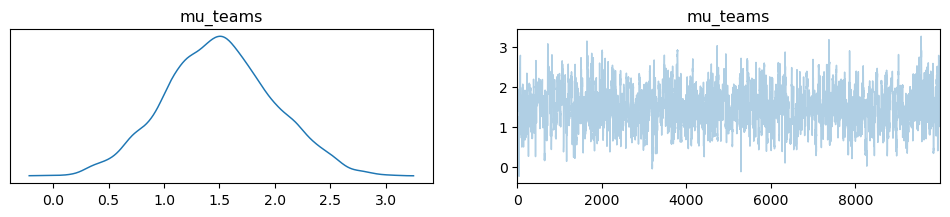

<Figure size 1000x400 with 0 Axes>

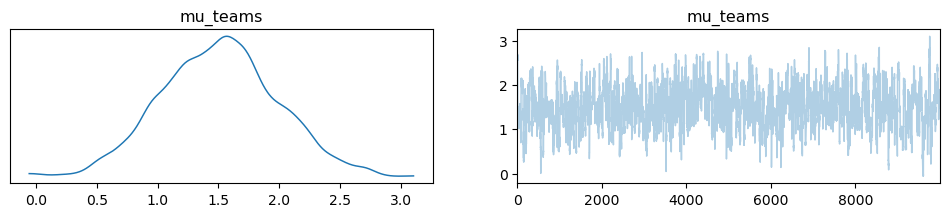

<Figure size 1000x400 with 0 Axes>

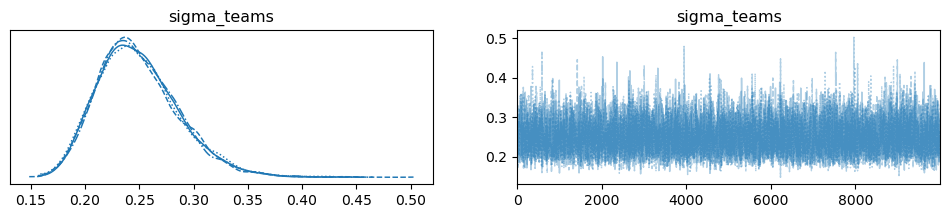

<Figure size 1000x400 with 0 Axes>

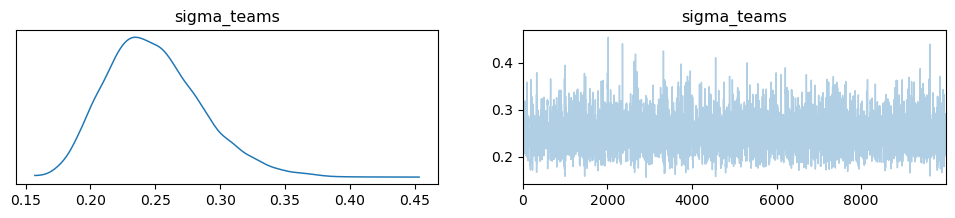

<Figure size 1000x400 with 0 Axes>

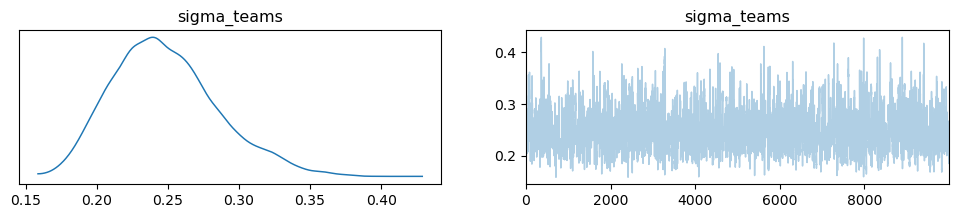

<Figure size 1000x400 with 0 Axes>

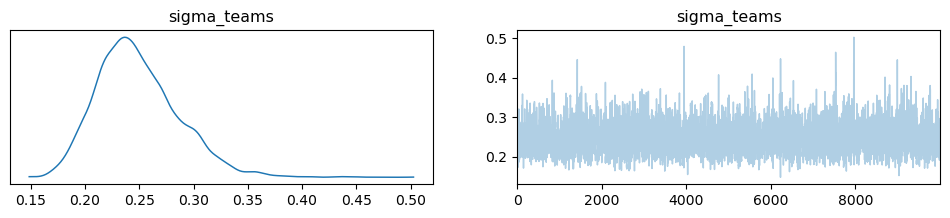

<Figure size 1000x400 with 0 Axes>

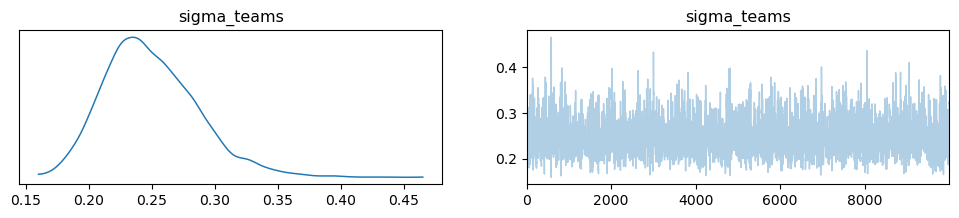

In [156]:
plot_trace_combined(trace_base_informative, 'team_skills')
plot_trace_by_chain(trace_base_informative, 'team_skills')
plot_trace_combined(trace_base_informative, 'baseline_skill')
plot_trace_by_chain(trace_base_informative, 'baseline_skill')
plot_trace_combined(trace_base_informative, 'mu_teams')
plot_trace_by_chain(trace_base_informative, 'mu_teams')
plot_trace_combined(trace_base_informative, 'sigma_teams')
plot_trace_by_chain(trace_base_informative, 'sigma_teams')

In [157]:
# Save trace plots for all parameters
save_arviz_plots(trace_base_informative)

#### 1.3 Summary Statistics of Model Parameters

In [158]:
summarize_model(trace_base_informative, "team_skills")

,mean,sd,hdi_3%,hdi_97%,mcse_mean,mcse_sd,ess_bulk,ess_tail,r_hat
team_skills[0],1.698,0.501,0.757,2.635,0.011,0.008,2050.0,2939.0,1.0
team_skills[1],1.388,0.501,0.472,2.353,0.011,0.008,2057.0,2989.0,1.0
team_skills[2],1.410,0.501,0.484,2.368,0.011,0.008,2062.0,2941.0,1.0
team_skills[3],1.146,0.507,0.219,2.122,0.011,0.008,2089.0,3134.0,1.0
team_skills[4],1.573,0.501,0.624,2.503,0.011,0.008,2048.0,2944.0,1.0
team_skills[5],1.347,0.502,0.412,2.298,0.011,0.008,2063.0,2999.0,1.0
team_skills[6],1.501,0.501,0.573,2.451,0.011,0.008,2049.0,2949.0,1.0
team_skills[7],1.815,0.501,0.899,2.779,0.011,0.008,2056.0,2956.0,1.0
team_skills[8],1.981,0.501,1.064,2.939,0.011,0.008,2053.0,2910.0,1.0
team_skills[9],1.383,0.501,0.450,2.329,0.011,0.008,2054.0,2949.0,1.0


In [159]:
summarize_model(trace_base_informative, "baseline_skill")

,mean,sd,hdi_3%,hdi_97%,mcse_mean,mcse_sd,ess_bulk,ess_tail,r_hat
baseline_skill,0.307,0.013,0.283,0.331,0.0,0.0,9652.0,11036.0,1.0


In [160]:
summarize_model(trace_base_informative, "mu_teams")

,mean,sd,hdi_3%,hdi_97%,mcse_mean,mcse_sd,ess_bulk,ess_tail,r_hat
mu_teams,1.503,0.497,0.564,2.434,0.011,0.008,2060.0,2924.0,1.0


In [161]:
summarize_model(trace_base_informative, "sigma_teams")

,mean,sd,hdi_3%,hdi_97%,mcse_mean,mcse_sd,ess_bulk,ess_tail,r_hat
sigma_teams,0.249,0.038,0.183,0.321,0.0,0.0,8879.0,11236.0,1.0


#### 1.4 Posterior Predictive Checks (PPC) and Other Metrics

Sampling: [away_goals_observed, home_goals_observed]


Output()

PPC plot saved as 'ppc_base_informative.png'


<Figure size 1200x600 with 0 Axes>

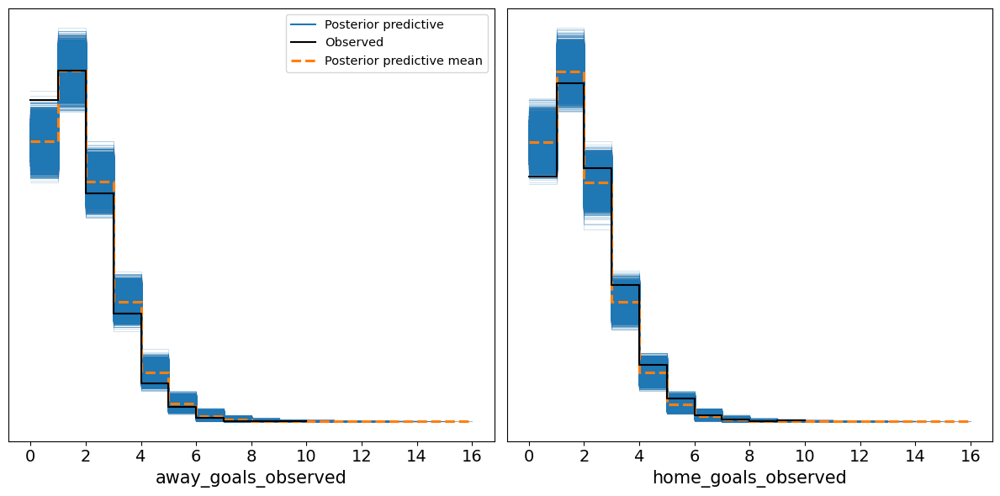

In [162]:
# save PPC plot
ppc_base_informative = save_ppc_plot(model_base_informative, trace_base_informative, "ppc_base_informative.png")

#### 1.5 Model Comparison Metrics (LOO and WAIC)

In [165]:
metrics = calculate_model_comparison_metrics(trace_base_informative)

home_goals_observed - LOO: 
 Computed from 40000 posterior samples and 2280 observations log-likelihood matrix.

             Estimate       SE
deviance_loo  6989.79    72.98
p_loo           13.90        -
------

Pareto k diagnostic values:
                         Count   Pct.
(-Inf, 0.5]   (good)     2280  100.0%
 (0.5, 0.7]   (ok)          0    0.0%
   (0.7, 1]   (bad)         0    0.0%
   (1, Inf)   (very bad)    0    0.0%

home_goals_observed - WAIC: 
 Computed from 40000 posterior samples and 2280 observations log-likelihood matrix.

              Estimate       SE
deviance_waic  6989.79    72.98
p_waic           13.90        -
away_goals_observed - LOO: 
 Computed from 40000 posterior samples and 2280 observations log-likelihood matrix.

             Estimate       SE
deviance_loo  6588.03    60.56
p_loo           12.82        -
------

Pareto k diagnostic values:
                         Count   Pct.
(-Inf, 0.5]   (good)     2280  100.0%
 (0.5, 0.7]   (ok)          0    0.0%
 

#### 1.6 Calculating error metrics (MAE and RMSE)

In [166]:
# Home teams
home_mae, home_rmse = calculate_errors(ppc_base_informative, df_18_24, 'Home_Goals', 'home_goals_observed')

# Away Teams
away_mae, away_rmse = calculate_errors(ppc_base_informative, df_18_24, 'Away_Goals', 'away_goals_observed')

Home_Goals - MAE: 0.9537073903508773, RMSE: 1.2369781993615425
Away_Goals - MAE: 0.926005087719298, RMSE: 1.1602882916171848


#### 1.7 Roc- Auc

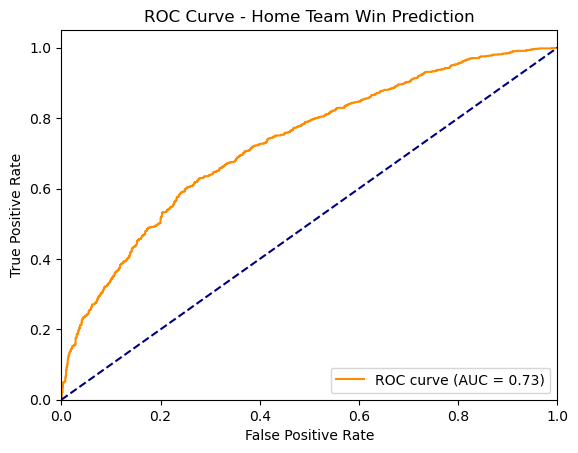

ROC AUC Value: 0.7282893851087856


In [167]:
roc_auc = calculate_and_plot_roc_auc_from_ppc(ppc_base_informative, df_18_24)
print(f"ROC AUC Value: {roc_auc}")

#### 1.8 Energy Plot

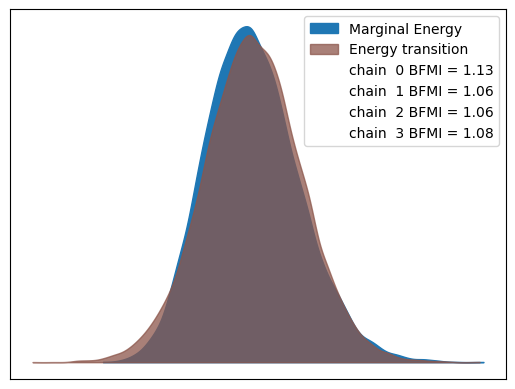

In [168]:
plot_energy(trace_base_informative)

#### 1.9 Shape of the main Parameters

In [169]:
print_posterior_shapes(trace_base_informative)

team_skills shape: (4, 10000, 28)
baseline_skill shape: (4, 10000)


Plot saved as 'base_informative_team_skill.png'


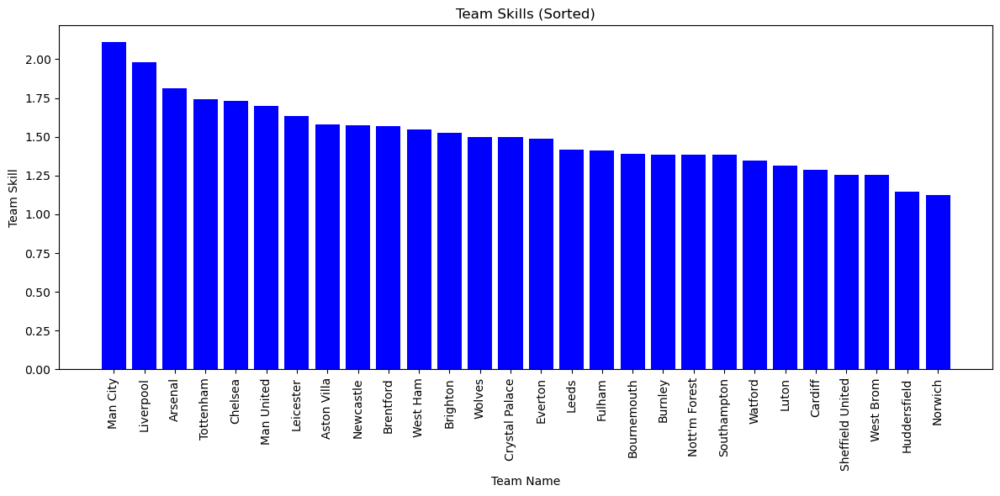

In [209]:
visualize_team_skills(df_18_24, trace_base_informative, filename="base_informative_team_skill.png")


## 4. Non Centered Base Model

In [49]:
def base_model_non_centered(data, n_samples=10000, n_tune=2000):
    
    # Determine unique team names and number of games
    unique_teams = np.unique(data[['Home_Team', 'Away_Team']].values)
    n_teams = len(unique_teams)
    n_games = data.shape[0]

    # Get team IDs and goals
    home_team_ids = data['Home_Team_ID'].values
    away_team_ids = data['Away_Team_ID'].values
    home_goals = data['Home_Goals'].values
    away_goals = data['Away_Goals'].values
    
    with pm.Model() as model:  
        
        # Hyperpriors for team skills
        mu_teams = pm.Normal('mu_teams', mu=0, sigma=4)
        sigma_teams = pm.HalfNormal('sigma_teams', sigma=3)
        
        # Non-centered parametrization for team skills
        raw_team_skills = pm.Normal('raw_team_skills', mu=0, sigma=1, shape=n_teams)
        team_skills = pm.Deterministic('team_skills', mu_teams + raw_team_skills * sigma_teams)
        
        # Prior for baseline skill
        baseline_skill = pm.Normal('baseline_skill', mu=0, sigma=4)
        
        # Likelihood 
        lambda_home_goals = pm.Deterministic('lambda_home_goals', 
                                             pm.math.exp(baseline_skill + team_skills[home_team_ids] - team_skills[away_team_ids]))
        
        lambda_away_goals = pm.Deterministic('lambda_away_goals', 
                                             pm.math.exp(baseline_skill + team_skills[away_team_ids] - team_skills[home_team_ids]))
        
        # Observed goal data
        home_goals_observed = pm.Poisson('home_goals_observed', mu=lambda_home_goals, observed=home_goals)
        away_goals_observed = pm.Poisson('away_goals_observed', mu=lambda_away_goals, observed=away_goals)
        
        # Sample the model
        trace = pm.sample(n_samples, tune=n_tune, cores=4, return_inferencedata=True, idata_kwargs={'log_likelihood': True})
        
    return model, trace


#### 1- Model Application for the 2018-2024 Period

In [50]:
# Getting Model and Trace
model_base_non_centered, trace_base_non_centered = base_model_non_centered(df_18_24)

Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [mu_teams, sigma_teams, raw_team_skills, baseline_skill]


Output()

Sampling 4 chains for 2_000 tune and 10_000 draw iterations (8_000 + 40_000 draws total) took 42 seconds.
There were 6 divergences after tuning. Increase `target_accept` or reparameterize.


In [25]:
gc.collect()

0

#### 1.1 Summay of the parameters

In [ ]:
total_params = summarize_posterior(trace_base_non_centered)

Posterior Variables: ['baseline_skill', 'lambda_away_goals', 'lambda_home_goals', 'mu_teams', 'raw_team_skills', 'sigma_teams', 'team_skills']
Total Parameters: 184760000


#### 1.2 Trace Plots

<Figure size 1000x400 with 0 Axes>

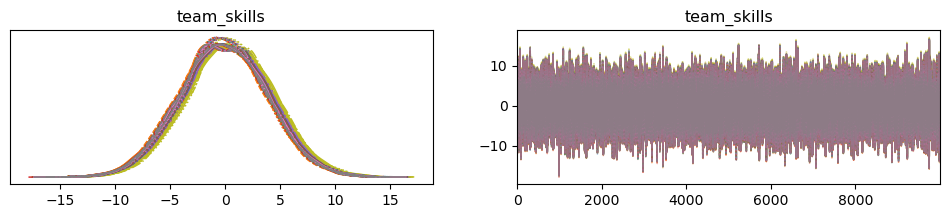

<Figure size 1000x400 with 0 Axes>

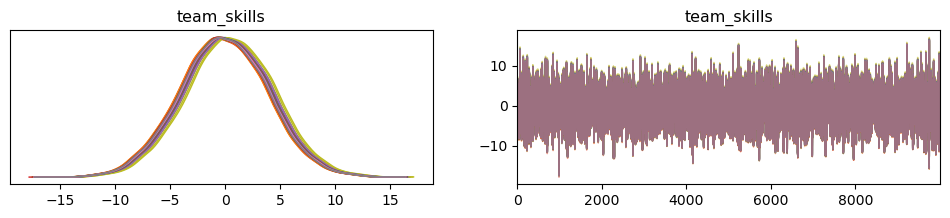

<Figure size 1000x400 with 0 Axes>

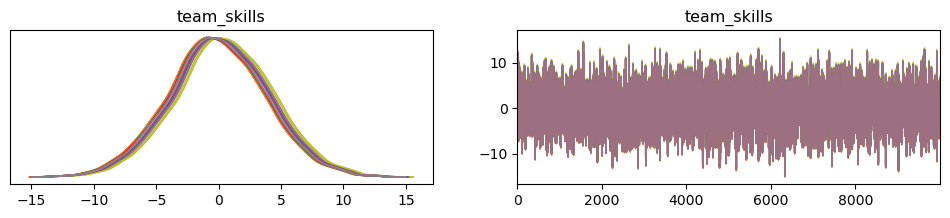

<Figure size 1000x400 with 0 Axes>

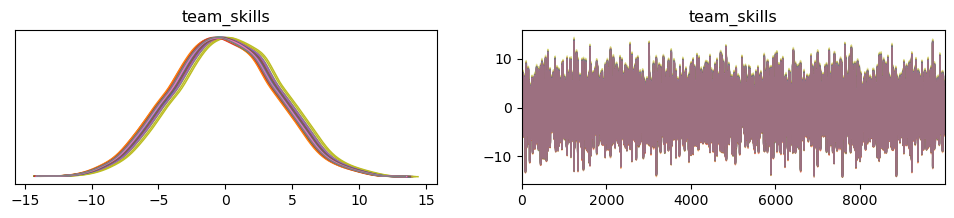

<Figure size 1000x400 with 0 Axes>

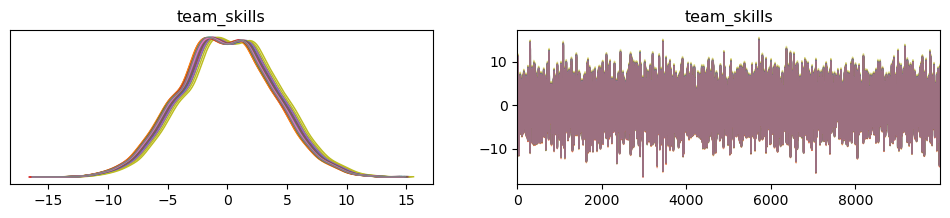

<Figure size 1000x400 with 0 Axes>

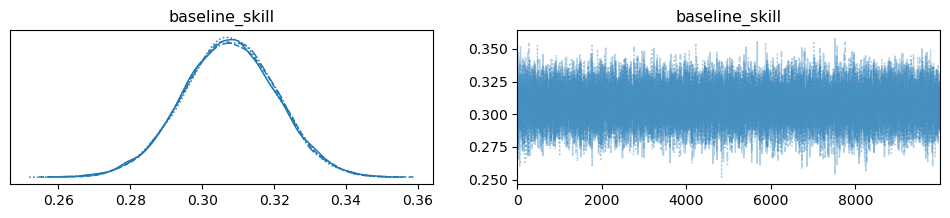

<Figure size 1000x400 with 0 Axes>

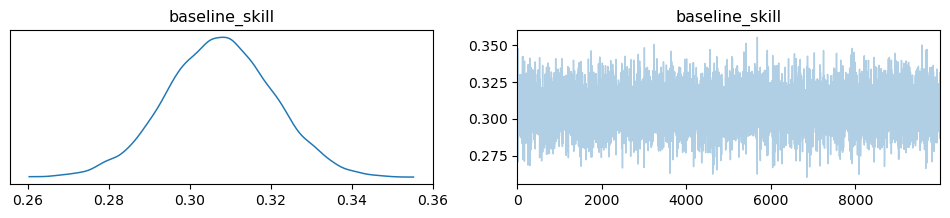

<Figure size 1000x400 with 0 Axes>

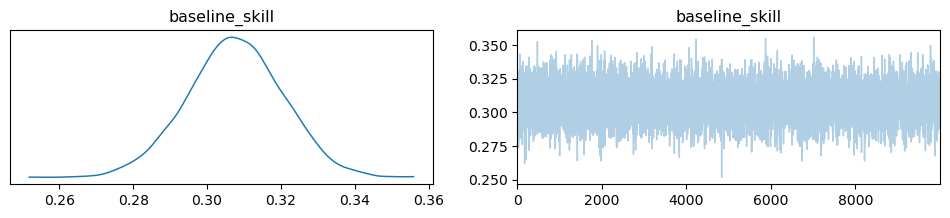

<Figure size 1000x400 with 0 Axes>

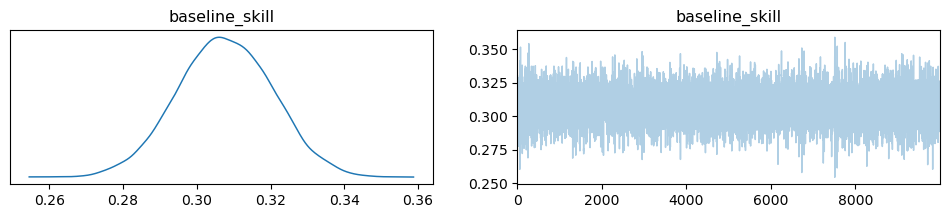

<Figure size 1000x400 with 0 Axes>

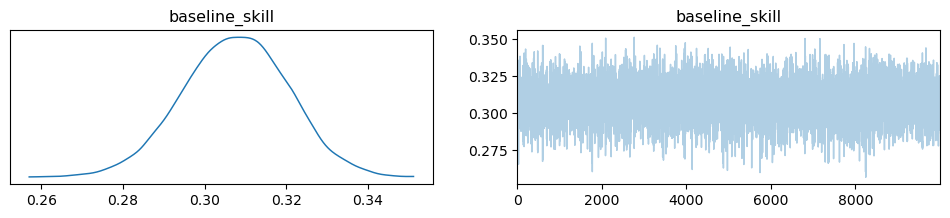

<Figure size 1000x400 with 0 Axes>

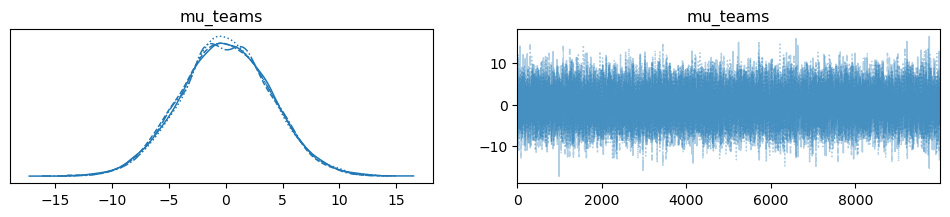

<Figure size 1000x400 with 0 Axes>

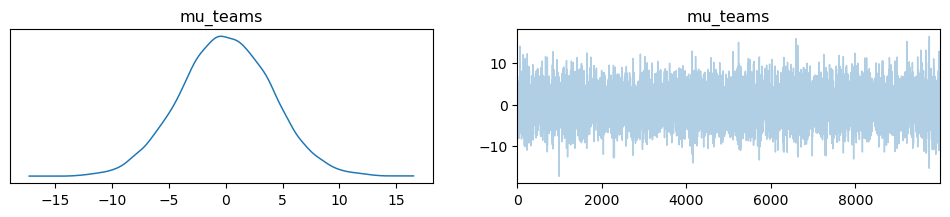

<Figure size 1000x400 with 0 Axes>

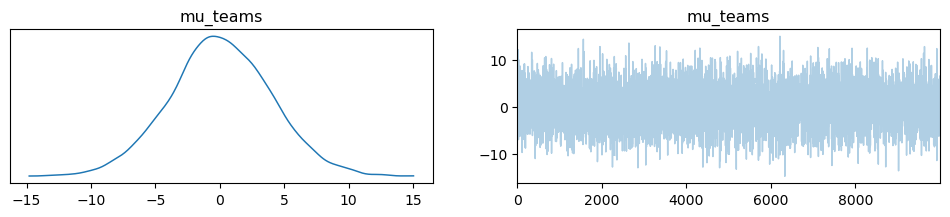

<Figure size 1000x400 with 0 Axes>

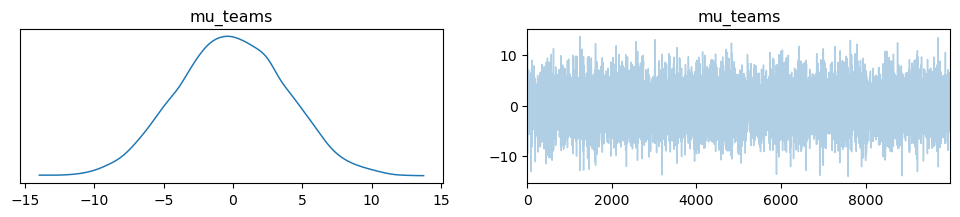

<Figure size 1000x400 with 0 Axes>

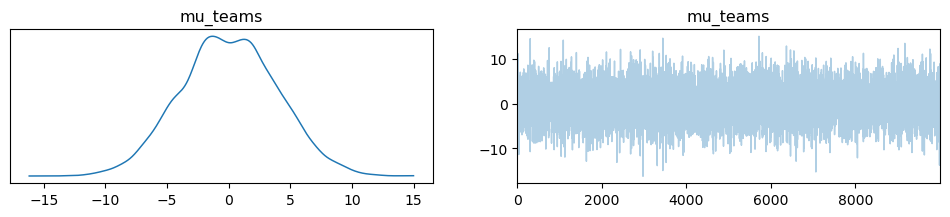

<Figure size 1000x400 with 0 Axes>

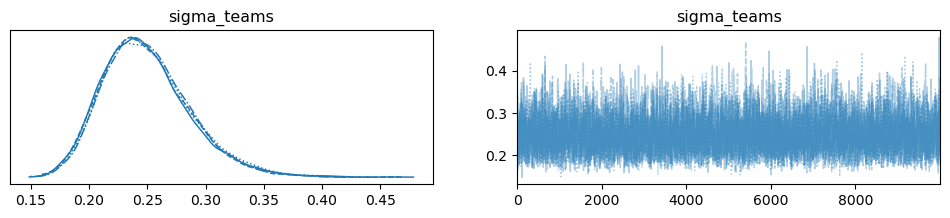

<Figure size 1000x400 with 0 Axes>

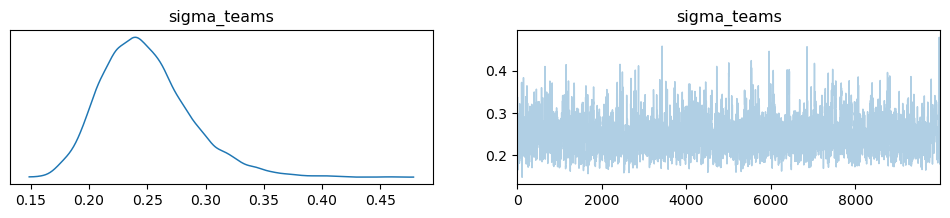

<Figure size 1000x400 with 0 Axes>

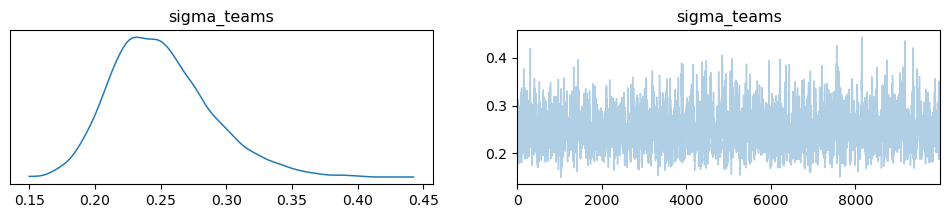

<Figure size 1000x400 with 0 Axes>

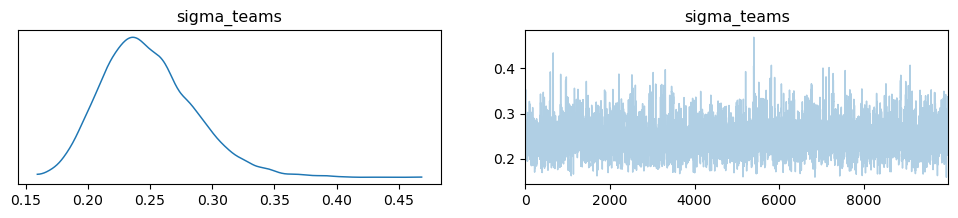

<Figure size 1000x400 with 0 Axes>

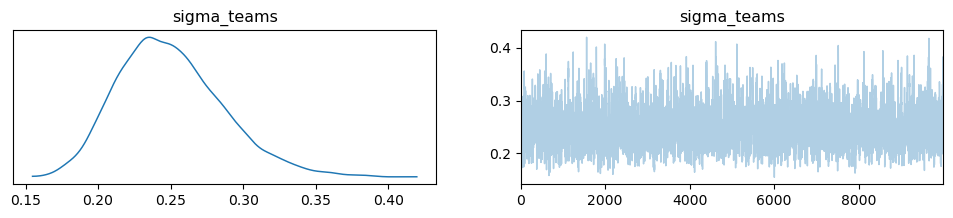

In [173]:
plot_trace_combined(trace_base_non_centered, 'team_skills')
plot_trace_by_chain(trace_base_non_centered, 'team_skills')
plot_trace_combined(trace_base_non_centered, 'baseline_skill')
plot_trace_by_chain(trace_base_non_centered, 'baseline_skill')
plot_trace_combined(trace_base_non_centered, 'mu_teams')
plot_trace_by_chain(trace_base_non_centered, 'mu_teams')
plot_trace_combined(trace_base_non_centered, 'sigma_teams')
plot_trace_by_chain(trace_base_non_centered, 'sigma_teams')

In [178]:
# Save trace plots for all parameters
save_arviz_plots(trace_base_non_centered)


#### 1.3 Summary Statistics of Model Parameters

In [174]:
summarize_model(trace_base_non_centered, "team_skills")

,mean,sd,hdi_3%,hdi_97%,mcse_mean,mcse_sd,ess_bulk,ess_tail,r_hat
team_skills[0],0.191,3.979,-7.343,7.558,0.023,0.021,30756.0,26242.0,1.0
team_skills[1],-0.118,3.979,-7.689,7.201,0.023,0.021,30767.0,26292.0,1.0
team_skills[2],-0.096,3.978,-7.670,7.227,0.023,0.021,30757.0,26334.0,1.0
team_skills[3],-0.361,3.980,-7.846,7.057,0.023,0.021,30773.0,26206.0,1.0
team_skills[4],0.066,3.979,-7.530,7.364,0.023,0.021,30756.0,26220.0,1.0
team_skills[5],-0.159,3.979,-7.734,7.169,0.023,0.021,30731.0,26274.0,1.0
team_skills[6],-0.006,3.979,-7.576,7.318,0.023,0.021,30755.0,26115.0,1.0
team_skills[7],0.309,3.979,-7.249,7.645,0.023,0.021,30768.0,26165.0,1.0
team_skills[8],0.474,3.979,-7.115,7.783,0.023,0.021,30763.0,26206.0,1.0
team_skills[9],-0.123,3.979,-7.661,7.229,0.023,0.021,30755.0,26184.0,1.0


In [179]:
summarize_model(trace_base_non_centered, "baseline_skill")

,mean,sd,hdi_3%,hdi_97%,mcse_mean,mcse_sd,ess_bulk,ess_tail,r_hat
baseline_skill,0.308,0.013,0.283,0.332,0.0,0.0,30277.0,25255.0,1.0


In [180]:
summarize_model(trace_base_non_centered, "mu_teams")

,mean,sd,hdi_3%,hdi_97%,mcse_mean,mcse_sd,ess_bulk,ess_tail,r_hat
mu_teams,-0.003,3.978,-7.552,7.338,0.023,0.021,30785.0,26439.0,1.0


In [181]:
summarize_model(trace_base_non_centered, "sigma_teams")

,mean,sd,hdi_3%,hdi_97%,mcse_mean,mcse_sd,ess_bulk,ess_tail,r_hat
sigma_teams,0.25,0.038,0.182,0.321,0.0,0.0,6378.0,9141.0,1.0


#### 1.4 Posterior Predictive Checks (PPC) and Other Metrics

Sampling: [away_goals_observed, home_goals_observed]


Output()

PPC plot saved as 'ppc_base_non_centered.png'


<Figure size 1200x600 with 0 Axes>

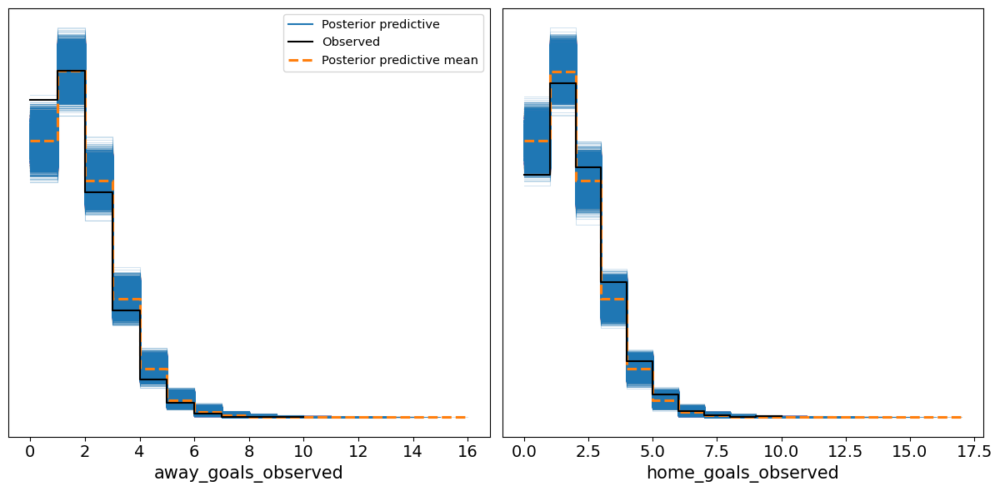

In [182]:
# save PPC plot
ppc_base_non_centered = save_ppc_plot(model_base_non_centered, trace_base_non_centered, "ppc_base_non_centered.png")

#### 1.5 Model Comparison Metrics (LOO and WAIC)

In [185]:
metrics = calculate_model_comparison_metrics(trace_base_non_centered)

home_goals_observed - LOO: 
 Computed from 40000 posterior samples and 2280 observations log-likelihood matrix.

             Estimate       SE
deviance_loo  6989.80    72.97
p_loo           13.92        -
------

Pareto k diagnostic values:
                         Count   Pct.
(-Inf, 0.5]   (good)     2280  100.0%
 (0.5, 0.7]   (ok)          0    0.0%
   (0.7, 1]   (bad)         0    0.0%
   (1, Inf)   (very bad)    0    0.0%

home_goals_observed - WAIC: 
 Computed from 40000 posterior samples and 2280 observations log-likelihood matrix.

              Estimate       SE
deviance_waic  6989.79    72.97
p_waic           13.92        -
away_goals_observed - LOO: 
 Computed from 40000 posterior samples and 2280 observations log-likelihood matrix.

             Estimate       SE
deviance_loo  6588.07    60.54
p_loo           12.82        -
------

Pareto k diagnostic values:
                         Count   Pct.
(-Inf, 0.5]   (good)     2280  100.0%
 (0.5, 0.7]   (ok)          0    0.0%
 

#### 1.6 Calculating error metrics (MAE and RMSE)

In [186]:
# Home teams goals
home_mae, home_rmse = calculate_errors(ppc_base_non_centered, df_18_24, 'Home_Goals', 'home_goals_observed')

# Away Teams goals
away_mae, away_rmse = calculate_errors(ppc_base_non_centered, df_18_24, 'Away_Goals', 'away_goals_observed')

Home_Goals - MAE: 0.9535767653508772, RMSE: 1.2368684139378787
Away_Goals - MAE: 0.9263507456140352, RMSE: 1.1606289004665256


#### 1.7 Roc- Auc

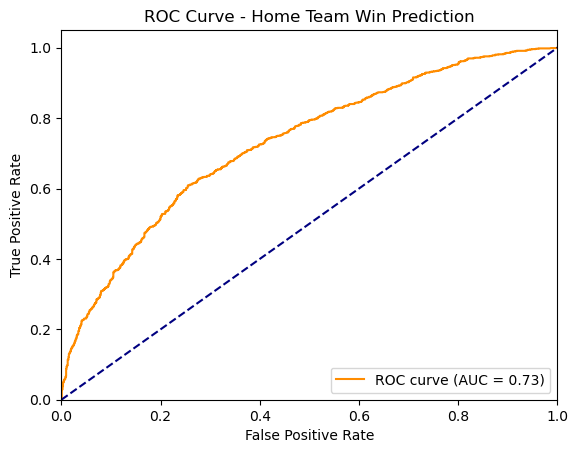

ROC AUC Value: 0.7282621468856205


In [187]:
roc_auc = calculate_and_plot_roc_auc_from_ppc(ppc_base_non_centered, df_18_24)
print(f"ROC AUC Value: {roc_auc}")

#### 1.8 Energy Plot

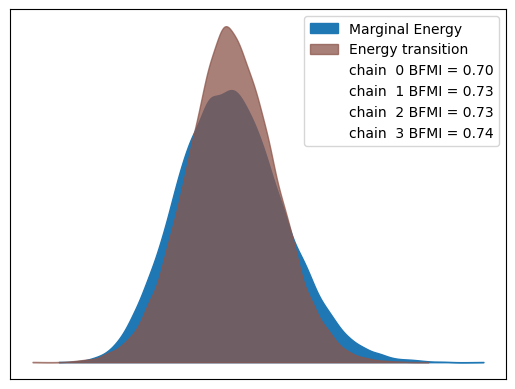

In [188]:
plot_energy(trace_base_non_centered)

#### 1.9 Shape of the main Parameters

In [ ]:
print_posterior_shapes(trace_base_non_centered)

team_skills shape: (4, 10000, 28)
baseline_skill shape: (4, 10000)


#### 1.10 Visualize Team Skills

Plot saved as 'base_non_centered_team_skill.png'


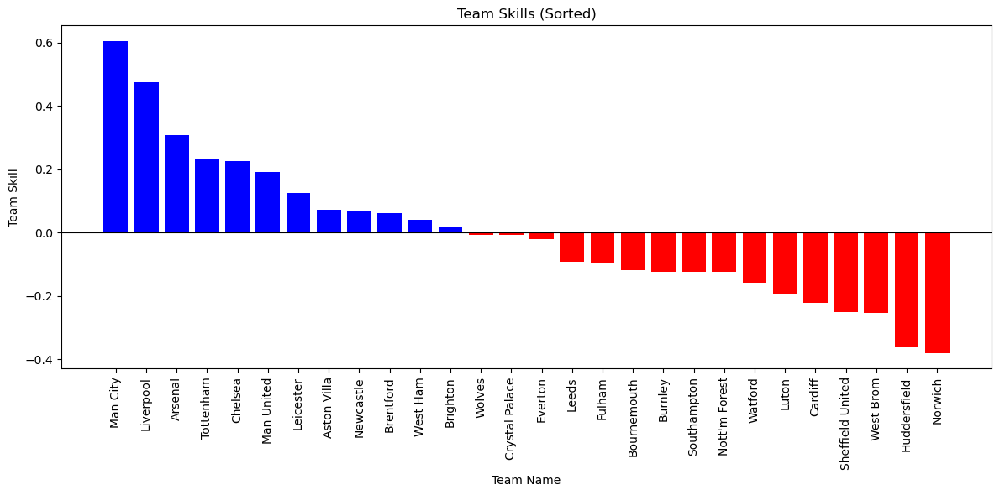

In [210]:
visualize_team_skills(df_18_24, trace_base_non_centered, filename="base_non_centered_team_skill.png")

### Model Comparison Results
In comparing the informative model (Model 1) with the non-centered parametrization model (Model 2), Model 2 demonstrated superior predictive performance for both home and away goals. The higher ELPD values for Model 2 indicate better model fit and generalization.

Additionally, Model 2 has a slightly lower `p_loo` value, suggesting that it is less complex while still achieving better predictive accuracy. Given these results, the non-centered model appears to be a more efficient and effective choice for our analysis.


## 5. Non Centerd Base Model with Informative Prior


In [44]:
def non_centered_informative_base_model(data, n_samples=10000, n_tune=2000):
    
    # Determine unique team names and number of games
    unique_teams = np.unique(data[['Home_Team', 'Away_Team']].values)
    n_teams = len(unique_teams)
    n_games = data.shape[0]

    # Get team IDs and goals
    home_team_ids = data['Home_Team_ID'].values
    away_team_ids = data['Away_Team_ID'].values
    home_goals = data['Home_Goals'].values
    away_goals = data['Away_Goals'].values

    with pm.Model() as model:
        
        # Hyperpriors
        mu_teams = pm.Normal('mu_teams', mu=1.5, sigma=0.5) 
        sigma_teams = pm.HalfNormal('sigma_teams', sigma=1.0)  
        
        # Non-centered parametrization
        raw_team_skills = pm.Normal('raw_team_skills', mu=0, sigma=1, shape=n_teams)
        team_skills = pm.Deterministic('team_skills', mu_teams + raw_team_skills * sigma_teams)

        # Prior for baseline skill
        baseline_skill = pm.Normal('baseline_skill', mu=0.3, sigma=0.1)  

        # Likelihood for observed goals
        lambda_home_goals = pm.Deterministic(
            'lambda_home_goals',
            pm.math.exp(team_skills[home_team_ids] - team_skills[away_team_ids])
        )
        lambda_away_goals = pm.Deterministic(
            'lambda_away_goals',
            pm.math.exp(team_skills[away_team_ids] - team_skills[home_team_ids])
        )

        # Observed goal data
        
        home_goals_observed = pm.Poisson('home_goals_observed', mu=lambda_home_goals, observed=home_goals)
        away_goals_observed = pm.Poisson('away_goals_observed', mu=lambda_away_goals, observed=away_goals)
        
        # Sample the model
        trace = pm.sample(n_samples, tune=n_tune, cores=4, return_inferencedata=True, idata_kwargs={'log_likelihood': True})

    return model, trace


#### 1- Model Application for the 2018-2024 Period

In [45]:
# Getting Model and Trace
model_base_non_centered_informative, trace_base_non_centered_informative = non_centered_informative_base_model(df_18_24)

Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [mu_teams, sigma_teams, raw_team_skills, baseline_skill]


Output()

Sampling 4 chains for 2_000 tune and 10_000 draw iterations (8_000 + 40_000 draws total) took 48 seconds.
There were 2 divergences after tuning. Increase `target_accept` or reparameterize.


In [46]:
gc.collect()

0

#### 1.1 Summay of the parameters

In [ ]:
total_params = summarize_posterior(trace_base_non_centered_informative)

Posterior Variables: ['baseline_skill', 'lambda_away_goals', 'lambda_home_goals', 'mu_teams', 'raw_team_skills', 'sigma_teams', 'team_skills']
Total Parameters: 184760000


#### 1.2 Trace Plots

<Figure size 1000x400 with 0 Axes>

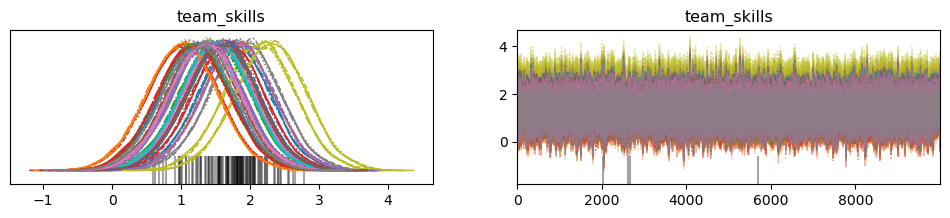

<Figure size 1000x400 with 0 Axes>

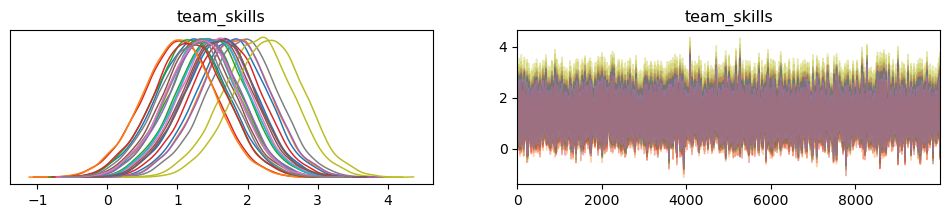

<Figure size 1000x400 with 0 Axes>

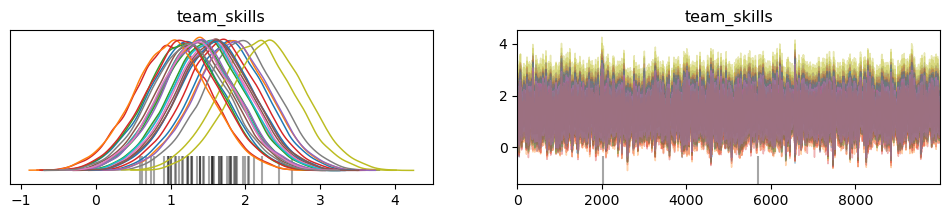

<Figure size 1000x400 with 0 Axes>

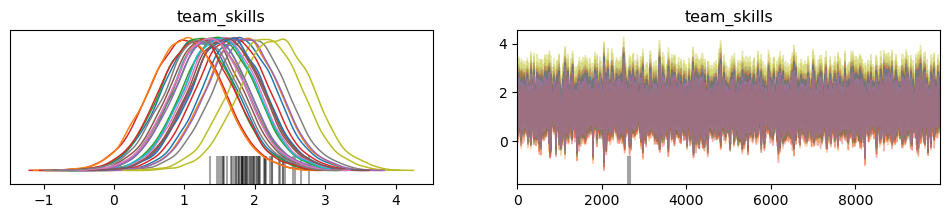

<Figure size 1000x400 with 0 Axes>

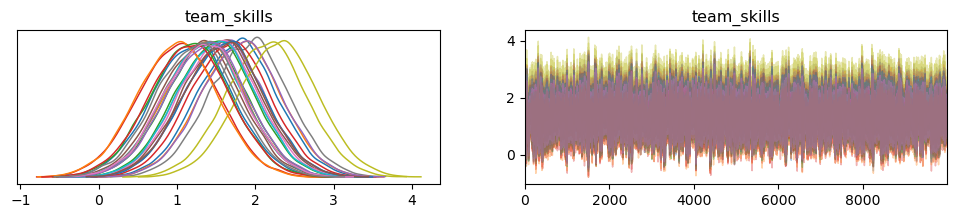

<Figure size 1000x400 with 0 Axes>

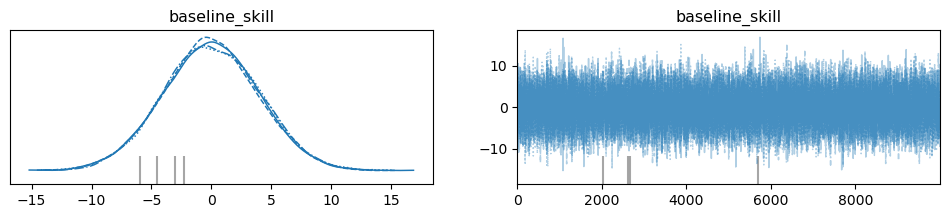

<Figure size 1000x400 with 0 Axes>

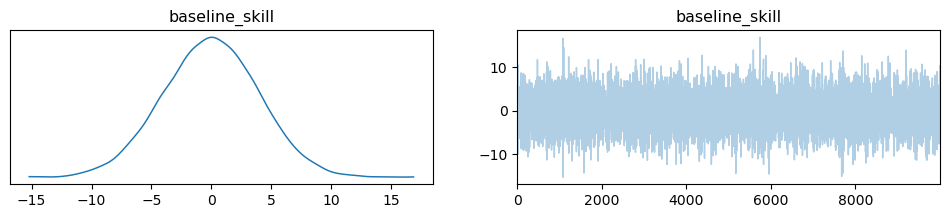

<Figure size 1000x400 with 0 Axes>

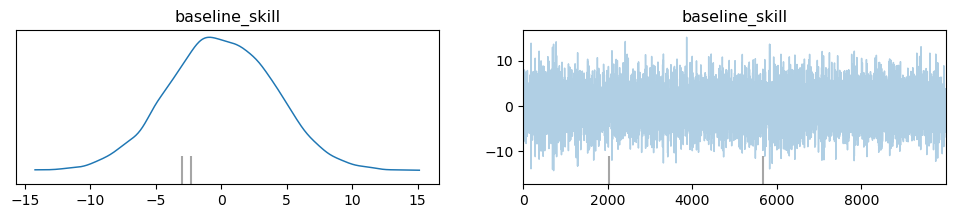

<Figure size 1000x400 with 0 Axes>

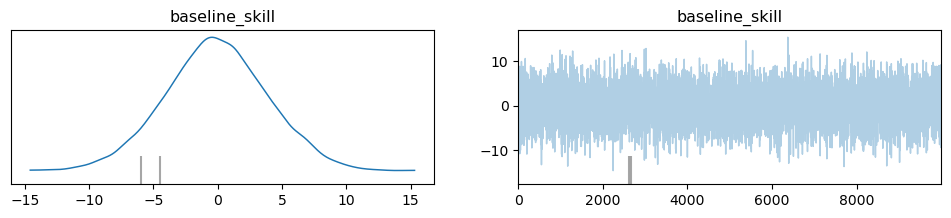

<Figure size 1000x400 with 0 Axes>

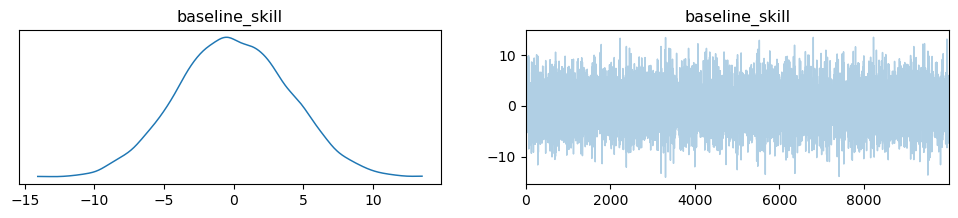

<Figure size 1000x400 with 0 Axes>

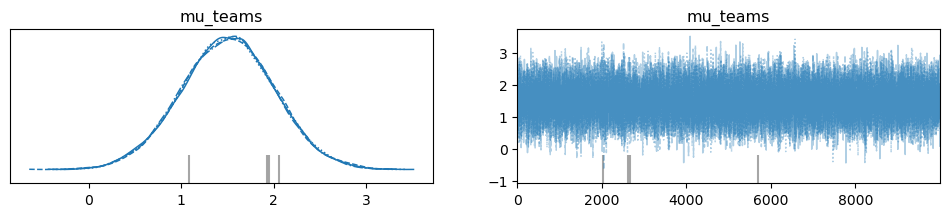

<Figure size 1000x400 with 0 Axes>

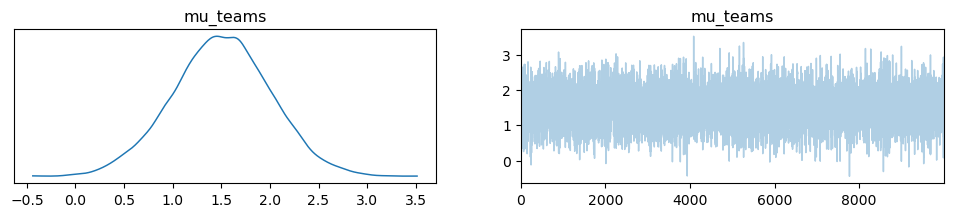

<Figure size 1000x400 with 0 Axes>

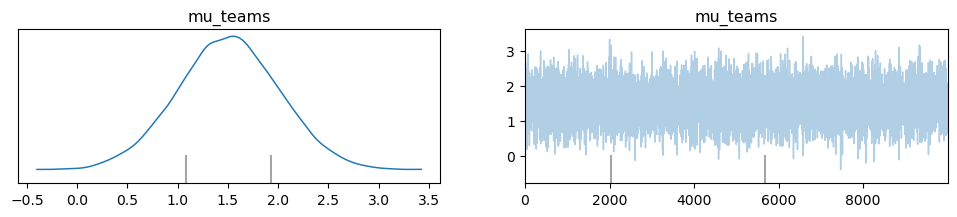

<Figure size 1000x400 with 0 Axes>

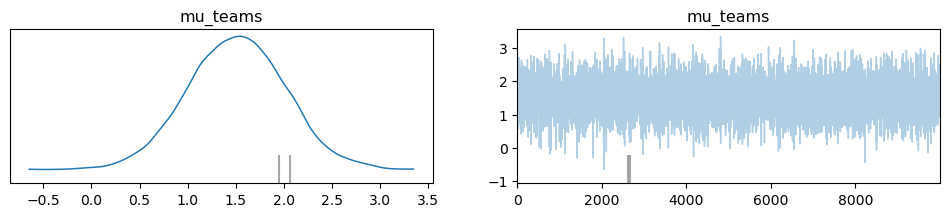

<Figure size 1000x400 with 0 Axes>

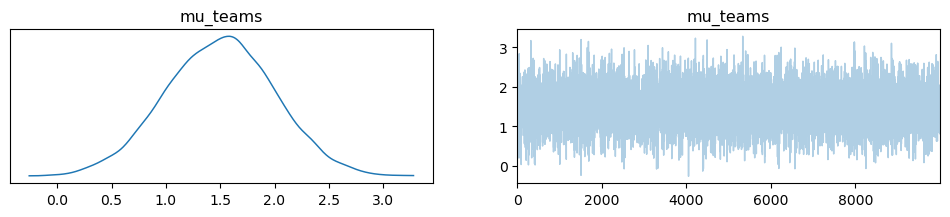

<Figure size 1000x400 with 0 Axes>

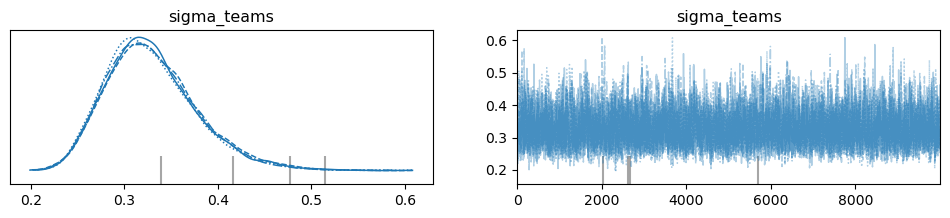

<Figure size 1000x400 with 0 Axes>

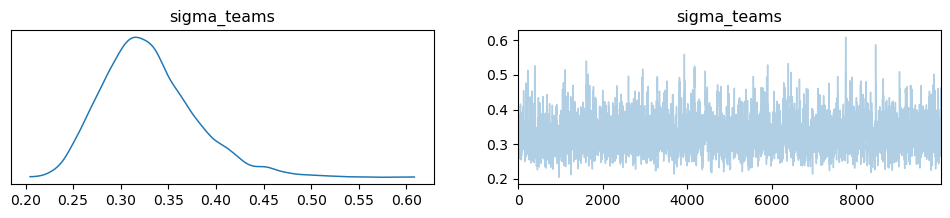

<Figure size 1000x400 with 0 Axes>

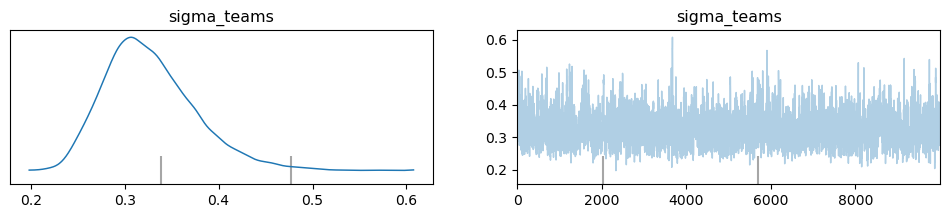

<Figure size 1000x400 with 0 Axes>

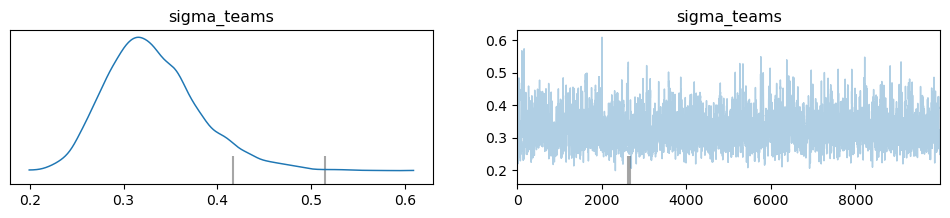

<Figure size 1000x400 with 0 Axes>

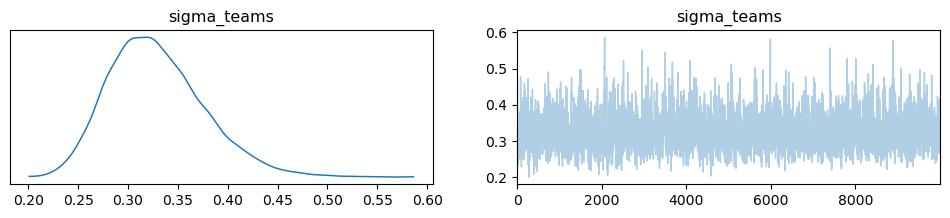

In [191]:
plot_trace_combined(trace_base_non_centered_informative, 'team_skills')
plot_trace_by_chain(trace_base_non_centered_informative, 'team_skills')
plot_trace_combined(trace_base_non_centered_informative, 'baseline_skill')
plot_trace_by_chain(trace_base_non_centered_informative, 'baseline_skill')
plot_trace_combined(trace_base_non_centered_informative, 'mu_teams')
plot_trace_by_chain(trace_base_non_centered_informative, 'mu_teams')
plot_trace_combined(trace_base_non_centered_informative, 'sigma_teams')
plot_trace_by_chain(trace_base_non_centered_informative, 'sigma_teams')

In [194]:
# Save trace plots for all parameters
save_arviz_plots(trace_base_non_centered_informative)

#### 1.3 Summary Statistics of Model Parameters

In [195]:
summarize_model(trace_base_non_centered_informative, "team_skills")

,mean,sd,hdi_3%,hdi_97%,mcse_mean,mcse_sd,ess_bulk,ess_tail,r_hat
team_skills[0],1.766,0.512,0.763,2.696,0.003,0.002,34471.0,26530.0,1.0
team_skills[1],1.352,0.512,0.353,2.285,0.003,0.002,34660.0,26048.0,1.0
team_skills[2],1.381,0.513,0.412,2.344,0.003,0.002,34568.0,26226.0,1.0
team_skills[3],1.025,0.518,0.038,1.989,0.003,0.002,35385.0,27060.0,1.0
team_skills[4],1.598,0.512,0.616,2.546,0.003,0.002,34671.0,26578.0,1.0
team_skills[5],1.297,0.514,0.317,2.258,0.003,0.002,34194.0,25719.0,1.0
team_skills[6],1.503,0.512,0.540,2.473,0.003,0.002,34541.0,26511.0,1.0
team_skills[7],1.921,0.512,0.951,2.886,0.003,0.002,34174.0,26357.0,1.0
team_skills[8],2.136,0.512,1.160,3.092,0.003,0.002,34377.0,26066.0,1.0
team_skills[9],1.346,0.512,0.377,2.302,0.003,0.002,34355.0,26002.0,1.0


In [196]:
summarize_model(trace_base_non_centered_informative, "baseline_skill")

,mean,sd,hdi_3%,hdi_97%,mcse_mean,mcse_sd,ess_bulk,ess_tail,r_hat
baseline_skill,-0.036,4.004,-7.783,7.25,0.019,0.022,44743.0,26979.0,1.0


In [197]:
summarize_model(trace_base_non_centered_informative, "mu_teams")

,mean,sd,hdi_3%,hdi_97%,mcse_mean,mcse_sd,ess_bulk,ess_tail,r_hat
mu_teams,1.503,0.506,0.535,2.447,0.003,0.002,37420.0,26393.0,1.0


In [198]:
summarize_model(trace_base_non_centered_informative, "sigma_teams")

,mean,sd,hdi_3%,hdi_97%,mcse_mean,mcse_sd,ess_bulk,ess_tail,r_hat
sigma_teams,0.329,0.049,0.243,0.421,0.001,0.0,5780.0,8430.0,1.0


#### 1.4 Posterior Predictive Checks (PPC) and Other Metrics

Sampling: [away_goals_observed, home_goals_observed]


Output()

PPC plot saved as 'ppc_base_non_centered_informative.png'


<Figure size 1200x600 with 0 Axes>

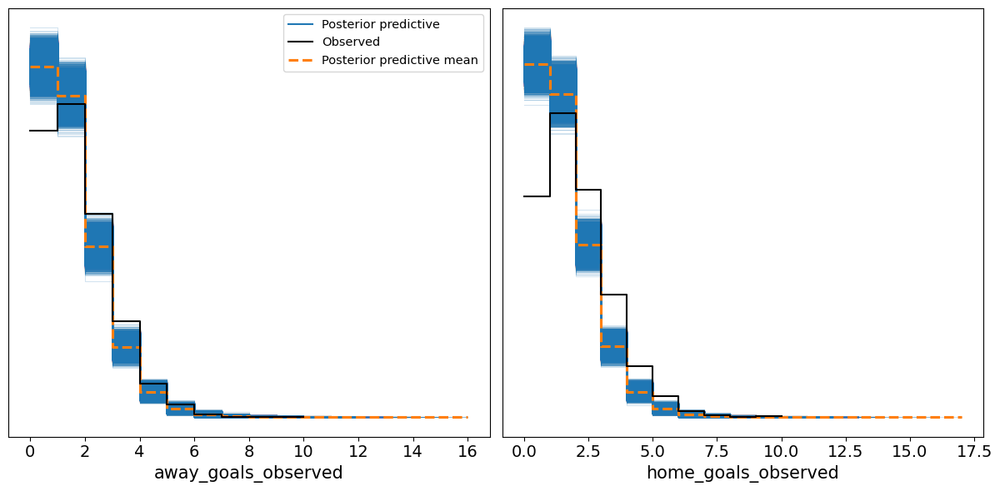

In [199]:
# save PPC plot
ppc_base_non_centered_informative = save_ppc_plot(model_base_non_centered_informative, trace_base_non_centered_informative, "ppc_base_non_centered_informative.png")

#### 1.5 Model Comparison Metrics (LOO and WAIC)

In [200]:
metrics = calculate_model_comparison_metrics(trace_base_non_centered_informative)

home_goals_observed - LOO: 
 Computed from 40000 posterior samples and 2280 observations log-likelihood matrix.

             Estimate       SE
deviance_loo  7405.61   102.26
p_loo           19.95        -
------

Pareto k diagnostic values:
                         Count   Pct.
(-Inf, 0.5]   (good)     2280  100.0%
 (0.5, 0.7]   (ok)          0    0.0%
   (0.7, 1]   (bad)         0    0.0%
   (1, Inf)   (very bad)    0    0.0%

home_goals_observed - WAIC: 
 Computed from 40000 posterior samples and 2280 observations log-likelihood matrix.

              Estimate       SE
deviance_waic  7405.60   102.26
p_waic           19.95        -
away_goals_observed - LOO: 
 Computed from 40000 posterior samples and 2280 observations log-likelihood matrix.

             Estimate       SE
deviance_loo  6675.79    85.80
p_loo           16.71        -
------

Pareto k diagnostic values:
                         Count   Pct.
(-Inf, 0.5]   (good)     2280  100.0%
 (0.5, 0.7]   (ok)          0    0.0%
 

#### 1.6 Calculating error metrics (MAE and RMSE)

In [201]:
# Home teams for goals
home_mae, home_rmse = calculate_errors(ppc_base_non_centered_informative, df_18_24, 'Home_Goals', 'home_goals_observed')

# Away Teams for goals
away_mae, away_rmse = calculate_errors(ppc_base_non_centered_informative, df_18_24, 'Away_Goals', 'away_goals_observed')

Home_Goals - MAE: 0.9851723903508771, RMSE: 1.31642203734242
Away_Goals - MAE: 0.9003805592105263, RMSE: 1.1723463804289114


#### 1.7 Roc- Auc

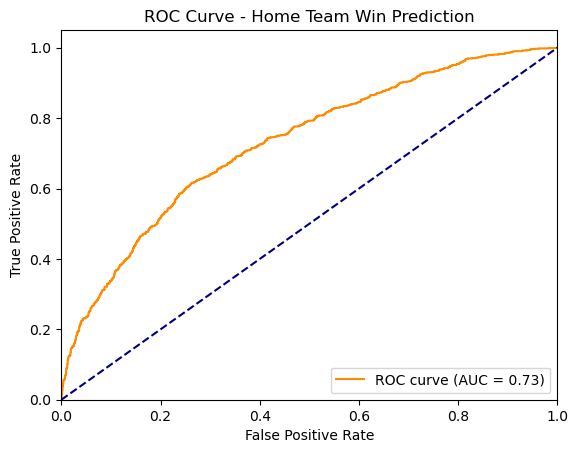

ROC AUC Value: 0.7287450416705903


In [202]:
roc_auc = calculate_and_plot_roc_auc_from_ppc(ppc_base_non_centered_informative, df_18_24)
print(f"ROC AUC Value: {roc_auc}")

#### 1.8 Energy Plot

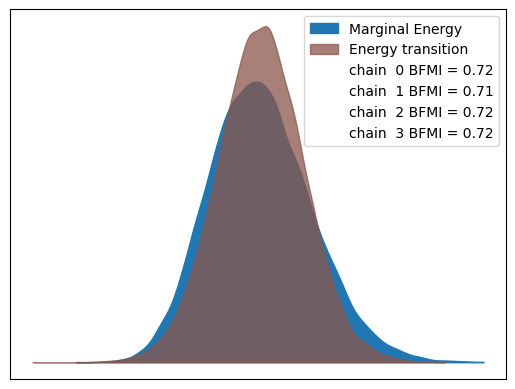

In [203]:
plot_energy(trace_base_non_centered_informative)

#### 1.9 Shape of the main Parameters

In [ ]:
print_posterior_shapes(trace_base_non_centered_informative)

team_skills shape: (4, 10000, 28)
baseline_skill shape: (4, 10000)


Plot saved as 'base_non_centered_informative_team_skill.png'


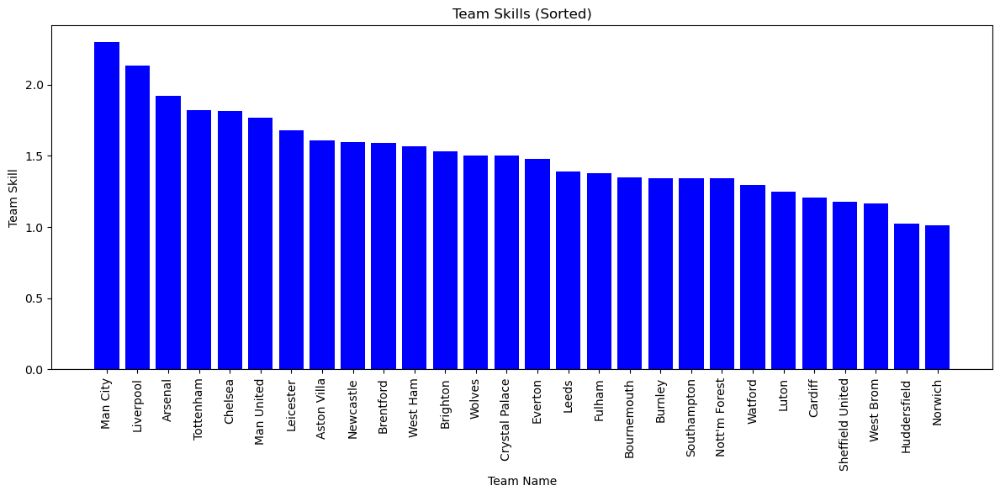

In [211]:
visualize_team_skills(df_18_24, trace_base_non_centered_informative, filename="base_non_centered_informative_team_skill.png")

## Comparing Five Base Models

### 1. Experiment Comparison

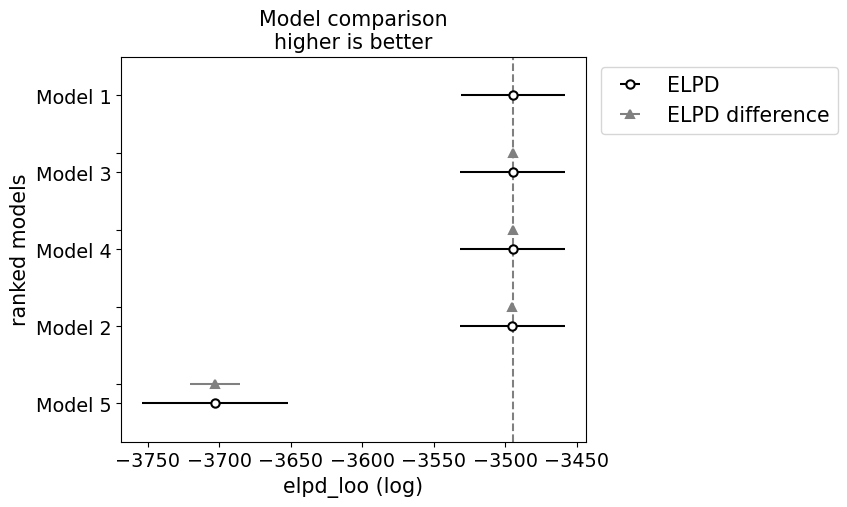

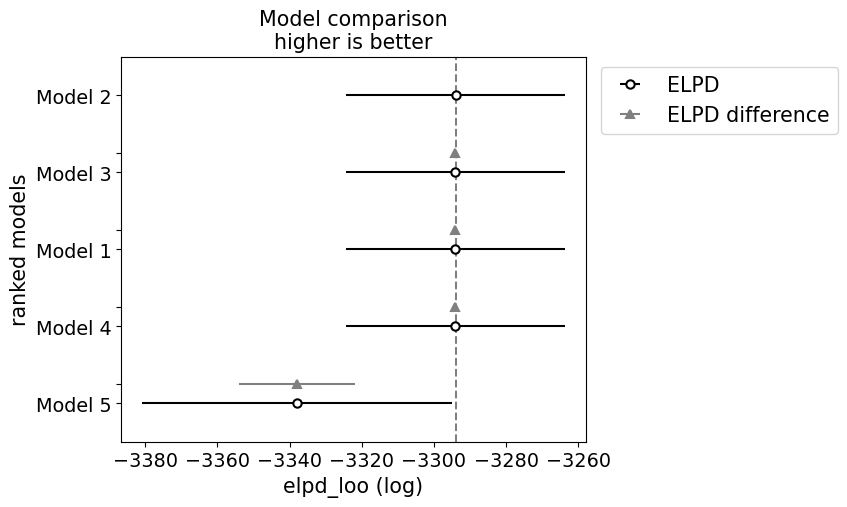

In [37]:
model_traces_for_base_models = {
    "Model 1": trace_base,
    "Model 2": trace_base_halfnormal,
    "Model 3": trace_base_informative,
    "Model 4": trace_base_non_centered,
    "Model 5": trace_base_non_centered_informative, 
}

# Home Goals
comparison_home_for_five_base_models_1 = az.compare(model_traces_for_base_models, ic="loo", var_name="home_goals_observed")
az.plot_compare(comparison_home_for_five_base_models_1)

plt.savefig("First_five_comparison_home_goals_1.png", dpi=300, bbox_inches="tight") 
plt.show()  
plt.close() 
# Away Goals 
comparison_away_for_five_base_models_1 = az.compare(model_traces_for_base_models, ic="loo", var_name="away_goals_observed")
az.plot_compare(comparison_away_for_five_base_models_1)

plt.savefig("First_five_model_comparison_away_goals_1.png", dpi=300, bbox_inches="tight")  
plt.show()
plt.close()  

In [38]:

comparison_home_for_five_base_models_1


,rank,elpd_loo,p_loo,elpd_diff,weight,se,dse,warning,scale
Model 1,0,-3494.846650,13.910189,0.000000,1.000000e+00,36.479449,0.000000,False,log
Model 3,1,-3494.912997,13.923924,0.066347,0.000000e+00,36.486762,0.021928,False,log
Model 4,2,-3494.935596,13.969897,0.088946,7.082961e-15,36.487240,0.022651,False,log
Model 2,3,-3495.005386,13.953055,0.158735,2.036302e-15,36.499255,0.031937,False,log
Model 5,4,-3702.809799,19.982405,207.963149,0.000000e+00,51.130596,17.530144,False,log


In [39]:
comparison_away_for_five_base_models_1

,rank,elpd_loo,p_loo,elpd_diff,weight,se,dse,warning,scale
Model 2,0,-3294.007773,12.876341,0.000000,7.723767e-17,30.285704,0.000000,False,log
Model 3,1,-3294.048543,12.838007,0.040769,1.665335e-16,30.274666,0.027306,False,log
Model 1,2,-3294.076558,12.811061,0.068785,6.541880e-01,30.266716,0.032376,False,log
Model 4,3,-3294.102638,12.878368,0.094865,0.000000e+00,30.274595,0.026942,False,log
Model 5,4,-3337.938973,16.750184,43.931199,3.458120e-01,42.902785,16.170198,False,log


### 2. Experiment Comparison 

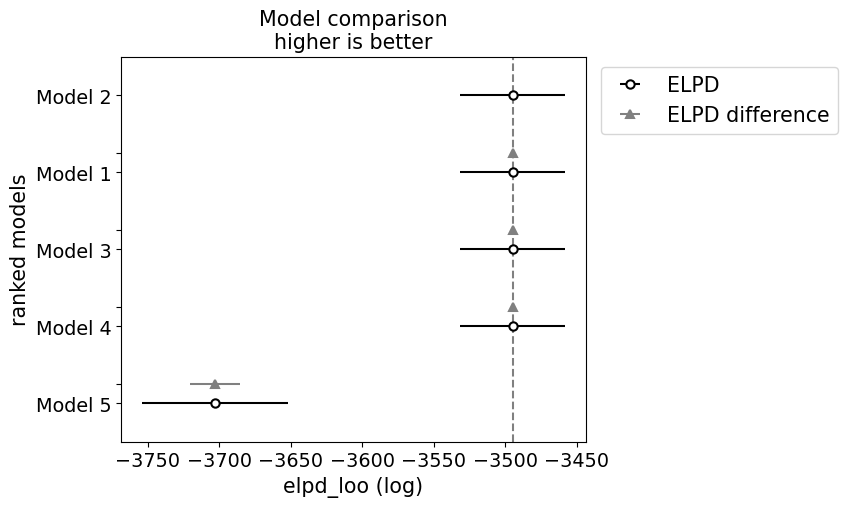

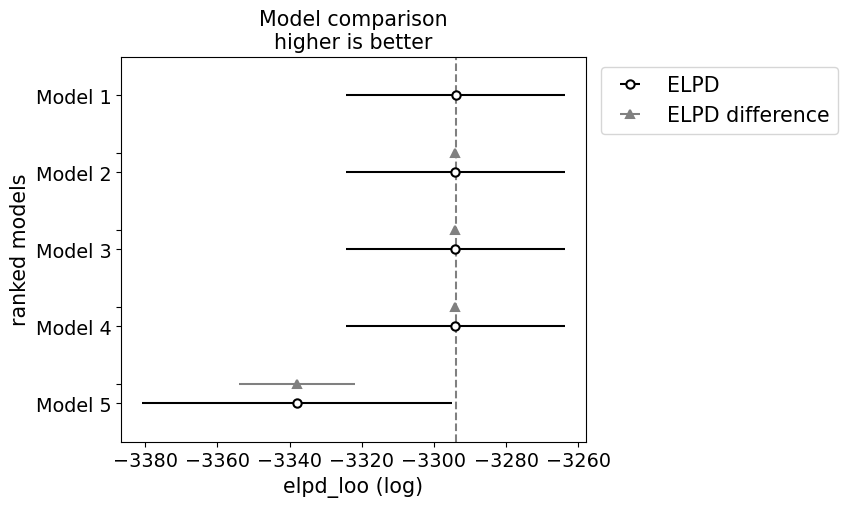

In [26]:
model_traces_for_base_models = {
    "Model 1": trace_base,
    "Model 2": trace_base_halfnormal,
    "Model 3": trace_base_informative,
    "Model 4": trace_base_non_centered,
    "Model 5": trace_base_non_centered_informative, 
}

# Home Goals
comparison_home_for_five_base_models_2 = az.compare(model_traces_for_base_models, ic="loo", var_name="home_goals_observed")
az.plot_compare(comparison_home_for_five_base_models_2)

plt.savefig("First_five_comparison_home_goals_2.png", dpi=300, bbox_inches="tight") 
plt.show()  
plt.close() 
# Away Goals 
comparison_away_for_five_base_models_2 = az.compare(model_traces_for_base_models, ic="loo", var_name="away_goals_observed")
az.plot_compare(comparison_away_for_five_base_models_2)

plt.savefig("First_five_model_comparison_away_goals_2.png", dpi=300, bbox_inches="tight")  
plt.show()
plt.close()  

In [27]:
comparison_home_for_five_base_models_2

,rank,elpd_loo,p_loo,elpd_diff,weight,se,dse,warning,scale
Model 2,0,-3494.952548,13.937269,0.000000,1.000000e+00,36.492804,0.000000,False,log
Model 1,1,-3494.988599,13.953387,0.036051,2.300937e-14,36.496248,0.022131,False,log
Model 3,2,-3495.021695,13.990490,0.069147,0.000000e+00,36.490076,0.025534,False,log
Model 4,3,-3495.027897,14.014262,0.075349,0.000000e+00,36.495961,0.018634,False,log
Model 5,4,-3702.856354,20.026326,207.903806,0.000000e+00,51.129422,17.512142,False,log


In [28]:
comparison_away_for_five_base_models_2

,rank,elpd_loo,p_loo,elpd_diff,weight,se,dse,warning,scale
Model 1,0,-3294.008137,12.846175,0.000000,3.221249e-01,30.283335,0.000000,False,log
Model 2,1,-3294.039469,12.852582,0.031332,3.160660e-16,30.281499,0.021465,False,log
Model 3,2,-3294.067927,12.899026,0.059789,3.327771e-01,30.273962,0.026911,False,log
Model 4,3,-3294.108696,12.931214,0.100559,0.000000e+00,30.282641,0.023000,False,log
Model 5,4,-3337.968777,16.786304,43.960640,3.450979e-01,42.902068,16.172965,False,log


### Third  Iteration Plot 

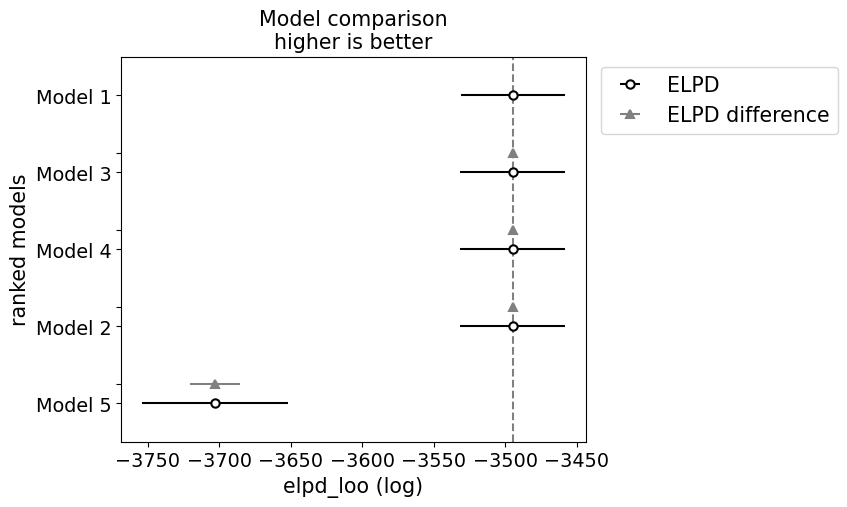

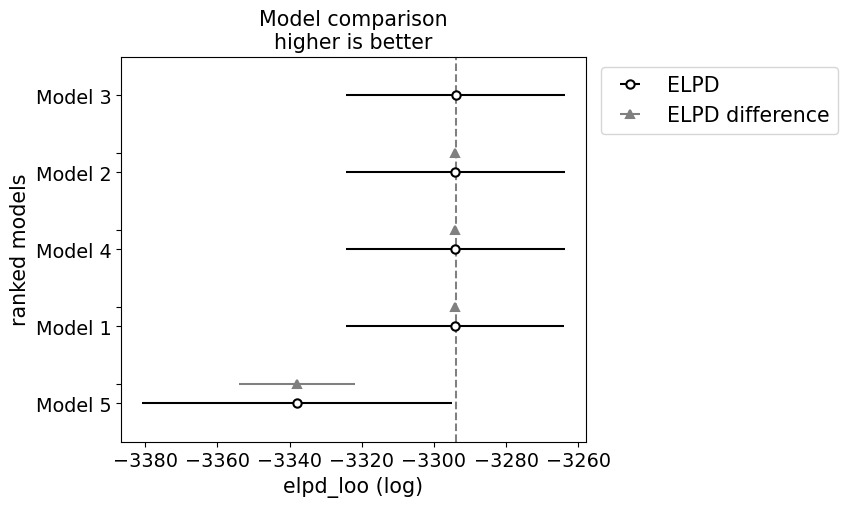

In [46]:
model_traces_for_base_models = {
    "Model 1": trace_base,
    "Model 2": trace_base_halfnormal,
    "Model 3": trace_base_informative,
    "Model 4": trace_base_non_centered,
    "Model 5": trace_base_non_centered_informative, 
}

# Home Goals
comparison_home_for_five_base_models_3 = az.compare(model_traces_for_base_models, ic="loo", var_name="home_goals_observed")
az.plot_compare(comparison_home_for_five_base_models_3)

plt.savefig("First_five_comparison_home_goals_3.png", dpi=300, bbox_inches="tight") 
plt.show()  
plt.close() 
# Away Goals 
comparison_away_for_five_base_models_3 = az.compare(model_traces_for_base_models, ic="loo", var_name="away_goals_observed")
az.plot_compare(comparison_away_for_five_base_models_3)

plt.savefig("First_five_model_comparison_away_goals_3.png", dpi=300, bbox_inches="tight")  
plt.show()
plt.close()  

In [47]:
comparison_home_for_five_base_models_3

,rank,elpd_loo,p_loo,elpd_diff,weight,se,dse,warning,scale
Model 1,0,-3494.916116,13.982436,0.000000,1.000000e+00,36.479804,0.000000,False,log
Model 3,1,-3494.951991,13.927877,0.035875,1.540434e-15,36.492387,0.031693,False,log
Model 4,2,-3494.982005,13.986417,0.065889,0.000000e+00,36.491001,0.025697,False,log
Model 2,3,-3495.036429,13.991543,0.120312,2.596388e-16,36.498529,0.030329,False,log
Model 5,4,-3702.865946,20.026761,207.949830,0.000000e+00,51.129329,17.529674,False,log


In [48]:
comparison_away_for_five_base_models_3

,rank,elpd_loo,p_loo,elpd_diff,weight,se,dse,warning,scale
Model 3,0,-3294.006984,12.838474,0.000000,6.550289e-01,30.278616,0.000000,False,log
Model 2,1,-3294.051030,12.899594,0.044045,1.981572e-16,30.284303,0.023097,False,log
Model 4,2,-3294.084290,12.888769,0.077306,5.359204e-16,30.277605,0.022636,False,log
Model 1,3,-3294.170501,12.901582,0.163516,1.225963e-16,30.268533,0.029642,False,log
Model 5,4,-3337.961390,16.794058,43.954406,3.449711e-01,42.901953,16.178231,False,log


## 6. Home Advanatage Model

In [14]:
def home_advantage_model(data, n_samples=10000, n_tune=2000 ):
                                    
    
    ## Determine unique team names and number of games
    unique_teams = np.unique(data[['Home_Team', 'Away_Team']].values)
    n_teams = len(unique_teams)
    n_games = data.shape[0]

    # Get team IDs and goals
    home_team_ids = data['Home_Team_ID'].values
    away_team_ids = data['Away_Team_ID'].values
    home_goals = data['Home_Goals'].values
    away_goals = data['Away_Goals'].values
    
    with pm.Model() as model:
        # Hyperpriors for team skills
        mu_teams = pm.Normal('mu_teams', mu=0, sigma=4)
        sigma_teams = pm.HalfNormal('sigma_teams', sigma=3)
        
        # Priors for team skills
        team_skills = pm.Normal('team_skills', mu=mu_teams, sigma=sigma_teams, shape=n_teams)

        # Priors for basline skill
        baseline_skill = pm.Normal('baseline_skill', mu=0, sigma=4)
        
        # Priors for home advantage 
        home_advantage = pm.Normal('home_advantage', mu=0, sigma=4)
        
        
        # Likelihood 
        lambda_home_goals = pm.Deterministic('lambda_home_goals', 
                                             pm.math.exp(home_advantage + team_skills[home_team_ids] - team_skills[away_team_ids]))
        lambda_away_goals = pm.Deterministic('lambda_away_goals', 
                                             pm.math.exp(baseline_skill + team_skills[away_team_ids] - team_skills[home_team_ids]))
        
        # Observed goal data
        home_goals_observed = pm.Poisson('home_goals_observed', mu=lambda_home_goals, observed=home_goals)
        away_goals_observed = pm.Poisson('away_goals_observed', mu=lambda_away_goals, observed=away_goals)
        
        # Sample the model
        trace =  pm.sample(n_samples, tune=n_tune, cores=4, return_inferencedata=True, idata_kwargs={'log_likelihood': True})
        
    return model, trace


### 1-Model Application for the 2018-2024 Period

In [15]:
model_home_adv, trace_home_adv = home_advantage_model(df_18_24)

Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [mu_teams, sigma_teams, team_skills, baseline_skill, home_advantage]


Output()

Sampling 4 chains for 2_000 tune and 10_000 draw iterations (8_000 + 40_000 draws total) took 629 seconds.


In [32]:
gc.collect()

0

#### 1.1 Summay of the parameters

In [54]:
total_params = summarize_posterior(trace_home_adv)

Posterior Variables: ['baseline_skill', 'home_advantage', 'lambda_away_goals', 'lambda_home_goals', 'mu_teams', 'sigma_teams', 'team_skills']
Total Parameters: 183680000


#### 1.2 Trace Plots

<Figure size 1000x400 with 0 Axes>

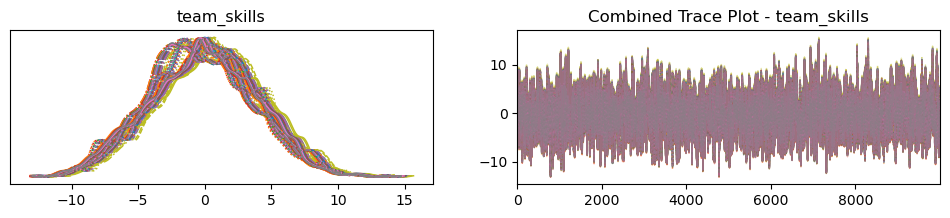

<Figure size 1000x400 with 0 Axes>

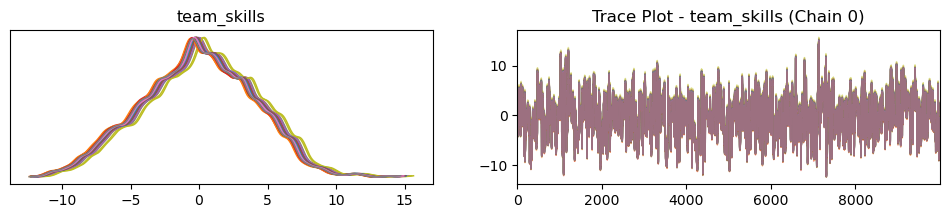

<Figure size 1000x400 with 0 Axes>

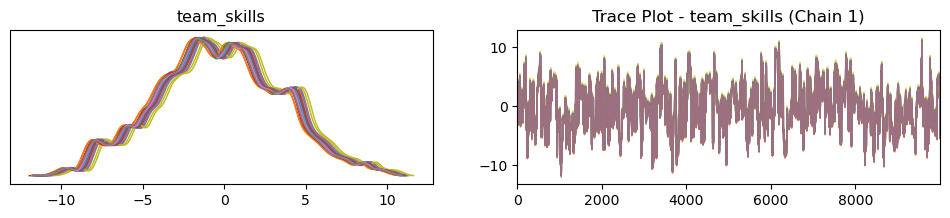

<Figure size 1000x400 with 0 Axes>

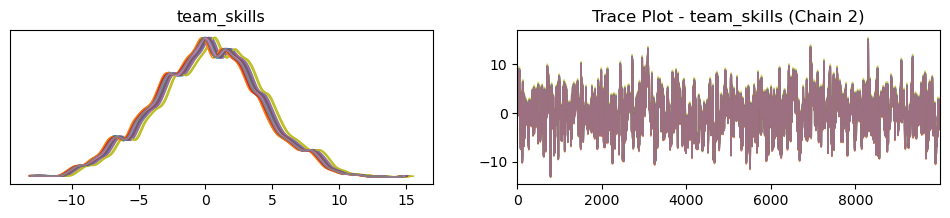

<Figure size 1000x400 with 0 Axes>

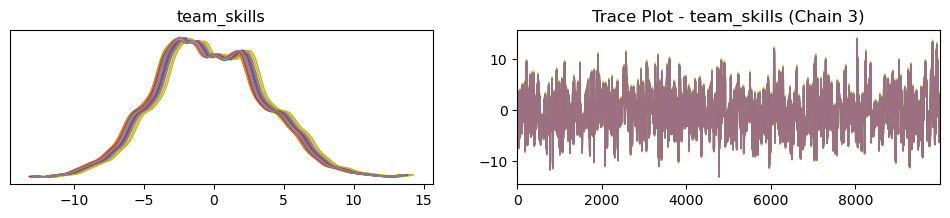

<Figure size 1000x400 with 0 Axes>

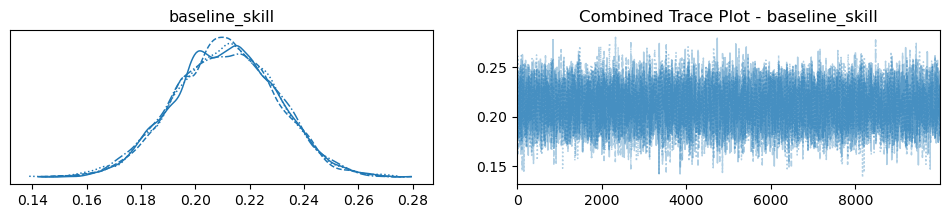

<Figure size 1000x400 with 0 Axes>

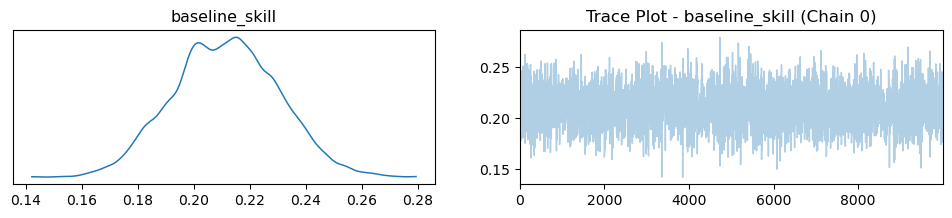

<Figure size 1000x400 with 0 Axes>

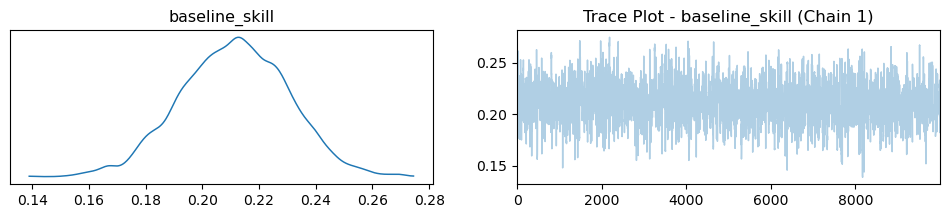

<Figure size 1000x400 with 0 Axes>

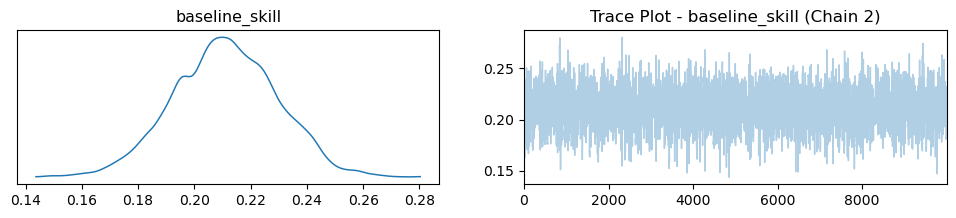

<Figure size 1000x400 with 0 Axes>

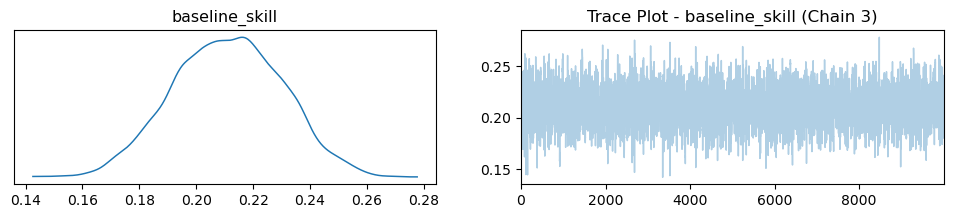

<Figure size 1000x400 with 0 Axes>

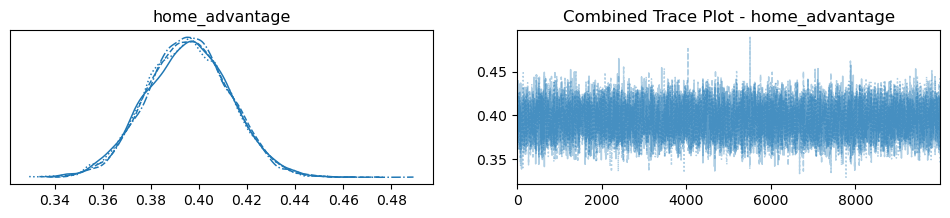

<Figure size 1000x400 with 0 Axes>

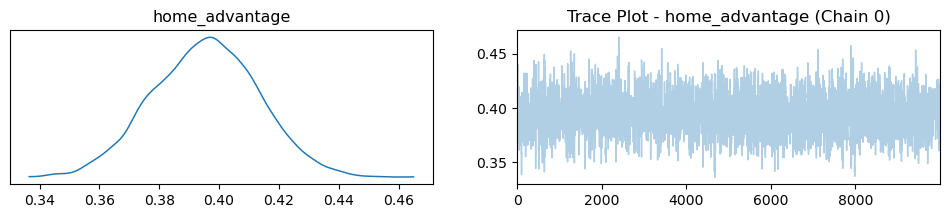

<Figure size 1000x400 with 0 Axes>

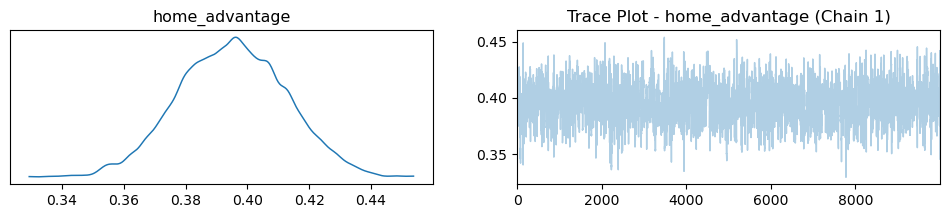

<Figure size 1000x400 with 0 Axes>

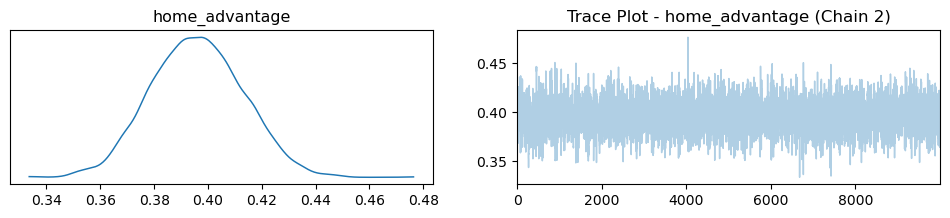

<Figure size 1000x400 with 0 Axes>

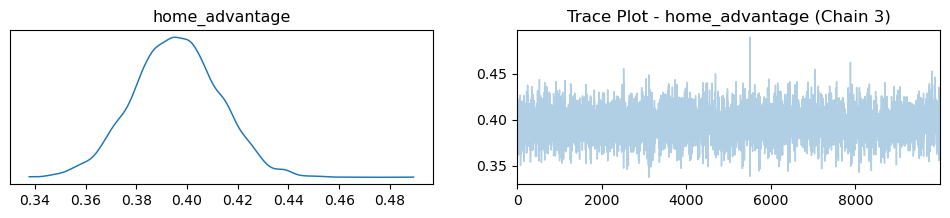

<Figure size 1000x400 with 0 Axes>

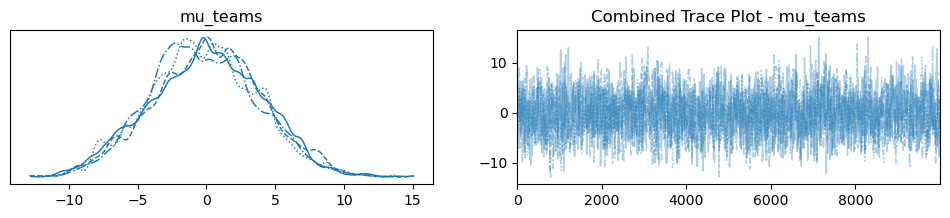

<Figure size 1000x400 with 0 Axes>

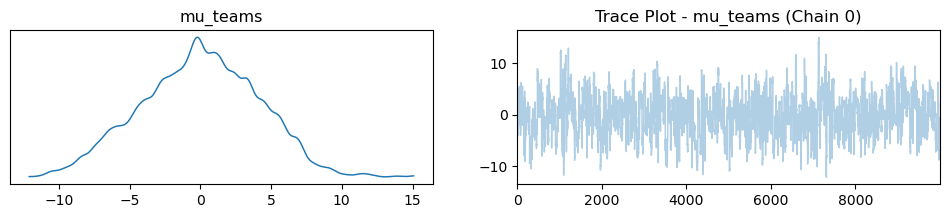

<Figure size 1000x400 with 0 Axes>

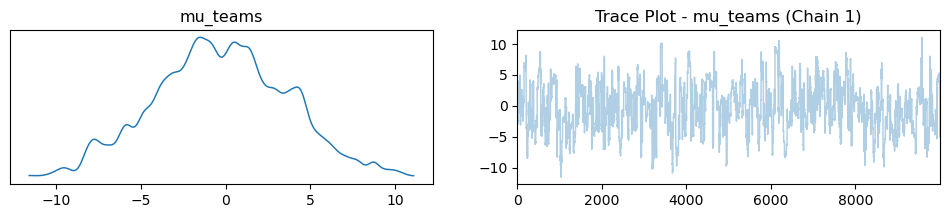

<Figure size 1000x400 with 0 Axes>

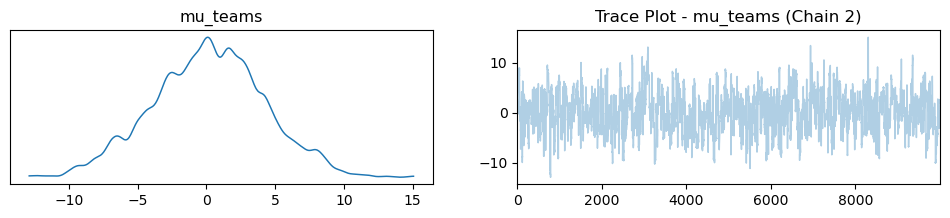

<Figure size 1000x400 with 0 Axes>

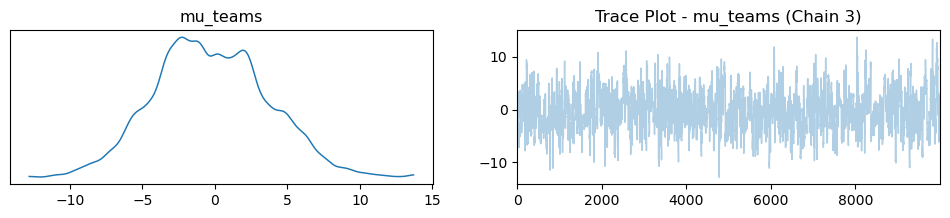

<Figure size 1000x400 with 0 Axes>

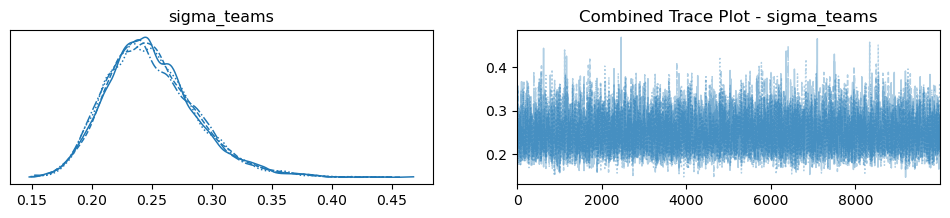

<Figure size 1000x400 with 0 Axes>

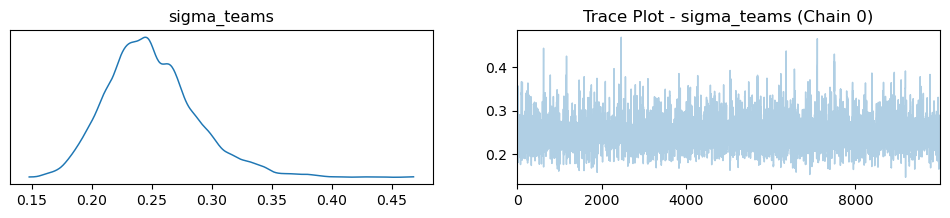

<Figure size 1000x400 with 0 Axes>

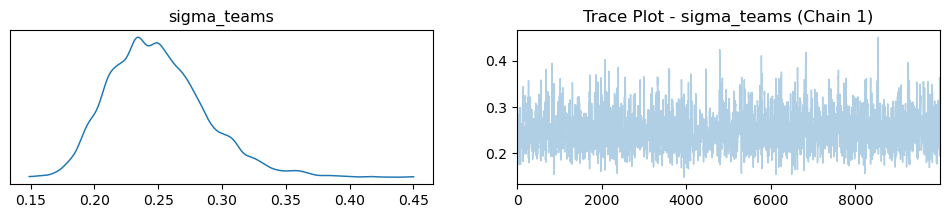

<Figure size 1000x400 with 0 Axes>

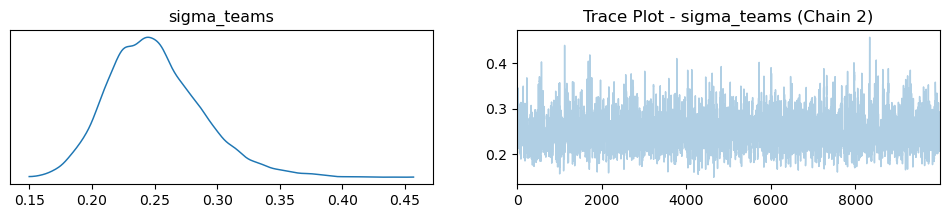

<Figure size 1000x400 with 0 Axes>

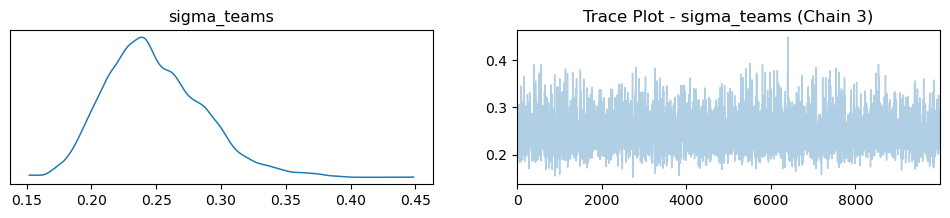

In [50]:
plot_trace_combined(trace_home_adv, 'team_skills')
plot_trace_by_chain(trace_home_adv, 'team_skills')
plot_trace_combined(trace_home_adv, 'baseline_skill')
plot_trace_by_chain(trace_home_adv, 'baseline_skill')
plot_trace_combined(trace_home_adv, 'home_advantage')
plot_trace_by_chain(trace_home_adv, 'home_advantage')
plot_trace_combined(trace_home_adv, 'mu_teams')
plot_trace_by_chain(trace_home_adv, 'mu_teams')
plot_trace_combined(trace_home_adv, 'sigma_teams')
plot_trace_by_chain(trace_home_adv, 'sigma_teams')

In [64]:
# save trace plots for all parameters
save_arviz_plots(trace_home_adv, parameters=['team_skills', 'baseline_skill', 'home_advantage', 'mu_teams', 'sigma_teams'])


#### 1.3 Summary Statistics 

In [53]:
summarize_model(trace_home_adv, "team_skills")

,mean,sd,hdi_3%,hdi_97%,mcse_mean,mcse_sd,ess_bulk,ess_tail,r_hat
team_skills[0],0.090,4.012,-7.706,7.303,0.107,0.076,1414.0,1895.0,1.0
team_skills[1],-0.219,4.012,-8.028,6.986,0.107,0.076,1414.0,1898.0,1.0
team_skills[2],-0.197,4.013,-8.031,6.974,0.107,0.076,1414.0,1902.0,1.0
team_skills[3],-0.461,4.013,-8.164,6.849,0.107,0.076,1415.0,1926.0,1.0
team_skills[4],-0.035,4.012,-7.841,7.175,0.107,0.076,1414.0,1913.0,1.0
team_skills[5],-0.260,4.012,-8.074,6.940,0.107,0.076,1414.0,1919.0,1.0
team_skills[6],-0.107,4.012,-7.851,7.155,0.107,0.076,1414.0,1898.0,1.0
team_skills[7],0.208,4.012,-7.536,7.471,0.107,0.076,1414.0,1905.0,1.0
team_skills[8],0.373,4.012,-7.340,7.666,0.107,0.076,1414.0,1905.0,1.0
team_skills[9],-0.224,4.012,-7.959,7.056,0.107,0.076,1413.0,1914.0,1.0


In [ ]:
summarize_model(trace_home_adv, "baseline_skill")

,mean,sd,hdi_3%,hdi_97%,mcse_mean,mcse_sd,ess_bulk,ess_tail,r_hat
baseline_skill,0.211,0.018,0.177,0.247,0.0,0.0,9516.0,9259.0,1.0


In [ ]:
summarize_model(trace_home_adv, "home_advantage")

,mean,sd,hdi_3%,hdi_97%,mcse_mean,mcse_sd,ess_bulk,ess_tail,r_hat
home_advantage,0.396,0.017,0.363,0.428,0.0,0.0,8696.0,9796.0,1.0


In [ ]:
summarize_model(trace_home_adv, "mu_teams")

,mean,sd,hdi_3%,hdi_97%,mcse_mean,mcse_sd,ess_bulk,ess_tail,r_hat
mu_teams,-0.154,4.003,-7.242,7.639,0.108,0.076,1392.0,1923.0,1.0


In [ ]:
summarize_model(trace_home_adv, "sigma_teams")

,mean,sd,hdi_3%,hdi_97%,mcse_mean,mcse_sd,ess_bulk,ess_tail,r_hat
sigma_teams,0.25,0.039,0.181,0.322,0.0,0.0,9208.0,10260.0,1.0


#### 1.4 Posterior Predictive Check (PPC)

Sampling: [away_goals_observed, home_goals_observed]


Output()

PPC plot saved as 'ppc_home_adv.png'


<Figure size 1200x600 with 0 Axes>

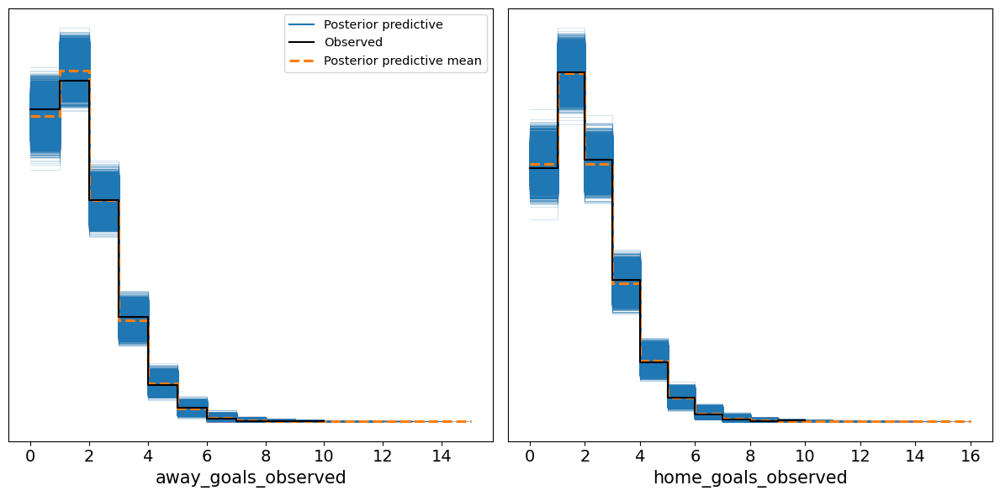

In [55]:
# save PPC plot
ppc_home_adv = save_ppc_plot(model_home_adv, trace_home_adv, "ppc_home_adv.png")

#### 1.5 Model Comparison Metrics (LOO and WAIC)

In [56]:
metrics = calculate_model_comparison_metrics(trace_home_adv)

home_goals_observed - LOO: 
 Computed from 40000 posterior samples and 2280 observations log-likelihood matrix.

             Estimate       SE
deviance_loo  6963.81    65.47
p_loo           14.22        -
------

Pareto k diagnostic values:
                         Count   Pct.
(-Inf, 0.5]   (good)     2280  100.0%
 (0.5, 0.7]   (ok)          0    0.0%
   (0.7, 1]   (bad)         0    0.0%
   (1, Inf)   (very bad)    0    0.0%

home_goals_observed - WAIC: 
 Computed from 40000 posterior samples and 2280 observations log-likelihood matrix.

              Estimate       SE
deviance_waic  6963.80    65.47
p_waic           14.22        -
away_goals_observed - LOO: 
 Computed from 40000 posterior samples and 2280 observations log-likelihood matrix.

             Estimate       SE
deviance_loo  6560.55    67.94
p_loo           13.27        -
------

Pareto k diagnostic values:
                         Count   Pct.
(-Inf, 0.5]   (good)     2280  100.0%
 (0.5, 0.7]   (ok)          0    0.0%
 

#### 1.6 Calculating error metrics (MAE and RMSE)

In [57]:
# Home teams goals
home_mae, home_rmse = calculate_errors(ppc_home_adv, df_18_24, 'Home_Goals', 'home_goals_observed')

# Away Teams goals
away_mae, away_rmse = calculate_errors(ppc_home_adv, df_18_24, 'Away_Goals', 'away_goals_observed')

Home_Goals - MAE: 0.9626794298245613, RMSE: 1.2281807336922927
Away_Goals - MAE: 0.9040723574561403, RMSE: 1.1524406971849939


#### 1.7 Roc- Auc

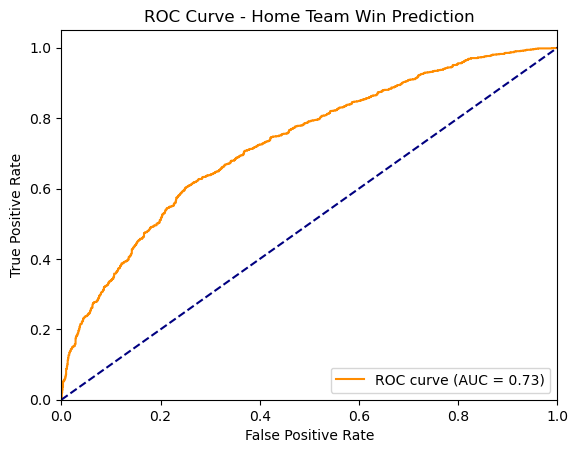

ROC AUC Value: 0.7280994957815775


In [58]:
roc_auc = calculate_and_plot_roc_auc_from_ppc(ppc_home_adv, df_18_24)
print(f"ROC AUC Value: {roc_auc}")

#### 1.8 Energy Plot

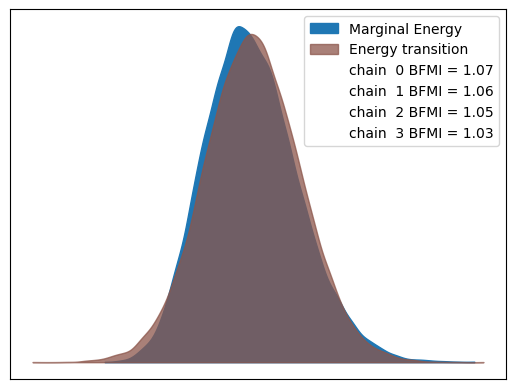

In [ ]:
plot_energy(trace_home_adv)

#### 1.9 Shape of the main Parameters

In [ ]:
print_posterior_shapes(trace_home_adv)

team_skills shape: (4, 10000, 28)
baseline_skill shape: (4, 10000)


#### 1.10 Visulize Team Skills

Plot saved as 'InferenceData.png'


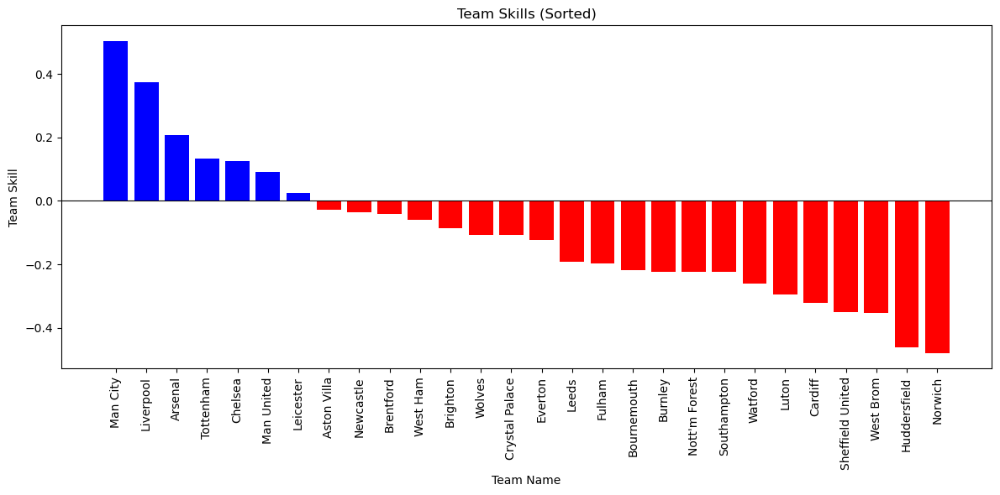

In [72]:
visualize_team_skills(df_18_24, trace_home_adv)

## 7. Home Advantage with Infromative Priors

In [ ]:
def informative_home_advantage_model(data, n_samples=10000, n_tune=2000):
    
    # Determine unique team names and number of games
    unique_teams = np.unique(data[['Home_Team', 'Away_Team']].values)
    n_teams = len(unique_teams)
    n_games = data.shape[0]

    # Get team IDs and goals
    home_team_ids = data['Home_Team_ID'].values
    away_team_ids = data['Away_Team_ID'].values
    home_goals = data['Home_Goals'].values
    away_goals = data['Away_Goals'].values
    
    with pm.Model() as model:
        # Informative priors for team skills
        mu_teams = pm.Normal('mu_teams', mu=1.5, sigma=0.5) 
        sigma_teams = pm.HalfNormal('sigma_teams', sigma=1)
        
        # Priors for team skills
        team_skills = pm.Normal('team_skills', mu=mu_teams, sigma=sigma_teams, shape=n_teams)

        # Prior for baseline skill
        baseline_skill = pm.Normal('baseline_skill', mu=0.3, sigma=0.1)  
        
        # Informative prior for home advantage
        home_advantage = pm.Normal('home_advantage', mu=0.3, sigma=0.1) 
        
        # Likelihood
        lambda_home_goals = pm.Deterministic(
            'lambda_home_goals', 
            pm.math.exp(home_advantage + team_skills[home_team_ids] - team_skills[away_team_ids])
        )
        lambda_away_goals = pm.Deterministic(
            'lambda_away_goals', 
            pm.math.exp(baseline_skill + team_skills[away_team_ids] - team_skills[home_team_ids])
        )

        # Observed goal data
        home_goals_observed = pm.Poisson('home_goals_observed', mu=lambda_home_goals, observed=home_goals)
        away_goals_observed = pm.Poisson('away_goals_observed', mu=lambda_away_goals, observed=away_goals)
        
        # Sample the model
        trace = pm.sample(n_samples, tune=n_tune, cores=4, return_inferencedata=True, idata_kwargs={'log_likelihood': True})
        
    return model, trace


#### 1- Model Application for the 2018-2024 Period

In [23]:
# Getting Model and Trace
model_home_adv_informative, trace_home_adv_informative = informative_home_advantage_model(df_18_24)

Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [mu_teams, sigma_teams, team_skills, baseline_skill, home_advantage]


Output()

Sampling 4 chains for 2_000 tune and 10_000 draw iterations (8_000 + 40_000 draws total) took 158 seconds.


#### 1.1 Summay of the parameters

In [60]:
total_params = summarize_posterior(trace_home_adv_informative)

Posterior Variables: ['baseline_skill', 'home_advantage', 'lambda_away_goals', 'lambda_home_goals', 'mu_teams', 'sigma_teams', 'team_skills']
Total Parameters: 183680000


#### 1.2 Trace Plots

<Figure size 1000x400 with 0 Axes>

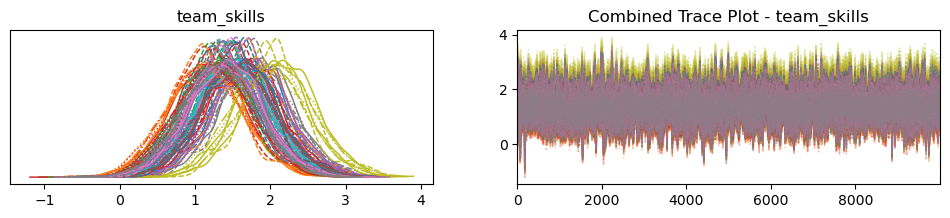

<Figure size 1000x400 with 0 Axes>

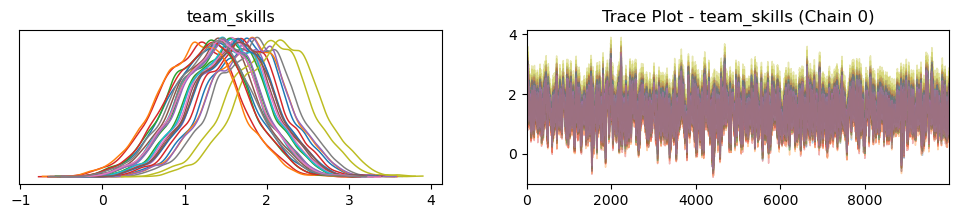

<Figure size 1000x400 with 0 Axes>

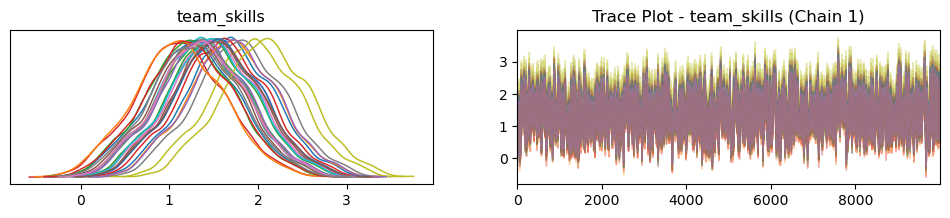

<Figure size 1000x400 with 0 Axes>

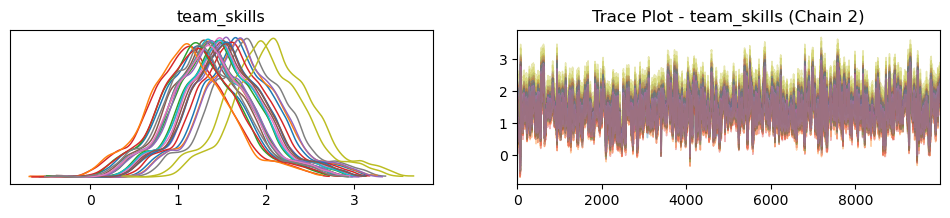

<Figure size 1000x400 with 0 Axes>

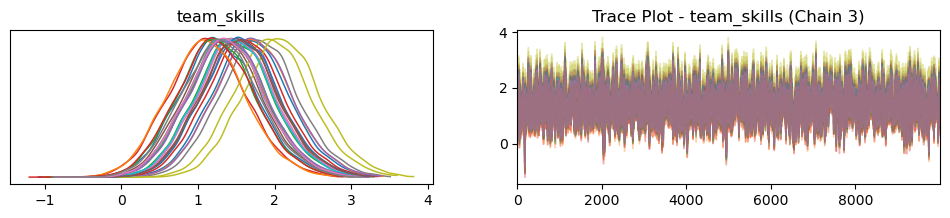

<Figure size 1000x400 with 0 Axes>

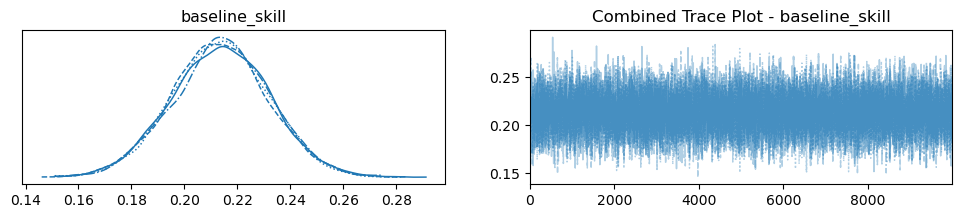

<Figure size 1000x400 with 0 Axes>

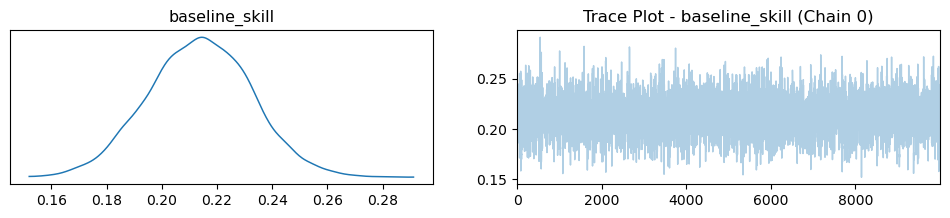

<Figure size 1000x400 with 0 Axes>

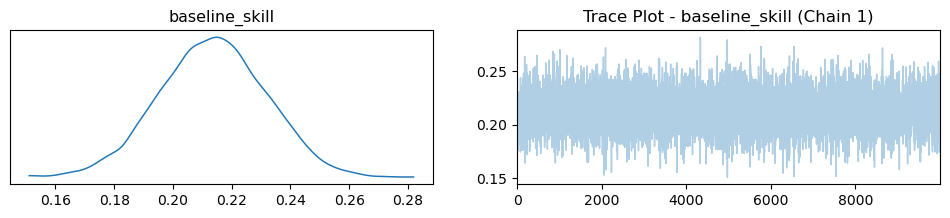

<Figure size 1000x400 with 0 Axes>

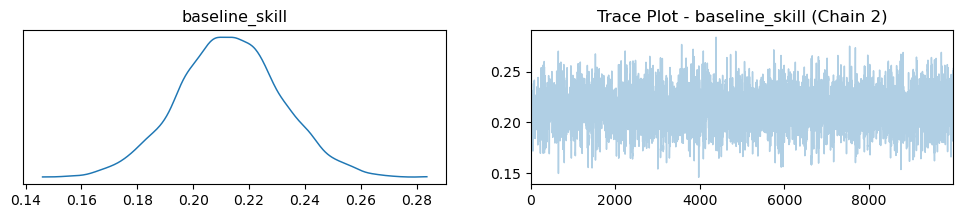

<Figure size 1000x400 with 0 Axes>

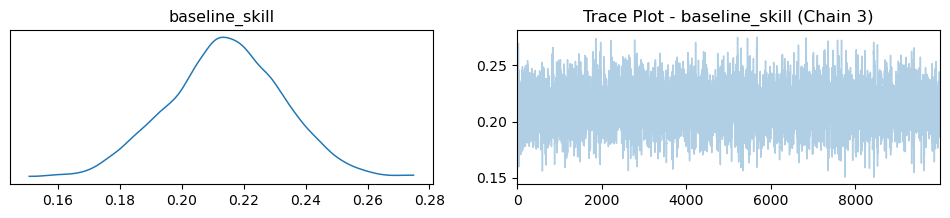

<Figure size 1000x400 with 0 Axes>

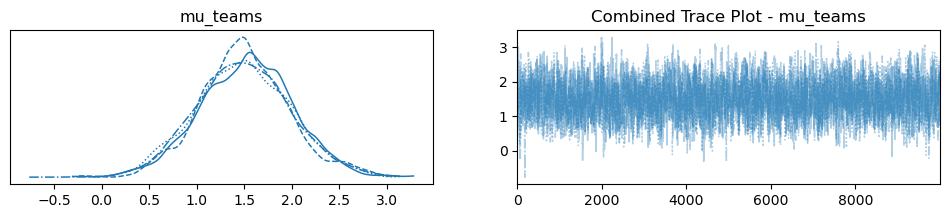

<Figure size 1000x400 with 0 Axes>

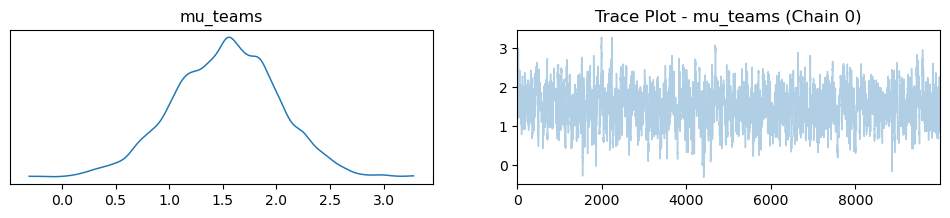

<Figure size 1000x400 with 0 Axes>

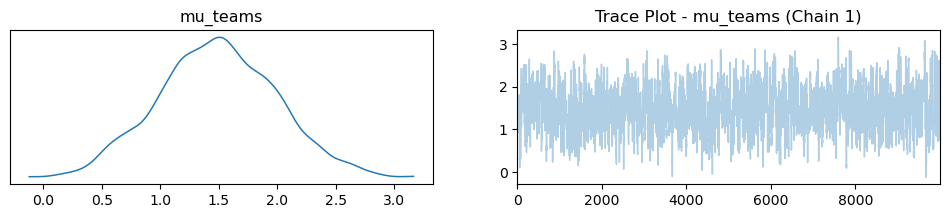

<Figure size 1000x400 with 0 Axes>

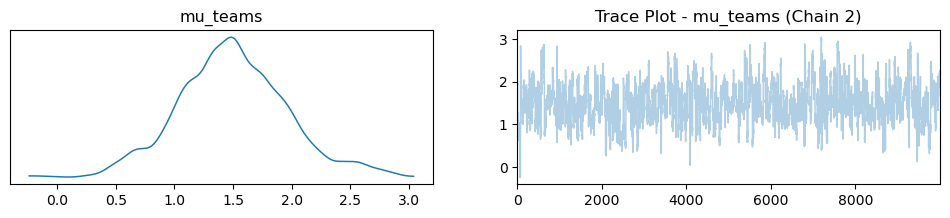

<Figure size 1000x400 with 0 Axes>

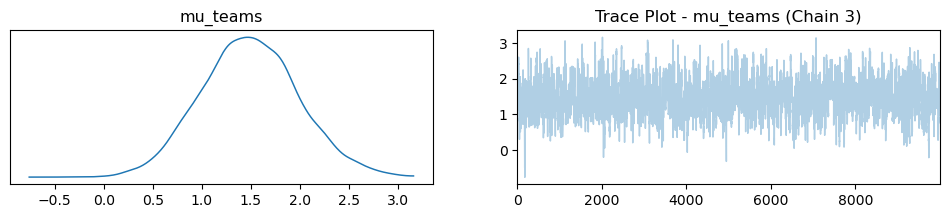

<Figure size 1000x400 with 0 Axes>

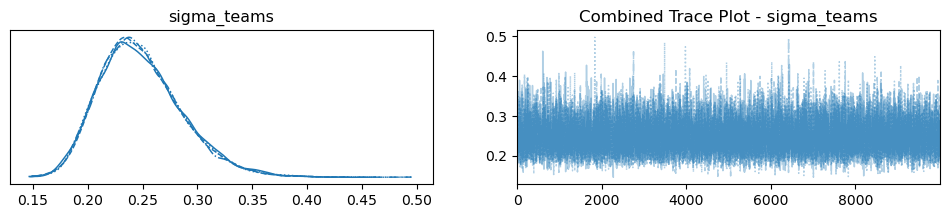

<Figure size 1000x400 with 0 Axes>

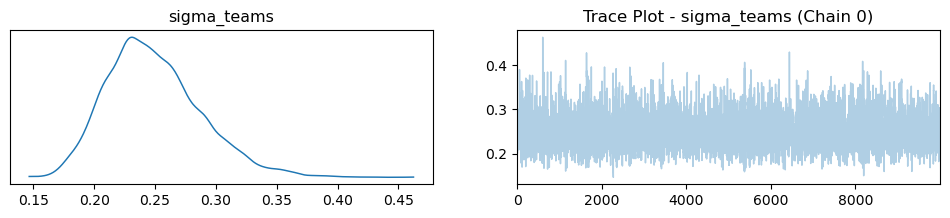

<Figure size 1000x400 with 0 Axes>

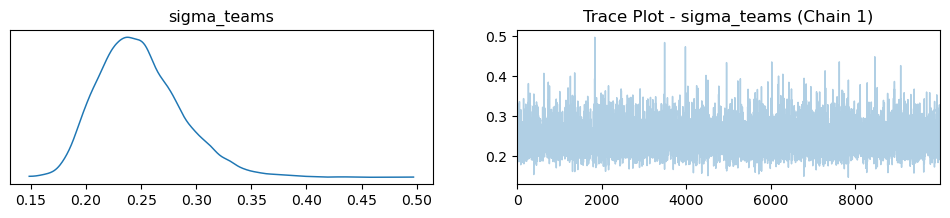

<Figure size 1000x400 with 0 Axes>

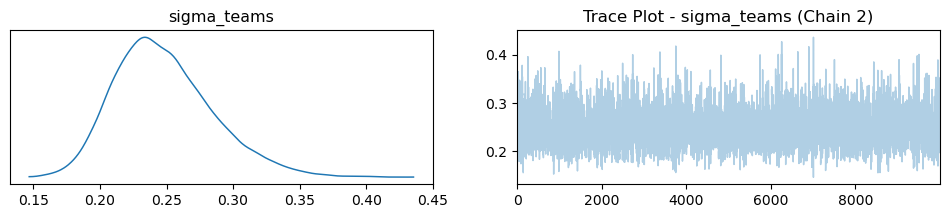

<Figure size 1000x400 with 0 Axes>

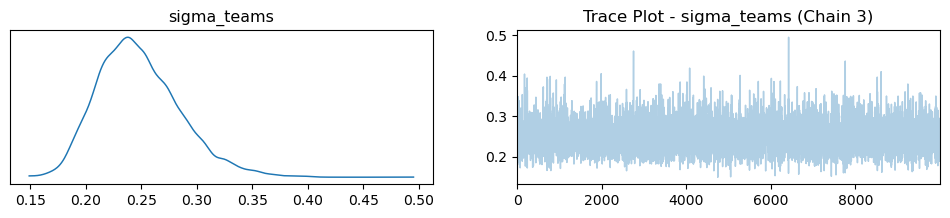

In [61]:
plot_trace_combined(trace_home_adv_informative, 'team_skills')
plot_trace_by_chain(trace_home_adv_informative, 'team_skills')
plot_trace_combined(trace_home_adv_informative, 'baseline_skill')
plot_trace_by_chain(trace_home_adv_informative, 'baseline_skill')
plot_trace_combined(trace_home_adv_informative, 'mu_teams')
plot_trace_by_chain(trace_home_adv_informative, 'mu_teams')
plot_trace_combined(trace_home_adv_informative, 'sigma_teams')
plot_trace_by_chain(trace_home_adv_informative, 'sigma_teams')

In [ ]:
# Save trace plots for all parameters
save_arviz_plots(trace_home_adv_informative, parameters=['team_skills', 'baseline_skill', 'home_advantage', 'mu_teams', 'sigma_teams'])

#### 1.3 Summary Statistics of Model Parameters

In [42]:
summarize_model(trace_home_adv_informative, "team_skills")

,mean,sd,hdi_3%,hdi_97%,mcse_mean,mcse_sd,ess_bulk,ess_tail,r_hat
team_skills[0],1.692,0.493,0.766,2.608,0.01,0.007,2246.0,3101.0,1.0
team_skills[1],1.383,0.493,0.471,2.314,0.01,0.007,2259.0,3086.0,1.0
team_skills[2],1.405,0.493,0.477,2.323,0.01,0.007,2254.0,3115.0,1.0
team_skills[3],1.141,0.499,0.200,2.074,0.01,0.007,2301.0,3325.0,1.0
team_skills[4],1.567,0.493,0.661,2.501,0.01,0.007,2246.0,3128.0,1.0
team_skills[5],1.342,0.494,0.424,2.275,0.01,0.007,2253.0,3174.0,1.0
team_skills[6],1.496,0.493,0.561,2.399,0.01,0.007,2242.0,3132.0,1.0
team_skills[7],1.810,0.493,0.900,2.741,0.01,0.007,2250.0,3119.0,1.0
team_skills[8],1.976,0.493,1.053,2.890,0.01,0.007,2249.0,3074.0,1.0
team_skills[9],1.378,0.493,0.455,2.296,0.01,0.007,2245.0,3194.0,1.0


In [43]:
summarize_model(trace_home_adv_informative, "baseline_skill")

,mean,sd,hdi_3%,hdi_97%,mcse_mean,mcse_sd,ess_bulk,ess_tail,r_hat
baseline_skill,0.214,0.019,0.179,0.249,0.0,0.0,16128.0,15640.0,1.0


In [44]:
summarize_model(trace_home_adv_informative, "home_advantage")

,mean,sd,hdi_3%,hdi_97%,mcse_mean,mcse_sd,ess_bulk,ess_tail,r_hat
home_advantage,0.393,0.017,0.361,0.425,0.0,0.0,15828.0,16477.0,1.0


In [45]:
summarize_model(trace_home_adv_informative, "mu_teams")

,mean,sd,hdi_3%,hdi_97%,mcse_mean,mcse_sd,ess_bulk,ess_tail,r_hat
mu_teams,1.498,0.489,0.565,2.388,0.01,0.007,2252.0,3160.0,1.0


In [70]:
summarize_model(trace_home_adv_informative, "sigma_teams")

,mean,sd,hdi_3%,hdi_97%,mcse_mean,mcse_sd,ess_bulk,ess_tail,r_hat
sigma_teams,0.248,0.038,0.181,0.319,0.0,0.0,17666.0,17394.0,1.0


#### 1.4 Posterior Predictive Checks (PPC) and Other Metrics

Sampling: [away_goals_observed, home_goals_observed]


Output()

PPC plot saved as 'ppc_home_adv_informative.png'


<Figure size 1200x600 with 0 Axes>

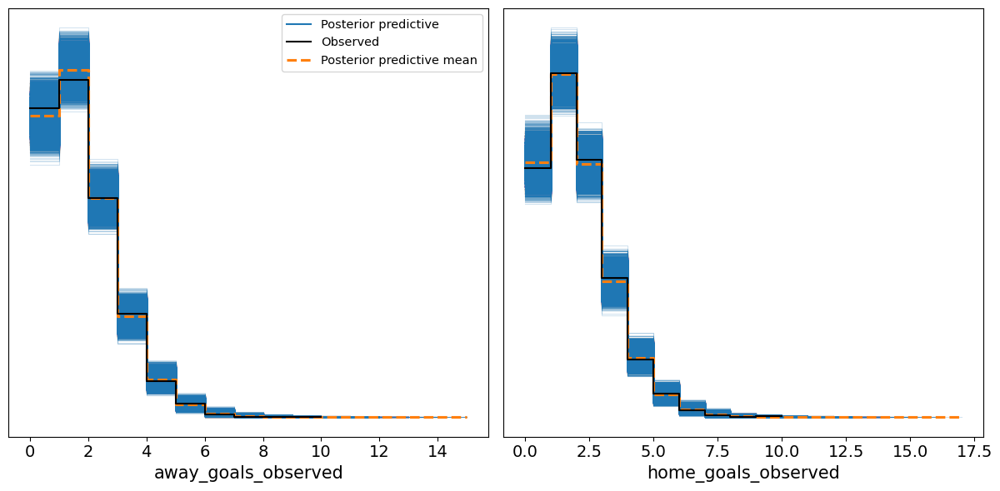

In [71]:
# save PPC plot
ppc_home_adv_informative = save_ppc_plot(model_home_adv_informative, trace_home_adv_informative, "ppc_home_adv_informative.png")

#### 1.5 Model Comparison Metrics (LOO and WAIC)

In [73]:
metrics = calculate_model_comparison_metrics(trace_home_adv_informative)

home_goals_observed - LOO: 
 Computed from 40000 posterior samples and 2280 observations log-likelihood matrix.

             Estimate       SE
deviance_loo  6963.91    65.70
p_loo           14.24        -
------

Pareto k diagnostic values:
                         Count   Pct.
(-Inf, 0.5]   (good)     2280  100.0%
 (0.5, 0.7]   (ok)          0    0.0%
   (0.7, 1]   (bad)         0    0.0%
   (1, Inf)   (very bad)    0    0.0%

home_goals_observed - WAIC: 
 Computed from 40000 posterior samples and 2280 observations log-likelihood matrix.

              Estimate       SE
deviance_waic  6963.90    65.70
p_waic           14.24        -
away_goals_observed - LOO: 
 Computed from 40000 posterior samples and 2280 observations log-likelihood matrix.

             Estimate       SE
deviance_loo  6560.53    67.73
p_loo           13.27        -
------

Pareto k diagnostic values:
                         Count   Pct.
(-Inf, 0.5]   (good)     2280  100.0%
 (0.5, 0.7]   (ok)          0    0.0%
 

#### 1.6 Calculating error metrics (MAE and RMSE)

In [74]:
# Home teams goals
home_mae, home_rmse = calculate_errors(ppc_home_adv_informative, df_18_24, 'Home_Goals', 'home_goals_observed')

# Away Teams goals
away_mae, away_rmse = calculate_errors(ppc_home_adv_informative, df_18_24, 'Away_Goals', 'away_goals_observed')

Home_Goals - MAE: 0.9620924451754387, RMSE: 1.2282192941314265
Away_Goals - MAE: 0.9045082675438595, RMSE: 1.152341181317922


#### 1.7 Roc- Auc

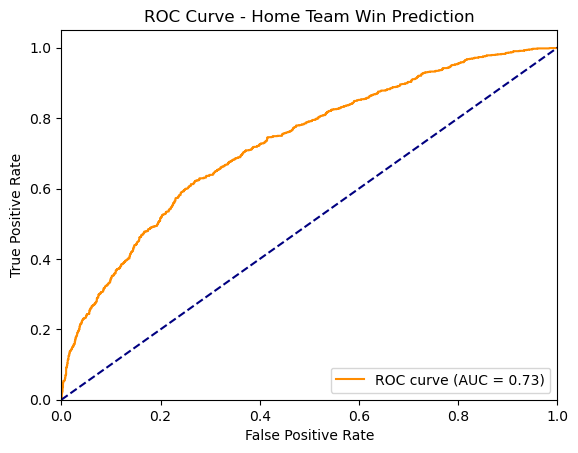

ROC AUC Value: 0.7285718843947551


In [75]:
roc_auc = calculate_and_plot_roc_auc_from_ppc(ppc_home_adv_informative, df_18_24)
print(f"ROC AUC Value: {roc_auc}")

#### 1.8 Energy Plot

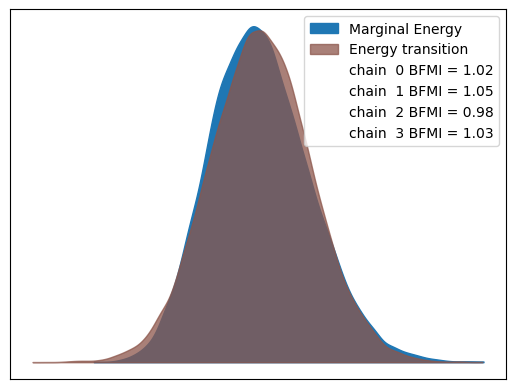

In [76]:
plot_energy(trace_home_adv_informative)

#### 1.9 Shape of the main Parameters

In [77]:
print_posterior_shapes(trace_home_adv_informative)

team_skills shape: (4, 10000, 28)
baseline_skill shape: (4, 10000)


Plot saved as 'home_adv_informative_team_skill.png'


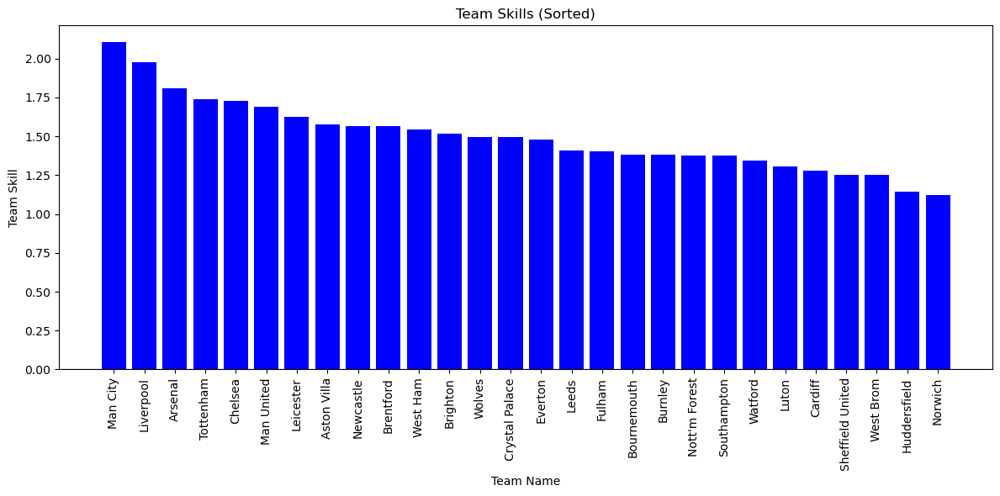

In [46]:
visualize_team_skills(df_18_24, trace_home_adv_informative, filename="home_adv_informative_team_skill.png")

## 8. Home Advantave Non Centered Model

In [51]:
def home_advantage_non_centered(data, n_samples=10000, n_tune=2000):
    
    # Determine unique team names and number of games
    unique_teams = np.unique(data[['Home_Team', 'Away_Team']].values)
    n_teams = len(unique_teams)

    # Get team IDs and goals
    home_team_ids = data['Home_Team_ID'].values
    away_team_ids = data['Away_Team_ID'].values
    home_goals = data['Home_Goals'].values
    away_goals = data['Away_Goals'].values
    
    with pm.Model() as model:
        
        # Hyperpriors for team skills
        mu_teams = pm.Normal('mu_teams', mu=0, sigma=4)
        sigma_teams = pm.HalfNormal('sigma_teams', sigma=1) 
        
        # Non-centered parametrization for team skills
        raw_team_skills = pm.Normal('raw_team_skills', mu=0, sigma=1, shape=n_teams)
        team_skills = pm.Deterministic('team_skills', mu_teams + raw_team_skills * sigma_teams)
        # Priors for baseline skill
        baseline_skill = pm.Normal('baseline_skill', mu=0, sigma=4)
        
        # Priors for home advantage 
        home_advantage = pm.Normal('home_advantage', mu=0, sigma=4)
        
        
        # Likelihood with home and away baselines
        lambda_home_goals = pm.Deterministic('lambda_home_goals', pm.math.exp(home_advantage + team_skills[home_team_ids] - team_skills[away_team_ids]))
        lambda_away_goals = pm.Deterministic('lambda_away_goals', pm.math.exp(baseline_skill + team_skills[away_team_ids] - team_skills[home_team_ids]))
        
        # Observed goal data
        home_goals_observed = pm.Poisson('home_goals_observed', mu=lambda_home_goals, observed=home_goals)
        away_goals_observed = pm.Poisson('away_goals_observed', mu=lambda_away_goals, observed=away_goals)
        
        # Sample the model
        trace = pm.sample(n_samples, tune=n_tune, cores=4, return_inferencedata=True, idata_kwargs={'log_likelihood': True})
        
    return model, trace


### 1. Model Application for the 2018-2024

In [53]:
gc.collect()

0

In [54]:
model_home_adv_non_centered, trace_home_adv_non_centered = home_advantage_non_centered(df_18_24)

Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [mu_teams, sigma_teams, raw_team_skills, baseline_skill, home_advantage]


Output()

Sampling 4 chains for 2_000 tune and 10_000 draw iterations (8_000 + 40_000 draws total) took 46 seconds.


#### 1.1 Summay of the parameters

In [ ]:
total_params = summarize_posterior(trace_home_adv_non_centered)

Posterior Variables: ['baseline_skill', 'home_advantage', 'lambda_away_goals', 'lambda_home_goals', 'mu_teams', 'raw_team_skills', 'sigma_teams', 'team_skills']
Total Parameters: 184800000


#### 1.2 Trace Plots

<Figure size 1000x400 with 0 Axes>

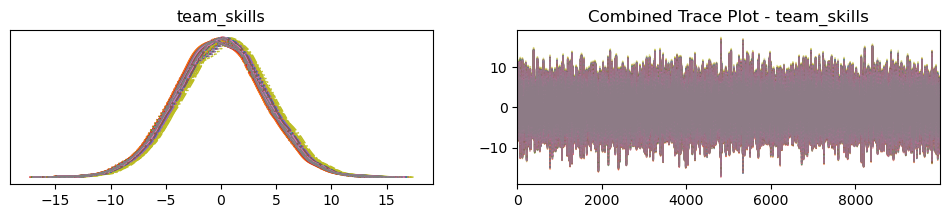

<Figure size 1000x400 with 0 Axes>

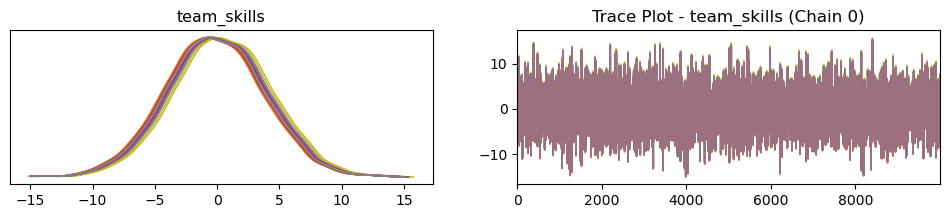

<Figure size 1000x400 with 0 Axes>

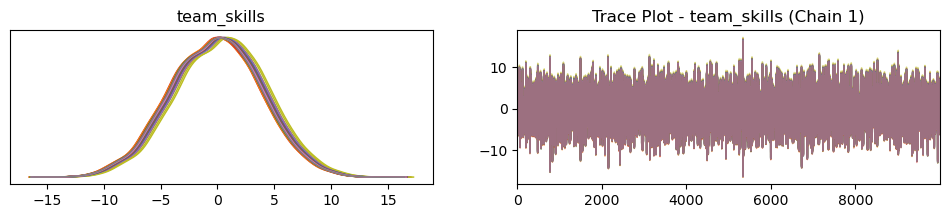

<Figure size 1000x400 with 0 Axes>

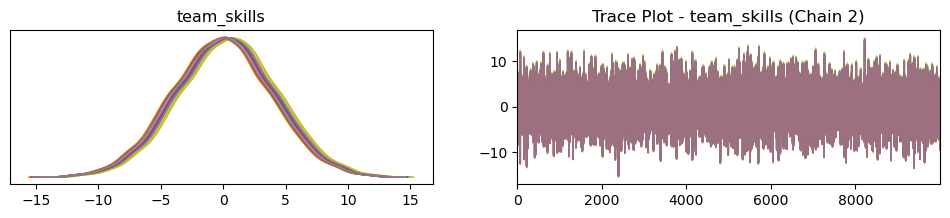

<Figure size 1000x400 with 0 Axes>

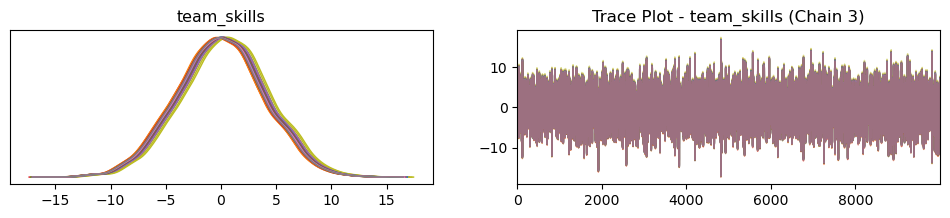

<Figure size 1000x400 with 0 Axes>

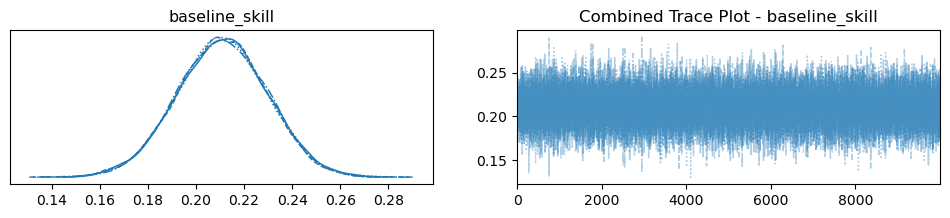

<Figure size 1000x400 with 0 Axes>

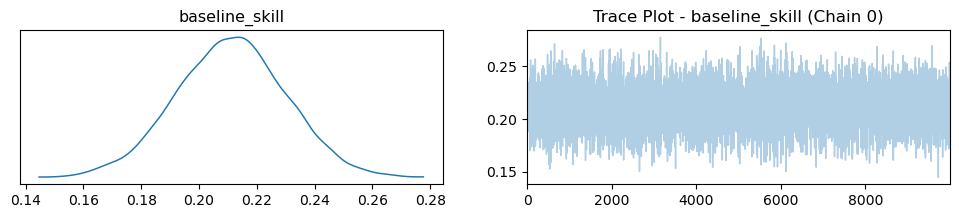

<Figure size 1000x400 with 0 Axes>

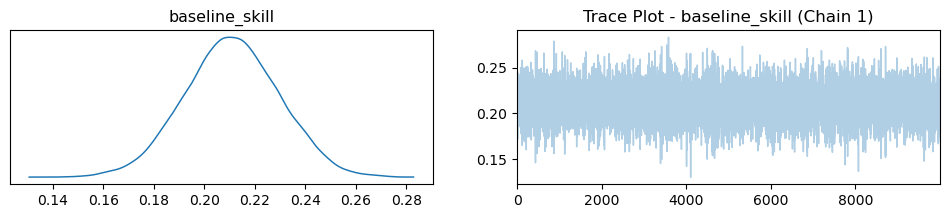

<Figure size 1000x400 with 0 Axes>

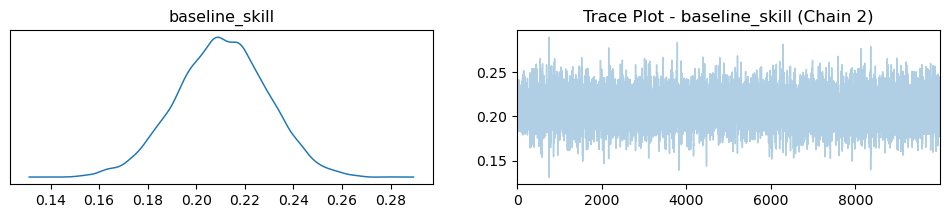

<Figure size 1000x400 with 0 Axes>

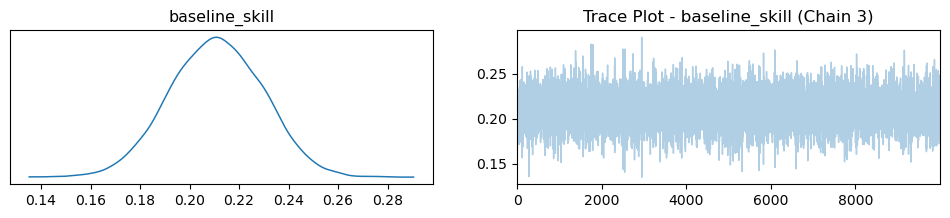

<Figure size 1000x400 with 0 Axes>

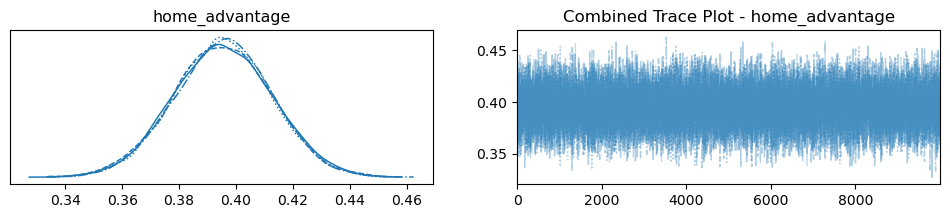

<Figure size 1000x400 with 0 Axes>

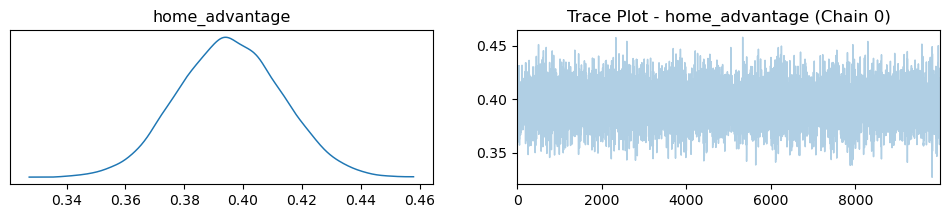

<Figure size 1000x400 with 0 Axes>

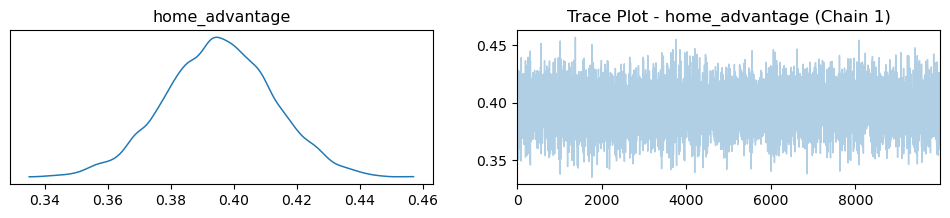

<Figure size 1000x400 with 0 Axes>

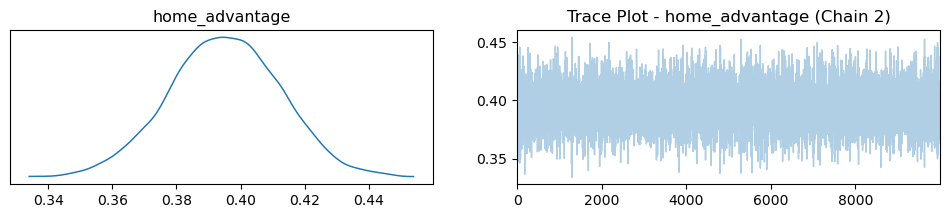

<Figure size 1000x400 with 0 Axes>

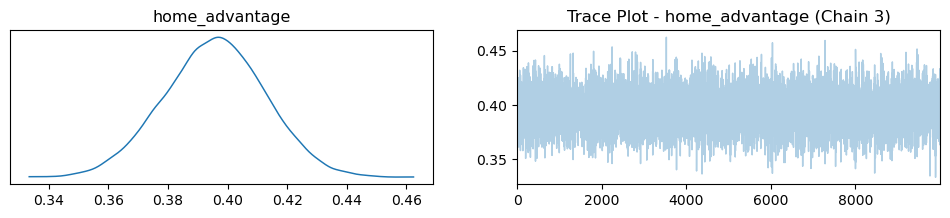

<Figure size 1000x400 with 0 Axes>

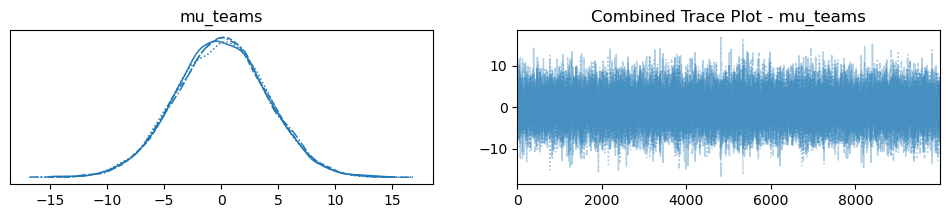

<Figure size 1000x400 with 0 Axes>

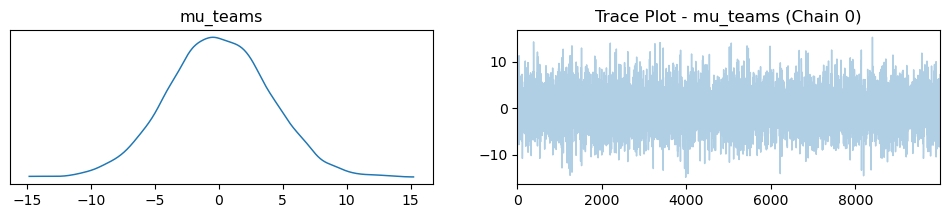

<Figure size 1000x400 with 0 Axes>

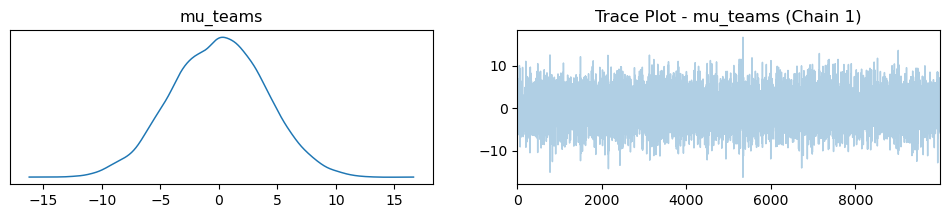

<Figure size 1000x400 with 0 Axes>

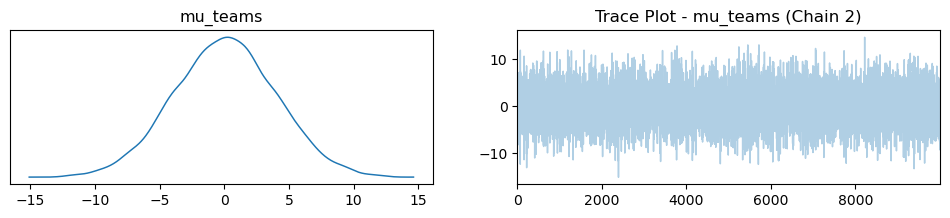

<Figure size 1000x400 with 0 Axes>

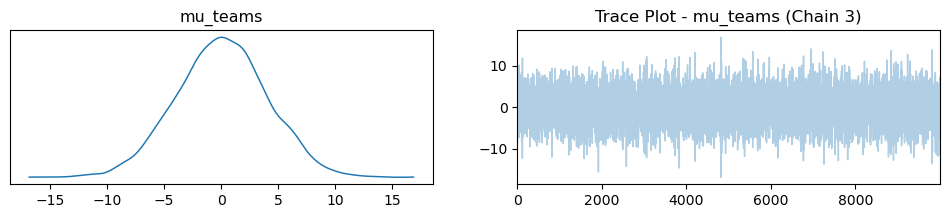

<Figure size 1000x400 with 0 Axes>

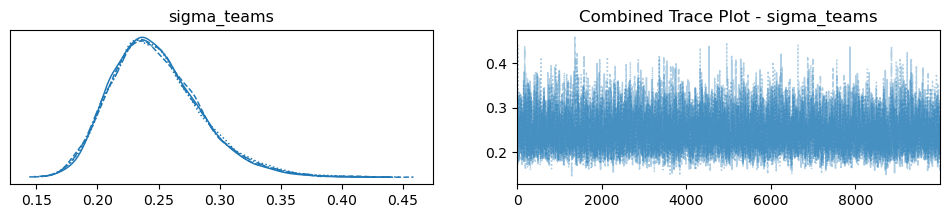

<Figure size 1000x400 with 0 Axes>

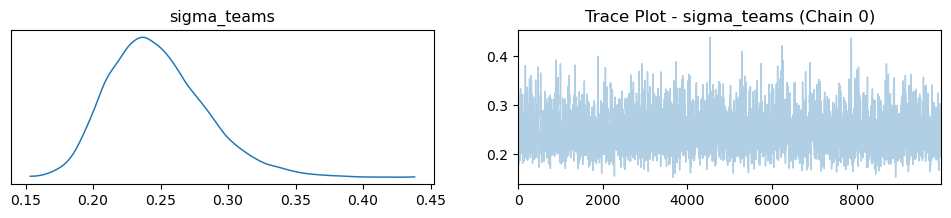

<Figure size 1000x400 with 0 Axes>

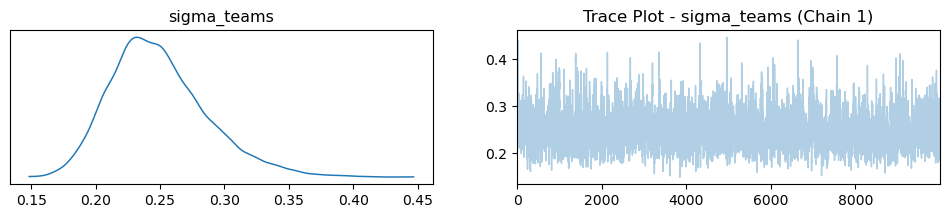

<Figure size 1000x400 with 0 Axes>

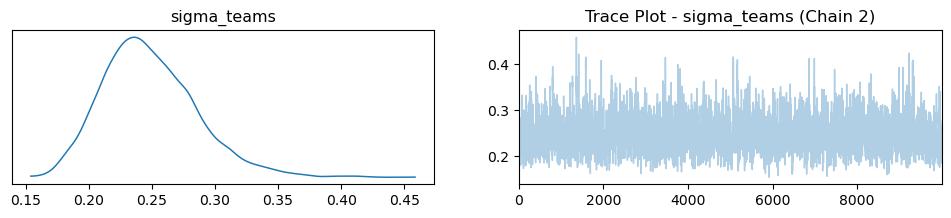

<Figure size 1000x400 with 0 Axes>

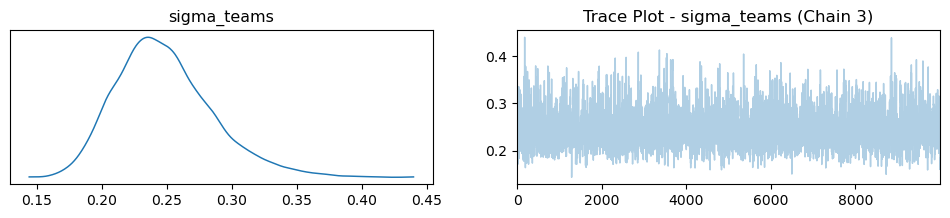

In [32]:
plot_trace_combined(trace_home_adv_non_centered, 'team_skills')
plot_trace_by_chain(trace_home_adv_non_centered, 'team_skills')
plot_trace_combined(trace_home_adv_non_centered, 'baseline_skill')
plot_trace_by_chain(trace_home_adv_non_centered, 'baseline_skill')
plot_trace_combined(trace_home_adv_non_centered, 'home_advantage')
plot_trace_by_chain(trace_home_adv_non_centered, 'home_advantage')
plot_trace_combined(trace_home_adv_non_centered, 'mu_teams')
plot_trace_by_chain(trace_home_adv_non_centered, 'mu_teams')
plot_trace_combined(trace_home_adv_non_centered, 'sigma_teams')
plot_trace_by_chain(trace_home_adv_non_centered, 'sigma_teams')

In [33]:
# Save trace plots for all parameters
save_arviz_plots(trace_home_adv_non_centered, parameters=['team_skills', 'baseline_skill', 'home_advantage', 'mu_teams', 'sigma_teams'])

#### 1.3 Summary Statistics 

In [34]:
summarize_model(trace_home_adv_non_centered, "team_skills")

,mean,sd,hdi_3%,hdi_97%,mcse_mean,mcse_sd,ess_bulk,ess_tail,r_hat
team_skills[0],0.209,3.999,-7.300,7.664,0.022,0.022,34474.0,26090.0,1.0
team_skills[1],-0.100,3.999,-7.664,7.315,0.022,0.022,34475.0,26090.0,1.0
team_skills[2],-0.078,3.999,-7.655,7.326,0.022,0.022,34485.0,26055.0,1.0
team_skills[3],-0.342,3.999,-7.939,7.039,0.022,0.022,34478.0,26437.0,1.0
team_skills[4],0.084,3.999,-7.470,7.509,0.022,0.022,34468.0,25742.0,1.0
team_skills[5],-0.140,3.999,-7.645,7.326,0.022,0.022,34469.0,25842.0,1.0
team_skills[6],0.013,3.999,-7.575,7.405,0.022,0.022,34472.0,25864.0,1.0
team_skills[7],0.327,3.999,-7.258,7.721,0.022,0.022,34456.0,25672.0,1.0
team_skills[8],0.493,3.999,-7.144,7.847,0.022,0.022,34475.0,25825.0,1.0
team_skills[9],-0.105,3.999,-7.621,7.350,0.022,0.022,34465.0,26019.0,1.0


In [35]:
summarize_model(trace_home_adv_non_centered, "baseline_skill")

,mean,sd,hdi_3%,hdi_97%,mcse_mean,mcse_sd,ess_bulk,ess_tail,r_hat
baseline_skill,0.211,0.019,0.175,0.246,0.0,0.0,43333.0,28373.0,1.0


In [36]:
summarize_model(trace_home_adv_non_centered, "home_advantage")

,mean,sd,hdi_3%,hdi_97%,mcse_mean,mcse_sd,ess_bulk,ess_tail,r_hat
home_advantage,0.395,0.017,0.362,0.428,0.0,0.0,35992.0,27266.0,1.0


In [37]:
summarize_model(trace_home_adv_non_centered, "mu_teams")

,mean,sd,hdi_3%,hdi_97%,mcse_mean,mcse_sd,ess_bulk,ess_tail,r_hat
mu_teams,0.016,3.998,-7.63,7.355,0.022,0.022,34484.0,26073.0,1.0


In [38]:
summarize_model(trace_home_adv_non_centered, "sigma_teams")

,mean,sd,hdi_3%,hdi_97%,mcse_mean,mcse_sd,ess_bulk,ess_tail,r_hat
sigma_teams,0.248,0.037,0.183,0.319,0.0,0.0,6542.0,9819.0,1.0


#### 1.4 Posterior Predictieve Check (PPC)

Sampling: [away_goals_observed, home_goals_observed]


Output()

PPC plot saved as 'ppc_home_adv_non_centered.png'


<Figure size 1200x600 with 0 Axes>

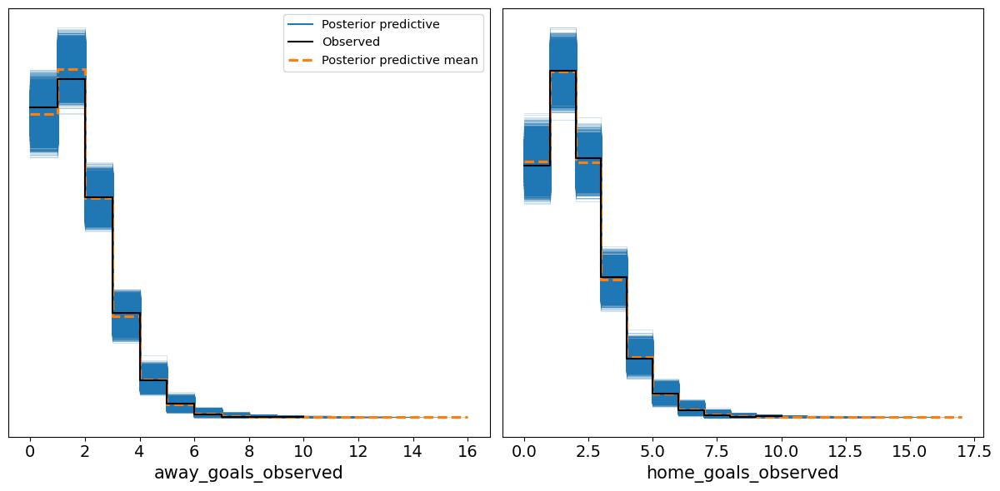

In [40]:
# save PPC plot
ppc_home_adv_non_centered = save_ppc_plot(model_home_adv_non_centered, trace_home_adv_non_centered, "ppc_home_adv_non_centered.png")

#### 1.5 Model Comparison Metrics (LOO and WAIC)

In [41]:
metrics = calculate_model_comparison_metrics(trace_home_adv_non_centered)

home_goals_observed - LOO: 
 Computed from 40000 posterior samples and 2280 observations log-likelihood matrix.

             Estimate       SE
deviance_loo  6963.89    65.48
p_loo           14.26        -
------

Pareto k diagnostic values:
                         Count   Pct.
(-Inf, 0.5]   (good)     2280  100.0%
 (0.5, 0.7]   (ok)          0    0.0%
   (0.7, 1]   (bad)         0    0.0%
   (1, Inf)   (very bad)    0    0.0%

home_goals_observed - WAIC: 
 Computed from 40000 posterior samples and 2280 observations log-likelihood matrix.

              Estimate       SE
deviance_waic  6963.88    65.48
p_waic           14.25        -
away_goals_observed - LOO: 
 Computed from 40000 posterior samples and 2280 observations log-likelihood matrix.

             Estimate       SE
deviance_loo  6560.55    67.96
p_loo           13.28        -
------

Pareto k diagnostic values:
                         Count   Pct.
(-Inf, 0.5]   (good)     2280  100.0%
 (0.5, 0.7]   (ok)          0    0.0%
 

#### 1.6 Calculating error metrics (MAE and RMS

In [42]:
# Home teams goals
home_mae, home_rmse = calculate_errors(ppc_home_adv_non_centered, df_18_24, 'Home_Goals', 'home_goals_observed')

# Away Teams goals
away_mae, away_rmse = calculate_errors(ppc_home_adv_non_centered, df_18_24, 'Away_Goals', 'away_goals_observed')

Home_Goals - MAE: 0.9626398026315789, RMSE: 1.228279671441896
Away_Goals - MAE: 0.9040444298245615, RMSE: 1.152455609672148


#### 1.7 Roc- Auc

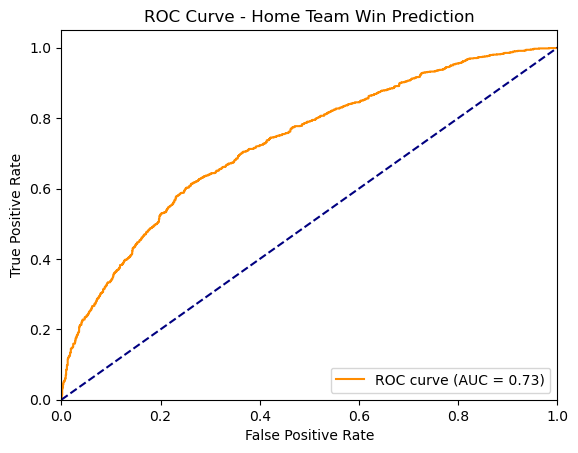

ROC AUC Value: 0.7284158482877665


In [43]:
roc_auc = calculate_and_plot_roc_auc_from_ppc(ppc_home_adv_non_centered, df_18_24)
print(f"ROC AUC Value: {roc_auc}")

#### 1.8 Energy Plot

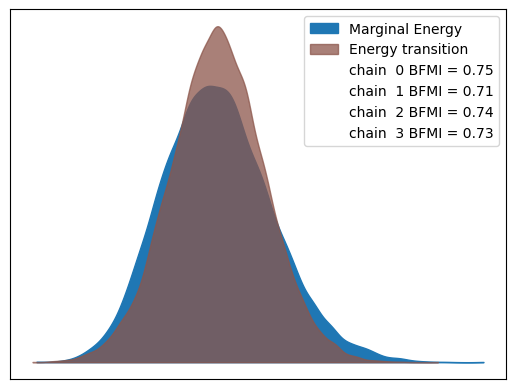

In [44]:
plot_energy(trace_home_adv_non_centered)

#### 1.9 Shape of the main Parameters

In [ ]:
print_posterior_shapes(trace_home_adv_non_centered)

team_skills shape: (4, 10000, 28)
baseline_skill shape: (4, 10000)


Plot saved as 'home_adv_non_centered_team_skill.png'


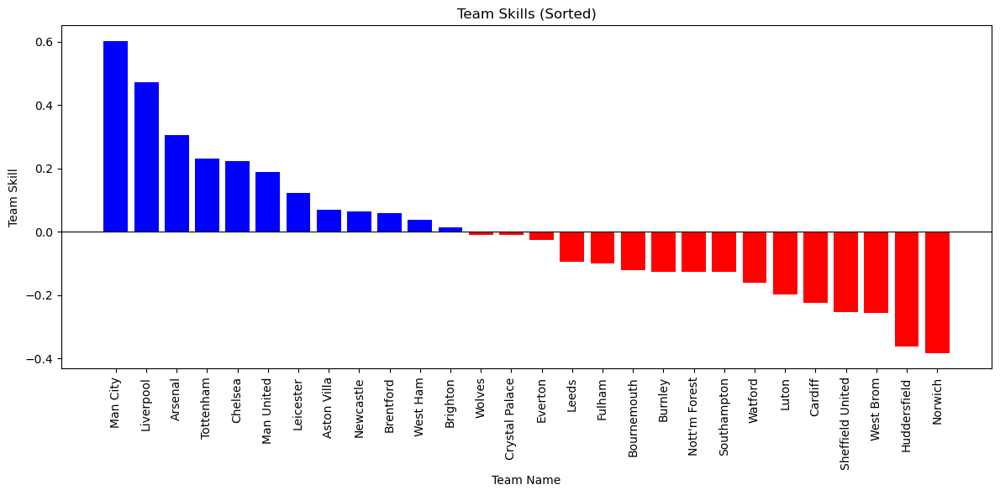

In [52]:
visualize_team_skills(df_18_24, trace_home_adv_non_centered, filename="home_adv_non_centered_team_skill.png")

## 9.  Home Advantage Non Centered Model with Informative Priors

In [45]:
def home_advantage_informative_non_centered(data, n_samples=10000, n_tune=2000):
    
    # Determine unique team names and number of games
    unique_teams = np.unique(data[['Home_Team', 'Away_Team']].values)
    n_teams = len(unique_teams)

    # Get team IDs and goals
    home_team_ids = data['Home_Team_ID'].values
    away_team_ids = data['Away_Team_ID'].values
    home_goals = data['Home_Goals'].values
    away_goals = data['Away_Goals'].values
    
    with pm.Model() as model:
        
        # Informative hyperpriors for team skills
        mu_teams = pm.Normal('mu_teams', mu=1.5, sigma=0.5)  
        sigma_teams = pm.HalfNormal('sigma_teams', sigma= 1)  
        
        # Non-centered parametrization for team skills
        raw_team_skills = pm.Normal('raw_team_skills', mu=0, sigma=1, shape=n_teams)
        team_skills = pm.Deterministic('team_skills', mu_teams + raw_team_skills * sigma_teams)

        # Informative prior for baseline skill
        baseline_skill = pm.Normal('baseline_skill', mu=0.3, sigma=0.1)  
        
        # Informative prior for home advantage
        home_advantage = pm.Normal('home_advantage', mu=0.3, sigma=0.1)  #
        
        # Likelihood with home and away baselines
        lambda_home_goals = pm.Deterministic(
            'lambda_home_goals', 
            pm.math.exp(home_advantage + team_skills[home_team_ids] - team_skills[away_team_ids])
        )
        lambda_away_goals = pm.Deterministic(
            'lambda_away_goals', 
            pm.math.exp(baseline_skill + team_skills[away_team_ids] - team_skills[home_team_ids])
        )
        
        # Observed goal data
        home_goals_observed = pm.Poisson('home_goals_observed', mu=lambda_home_goals, observed=home_goals)
        away_goals_observed = pm.Poisson('away_goals_observed', mu=lambda_away_goals, observed=away_goals)
        
        # Sample the model
        trace = pm.sample(n_samples, tune=n_tune, cores=4, return_inferencedata=True, idata_kwargs={'log_likelihood': True})
    
    return model, trace


#### 1- Model Application for the 2018-2023 Period

In [46]:
# Getting Model and Trace
model_home_advantage_informative_non_centered, trace_home_advantage_informative_non_centered = home_advantage_informative_non_centered(df_18_24)

Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [mu_teams, sigma_teams, raw_team_skills, baseline_skill, home_advantage]


Output()

Sampling 4 chains for 2_000 tune and 10_000 draw iterations (8_000 + 40_000 draws total) took 44 seconds.


#### 1.1 Summay of the parameters

In [60]:
total_params = summarize_posterior(trace_home_advantage_informative_non_centered)

Posterior Variables: ['baseline_skill', 'home_advantage', 'lambda_away_goals', 'lambda_home_goals', 'mu_teams', 'raw_team_skills', 'sigma_teams', 'team_skills']
Total Parameters: 184800000


#### 1.2 Trace Plots

<Figure size 1000x400 with 0 Axes>

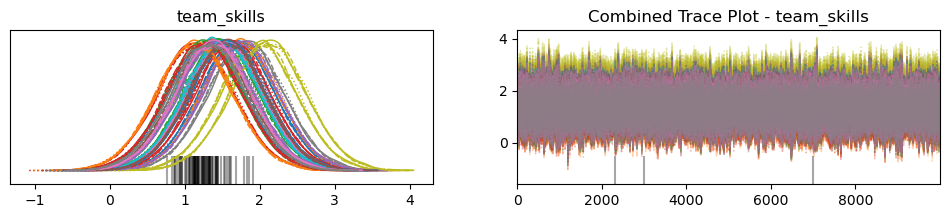

<Figure size 1000x400 with 0 Axes>

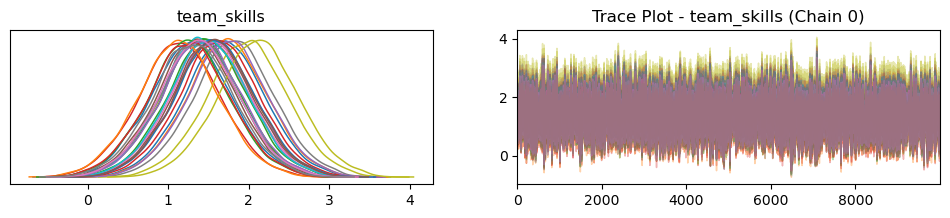

<Figure size 1000x400 with 0 Axes>

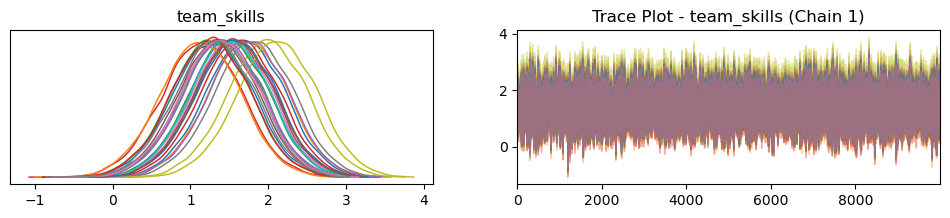

<Figure size 1000x400 with 0 Axes>

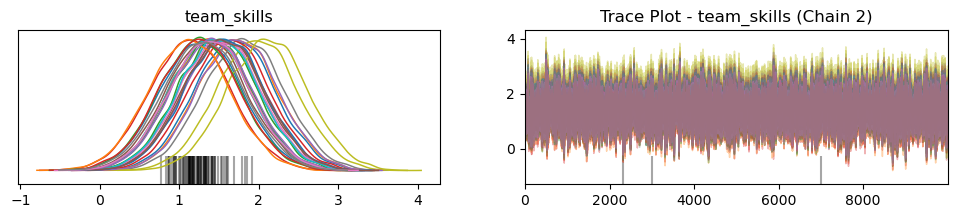

<Figure size 1000x400 with 0 Axes>

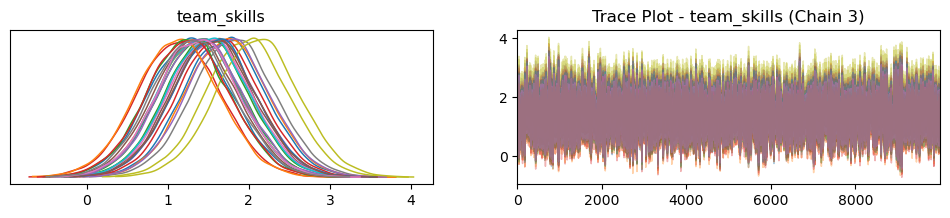

<Figure size 1000x400 with 0 Axes>

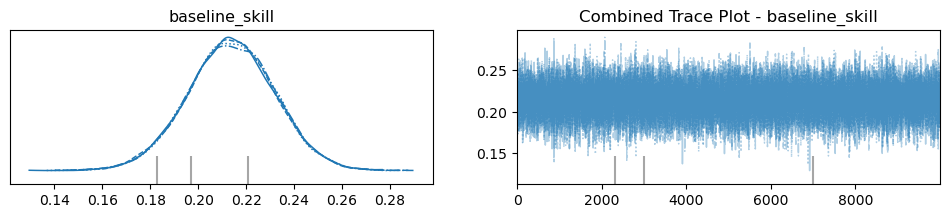

<Figure size 1000x400 with 0 Axes>

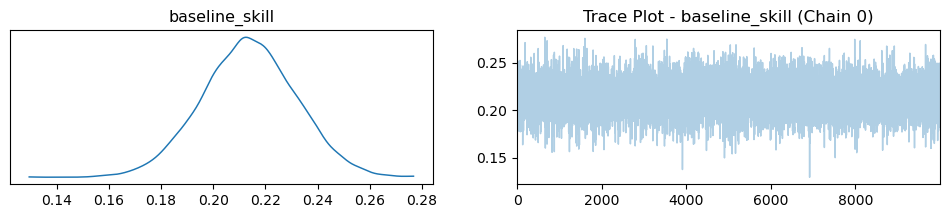

<Figure size 1000x400 with 0 Axes>

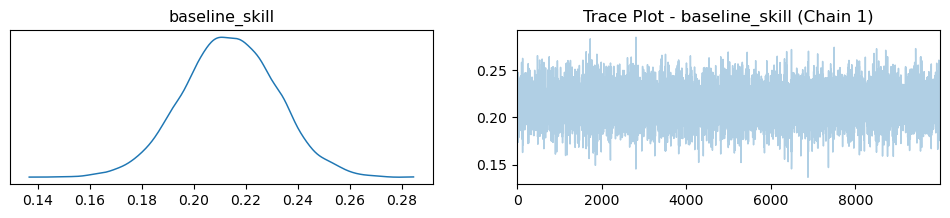

<Figure size 1000x400 with 0 Axes>

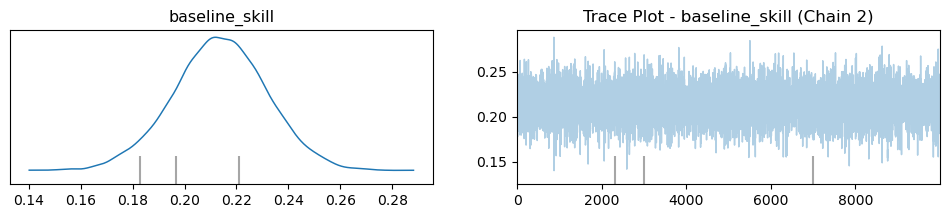

<Figure size 1000x400 with 0 Axes>

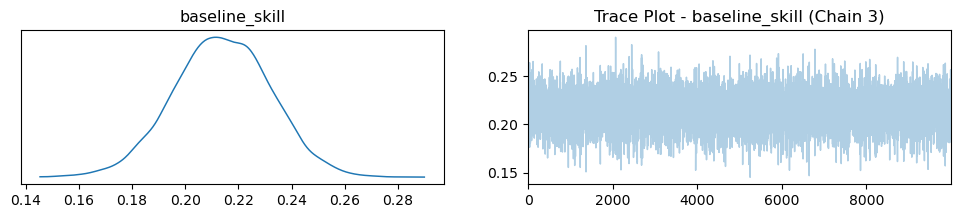

<Figure size 1000x400 with 0 Axes>

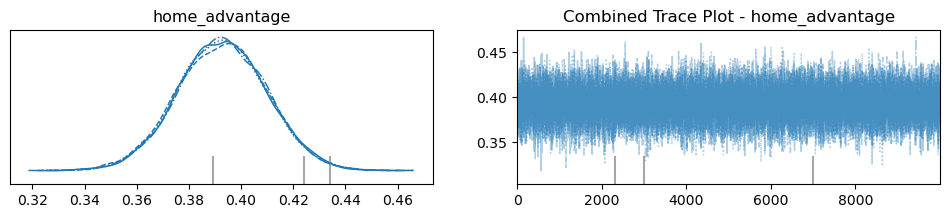

<Figure size 1000x400 with 0 Axes>

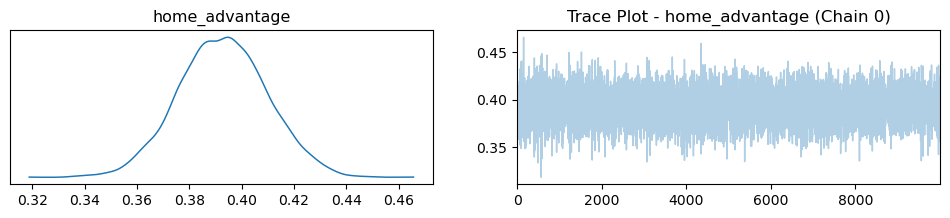

<Figure size 1000x400 with 0 Axes>

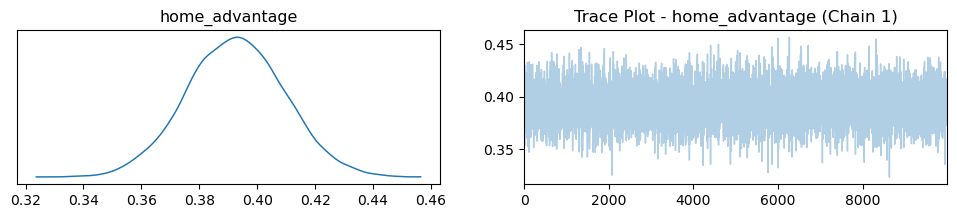

<Figure size 1000x400 with 0 Axes>

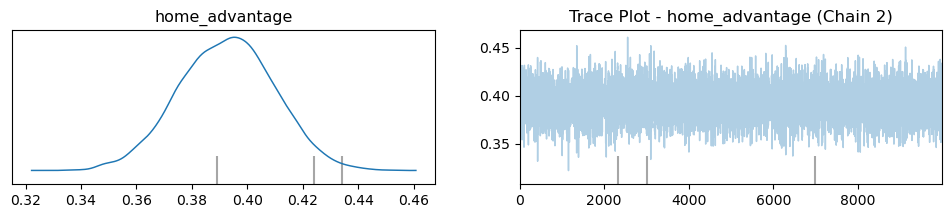

<Figure size 1000x400 with 0 Axes>

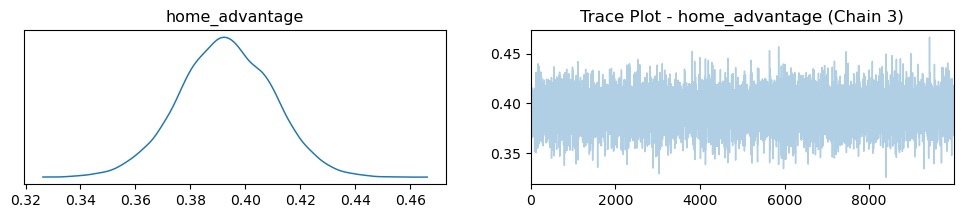

<Figure size 1000x400 with 0 Axes>

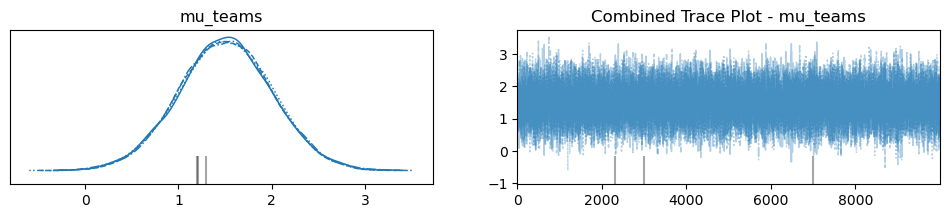

<Figure size 1000x400 with 0 Axes>

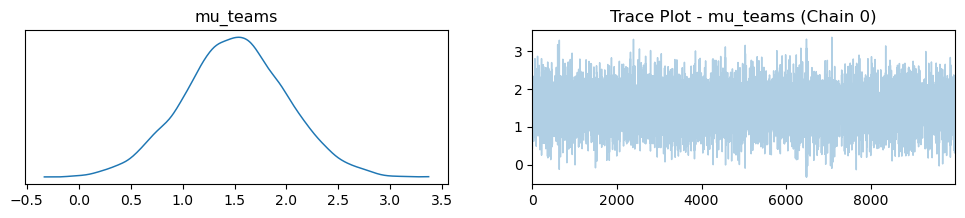

<Figure size 1000x400 with 0 Axes>

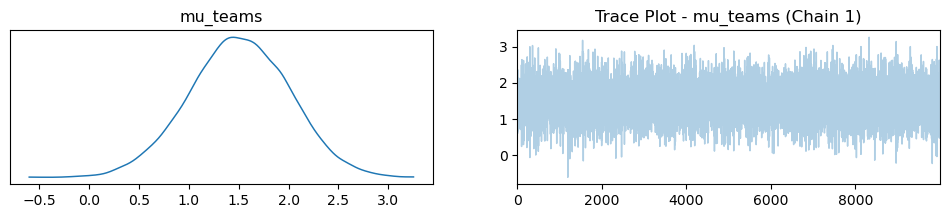

<Figure size 1000x400 with 0 Axes>

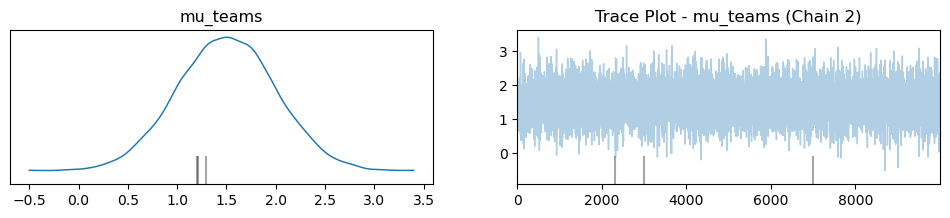

<Figure size 1000x400 with 0 Axes>

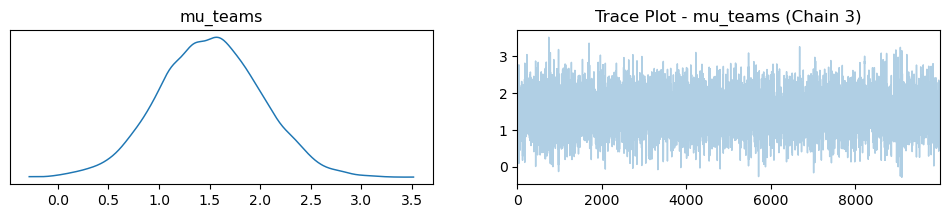

<Figure size 1000x400 with 0 Axes>

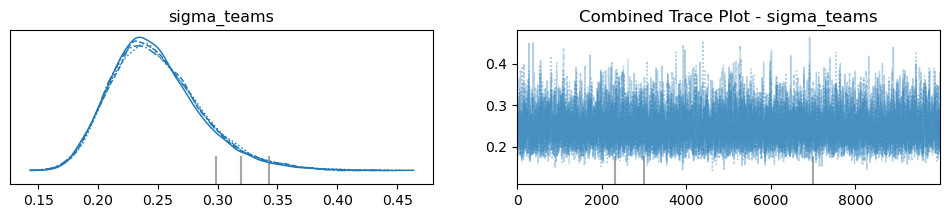

<Figure size 1000x400 with 0 Axes>

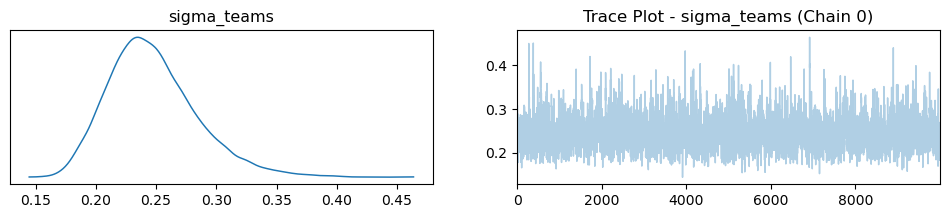

<Figure size 1000x400 with 0 Axes>

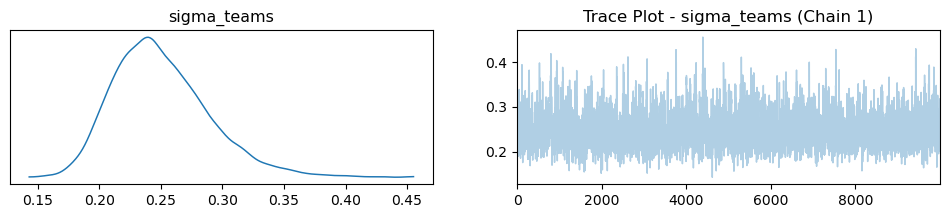

<Figure size 1000x400 with 0 Axes>

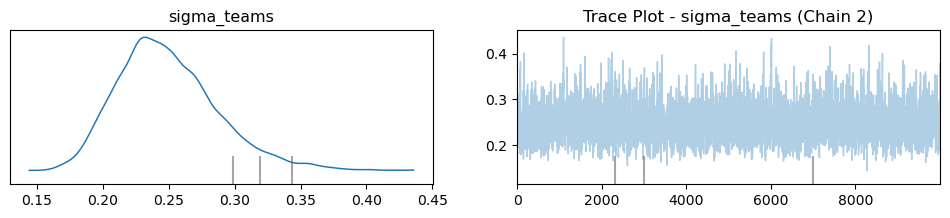

<Figure size 1000x400 with 0 Axes>

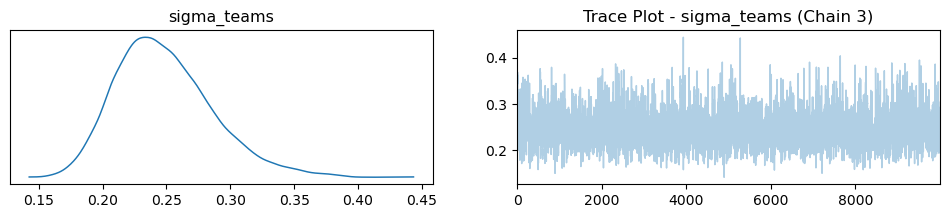

In [61]:
plot_trace_combined(trace_home_advantage_informative_non_centered, 'team_skills')
plot_trace_by_chain(trace_home_advantage_informative_non_centered, 'team_skills')
plot_trace_combined(trace_home_advantage_informative_non_centered, 'baseline_skill')
plot_trace_by_chain(trace_home_advantage_informative_non_centered, 'baseline_skill')
plot_trace_combined(trace_home_advantage_informative_non_centered, 'home_advantage')
plot_trace_by_chain(trace_home_advantage_informative_non_centered, 'home_advantage')
plot_trace_combined(trace_home_advantage_informative_non_centered, 'mu_teams')
plot_trace_by_chain(trace_home_advantage_informative_non_centered, 'mu_teams')
plot_trace_combined(trace_home_advantage_informative_non_centered, 'sigma_teams')
plot_trace_by_chain(trace_home_advantage_informative_non_centered, 'sigma_teams')

In [62]:
# Save trace plots for all parameters
save_arviz_plots(trace_home_advantage_informative_non_centered, parameters=['team_skills', 'baseline_skill', 'home_advantage', 'mu_teams', 'sigma_teams'])

#### 1.3 Summary Statistics of Model Parameters

In [47]:
summarize_model(trace_home_advantage_informative_non_centered, "team_skills")

,mean,sd,hdi_3%,hdi_97%,mcse_mean,mcse_sd,ess_bulk,ess_tail,r_hat
team_skills[0],1.696,0.504,0.776,2.664,0.003,0.002,39988.0,27489.0,1.0
team_skills[1],1.388,0.505,0.444,2.337,0.003,0.002,40218.0,27934.0,1.0
team_skills[2],1.409,0.504,0.445,2.337,0.003,0.002,39936.0,27645.0,1.0
team_skills[3],1.145,0.510,0.170,2.082,0.003,0.002,40203.0,27553.0,1.0
team_skills[4],1.572,0.504,0.622,2.513,0.003,0.002,39882.0,27568.0,1.0
team_skills[5],1.346,0.505,0.401,2.289,0.003,0.002,40036.0,27606.0,1.0
team_skills[6],1.500,0.504,0.565,2.455,0.003,0.002,39877.0,27527.0,1.0
team_skills[7],1.814,0.504,0.874,2.759,0.003,0.002,40019.0,27945.0,1.0
team_skills[8],1.980,0.503,1.024,2.911,0.003,0.002,39969.0,27538.0,1.0
team_skills[9],1.383,0.504,0.440,2.335,0.003,0.002,39932.0,27706.0,1.0


In [48]:
summarize_model(trace_home_advantage_informative_non_centered, "baseline_skill")

,mean,sd,hdi_3%,hdi_97%,mcse_mean,mcse_sd,ess_bulk,ess_tail,r_hat
baseline_skill,0.214,0.019,0.178,0.248,0.0,0.0,40385.0,27419.0,1.0


In [49]:
summarize_model(trace_home_advantage_informative_non_centered, "home_advantage")

,mean,sd,hdi_3%,hdi_97%,mcse_mean,mcse_sd,ess_bulk,ess_tail,r_hat
home_advantage,0.393,0.017,0.361,0.424,0.0,0.0,39542.0,27824.0,1.0


In [65]:
summarize_model(trace_home_advantage_informative_non_centered, "mu_teams")

,mean,sd,hdi_3%,hdi_97%,mcse_mean,mcse_sd,ess_bulk,ess_tail,r_hat
mu_teams,1.502,0.501,0.564,2.448,0.003,0.002,39687.0,26965.0,1.0


In [66]:
summarize_model(trace_home_advantage_informative_non_centered, "sigma_teams")

,mean,sd,hdi_3%,hdi_97%,mcse_mean,mcse_sd,ess_bulk,ess_tail,r_hat
sigma_teams,0.249,0.038,0.183,0.322,0.0,0.0,6608.0,8858.0,1.0


#### 1.4 Posterior Predictive Checks (PPC) and Other Metrics

Sampling: [away_goals_observed, home_goals_observed]


Output()

PPC plot saved as 'ppc_home_advantage_informative_non_centered.png'


<Figure size 1200x600 with 0 Axes>

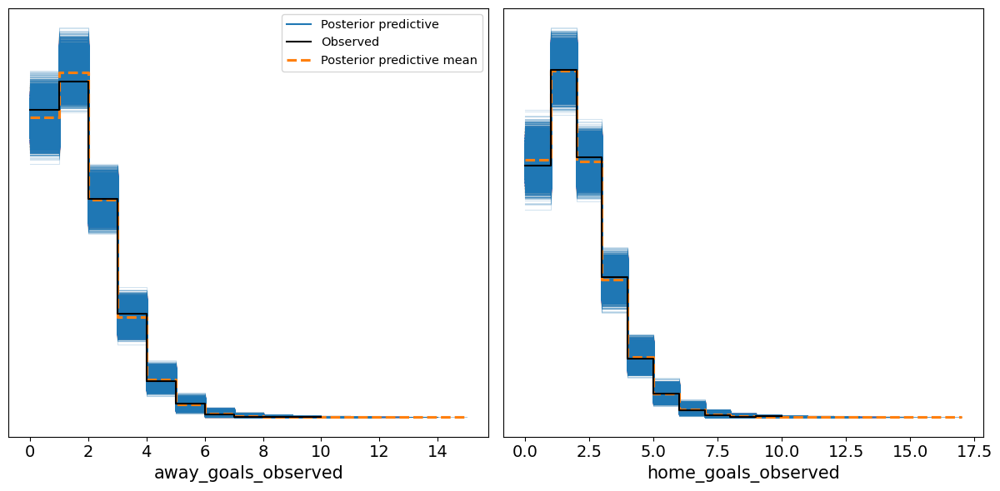

In [67]:
# save PPC plot 
ppc_home_advantage_informative_non_centered = save_ppc_plot(model_home_advantage_informative_non_centered, trace_home_advantage_informative_non_centered, 
                                                            "ppc_home_advantage_informative_non_centered.png")

#### 1.5 Model Comparison Metrics (LOO and WAIC)

In [68]:
metrics = calculate_model_comparison_metrics(trace_home_advantage_informative_non_centered)

home_goals_observed - LOO: 
 Computed from 40000 posterior samples and 2280 observations log-likelihood matrix.

             Estimate       SE
deviance_loo  6963.82    65.70
p_loo           14.21        -
------

Pareto k diagnostic values:
                         Count   Pct.
(-Inf, 0.5]   (good)     2280  100.0%
 (0.5, 0.7]   (ok)          0    0.0%
   (0.7, 1]   (bad)         0    0.0%
   (1, Inf)   (very bad)    0    0.0%

home_goals_observed - WAIC: 
 Computed from 40000 posterior samples and 2280 observations log-likelihood matrix.

              Estimate       SE
deviance_waic  6963.81    65.70
p_waic           14.21        -
away_goals_observed - LOO: 
 Computed from 40000 posterior samples and 2280 observations log-likelihood matrix.

             Estimate       SE
deviance_loo  6560.47    67.72
p_loo           13.22        -
------

Pareto k diagnostic values:
                         Count   Pct.
(-Inf, 0.5]   (good)     2280  100.0%
 (0.5, 0.7]   (ok)          0    0.0%
 

#### 1.6 Calculating error metrics (MAE and RMSE)

In [69]:
# Home teams goals
home_mae, home_rmse = calculate_errors(ppc_home_advantage_informative_non_centered, df_18_24, 'Home_Goals', 'home_goals_observed')

# Away Teams goals
away_mae, away_rmse = calculate_errors(ppc_home_advantage_informative_non_centered, df_18_24, 'Away_Goals', 'away_goals_observed')

Home_Goals - MAE: 0.9621728179824562, RMSE: 1.2282087998662137
Away_Goals - MAE: 0.9044211732456141, RMSE: 1.1522067472137263


#### 1.7 Roc- Auc

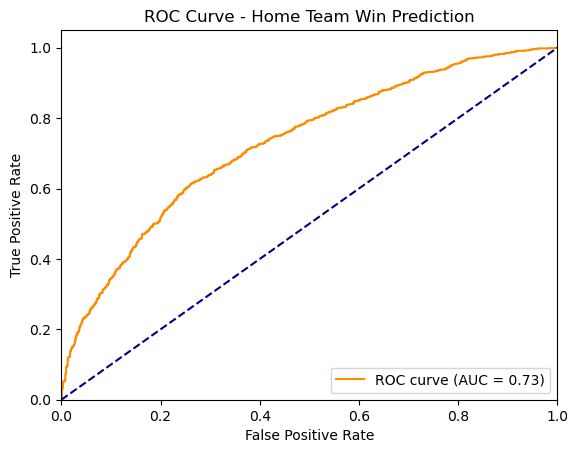

ROC AUC Value: 0.7286142981993977


In [70]:
roc_auc = calculate_and_plot_roc_auc_from_ppc(ppc_home_advantage_informative_non_centered, df_18_24)
print(f"ROC AUC Value: {roc_auc}")

#### 1.8 Energy Plot

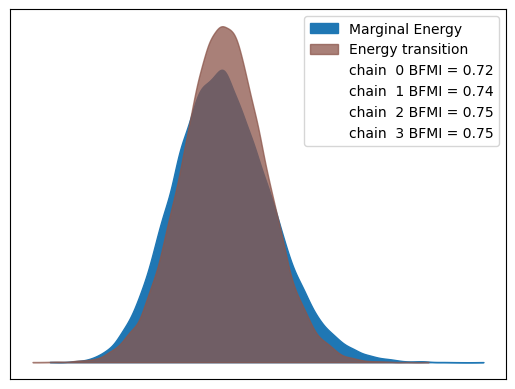

In [ ]:
plot_energy(trace_home_advantage_informative_non_centered)

#### 1.9 Shape of the main Parameters

In [ ]:
print_posterior_shapes(trace_home_advantage_informative_non_centered)

team_skills shape: (4, 10000, 28)
baseline_skill shape: (4, 10000)


Plot saved as 'home_advantage_informative_non_centered_team_skill.png'


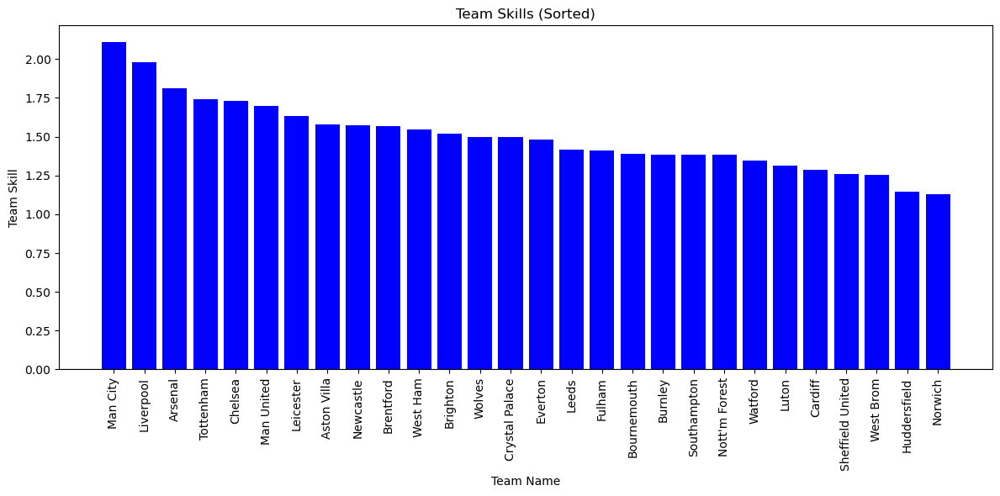

In [71]:
visualize_team_skills(df_18_24, trace_home_advantage_informative_non_centered, filename="home_advantage_informative_non_centered_team_skill.png")

In [73]:
gc.collect()

0

## Commparing Home Advantage Models

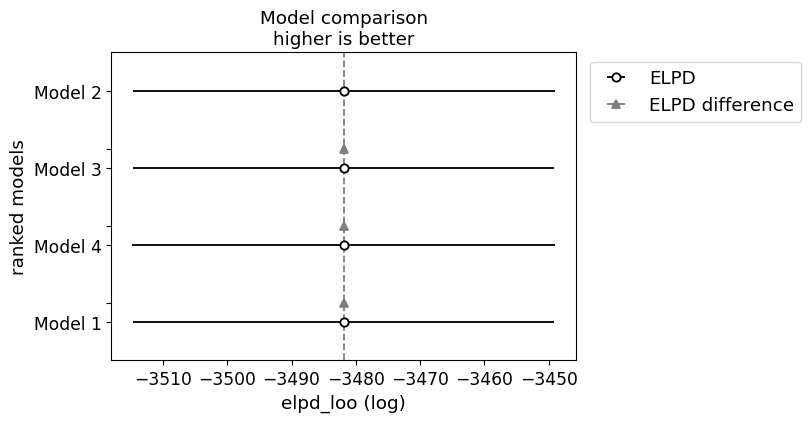

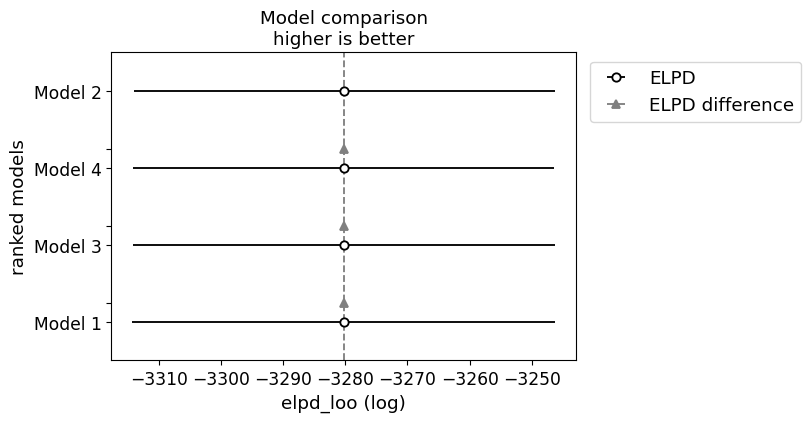

In [74]:
model_traces_for_home_adv_models = {
    "Model 1": trace_home_adv,
    "Model 2": trace_home_adv_informative,
    "Model 3": trace_home_adv_non_centered,
    "Model 4": trace_home_advantage_informative_non_centered,
     
}

# Home Goals
comparison_home_for_home_adv_models = az.compare(model_traces_for_home_adv_models, ic="loo", var_name="home_goals_observed")
az.plot_compare(comparison_home_for_home_adv_models)

plt.savefig("home_adv__models_comparison_home_goals.png", dpi=300, bbox_inches="tight") 
plt.show()  
plt.close() 
# Away Goals 
comparison_away_for_home_adv_models = az.compare(model_traces_for_home_adv_models, ic="loo", var_name="away_goals_observed")
az.plot_compare(comparison_away_for_home_adv_models)

plt.savefig("home_adv__models_comparison_away_goals.png", dpi=300, bbox_inches="tight")  
plt.show()
plt.close()  

In [29]:
comparison_home_for_home_adv_models

,rank,elpd_loo,p_loo,elpd_diff,weight,se,dse,warning,scale
Model 3,0,-3481.900763,14.212849,0.000000,1.000000e+00,32.742561,0.000000,False,log
Model 1,1,-3481.905767,14.223588,0.005005,8.604228e-16,32.735019,0.022189,False,log
Model 4,2,-3481.928671,14.245985,0.027909,6.210804e-16,32.842430,0.146846,False,log
Model 2,3,-3481.956024,14.243854,0.055261,0.000000e+00,32.847822,0.152413,False,log


In [30]:
comparison_away_for_home_adv_models

,rank,elpd_loo,p_loo,elpd_diff,weight,se,dse,warning,scale
Model 2,0,-3280.262521,13.274168,0.000000,1.0,33.866413,0.000000,False,log
Model 1,1,-3280.272649,13.272895,0.010129,0.0,33.968431,0.142035,False,log
Model 3,2,-3280.285242,13.289830,0.022721,0.0,33.973723,0.148437,False,log
Model 4,3,-3280.314833,13.284128,0.052312,0.0,33.862620,0.020941,False,log


## 10. Time Dependent Model 

In [75]:
def time_dependent_model(data, n_samples=10000, n_tune=2000):

    # Determine unique teams, unique seasons, and number of games
    unique_teams = np.unique(data[['Home_Team', 'Away_Team']].values)
    unique_seasons = np.unique(data['Season_ID'].values)
    n_teams = len(unique_teams)
    n_seasons = len(unique_seasons)
    n_games = data.shape[0]

    # Extract team IDs, season IDs, and goal values
    home_team_ids = data['Home_Team_ID'].values
    away_team_ids = data['Away_Team_ID'].values
    season_ids = data['Season_ID'].values - data['Season_ID'].min()
    home_goals = data['Home_Goals'].values
    away_goals = data['Away_Goals'].values
    
    with pm.Model() as model:
        
        # Hyperprior for team skills
        mu_teams = pm.Normal('mu_teams', mu=0, sigma=4)
        sigma_teams = pm.HalfNormal('sigma_teams', sigma=3)
        
        # Season-dependent team skills
        team_skills = pm.Normal('team_skills', mu=mu_teams, sigma=sigma_teams, shape=(n_seasons, n_teams))
        
        # Priors for home advantage 
        home_advantage = pm.Normal('home_advantage', mu=0, sigma=4)

        # Prior for baseline skill
        baseline_skill = pm.Normal('baseline_skill', mu=0, sigma=4)
        
        # Likelihood 
        lambda_home_goals = pm.Deterministic('lambda_home_goals', 
                                             pm.math.exp(home_advantage + 
                                                         team_skills[season_ids, home_team_ids] - 
                                                         team_skills[season_ids, away_team_ids]))
        
        lambda_away_goals = pm.Deterministic('lambda_away_goals', 
                                             pm.math.exp(baseline_skill + 
                                                         team_skills[season_ids, away_team_ids] - 
                                                         team_skills[season_ids, home_team_ids]))
        
        # Observed goal data
        home_goals_observed = pm.Poisson('home_goals_observed', mu=lambda_home_goals, observed=home_goals)
        away_goals_observed = pm.Poisson('away_goals_observed', mu=lambda_away_goals, observed=away_goals)
        
        # Sample the model with log likelihood data
        trace = pm.sample(n_samples, tune= n_tune, cores=4, return_inferencedata=True, idata_kwargs={'log_likelihood': True})
        
    return model, trace


### 1- Model Application for the 2018-2024 Period

In [28]:
model_time_dependent, trace_time_dependent = time_dependent_model(df_18_24)

Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [mu_teams, sigma_teams, team_skills, home_advantage, baseline_skill]


Output()

Sampling 4 chains for 2_000 tune and 10_000 draw iterations (8_000 + 40_000 draws total) took 123 seconds.
There were 19991 divergences after tuning. Increase `target_accept` or reparameterize.
The rhat statistic is larger than 1.01 for some parameters. This indicates problems during sampling. See https://arxiv.org/abs/1903.08008 for details
The effective sample size per chain is smaller than 100 for some parameters.  A higher number is needed for reliable rhat and ess computation. See https://arxiv.org/abs/1903.08008 for details


In [30]:
gc.collect()

0

#### 1.1 Summay of the parameters

In [ ]:
total_params = summarize_posterior(trace_time_dependent)

Posterior Variables: ['baseline_skill', 'home_advantage', 'lambda_away_goals', 'lambda_home_goals', 'mu_teams', 'sigma_teams', 'team_skills']
Total Parameters: 189280000


#### 1.2 Trace Plots

<Figure size 1000x400 with 0 Axes>

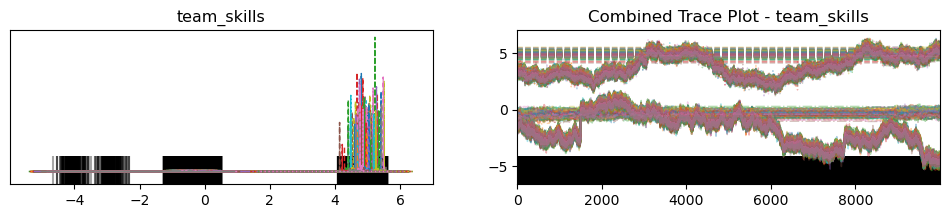

<Figure size 1000x400 with 0 Axes>

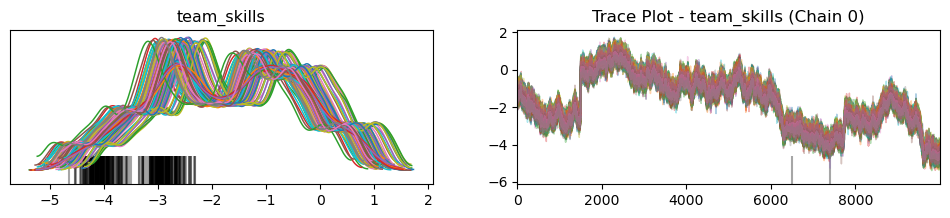

<Figure size 1000x400 with 0 Axes>

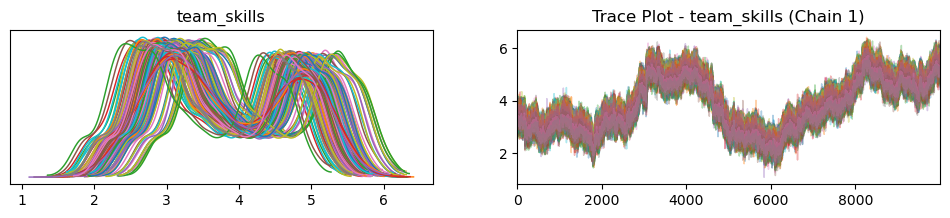

<Figure size 1000x400 with 0 Axes>

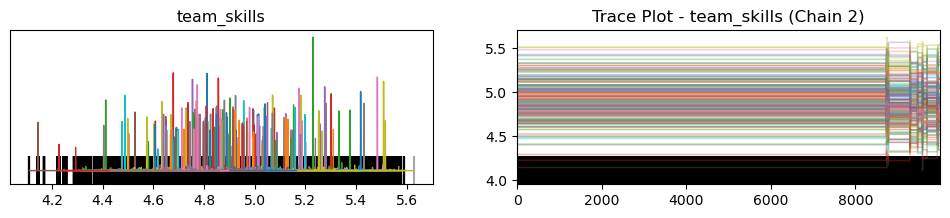

<Figure size 1000x400 with 0 Axes>

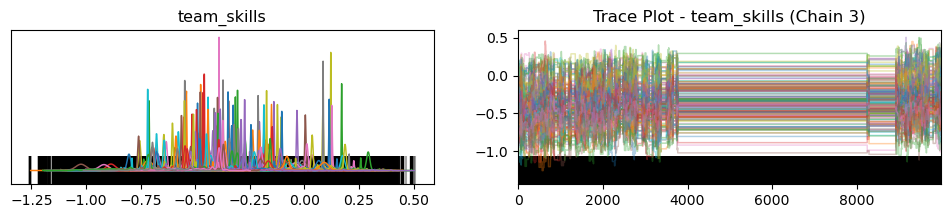

<Figure size 1000x400 with 0 Axes>

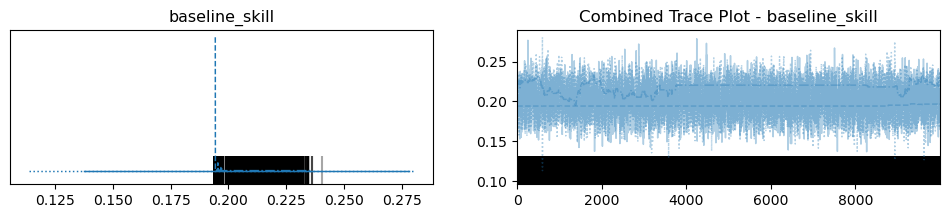

<Figure size 1000x400 with 0 Axes>

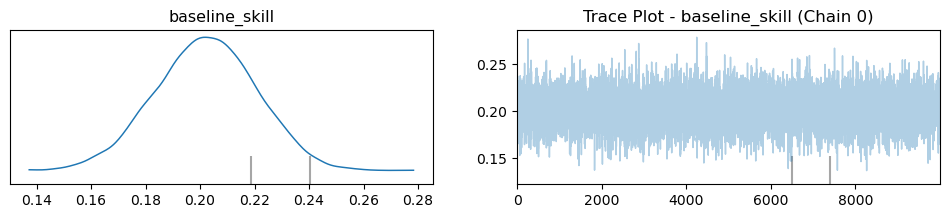

<Figure size 1000x400 with 0 Axes>

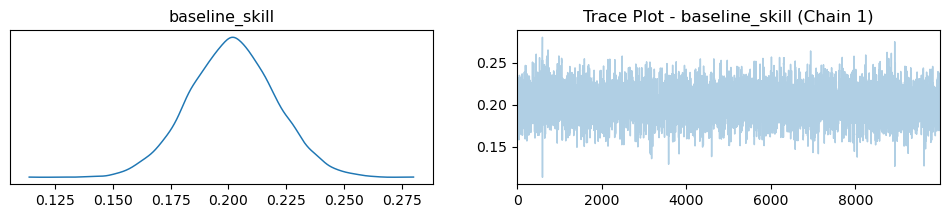

<Figure size 1000x400 with 0 Axes>

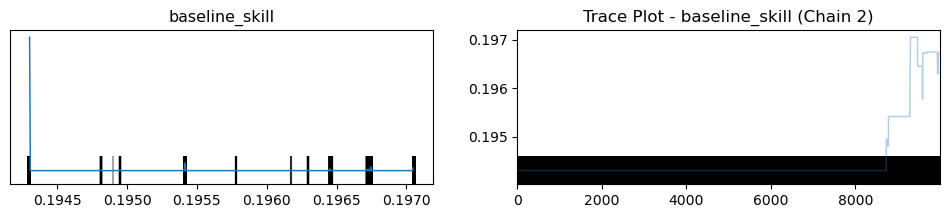

<Figure size 1000x400 with 0 Axes>

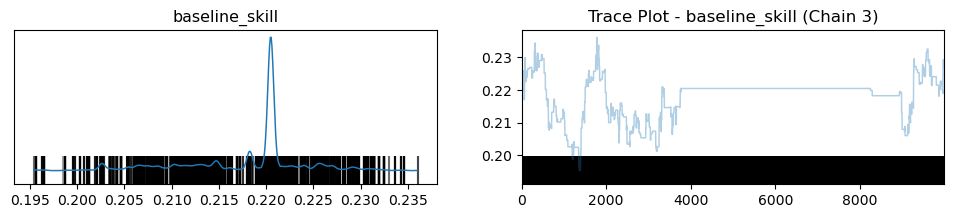

<Figure size 1000x400 with 0 Axes>

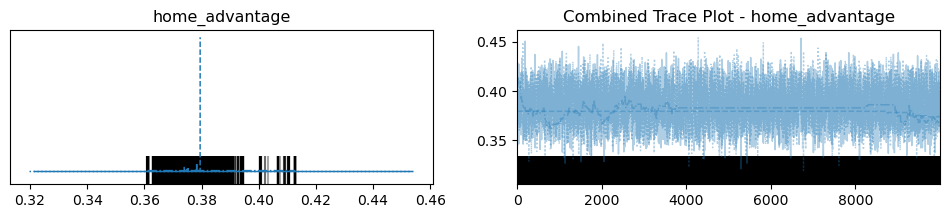

<Figure size 1000x400 with 0 Axes>

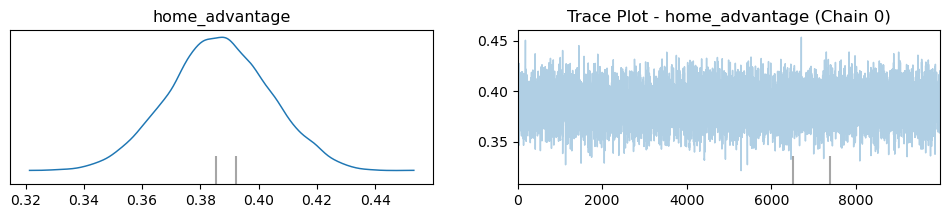

<Figure size 1000x400 with 0 Axes>

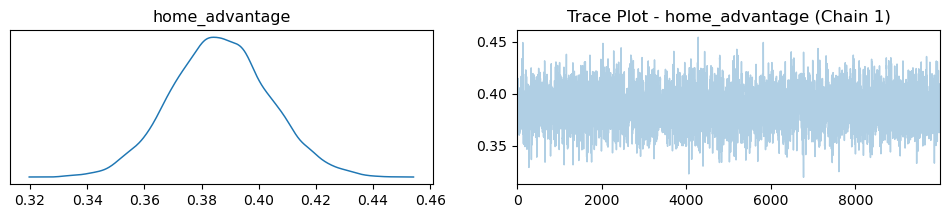

<Figure size 1000x400 with 0 Axes>

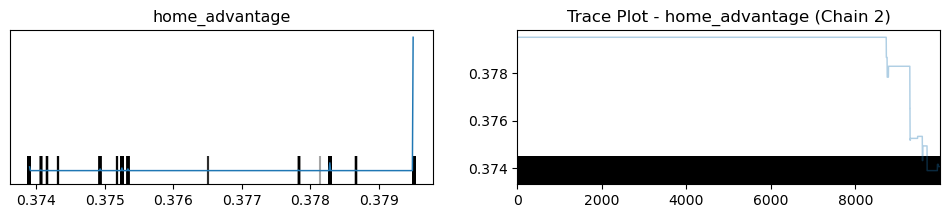

<Figure size 1000x400 with 0 Axes>

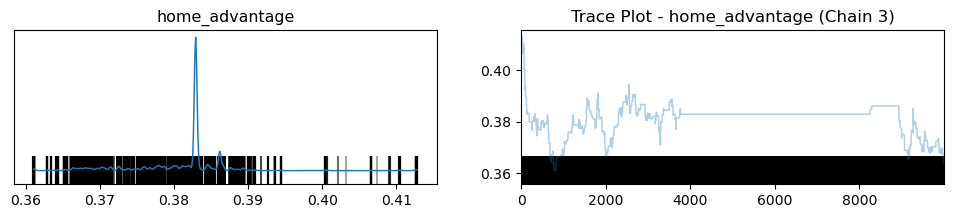

<Figure size 1000x400 with 0 Axes>

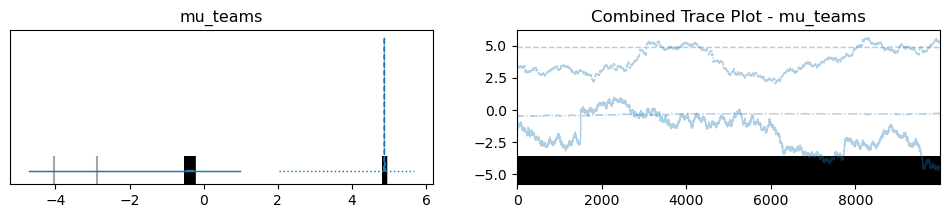

<Figure size 1000x400 with 0 Axes>

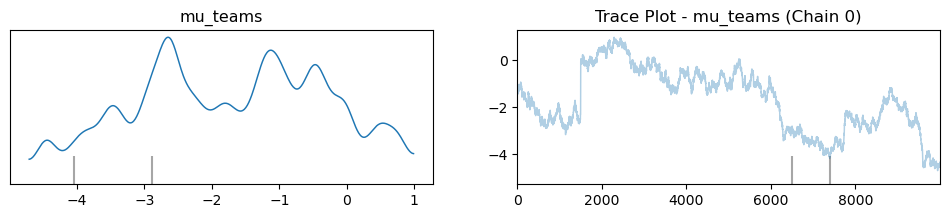

<Figure size 1000x400 with 0 Axes>

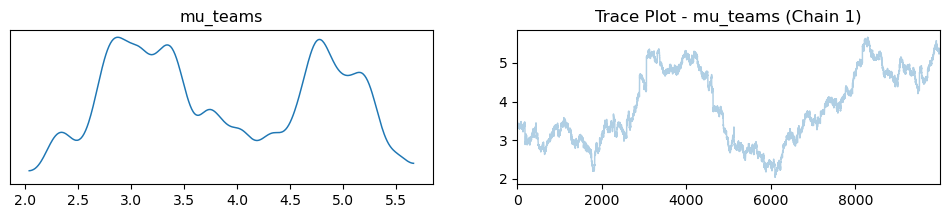

<Figure size 1000x400 with 0 Axes>

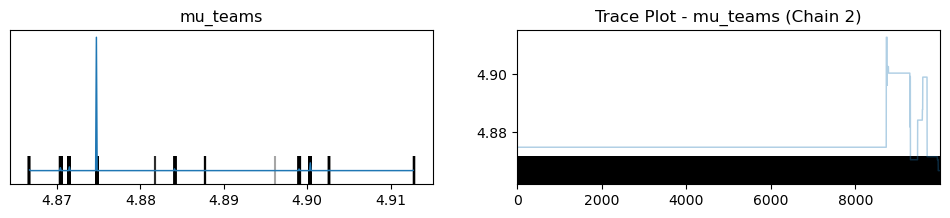

<Figure size 1000x400 with 0 Axes>

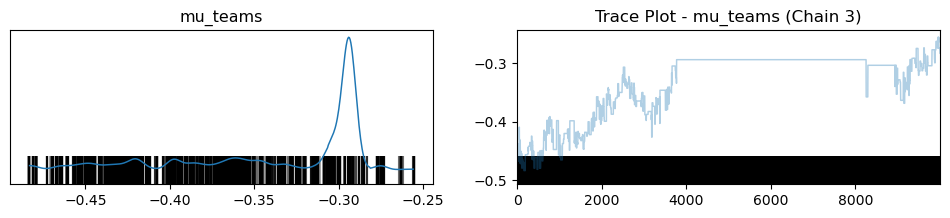

<Figure size 1000x400 with 0 Axes>

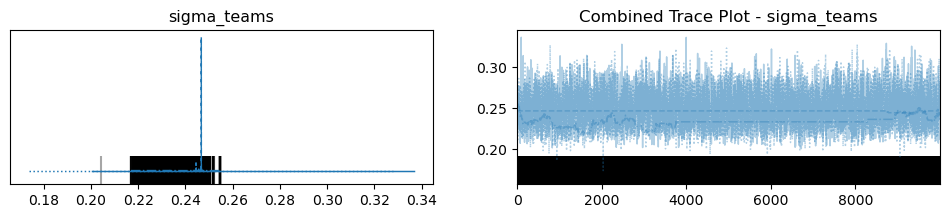

<Figure size 1000x400 with 0 Axes>

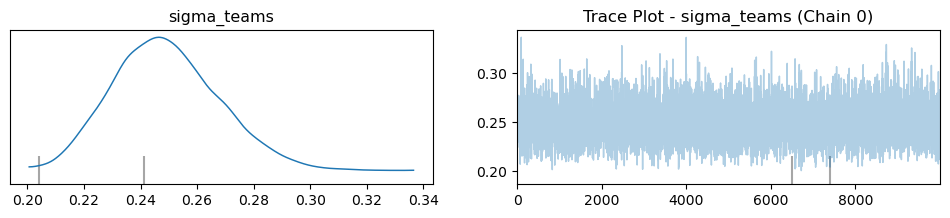

<Figure size 1000x400 with 0 Axes>

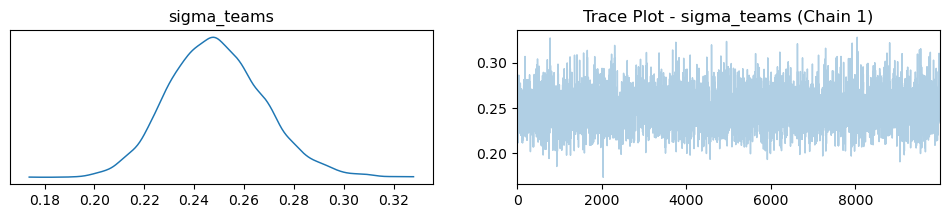

<Figure size 1000x400 with 0 Axes>

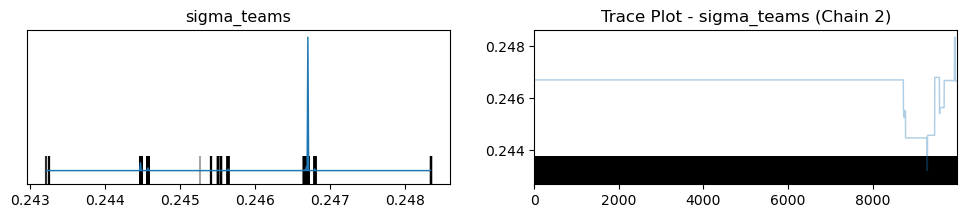

<Figure size 1000x400 with 0 Axes>

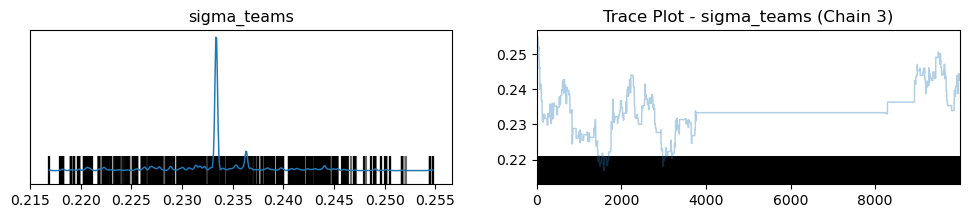

In [31]:
plot_trace_combined(trace_time_dependent, 'team_skills')
plot_trace_by_chain(trace_time_dependent, 'team_skills')
plot_trace_combined(trace_time_dependent, 'baseline_skill')
plot_trace_by_chain(trace_time_dependent, 'baseline_skill')
plot_trace_combined(trace_time_dependent, 'home_advantage')
plot_trace_by_chain(trace_time_dependent, 'home_advantage')
plot_trace_combined(trace_time_dependent, 'mu_teams')
plot_trace_by_chain(trace_time_dependent, 'mu_teams')
plot_trace_combined(trace_time_dependent, 'sigma_teams')
plot_trace_by_chain(trace_time_dependent, 'sigma_teams')

In [32]:
# save trace plots for all parameters
save_arviz_plots(trace_time_dependent, parameters=['team_skills', 'baseline_skill', 'home_advantage', 'mu_teams', 'sigma_teams'])

#### 1.3 Summary Statistics 

In [33]:
summarize_model(trace_time_dependent, "team_skills")

,mean,sd,hdi_3%,hdi_97%,mcse_mean,mcse_sd,ess_bulk,ess_tail,r_hat
"team_skills[0, 0]",1.783,2.945,-2.841,5.387,1.429,1.089,5.0,21.0,2.27
"team_skills[0, 1]",1.585,2.946,-3.042,5.197,1.430,1.090,5.0,21.0,2.26
"team_skills[0, 2]",1.351,2.948,-3.253,4.981,1.431,1.091,5.0,21.0,2.30
"team_skills[0, 3]",1.267,2.890,-3.306,4.930,1.401,1.068,5.0,20.0,2.19
"team_skills[0, 4]",1.645,2.935,-2.962,5.263,1.424,1.086,5.0,21.0,2.23
...,...,...,...,...,...,...,...,...,...
"team_skills[5, 23]",1.511,2.733,-3.040,5.345,1.317,1.003,5.0,20.0,2.07
"team_skills[5, 24]",1.724,2.909,-3.038,5.316,1.409,1.073,5.0,21.0,2.25
"team_skills[5, 25]",1.595,2.886,-2.977,5.267,1.399,1.066,5.0,21.0,2.16
"team_skills[5, 26]",1.543,2.889,-3.032,5.205,1.401,1.067,5.0,21.0,2.18


In [34]:
summarize_model(trace_time_dependent, "baseline_skill")

,mean,sd,hdi_3%,hdi_97%,mcse_mean,mcse_sd,ess_bulk,ess_tail,r_hat
baseline_skill,0.204,0.016,0.174,0.233,0.004,0.003,15.0,92.0,1.18


In [35]:
summarize_model(trace_time_dependent, "home_advantage")

,mean,sd,hdi_3%,hdi_97%,mcse_mean,mcse_sd,ess_bulk,ess_tail,r_hat
home_advantage,0.383,0.013,0.359,0.413,0.002,0.001,76.0,103.0,1.38


In [36]:
summarize_model(trace_time_dependent, "mu_teams")

,mean,sd,hdi_3%,hdi_97%,mcse_mean,mcse_sd,ess_bulk,ess_tail,r_hat
mu_teams,1.669,2.881,-2.893,5.302,1.397,1.065,5.0,20.0,2.18


In [ ]:
summarize_model(trace_time_dependent, "sigma_teams")

,mean,sd,hdi_3%,hdi_97%,mcse_mean,mcse_sd,ess_bulk,ess_tail,r_hat
sigma_teams,0.251,0.019,0.216,0.285,0.002,0.001,141.0,858.0,1.02


#### 1.4 Posterior Predictive Check (PPC)

Sampling: [away_goals_observed, home_goals_observed]


Output()

PPC plot saved as 'ppc_time_dependent.png'


<Figure size 1200x600 with 0 Axes>

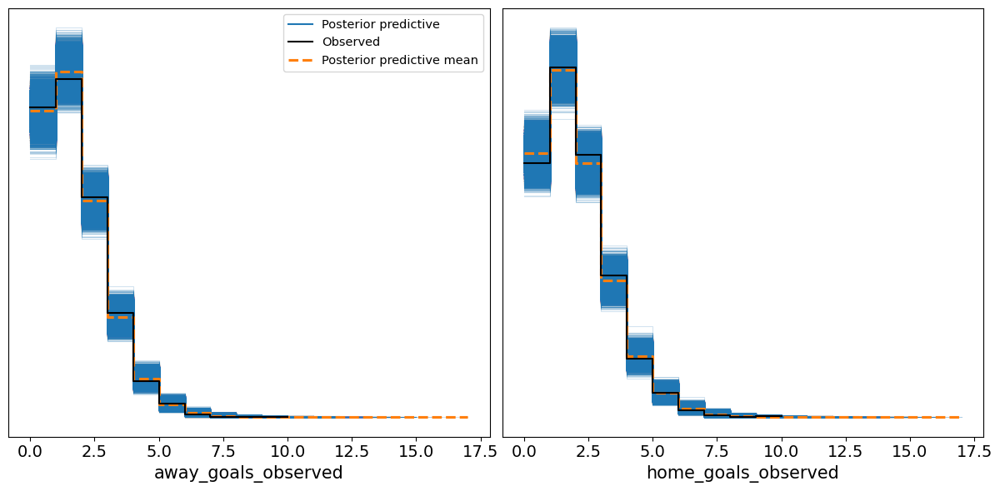

In [37]:
#save PPC plot
ppc_time_dependent = save_ppc_plot(model_time_dependent, trace_time_dependent, "ppc_time_dependent.png")

#### 1.5 Model Comparison Metrics (LOO and WAIC)

In [38]:
# Home teams goals
home_mae, home_rmse = calculate_errors(ppc_time_dependent, df_18_24, 'Home_Goals', 'home_goals_observed')

# Away Teams goals
away_mae, away_rmse = calculate_errors(ppc_time_dependent, df_18_24, 'Away_Goals', 'away_goals_observed')

Home_Goals - MAE: 0.9410274671052632, RMSE: 1.1995827690290364
Away_Goals - MAE: 0.8854524013157895, RMSE: 1.1280037901614937


#### 1.7 Roc- Aucb

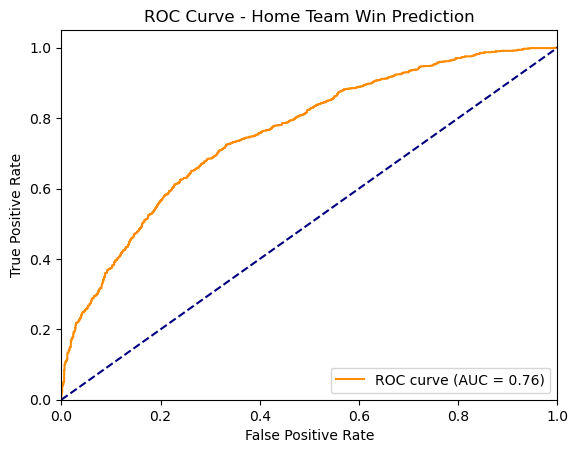

ROC AUC Value: 0.7565856186851097


In [39]:
roc_auc = calculate_and_plot_roc_auc_from_ppc(ppc_time_dependent, df_18_24)
print(f"ROC AUC Value: {roc_auc}")

#### 1.8 Energy Plot

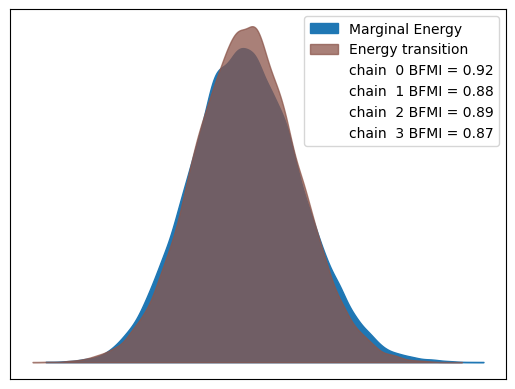

In [ ]:
plot_energy(trace_time_dependent)

#### 1.9 Shape of the main Parameters

In [ ]:
print_posterior_shapes(trace_time_dependent)

team_skills shape: (4, 10000, 6, 28)
baseline_skill shape: (4, 10000)


#### 1.10 Visualize Team Skills

In [94]:
def visualize_team_skills_time_dependent(df, trace, filename="trace_time_dependent.png"):
    """
    Visualizes team skills for a time-dependent model, averaging over all seasons.
    
    Parameters:
    - df: Pandas DataFrame containing the match data with team names and IDs.
    - trace: ArviZ trace object containing the team skills.
    - filename: (str) Name of the file where the plot will be saved. Default is 'trace_time_dependent.png'.
    
    Returns:
    - None (displays and saves a sorted bar plot of average team skills across seasons).
    """
    # Extract the mean of team skills for each season and team from the trace
    team_skills_array = trace.posterior['team_skills'].mean(dim=("chain", "draw")).values
    
    # Compute the number of unique teams
    n_teams = team_skills_array.shape[1]  # Second dimension corresponds to the number of teams
    
    # Compute the average skill for each team across all seasons
    average_team_skills = team_skills_array.mean(axis=0)  # Average across seasons
    
    # Create a mapping from team IDs to team names using the input DataFrame
    unique_team_ids = np.unique(df['Home_Team_ID'])
    team_id_to_name = dict(zip(unique_team_ids, df['Home_Team'].unique()))
    
    # Map team IDs to names and extract the corresponding average skill values
    team_names = [team_id_to_name[team_id] for team_id in range(n_teams)]
    team_skills = average_team_skills
    
    # Sort teams by their average skills
    sorted_indices = np.argsort(team_skills)[::-1]  # Sort descending
    sorted_team_names = np.array(team_names)[sorted_indices]
    sorted_team_skills = team_skills[sorted_indices]
    
    # Color coding for positive and negative skills
    colors = ['red' if skill < 0 else 'blue' for skill in sorted_team_skills]
    
    # Create the bar plot
    plt.figure(figsize=(12, 6))
    plt.bar(sorted_team_names, sorted_team_skills, color=colors)
    plt.xlabel('Team Name')
    plt.ylabel('Average Team Skill')
    plt.title('Average Team Skills Across Seasons (Sorted)')
    plt.xticks(rotation=90)
    plt.axhline(0, color='black', linewidth=0.8)  # Add a horizontal line at y=0
    
    # Save the plot to the current working directory with the specified filename
    plt.savefig(filename, bbox_inches='tight', dpi=300)
    print(f"Plot saved as {filename} in the current working directory.")
    
    # Show the plot
    plt.show()


Plot saved as time_dependent_team_skill.png in the current working directory.


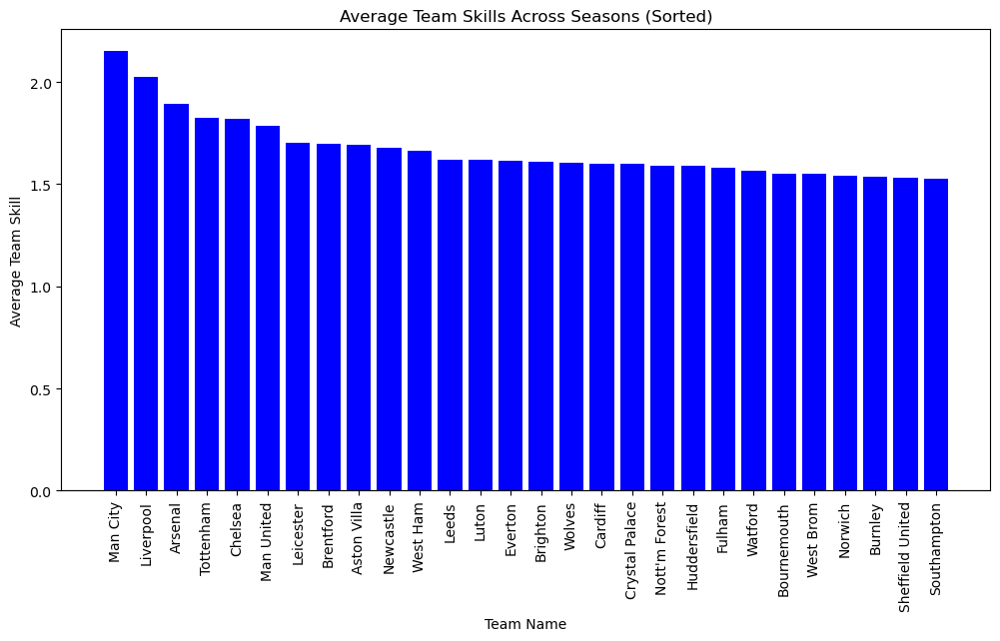

In [95]:
visualize_team_skills_time_dependent(df_18_24, trace_time_dependent, filename="time_dependent_team_skill.png")

In [107]:
def visualize_team_skills_seasonal(df, trace, num_seasons=6, filename_prefix="season_skills"):
    """
    Visualizes team skills for each season, highlighting positive and negative skills with different colors.
    
    Parameters:
    - df: Pandas DataFrame containing the match data with team names and IDs.
    - trace: ArviZ trace object containing the team skills.
    - num_seasons: Number of seasons to visualize (default is 6).
    - filename_prefix: (str) Prefix for the filenames where plots will be saved. Default is 'season_skills'.
    
    Returns:
    - None (displays and saves bar plots for each season).
    """
    # Extract the mean of team skills from the trace for each season and team
    team_skills_array = trace.posterior['team_skills'].mean(dim=("chain", "draw")).values

    # Compute the number of unique teams
    n_teams = team_skills_array.shape[1]  # Second dimension corresponds to the number of teams
    
    # Create a mapping from team IDs to team names using the input DataFrame
    unique_team_ids = np.unique(df['Home_Team_ID'])
    team_id_to_name = dict(zip(unique_team_ids, df['Home_Team'].unique()))

    # Iterate through each season and create a bar plot
    for season in range(min(num_seasons, team_skills_array.shape[0])):
        # Extract skills for the current season
        team_skills = team_skills_array[season]
        
        # Map team IDs to names and extract corresponding skill values
        team_names = [team_id_to_name[team_id] for team_id in range(n_teams)]
        
        # Sort teams by their skills
        sorted_indices = np.argsort(team_skills)[::-1]  # Sort descending
        sorted_team_names = np.array(team_names)[sorted_indices]
        sorted_team_skills = team_skills[sorted_indices]
        
        # Color coding for positive and negative skills
        colors = ['blue' if skill >= 0 else 'red' for skill in sorted_team_skills]
        
        # Create the bar plot
        plt.figure(figsize=(12, 6))
        plt.bar(sorted_team_names, sorted_team_skills, color=colors)
        plt.xlabel('Team Name')
        plt.ylabel(f'Team Skill for Season {season + 1}')
        plt.title(f'Team Skills for Season {season + 1} (Sorted)')
        plt.xticks(rotation=90)
        plt.axhline(0, color='black', linewidth=0.8)  # Add a horizontal line at y=0
        
        # Define the filename for the current season
        filename = f"{filename_prefix}_season_{season + 1}.png"
        
        # Save the plot to the current working directory
        plt.savefig(filename, bbox_inches='tight', dpi=300)
        print(f"Plot for Season {season + 1} saved as {filename} in the current working directory.")
        
        # Show the plot
        plt.show()


Plot for Season 1 saved as time_dependent_season_skills_season_1.png in the current working directory.


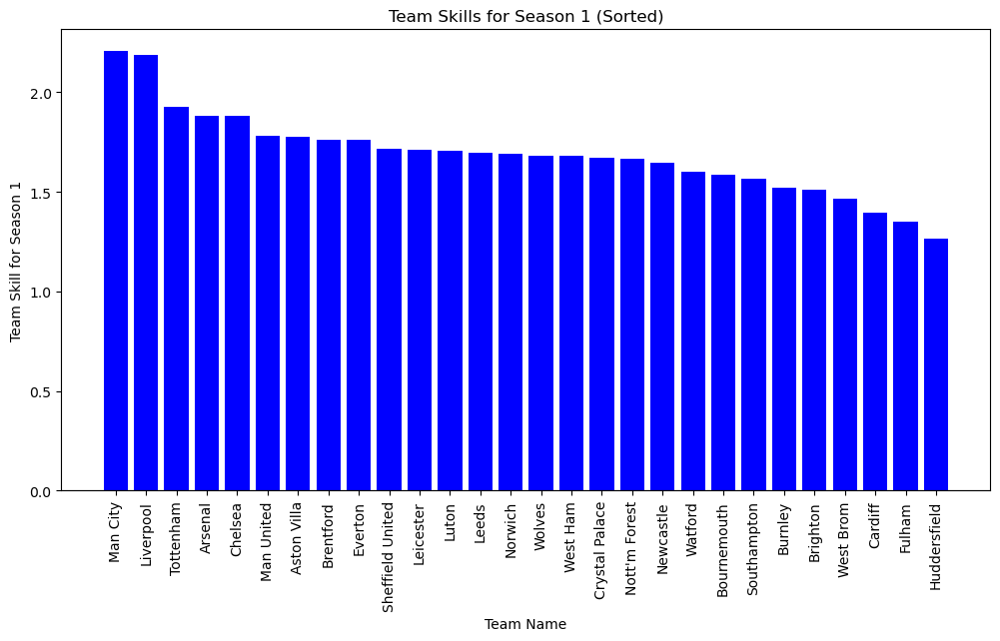

Plot for Season 2 saved as time_dependent_season_skills_season_2.png in the current working directory.


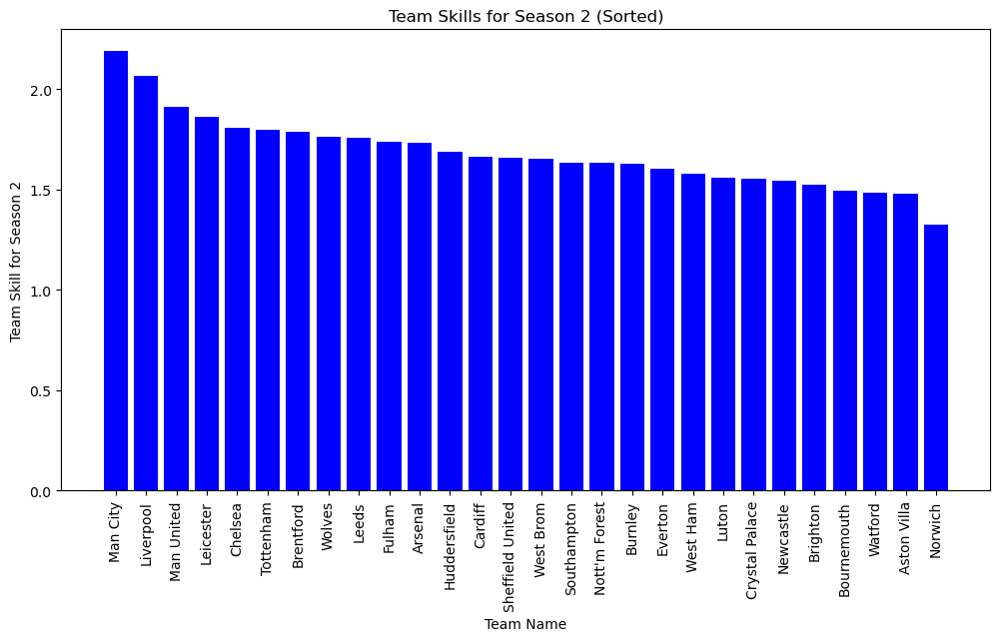

Plot for Season 3 saved as time_dependent_season_skills_season_3.png in the current working directory.


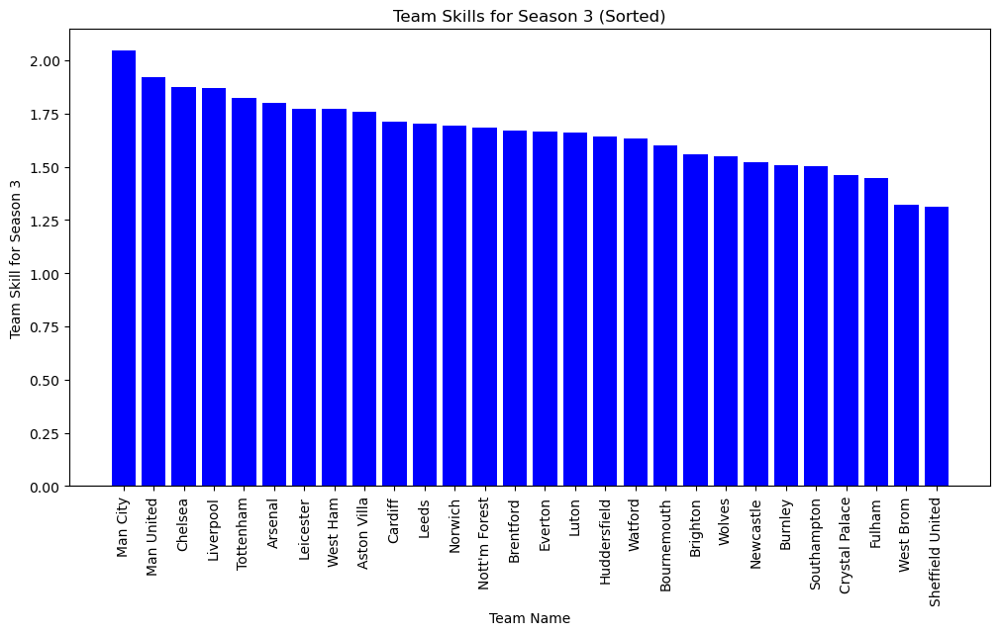

Plot for Season 4 saved as time_dependent_season_skills_season_4.png in the current working directory.


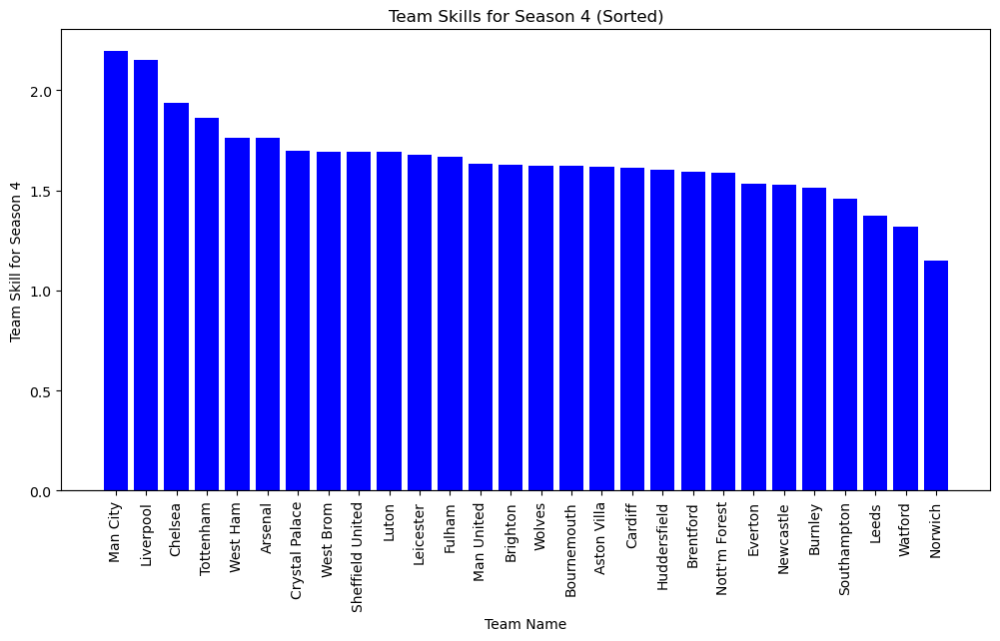

Plot for Season 5 saved as time_dependent_season_skills_season_5.png in the current working directory.


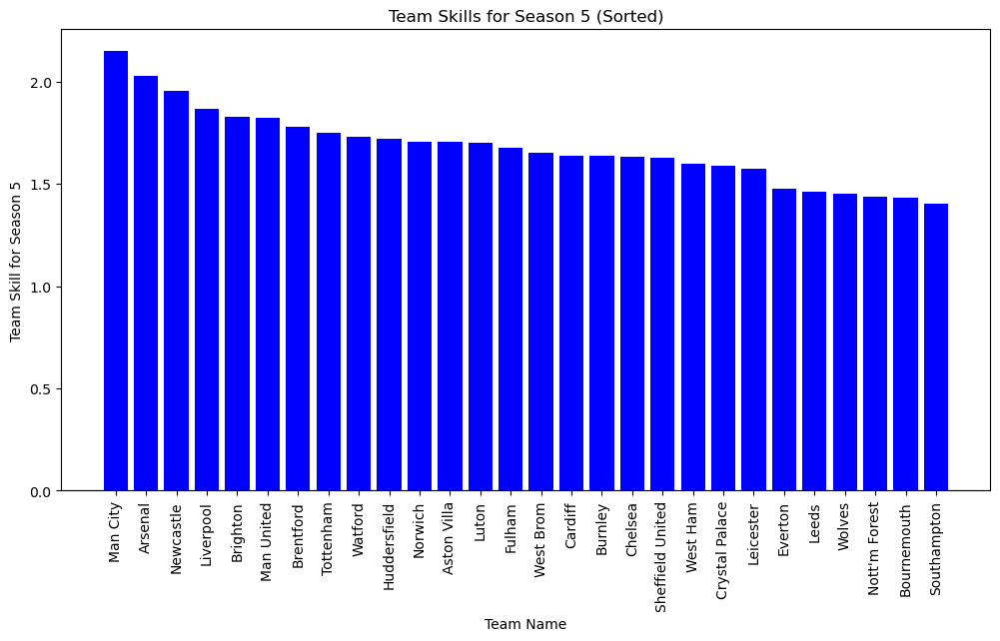

Plot for Season 6 saved as time_dependent_season_skills_season_6.png in the current working directory.


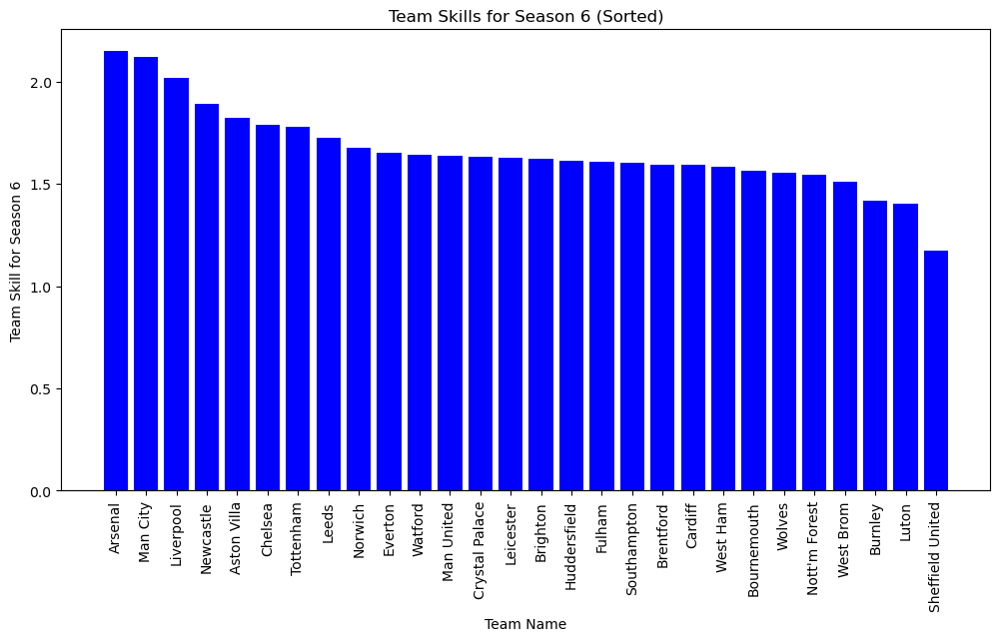

In [110]:
# Visualize team skills for each season
visualize_team_skills_seasonal(df_18_24, trace_time_dependent, filename_prefix="time_dependent_season_skills")

## 11. Time Dependent Model with informative priors

In [63]:
def informative_time_dependent_model(data, n_samples=10000, n_tune=2000):

    # Determine unique teams, unique seasons, and number of games
    unique_teams = np.unique(data[['Home_Team', 'Away_Team']].values)
    unique_seasons = np.unique(data['Season_ID'].values)
    n_teams = len(unique_teams)
    n_seasons = len(unique_seasons)
    n_games = data.shape[0]

    # Extract team IDs, season IDs, and goal values
    home_team_ids = data['Home_Team_ID'].values
    away_team_ids = data['Away_Team_ID'].values
    season_ids = data['Season_ID'].values - data['Season_ID'].min()
    home_goals = data['Home_Goals'].values
    away_goals = data['Away_Goals'].values
    
    with pm.Model() as model:
        
        # Informative hyperprior for team skills
        mu_teams = pm.Normal('mu_teams', mu=1.5, sigma=0.5) 
        sigma_teams = pm.HalfNormal('sigma_teams', sigma=1)  
        
        # Season-dependent team skills
        team_skills = pm.Normal('team_skills', mu=mu_teams, sigma=sigma_teams, shape=(n_seasons, n_teams))
        
        # Informative prior for home advantage
        home_advantage = pm.Normal('home_advantage', mu=0.3, sigma=0.1)  
        
        # Informative prior for baseline skill
        baseline_skill = pm.Normal('baseline_skill', mu=0.3, sigma=0.1)  
        
        # Likelihood
        lambda_home_goals = pm.Deterministic(
            'lambda_home_goals', 
            pm.math.exp(home_advantage + 
                        team_skills[season_ids, home_team_ids] - 
                        team_skills[season_ids, away_team_ids])
        )
        
        lambda_away_goals = pm.Deterministic(
            'lambda_away_goals', 
            pm.math.exp(baseline_skill + 
                        team_skills[season_ids, away_team_ids] - 
                        team_skills[season_ids, home_team_ids])
        )
        
        # Observed goal data
        home_goals_observed = pm.Poisson('home_goals_observed', mu=lambda_home_goals, observed=home_goals)
        away_goals_observed = pm.Poisson('away_goals_observed', mu=lambda_away_goals, observed=away_goals)
        
        # Sample the model with log likelihood data
        trace = pm.sample(n_samples, tune=n_tune, cores=4, return_inferencedata=True, idata_kwargs={'log_likelihood': True})
        
    return model, trace


#### 1- Model Application for the 2018-2024 Period

In [64]:
# Getting Model and Trace
model_informative_time_dependent_model, trace_informative_time_dependent_model = informative_time_dependent_model(df_18_24)

Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [mu_teams, sigma_teams, team_skills, home_advantage, baseline_skill]


Output()

Sampling 4 chains for 2_000 tune and 10_000 draw iterations (8_000 + 40_000 draws total) took 284 seconds.
There were 2544 divergences after tuning. Increase `target_accept` or reparameterize.
The rhat statistic is larger than 1.01 for some parameters. This indicates problems during sampling. See https://arxiv.org/abs/1903.08008 for details
The effective sample size per chain is smaller than 100 for some parameters.  A higher number is needed for reliable rhat and ess computation. See https://arxiv.org/abs/1903.08008 for details


#### 1.1 Summay of the parameters

In [ ]:
total_params = summarize_posterior(trace_informative_time_dependent_model)

Posterior Variables: ['baseline_skill', 'home_advantage', 'lambda_away_goals', 'lambda_home_goals', 'mu_teams', 'sigma_teams', 'team_skills']
Total Parameters: 189280000


#### 1.2 Trace Plots

<Figure size 1000x400 with 0 Axes>

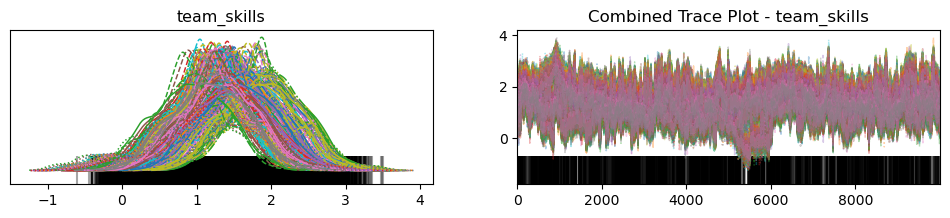

<Figure size 1000x400 with 0 Axes>

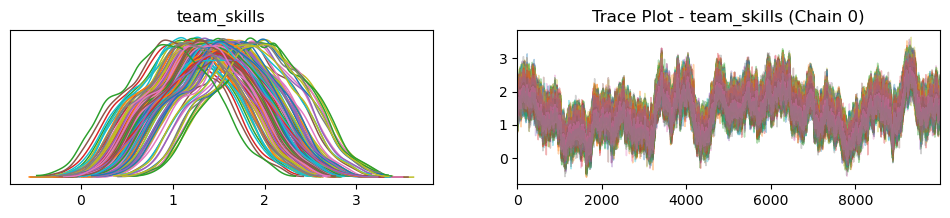

<Figure size 1000x400 with 0 Axes>

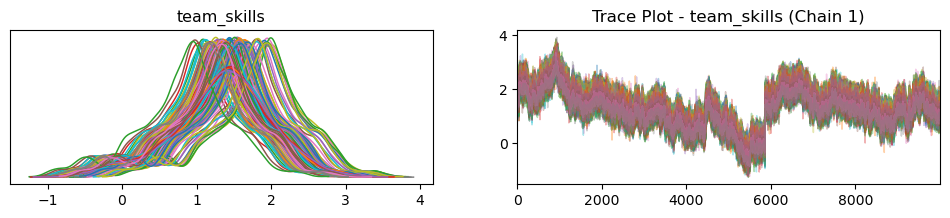

<Figure size 1000x400 with 0 Axes>

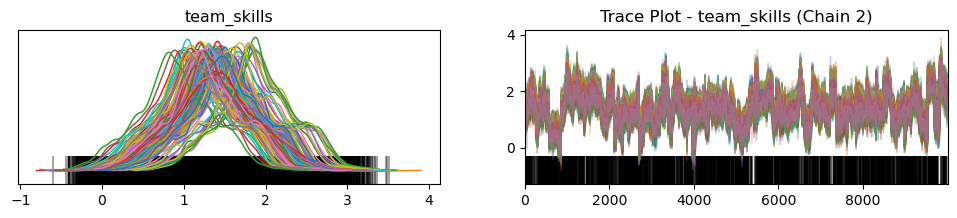

<Figure size 1000x400 with 0 Axes>

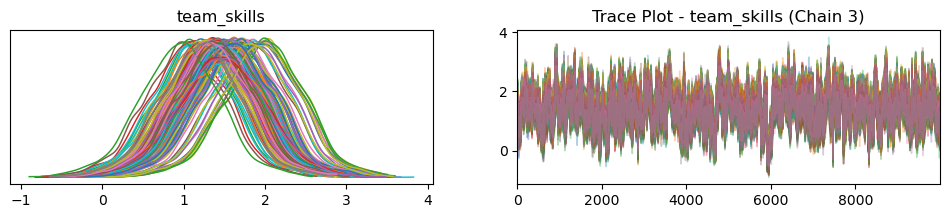

<Figure size 1000x400 with 0 Axes>

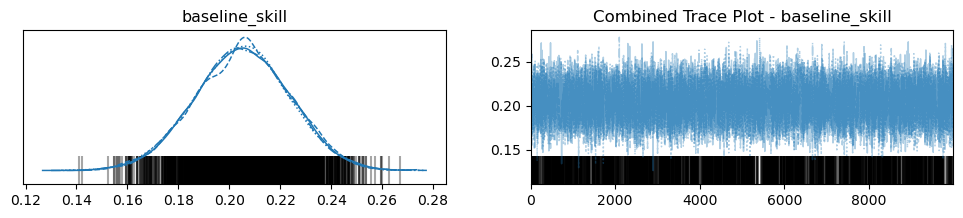

<Figure size 1000x400 with 0 Axes>

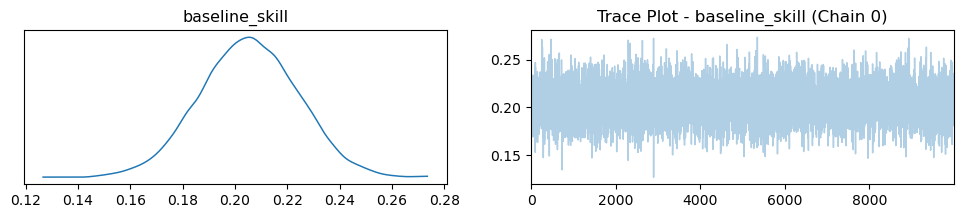

<Figure size 1000x400 with 0 Axes>

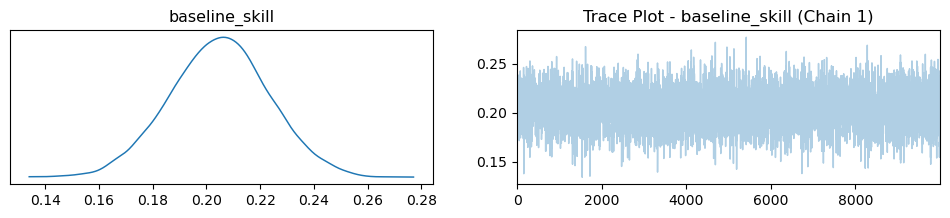

<Figure size 1000x400 with 0 Axes>

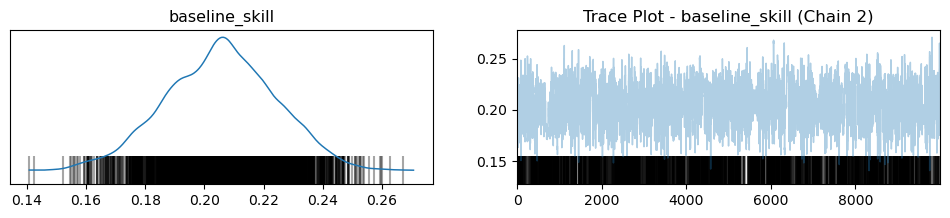

<Figure size 1000x400 with 0 Axes>

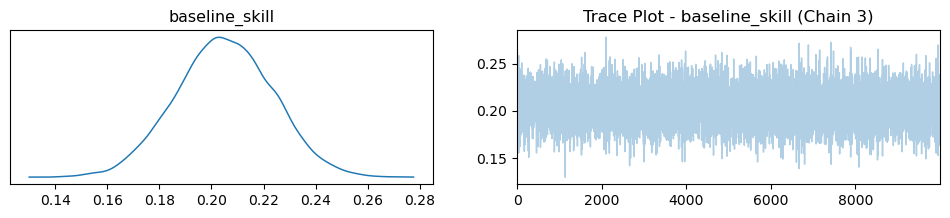

<Figure size 1000x400 with 0 Axes>

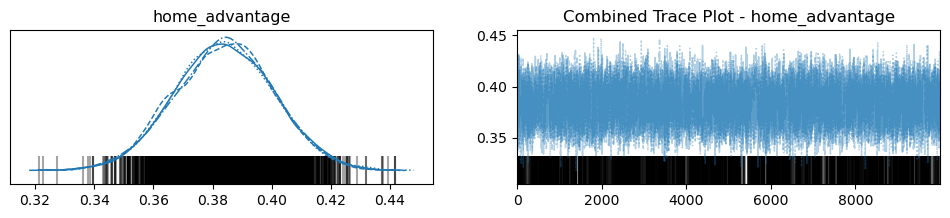

<Figure size 1000x400 with 0 Axes>

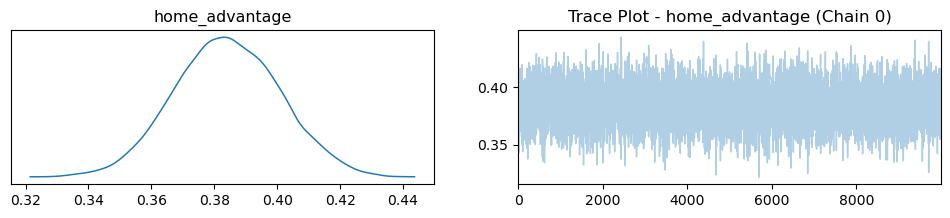

<Figure size 1000x400 with 0 Axes>

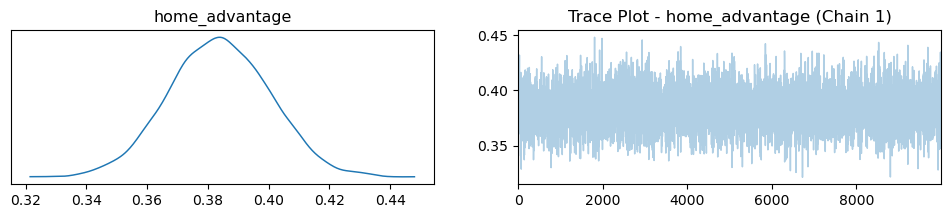

<Figure size 1000x400 with 0 Axes>

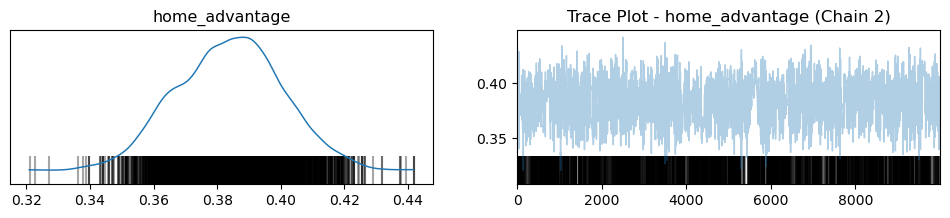

<Figure size 1000x400 with 0 Axes>

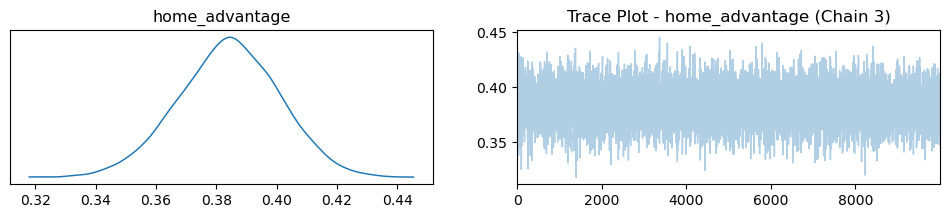

<Figure size 1000x400 with 0 Axes>

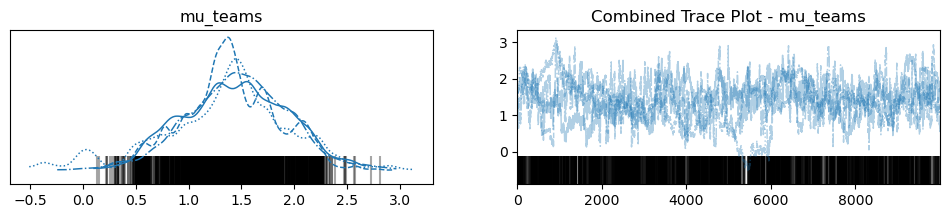

<Figure size 1000x400 with 0 Axes>

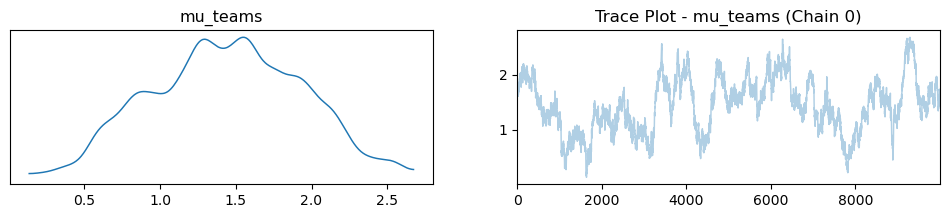

<Figure size 1000x400 with 0 Axes>

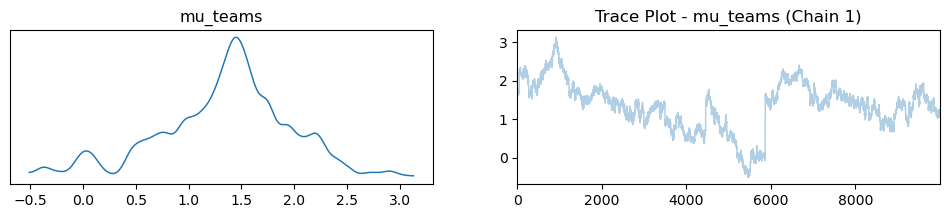

<Figure size 1000x400 with 0 Axes>

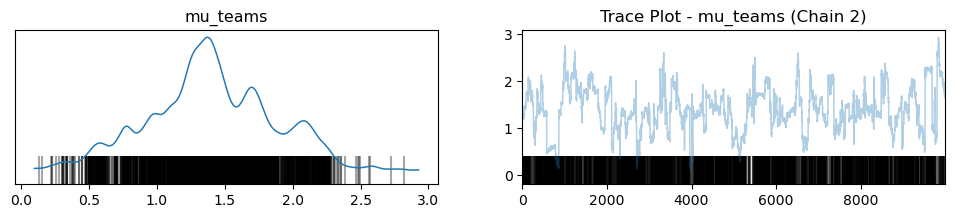

<Figure size 1000x400 with 0 Axes>

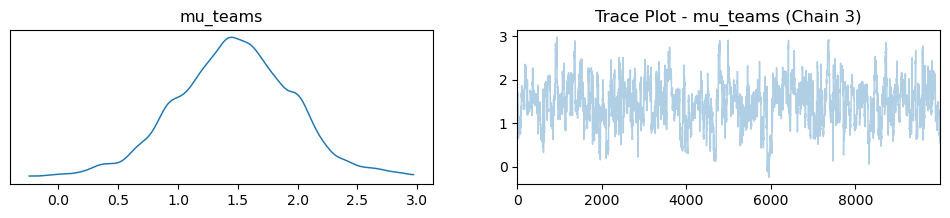

<Figure size 1000x400 with 0 Axes>

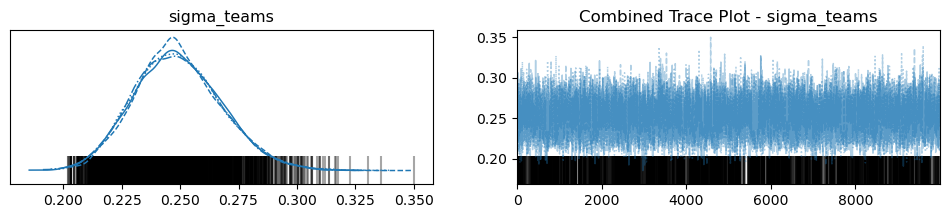

<Figure size 1000x400 with 0 Axes>

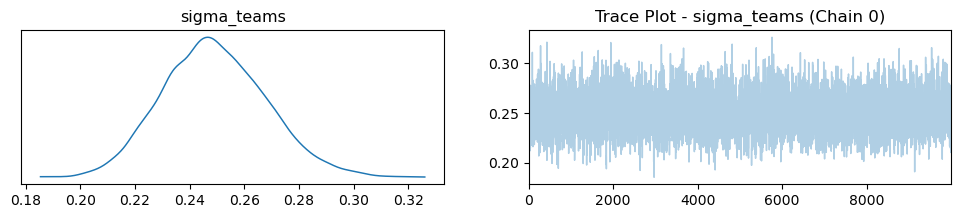

<Figure size 1000x400 with 0 Axes>

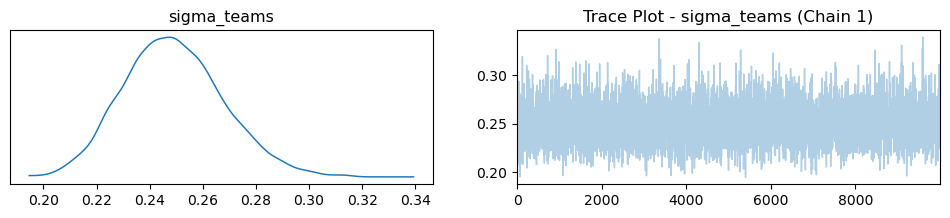

<Figure size 1000x400 with 0 Axes>

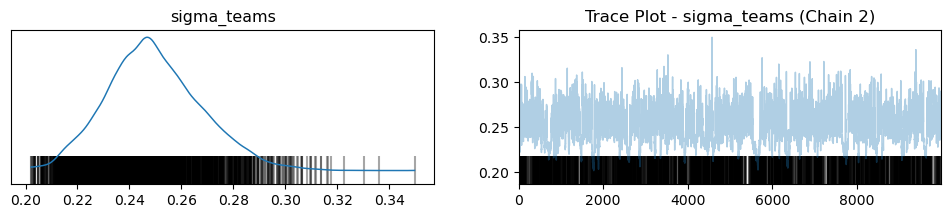

<Figure size 1000x400 with 0 Axes>

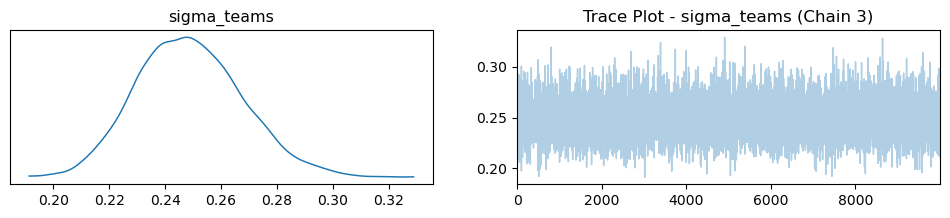

In [68]:
plot_trace_combined(trace_informative_time_dependent_model, 'team_skills')
plot_trace_by_chain(trace_informative_time_dependent_model, 'team_skills')
plot_trace_combined(trace_informative_time_dependent_model, 'baseline_skill')
plot_trace_by_chain(trace_informative_time_dependent_model, 'baseline_skill')
plot_trace_combined(trace_informative_time_dependent_model, 'home_advantage')
plot_trace_by_chain(trace_informative_time_dependent_model, 'home_advantage')
plot_trace_combined(trace_informative_time_dependent_model, 'mu_teams')
plot_trace_by_chain(trace_informative_time_dependent_model, 'mu_teams')
plot_trace_combined(trace_informative_time_dependent_model, 'sigma_teams')
plot_trace_by_chain(trace_informative_time_dependent_model, 'sigma_teams')

In [43]:
# Save trace plots for all parameters
save_arviz_plots(trace_informative_time_dependent_model, parameters=['team_skills', 'baseline_skill', 'home_advantage', 'mu_teams', 'sigma_teams'])

#### 1.3 Summary Statistics of Model Parameters

In [69]:
summarize_model(trace_informative_time_dependent_model, "team_skills")

,mean,sd,hdi_3%,hdi_97%,mcse_mean,mcse_sd,ess_bulk,ess_tail,r_hat
"team_skills[0, 0]",1.501,0.532,0.531,2.506,0.055,0.039,94.0,108.0,1.01
"team_skills[0, 1]",1.306,0.532,0.314,2.292,0.055,0.039,94.0,105.0,1.01
"team_skills[0, 2]",1.056,0.531,0.058,2.034,0.055,0.039,94.0,106.0,1.01
"team_skills[0, 3]",1.004,0.531,-0.010,1.967,0.055,0.039,94.0,102.0,1.01
"team_skills[0, 4]",1.369,0.532,0.384,2.359,0.055,0.039,94.0,103.0,1.01
...,...,...,...,...,...,...,...,...,...
"team_skills[5, 23]",1.414,0.581,0.344,2.534,0.056,0.040,111.0,125.0,1.01
"team_skills[5, 24]",1.415,0.578,0.315,2.499,0.055,0.039,112.0,133.0,1.01
"team_skills[5, 25]",1.344,0.531,0.353,2.316,0.055,0.039,95.0,104.0,1.01
"team_skills[5, 26]",1.273,0.531,0.293,2.264,0.055,0.039,95.0,103.0,1.01


In [70]:
summarize_model(trace_informative_time_dependent_model, "baseline_skill")

,mean,sd,hdi_3%,hdi_97%,mcse_mean,mcse_sd,ess_bulk,ess_tail,r_hat
baseline_skill,0.205,0.019,0.17,0.24,0.0,0.0,12769.0,13404.0,1.0


In [71]:
summarize_model(trace_informative_time_dependent_model, "home_advantage")

,mean,sd,hdi_3%,hdi_97%,mcse_mean,mcse_sd,ess_bulk,ess_tail,r_hat
home_advantage,0.384,0.017,0.353,0.416,0.0,0.0,10436.0,13095.0,1.0


In [73]:
summarize_model(trace_informative_time_dependent_model, "mu_teams")

,mean,sd,hdi_3%,hdi_97%,mcse_mean,mcse_sd,ess_bulk,ess_tail,r_hat
mu_teams,1.414,0.521,0.396,2.323,0.055,0.039,91.0,100.0,1.01


In [74]:
summarize_model(trace_informative_time_dependent_model, "sigma_teams")

,mean,sd,hdi_3%,hdi_97%,mcse_mean,mcse_sd,ess_bulk,ess_tail,r_hat
sigma_teams,0.249,0.019,0.214,0.284,0.0,0.0,5189.0,5969.0,1.0


#### 1.4 Posterior Predictive Checks (PPC) and Other Metrics

Sampling: [away_goals_observed, home_goals_observed]


Output()

PPC plot saved as 'ppc_informative_time_dependent_model.png'


<Figure size 1200x600 with 0 Axes>

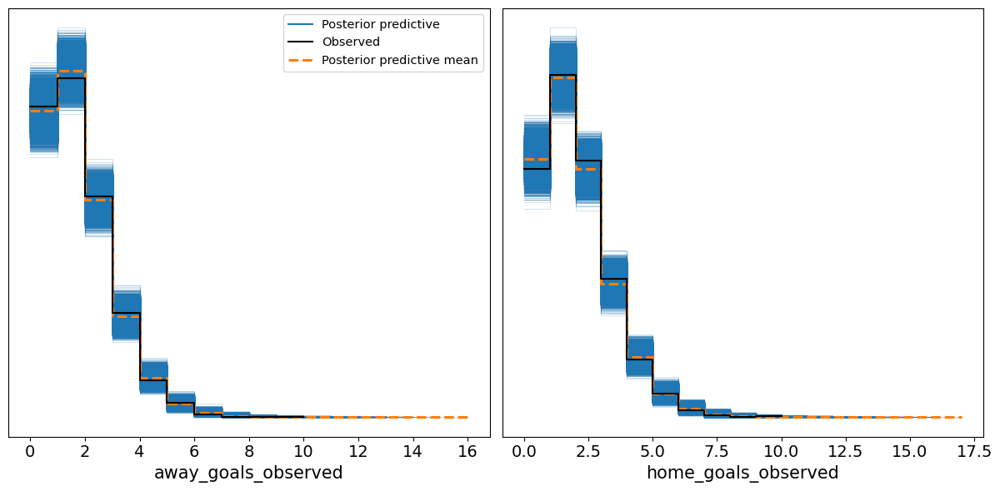

In [45]:
#save PPC plot
ppc_informative_time_dependent_model = save_ppc_plot(model_informative_time_dependent_model, trace_informative_time_dependent_model, "ppc_informative_time_dependent_model.png")

#### 1.5 Model Comparison Metrics (LOO and WAIC)

In [ ]:
metrics = calculate_model_comparison_metrics(trace_informative_time_dependent_model)

/Users/bymatchi/opt/anaconda3/envs/thesis/lib/python3.12/site-packages/arviz/stats/stats.py:1632: UserWarning: For one or more samples the posterior variance of the log predictive densities exceeds 0.4. This could be indication of WAIC starting to fail. 
See http://arxiv.org/abs/1507.04544 for details
  warnings.warn(


home_goals_observed - LOO: 
 Computed from 40000 posterior samples and 2280 observations log-likelihood matrix.

             Estimate       SE
deviance_loo  6934.46    63.42
p_loo           51.73        -
------

Pareto k diagnostic values:
                         Count   Pct.
(-Inf, 0.5]   (good)     2280  100.0%
 (0.5, 0.7]   (ok)          0    0.0%
   (0.7, 1]   (bad)         0    0.0%
   (1, Inf)   (very bad)    0    0.0%

home_goals_observed - WAIC: 
 Computed from 40000 posterior samples and 2280 observations log-likelihood matrix.

              Estimate       SE
deviance_waic  6934.38    63.42
p_waic           51.70        -

There has been a warning during the calculation. Please check the results.
away_goals_observed - LOO: 
 Computed from 40000 posterior samples and 2280 observations log-likelihood matrix.

             Estimate       SE
deviance_loo  6546.93    67.49
p_loo           45.94        -
------

Pareto k diagnostic values:
                         Count   Pct.
(

/Users/bymatchi/opt/anaconda3/envs/thesis/lib/python3.12/site-packages/arviz/stats/stats.py:1632: UserWarning: For one or more samples the posterior variance of the log predictive densities exceeds 0.4. This could be indication of WAIC starting to fail. 
See http://arxiv.org/abs/1507.04544 for details
  warnings.warn(


#### 1.6 Calculating error metrics (MAE and RMSE)

In [ ]:
gc.collect()

0

In [ ]:
# Home teams goals
home_mae, home_rmse = calculate_errors(ppc_informative_time_dependent_model, df_18_24, 'Home_Goals', 'home_goals_observed')

# Away Teams goals
away_mae, away_rmse = calculate_errors(ppc_informative_time_dependent_model, df_18_24, 'Away_Goals', 'away_goals_observed')

Home_Goals - MAE: 0.940079923245614, RMSE: 1.1972385196036095
Away_Goals - MAE: 0.8863493201754384, RMSE: 1.1282966003711044


#### 1.7 Roc- Auc

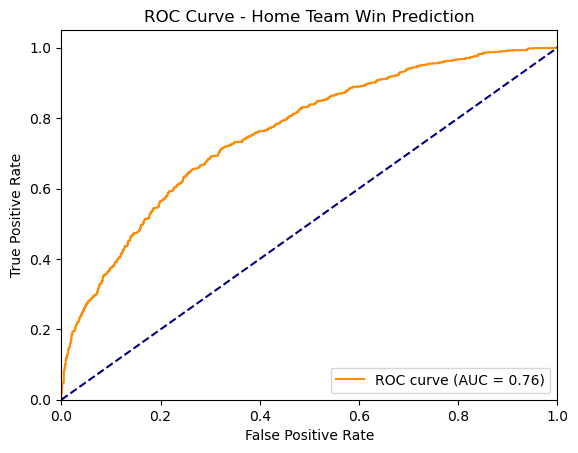

ROC AUC Value: 0.7582109623731186


In [ ]:
roc_auc = calculate_and_plot_roc_auc_from_ppc(ppc_informative_time_dependent_model, df_18_24)
print(f"ROC AUC Value: {roc_auc}")

#### 1.8 Energy Plot

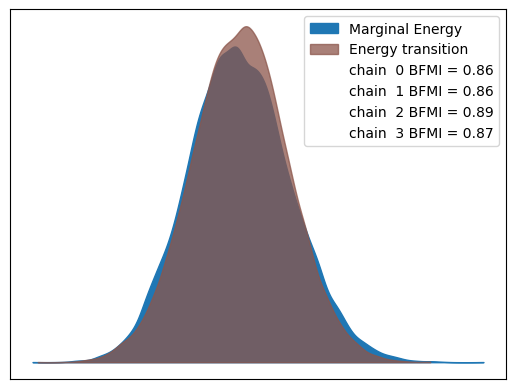

In [ ]:
plot_energy(trace_informative_time_dependent_model)

#### 1.9 Shape of the main Parameters

In [ ]:
print_posterior_shapes(trace_informative_time_dependent_model)

team_skills shape: (4, 10000, 6, 28)
baseline_skill shape: (4, 10000)


Plot saved as informative_time_dependent_team_skill.png in the current working directory.


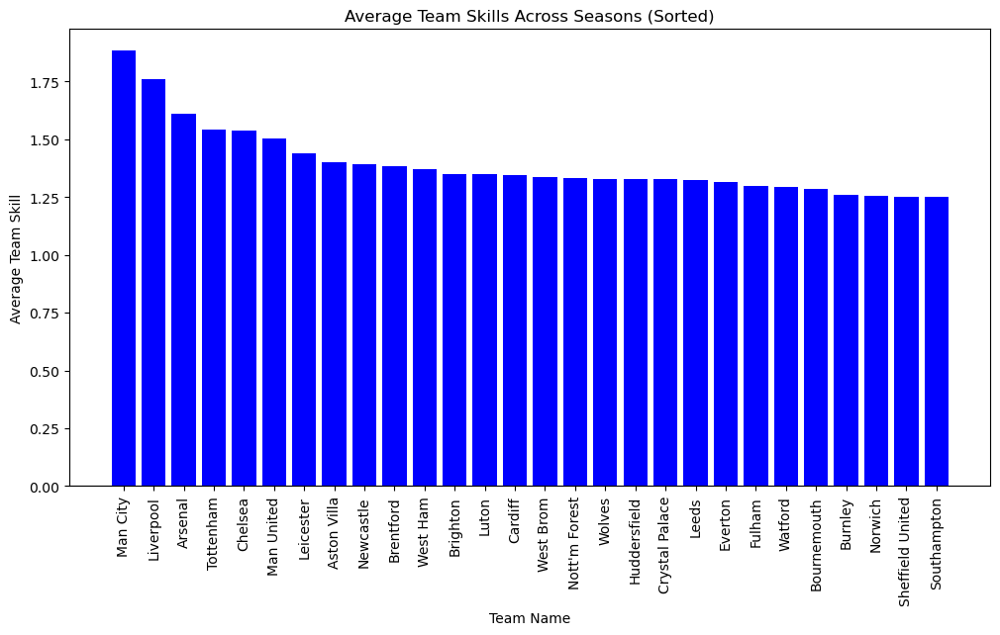

In [96]:
visualize_team_skills_time_dependent(df_18_24, trace_informative_time_dependent_model, filename="informative_time_dependent_team_skill.png")

Plot for Season 1 saved as informative_time_dependent_season_skills_season_1.png in the current working directory.


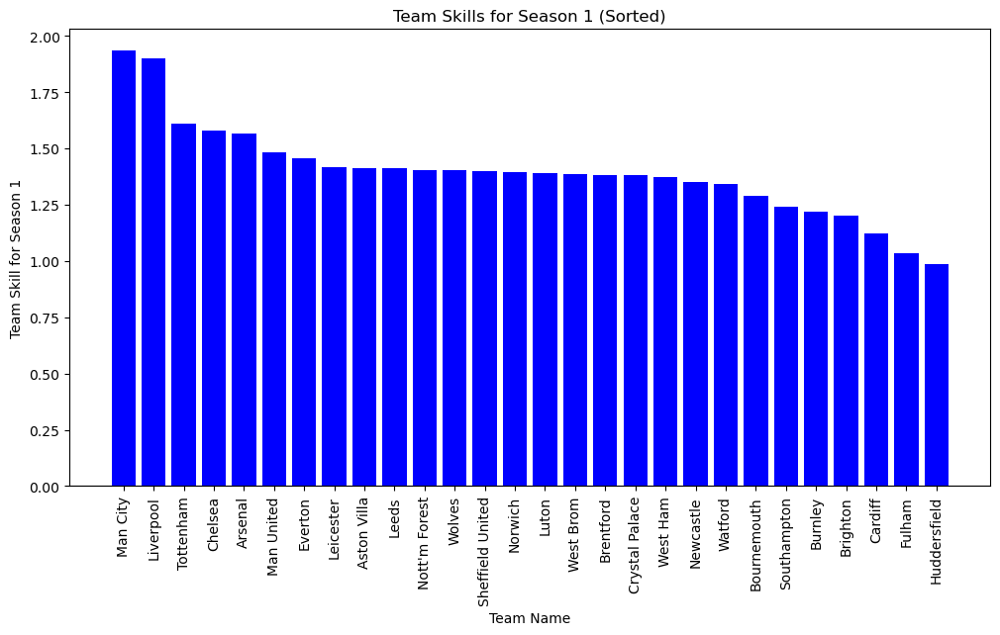

Plot for Season 2 saved as informative_time_dependent_season_skills_season_2.png in the current working directory.


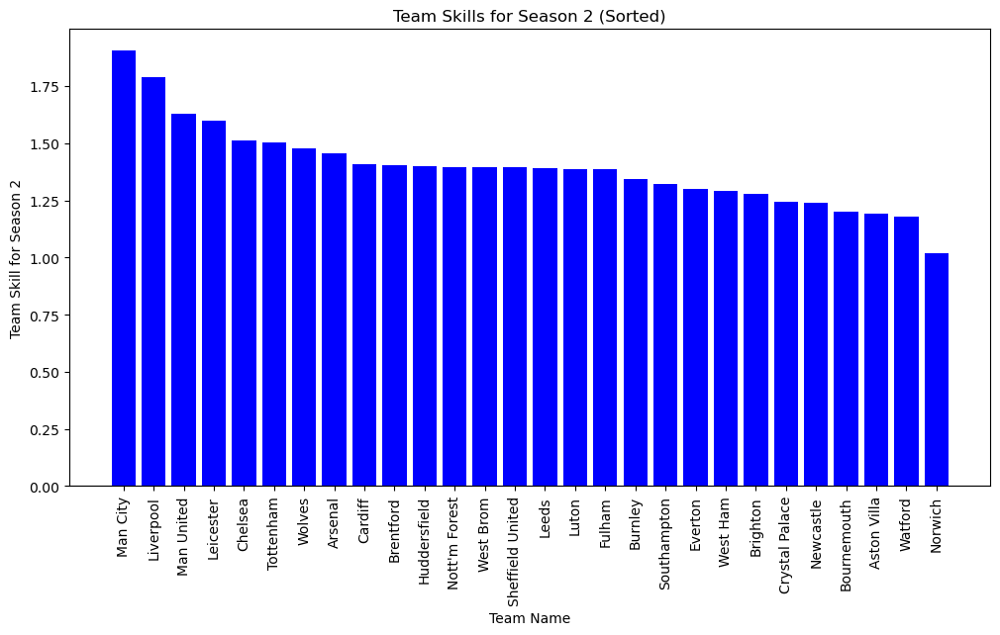

Plot for Season 3 saved as informative_time_dependent_season_skills_season_3.png in the current working directory.


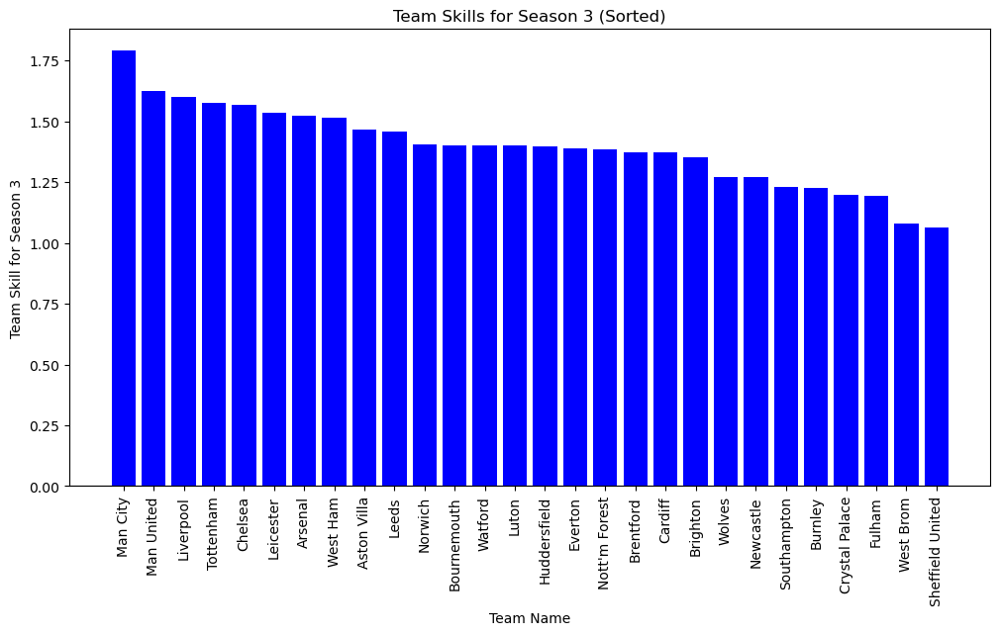

Plot for Season 4 saved as informative_time_dependent_season_skills_season_4.png in the current working directory.


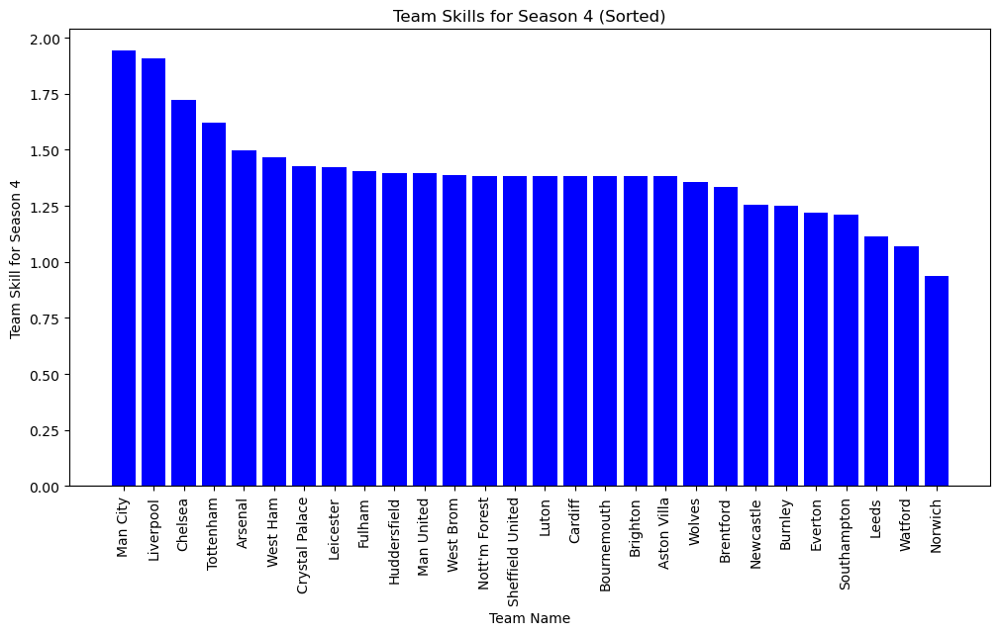

Plot for Season 5 saved as informative_time_dependent_season_skills_season_5.png in the current working directory.


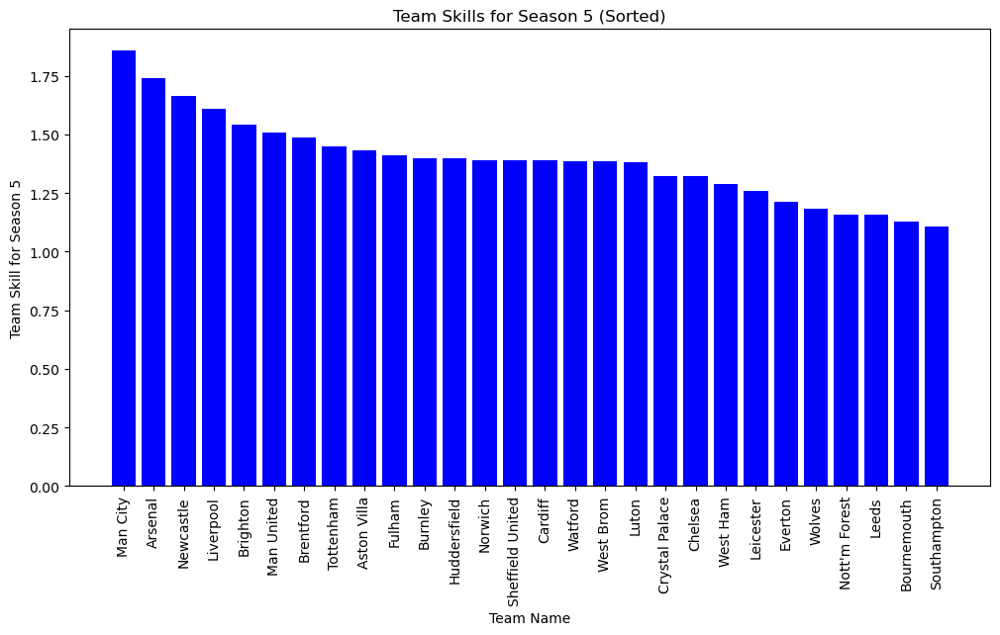

Plot for Season 6 saved as informative_time_dependent_season_skills_season_6.png in the current working directory.


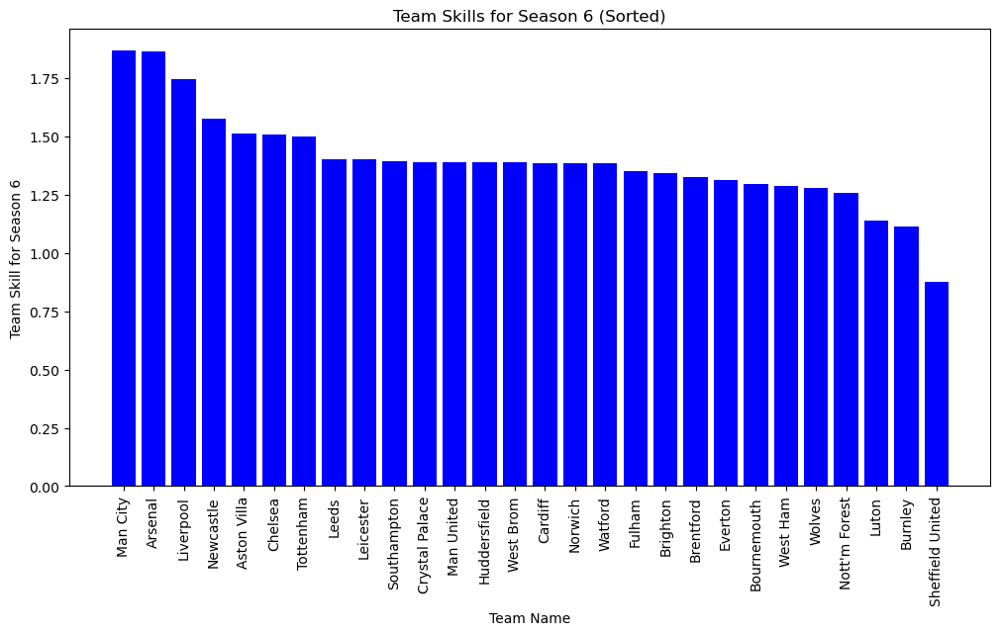

In [112]:
# Visualize team skills for each season
visualize_team_skills_seasonal(df_18_24, trace_informative_time_dependent_model, filename_prefix="informative_time_dependent_season_skills")

## 12. Time Dependent Non Centered Model

In [55]:
def time_dependent_non_centered_model(data, n_samples=10000, n_tune=2000):
    
    unique_teams = np.unique(data[['Home_Team', 'Away_Team']].values)
    unique_seasons = np.unique(data['Season_ID'].values)
    n_teams = len(unique_teams)
    n_seasons = len(unique_seasons)
    n_games = data.shape[0]

    home_team_ids = data['Home_Team_ID'].values
    away_team_ids = data['Away_Team_ID'].values
    season_ids = data['Season_ID'].values - data['Season_ID'].min()
    
    home_goals = data['Home_Goals'].values
    away_goals = data['Away_Goals'].values
    
    with pm.Model() as model:
        mu_teams = pm.Normal('mu_teams', mu=0, sigma=4)
        sigma_teams = pm.HalfNormal('sigma_teams', sigma=1)
        
        # Non-centered reparameterization for team skills
        raw_team_skills = pm.Normal('raw_team_skills', mu=0, sigma=1, shape=(n_seasons, n_teams))
        team_skills = pm.Deterministic('team_skills', mu_teams + raw_team_skills * sigma_teams)

        # Priors for baseline skill
        baseline_skill = pm.Normal('baseline_skill', mu=0, sigma=4)

        
        # Priors for home advantage  
        home_advantage = pm.Normal('home_advantage', mu=0, sigma=4)
        

        #Likelihood
        lambda_home_goals = pm.Deterministic('lambda_home_goals', 
                                             pm.math.exp(home_advantage + team_skills[season_ids, home_team_ids] - team_skills[season_ids, away_team_ids]))
        lambda_away_goals = pm.Deterministic('lambda_away_goals', pm.math.exp(baseline_skill + team_skills[season_ids, away_team_ids] - team_skills[season_ids, home_team_ids]))

        # +Observed goal data
        home_goals_observed = pm.Poisson('home_goals_observed', mu=lambda_home_goals, observed=home_goals)
        away_goals_observed = pm.Poisson('away_goals_observed', mu=lambda_away_goals, observed=away_goals)
        
        # Sample the model
        trace = pm.sample(n_samples, tune=n_tune, cores=4, return_inferencedata=True, idata_kwargs={'log_likelihood': True})

        
    return model, trace 


### 1- Model Application for the 2018-2024 Period

In [56]:
gc.collect()
# Getting Model and Trace
model_time_dep_non_centered, trace_time_dep_non_centered = time_dependent_non_centered_model(df_18_24)

Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [mu_teams, sigma_teams, raw_team_skills, baseline_skill, home_advantage]


Output()

Sampling 4 chains for 2_000 tune and 10_000 draw iterations (8_000 + 40_000 draws total) took 63 seconds.


In [51]:
gc.collect()

0

#### 1.1 Summay of the parameters

In [52]:
total_params = summarize_posterior(trace_time_dep_non_centered)

Posterior Variables: ['baseline_skill', 'home_advantage', 'lambda_away_goals', 'lambda_home_goals', 'mu_teams', 'raw_team_skills', 'sigma_teams', 'team_skills']
Total Parameters: 196000000


#### 1.2 Trace Plots

<Figure size 1000x400 with 0 Axes>

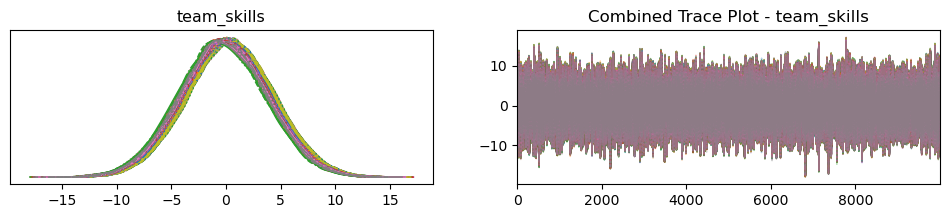

<Figure size 1000x400 with 0 Axes>

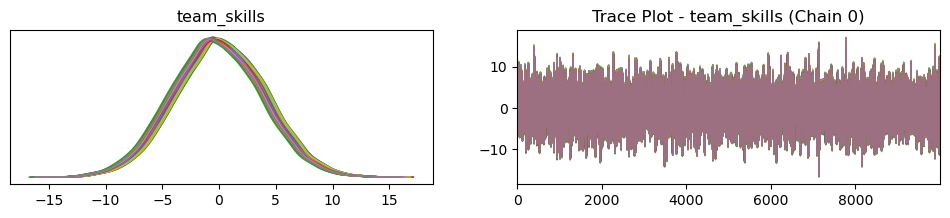

<Figure size 1000x400 with 0 Axes>

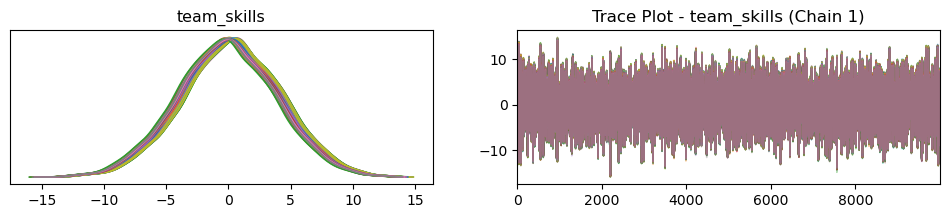

<Figure size 1000x400 with 0 Axes>

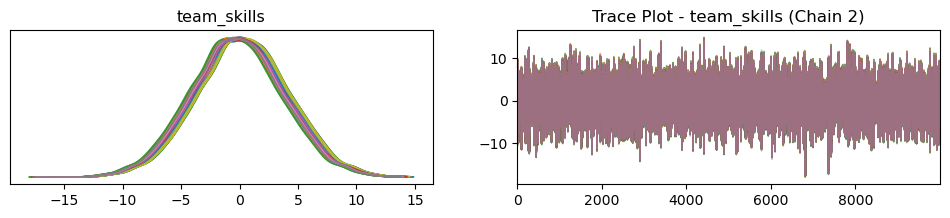

<Figure size 1000x400 with 0 Axes>

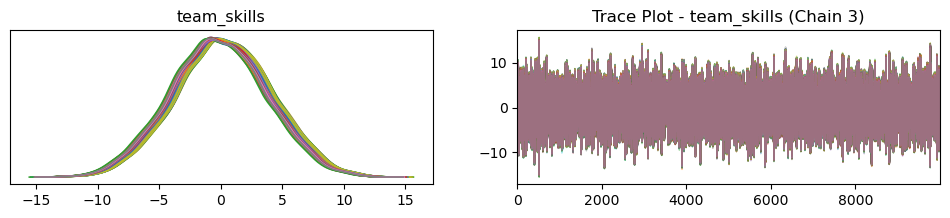

<Figure size 1000x400 with 0 Axes>

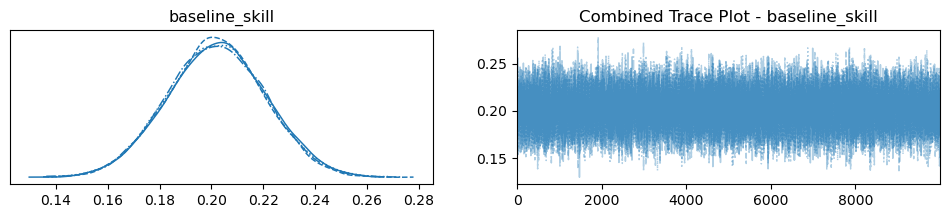

<Figure size 1000x400 with 0 Axes>

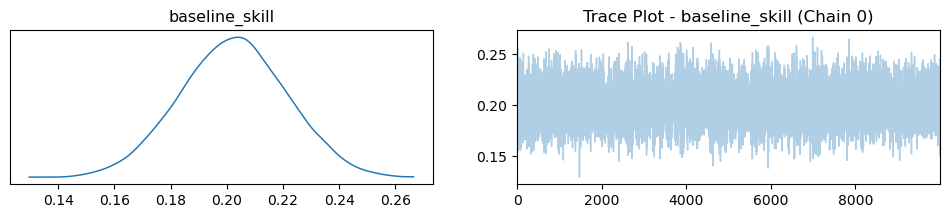

<Figure size 1000x400 with 0 Axes>

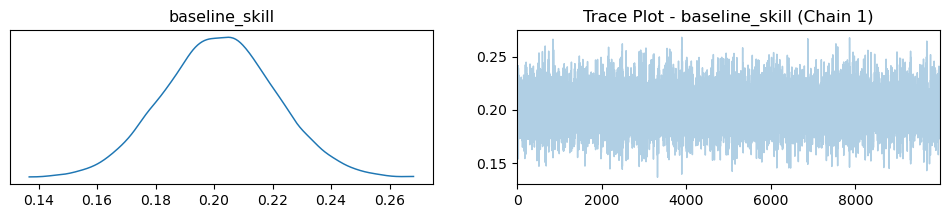

<Figure size 1000x400 with 0 Axes>

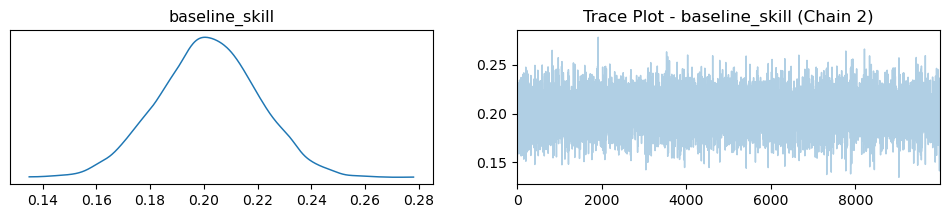

<Figure size 1000x400 with 0 Axes>

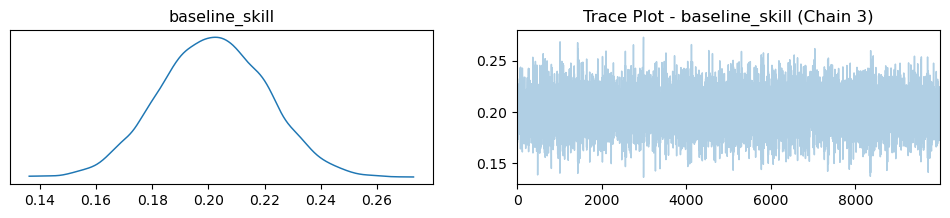

<Figure size 1000x400 with 0 Axes>

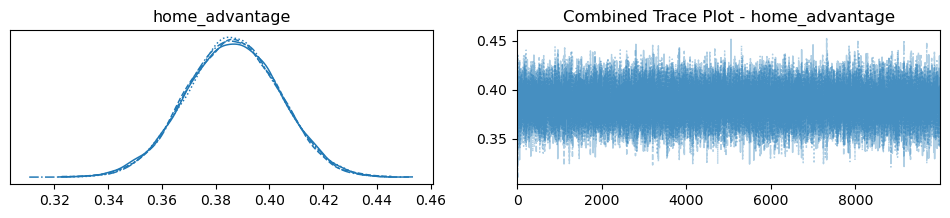

<Figure size 1000x400 with 0 Axes>

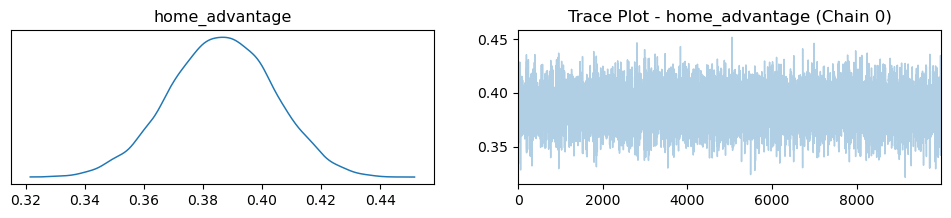

<Figure size 1000x400 with 0 Axes>

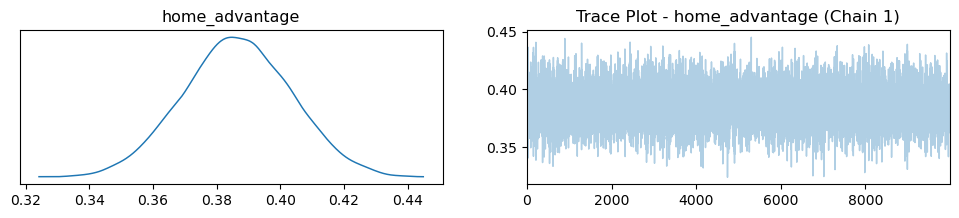

<Figure size 1000x400 with 0 Axes>

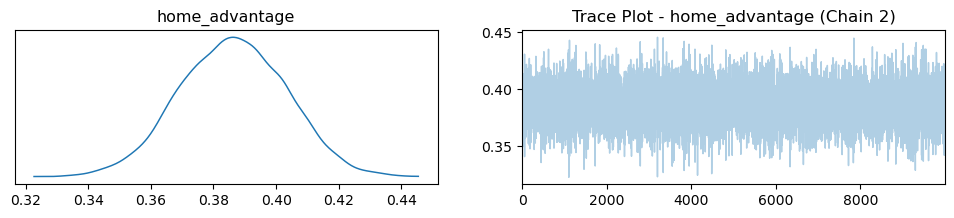

<Figure size 1000x400 with 0 Axes>

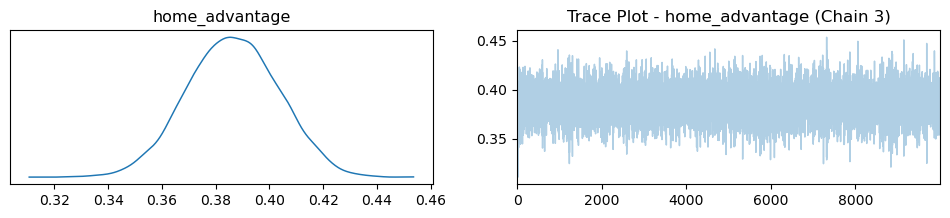

<Figure size 1000x400 with 0 Axes>

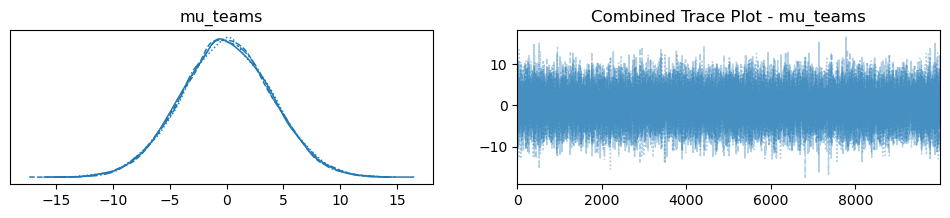

<Figure size 1000x400 with 0 Axes>

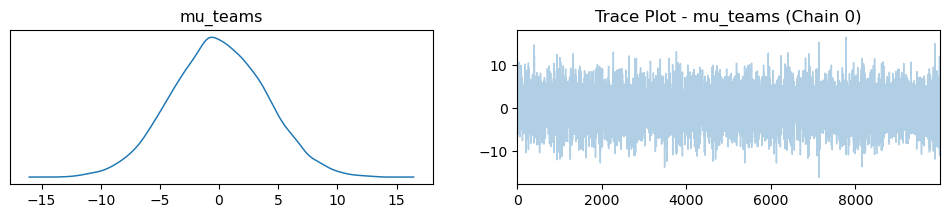

<Figure size 1000x400 with 0 Axes>

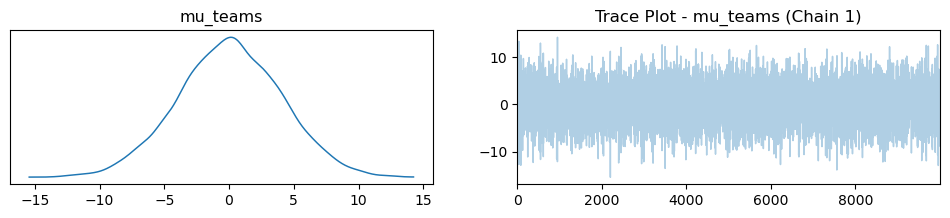

<Figure size 1000x400 with 0 Axes>

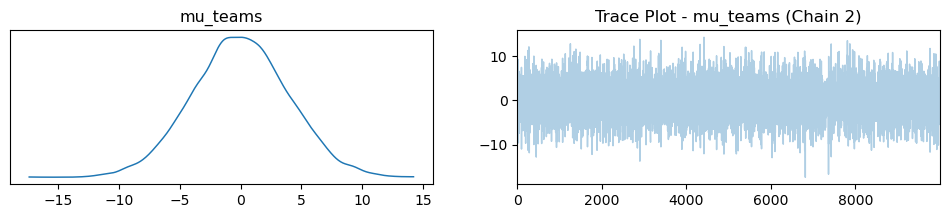

<Figure size 1000x400 with 0 Axes>

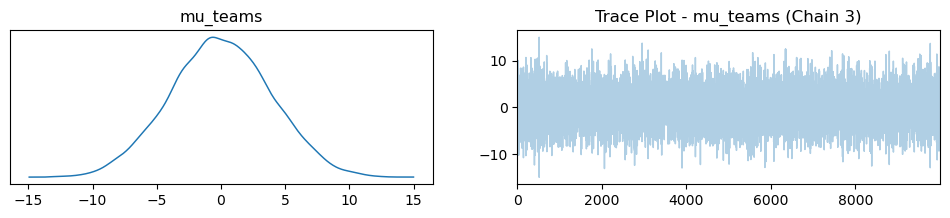

<Figure size 1000x400 with 0 Axes>

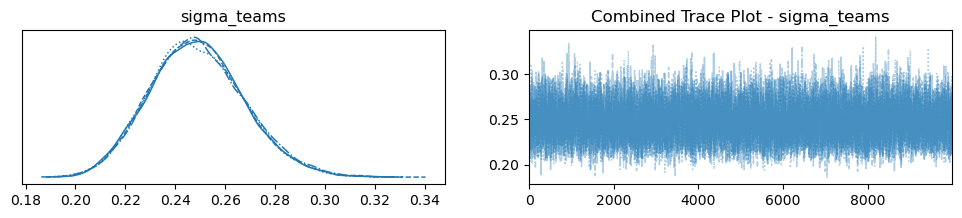

<Figure size 1000x400 with 0 Axes>

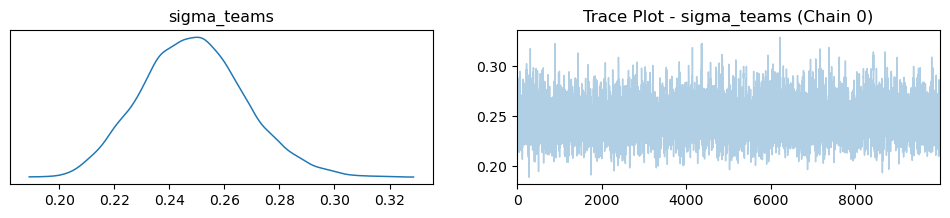

<Figure size 1000x400 with 0 Axes>

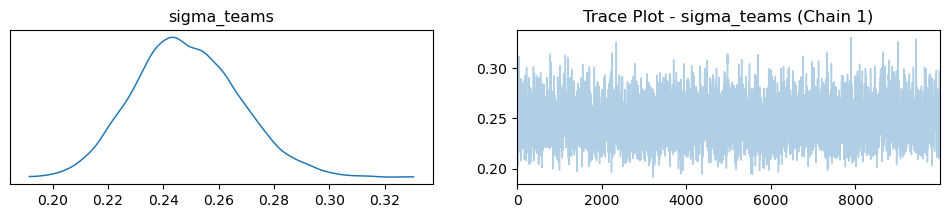

<Figure size 1000x400 with 0 Axes>

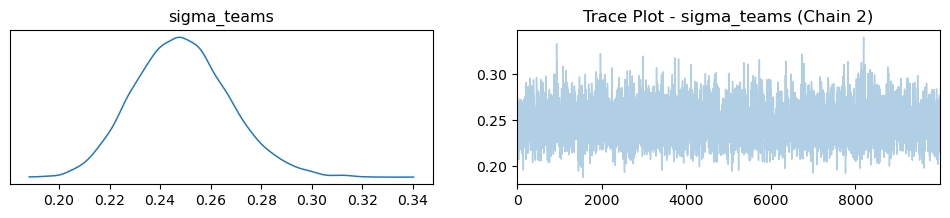

<Figure size 1000x400 with 0 Axes>

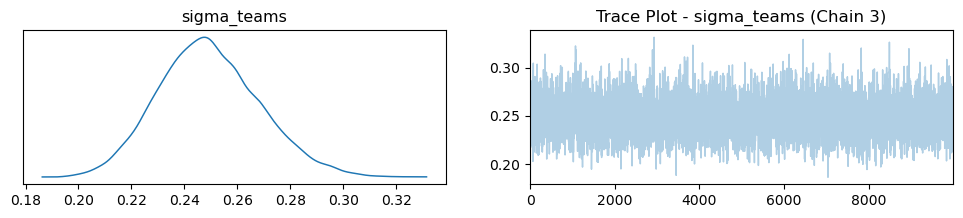

In [53]:
plot_trace_combined(trace_time_dep_non_centered, 'team_skills')
plot_trace_by_chain(trace_time_dep_non_centered, 'team_skills')
plot_trace_combined(trace_time_dep_non_centered, 'baseline_skill')
plot_trace_by_chain(trace_time_dep_non_centered, 'baseline_skill')
plot_trace_combined(trace_time_dep_non_centered, 'home_advantage')
plot_trace_by_chain(trace_time_dep_non_centered, 'home_advantage')
plot_trace_combined(trace_time_dep_non_centered, 'mu_teams')
plot_trace_by_chain(trace_time_dep_non_centered, 'mu_teams')
plot_trace_combined(trace_time_dep_non_centered, 'sigma_teams')
plot_trace_by_chain(trace_time_dep_non_centered, 'sigma_teams')

In [54]:
# Save trace plots for all parameters
save_arviz_plots(trace_time_dep_non_centered, parameters=['team_skills', 'baseline_skill', 'home_advantage', 'mu_teams', 'sigma_teams'])

#### 1.3 Summary Statistics 

In [55]:
summarize_model(trace_time_dep_non_centered, "team_skills")

,mean,sd,hdi_3%,hdi_97%,mcse_mean,mcse_sd,ess_bulk,ess_tail,r_hat
"team_skills[0, 0]",0.085,3.977,-7.269,7.679,0.016,0.023,58840.0,29140.0,1.0
"team_skills[0, 1]",-0.111,3.976,-7.420,7.538,0.016,0.023,58934.0,29455.0,1.0
"team_skills[0, 2]",-0.361,3.976,-7.894,7.054,0.016,0.022,58931.0,29433.0,1.0
"team_skills[0, 3]",-0.413,3.977,-7.863,7.084,0.016,0.022,58925.0,29445.0,1.0
"team_skills[0, 4]",-0.048,3.976,-7.507,7.441,0.016,0.023,58828.0,29083.0,1.0
...,...,...,...,...,...,...,...,...,...
"team_skills[5, 23]",-0.002,3.982,-7.363,7.616,0.016,0.023,58957.0,28451.0,1.0
"team_skills[5, 24]",-0.002,3.987,-7.494,7.470,0.016,0.023,59045.0,28749.0,1.0
"team_skills[5, 25]",-0.071,3.975,-7.400,7.529,0.016,0.023,58896.0,29501.0,1.0
"team_skills[5, 26]",-0.141,3.977,-7.555,7.384,0.016,0.023,58816.0,29511.0,1.0


In [56]:
summarize_model(trace_time_dep_non_centered, "baseline_skill")

,mean,sd,hdi_3%,hdi_97%,mcse_mean,mcse_sd,ess_bulk,ess_tail,r_hat
baseline_skill,0.202,0.019,0.166,0.237,0.0,0.0,57099.0,29292.0,1.0


In [57]:
summarize_model(trace_time_dep_non_centered, "home_advantage")

,mean,sd,hdi_3%,hdi_97%,mcse_mean,mcse_sd,ess_bulk,ess_tail,r_hat
home_advantage,0.386,0.017,0.355,0.419,0.0,0.0,56906.0,27758.0,1.0


In [58]:
summarize_model(trace_time_dep_non_centered, "mu_teams")

,mean,sd,hdi_3%,hdi_97%,mcse_mean,mcse_sd,ess_bulk,ess_tail,r_hat
mu_teams,-0.002,3.975,-7.373,7.566,0.016,0.023,58895.0,29364.0,1.0


In [59]:
summarize_model(trace_time_dep_non_centered, "sigma_teams")

,mean,sd,hdi_3%,hdi_97%,mcse_mean,mcse_sd,ess_bulk,ess_tail,r_hat
sigma_teams,0.249,0.019,0.213,0.284,0.0,0.0,10951.0,15009.0,1.0


#### 1.4 Posterior Predictive Check (PPC)

Sampling: [away_goals_observed, home_goals_observed]


Output()

PPC plot saved as 'ppc_time_dep_non_centered.png'


<Figure size 1200x600 with 0 Axes>

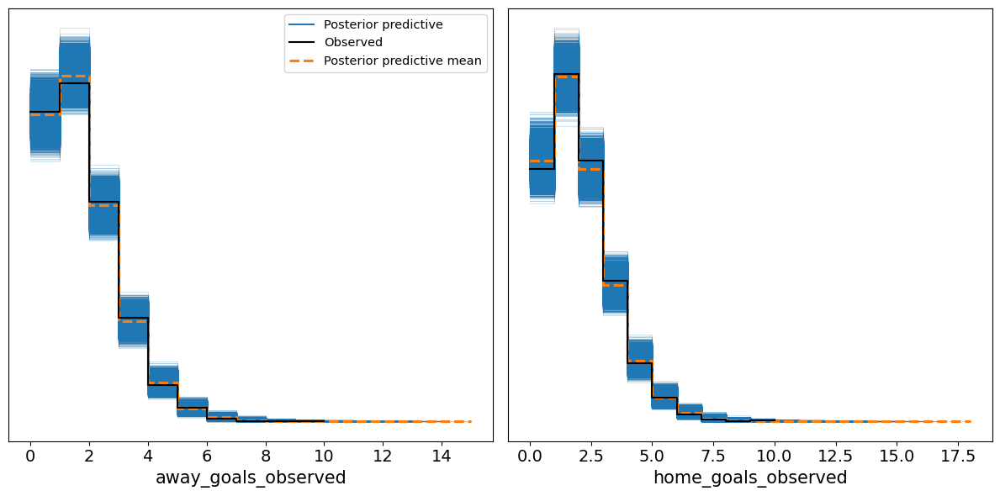

In [60]:
# Save PPC plot
ppc_time_dep_non_centered = save_ppc_plot(model_time_dep_non_centered, trace_time_dep_non_centered, "ppc_time_dep_non_centered.png")

#### 1.5 Model Comparison Metrics (LOO and WAIC)

In [ ]:
metrics = calculate_model_comparison_metrics(trace_time_dep_non_centered)

/Users/bymatchi/opt/anaconda3/envs/thesis/lib/python3.12/site-packages/arviz/stats/stats.py:1632: UserWarning: For one or more samples the posterior variance of the log predictive densities exceeds 0.4. This could be indication of WAIC starting to fail. 
See http://arxiv.org/abs/1507.04544 for details
  warnings.warn(


home_goals_observed - LOO: 
 Computed from 40000 posterior samples and 2280 observations log-likelihood matrix.

             Estimate       SE
deviance_loo  6934.48    63.25
p_loo           51.76        -
------

Pareto k diagnostic values:
                         Count   Pct.
(-Inf, 0.5]   (good)     2280  100.0%
 (0.5, 0.7]   (ok)          0    0.0%
   (0.7, 1]   (bad)         0    0.0%
   (1, Inf)   (very bad)    0    0.0%

home_goals_observed - WAIC: 
 Computed from 40000 posterior samples and 2280 observations log-likelihood matrix.

              Estimate       SE
deviance_waic  6934.40    63.25
p_waic           51.72        -

There has been a warning during the calculation. Please check the results.
away_goals_observed - LOO: 
 Computed from 40000 posterior samples and 2280 observations log-likelihood matrix.

             Estimate       SE
deviance_loo  6546.96    67.81
p_loo           45.98        -
------

Pareto k diagnostic values:
                         Count   Pct.
(

/Users/bymatchi/opt/anaconda3/envs/thesis/lib/python3.12/site-packages/arviz/stats/stats.py:1632: UserWarning: For one or more samples the posterior variance of the log predictive densities exceeds 0.4. This could be indication of WAIC starting to fail. 
See http://arxiv.org/abs/1507.04544 for details
  warnings.warn(


#### 1.6 Calculating error metrics (MAE and RMSE)

In [ ]:
gc.collect()

0

In [61]:
# Home teams goals
home_mae, home_rmse = calculate_errors(ppc_time_dep_non_centered, df_18_24, 'Home_Goals', 'home_goals_observed')

# Away Teams goals
away_mae, away_rmse = calculate_errors(ppc_time_dep_non_centered, df_18_24, 'Away_Goals', 'away_goals_observed')

Home_Goals - MAE: 0.9403565789473683, RMSE: 1.197250964767189
Away_Goals - MAE: 0.8856497478070176, RMSE: 1.128066954089966


#### 1.7 Roc- Auc

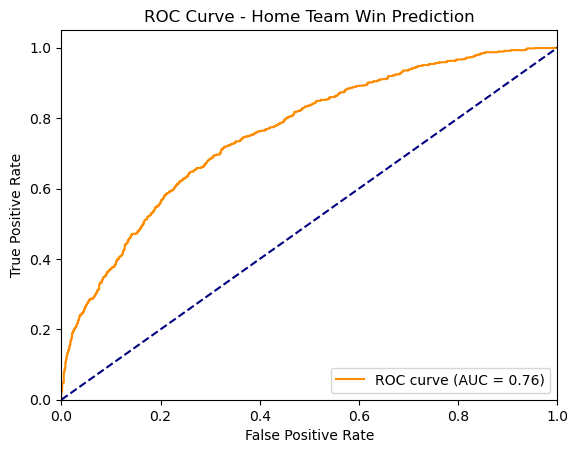

ROC AUC Value: 0.7580634868505531


In [62]:
roc_auc = calculate_and_plot_roc_auc_from_ppc(ppc_time_dep_non_centered, df_18_24)
print(f"ROC AUC Value: {roc_auc}")

#### 1.8 Energy Plot

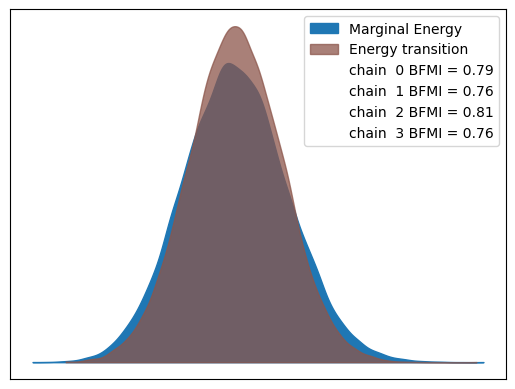

In [63]:
plot_energy(trace_time_dep_non_centered)

#### 1.9 Shape of the main Parameters

In [ ]:
print_posterior_shapes(trace_time_dep_non_centered)

team_skills shape: (4, 10000, 6, 28)
baseline_skill shape: (4, 10000)


Plot saved as time_dep_non_centered_team_skill.png in the current working directory.


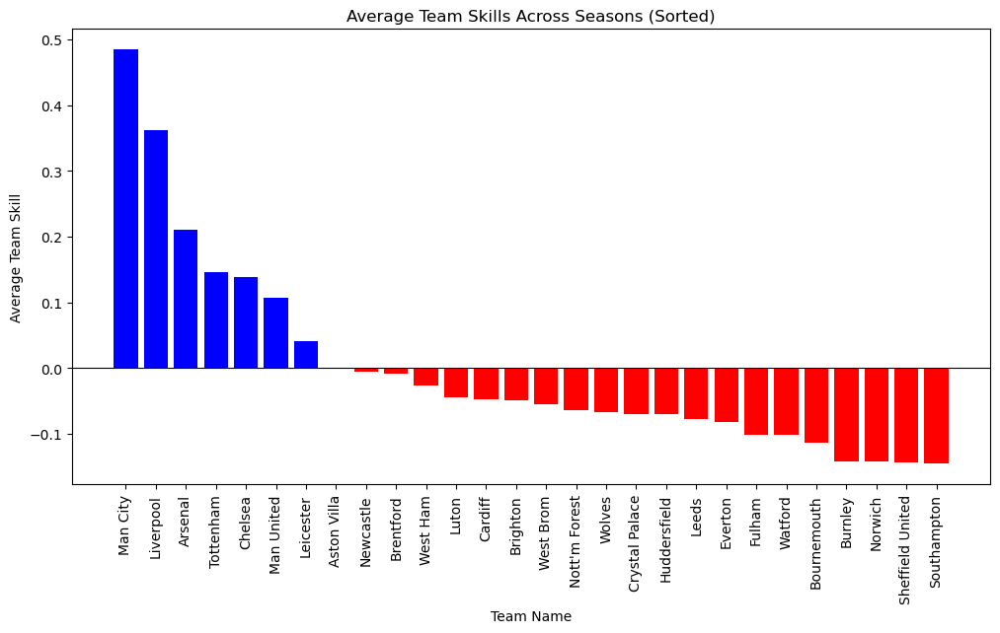

In [97]:
visualize_team_skills_time_dependent(df_18_24, trace_time_dep_non_centered, filename="time_dep_non_centered_team_skill.png")

Plot for Season 1 saved as time_dep_non_centered_season_skills_season_1.png in the current working directory.


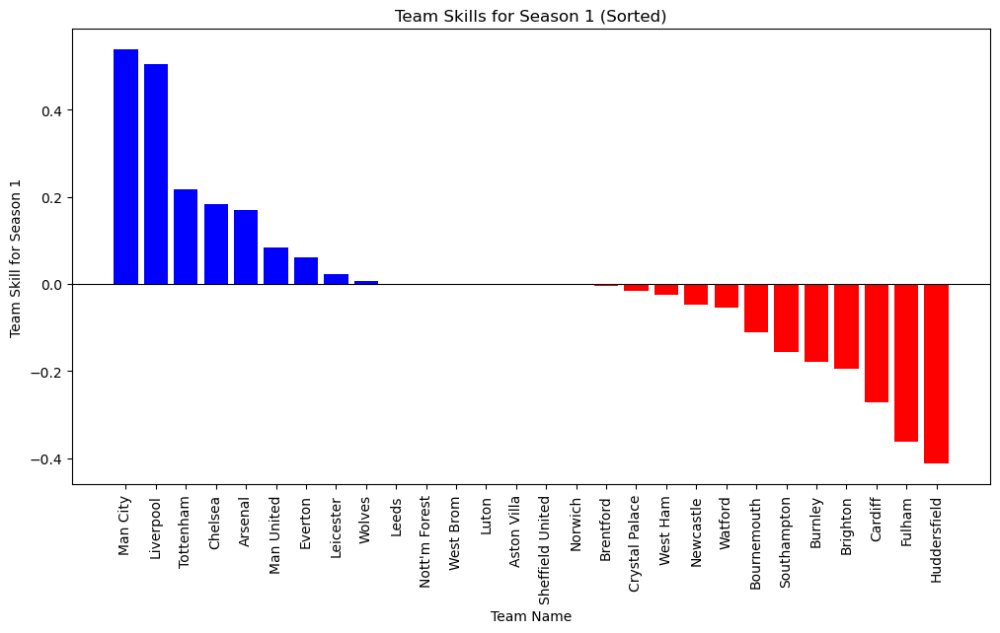

Plot for Season 2 saved as time_dep_non_centered_season_skills_season_2.png in the current working directory.


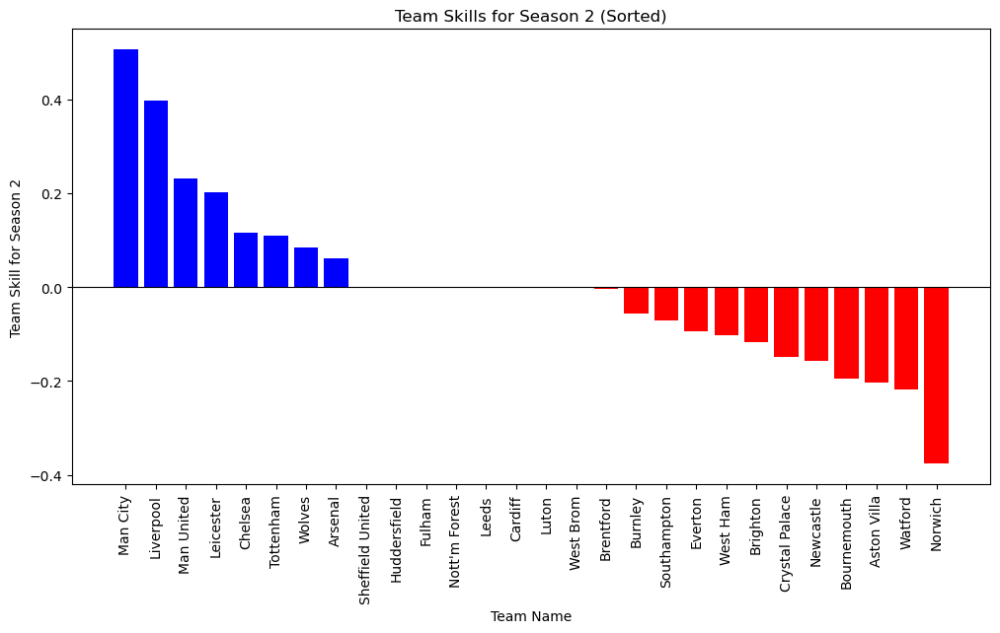

Plot for Season 3 saved as time_dep_non_centered_season_skills_season_3.png in the current working directory.


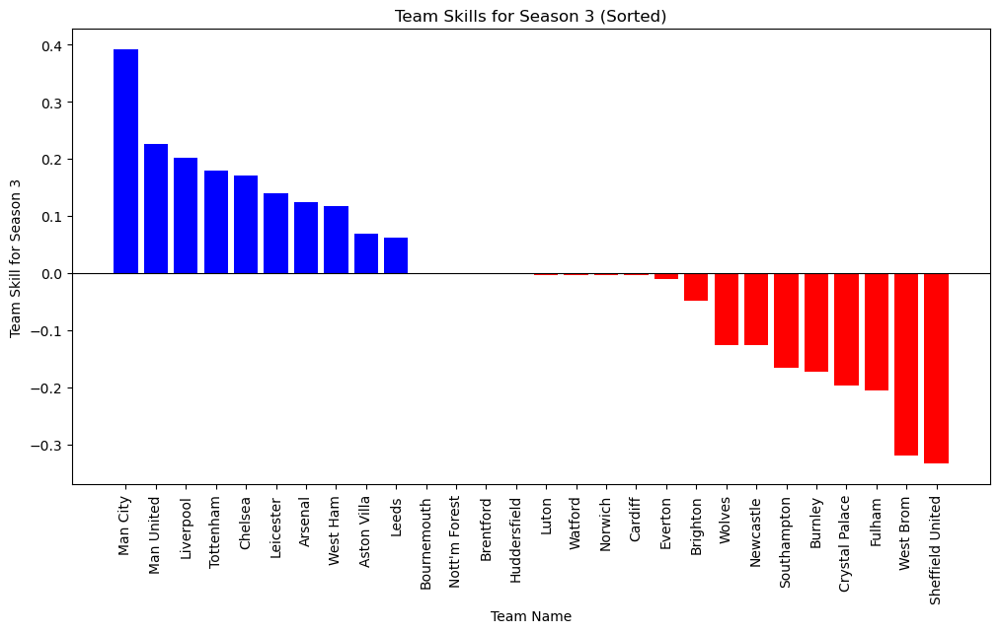

Plot for Season 4 saved as time_dep_non_centered_season_skills_season_4.png in the current working directory.


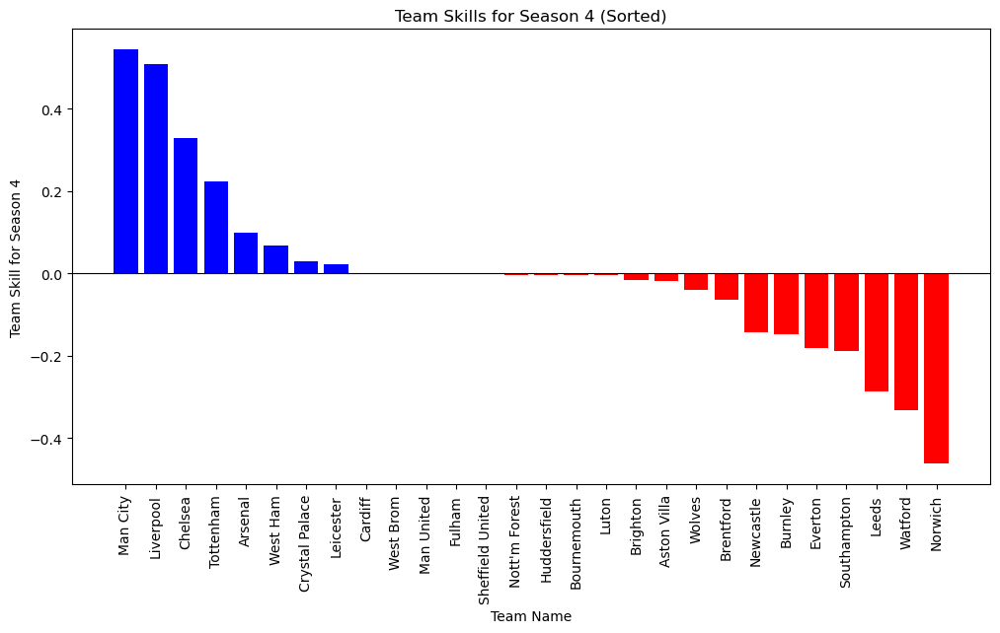

Plot for Season 5 saved as time_dep_non_centered_season_skills_season_5.png in the current working directory.


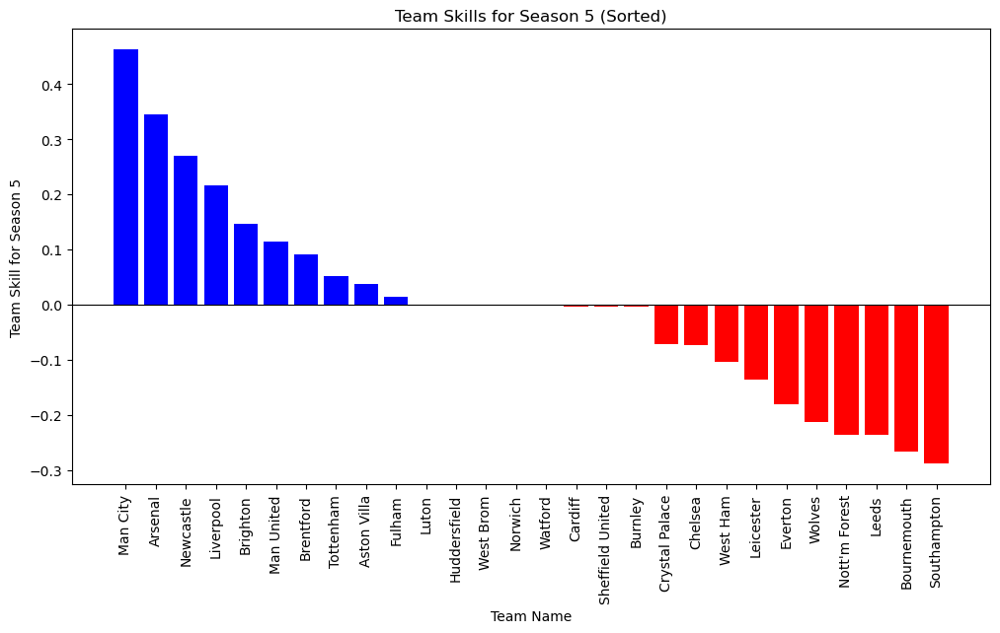

Plot for Season 6 saved as time_dep_non_centered_season_skills_season_6.png in the current working directory.


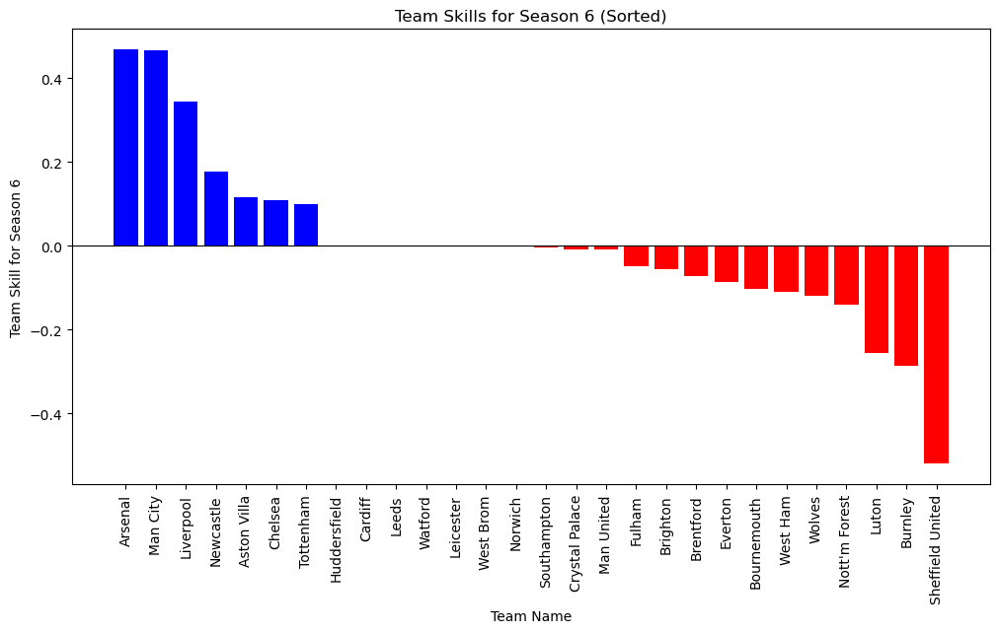

In [111]:
# visualizing team skills for each season
visualize_team_skills_seasonal(df_18_24, trace_time_dep_non_centered, filename_prefix="time_dep_non_centered_season_skills")

## 13. Time Dependent Non-Centered with Informative Priors Model

In [100]:
def informative_time_dependent_non_centered_model(data, n_samples=10000, n_tune=2000):
    
    # Determine unique teams, unique seasons, and number of games
    unique_teams = np.unique(data[['Home_Team', 'Away_Team']].values)
    unique_seasons = np.unique(data['Season_ID'].values)
    n_teams = len(unique_teams)
    n_seasons = len(unique_seasons)
    n_games = data.shape[0]

    # Extract team IDs, season IDs, and goal values
    home_team_ids = data['Home_Team_ID'].values
    away_team_ids = data['Away_Team_ID'].values
    season_ids = data['Season_ID'].values - data['Season_ID'].min()
    home_goals = data['Home_Goals'].values
    away_goals = data['Away_Goals'].values
    
    with pm.Model() as model:
        
        # Informative hyperpriors for team skills
        mu_teams = pm.Normal('mu_teams', mu=1.5, sigma=0.5)  
        sigma_teams = pm.HalfNormal('sigma_teams', sigma=0.75) 

        # Non-centered reparameterization for team skills
        raw_team_skills = pm.Normal('raw_team_skills', mu=0, sigma=1, shape=(n_seasons, n_teams))
        team_skills = pm.Deterministic('team_skills', mu_teams + raw_team_skills * sigma_teams)

        # Informative priors for home advantage  
        home_advantage = pm.Normal('home_advantage', mu=0.3, sigma=0.1)  

        # Informative priors for baseline skill
        baseline_skill = pm.Normal('baseline_skill', mu=0.3, sigma=0.1)


        
        # Likelihood
        lambda_home_goals = pm.Deterministic(
            'lambda_home_goals', 
            pm.math.exp(home_advantage + 
                        team_skills[season_ids, home_team_ids] - 
                        team_skills[season_ids, away_team_ids])
        )
        lambda_away_goals = pm.Deterministic(
            'lambda_away_goals', 
            pm.math.exp(baseline_skill + 
                        team_skills[season_ids, away_team_ids] - 
                        team_skills[season_ids, home_team_ids])
        )

        # Observed goal data
        home_goals_observed = pm.Poisson('home_goals_observed', mu=lambda_home_goals, observed=home_goals)
        away_goals_observed = pm.Poisson('away_goals_observed', mu=lambda_away_goals, observed=away_goals)
        
        # Sample the model
        trace = pm.sample(n_samples, tune=n_tune, cores=4, return_inferencedata=True, idata_kwargs={'log_likelihood': True})
    
    return model, trace


#### 1- Model Application for the 2018-2024 Period

In [71]:
# Getting Model and Trace
model_info_time_dep_non_centered_model, trace_info_time_dep_non_centered_model = informative_time_dependent_non_centered_model(df_18_24)

Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [mu_teams, sigma_teams, raw_team_skills, home_advantage, baseline_skill]


Output()

Sampling 4 chains for 2_000 tune and 10_000 draw iterations (8_000 + 40_000 draws total) took 66 seconds.


In [73]:
gc.collect()

0

#### 1.1 Summay of the parameters

In [ ]:
total_params = summarize_posterior(trace_info_time_dep_non_centered_model)

Posterior Variables: ['baseline_skill', 'home_advantage', 'lambda_away_goals', 'lambda_home_goals', 'mu_teams', 'raw_team_skills', 'sigma_teams', 'team_skills']
Total Parameters: 196000000


#### 1.2 Trace Plots

<Figure size 1000x400 with 0 Axes>

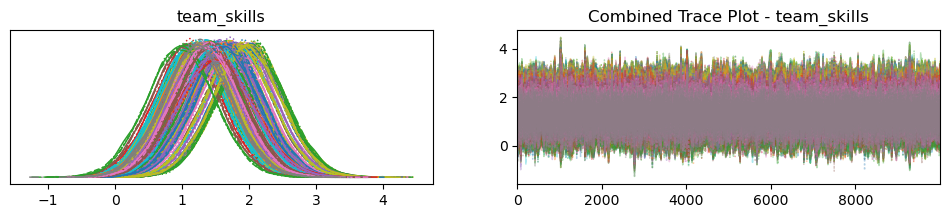

<Figure size 1000x400 with 0 Axes>

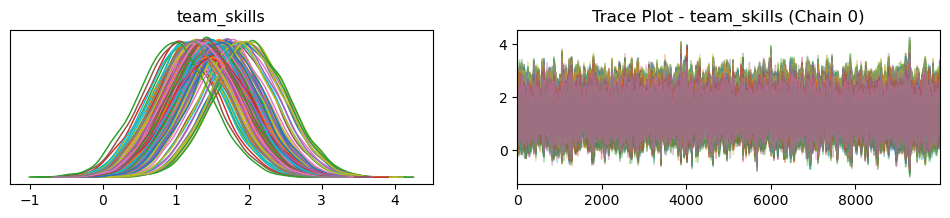

<Figure size 1000x400 with 0 Axes>

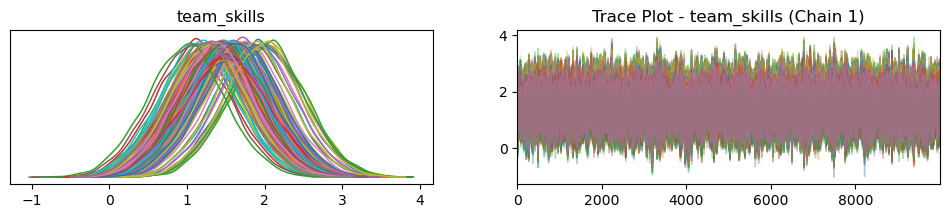

<Figure size 1000x400 with 0 Axes>

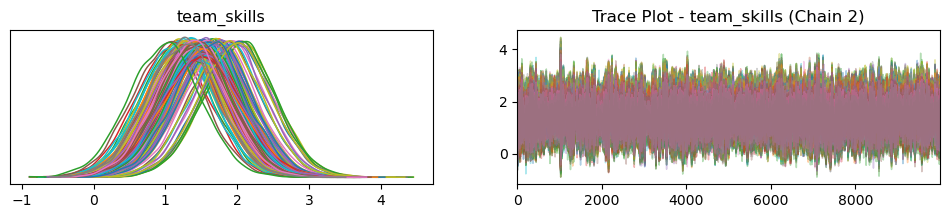

<Figure size 1000x400 with 0 Axes>

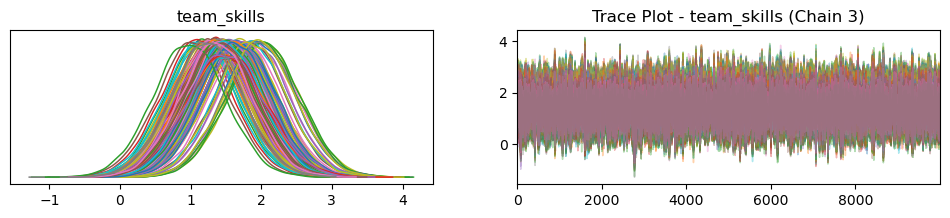

<Figure size 1000x400 with 0 Axes>

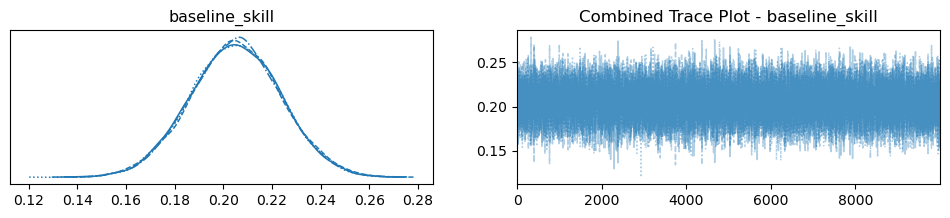

<Figure size 1000x400 with 0 Axes>

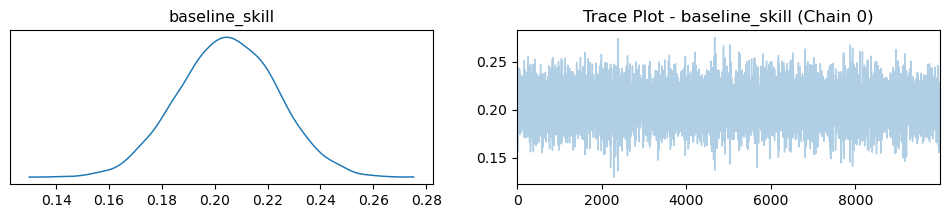

<Figure size 1000x400 with 0 Axes>

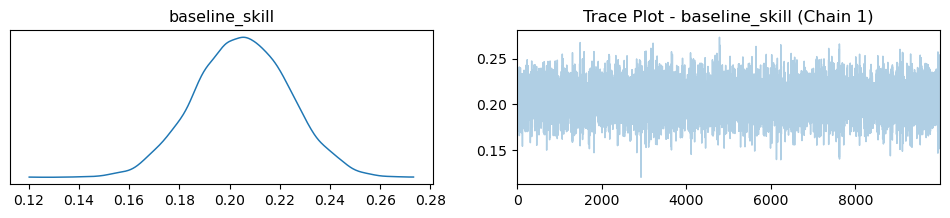

<Figure size 1000x400 with 0 Axes>

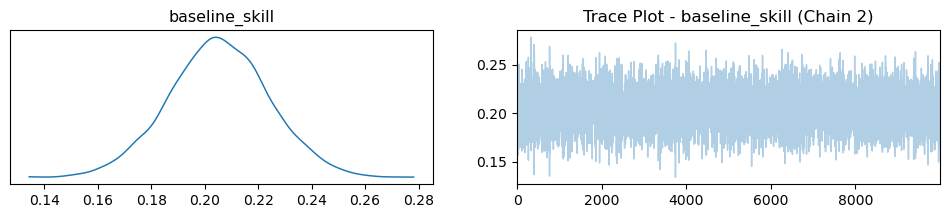

<Figure size 1000x400 with 0 Axes>

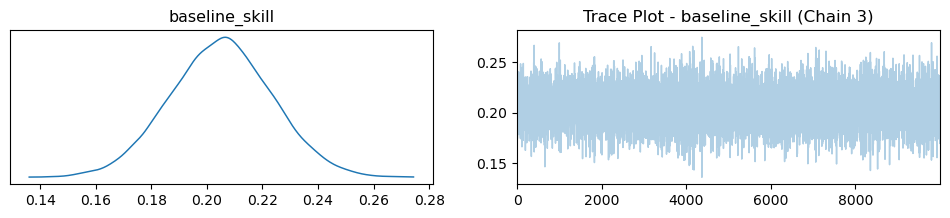

<Figure size 1000x400 with 0 Axes>

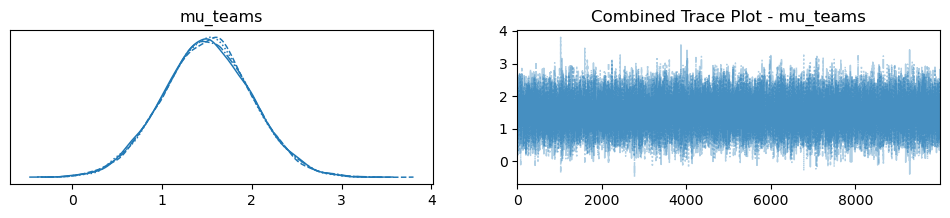

<Figure size 1000x400 with 0 Axes>

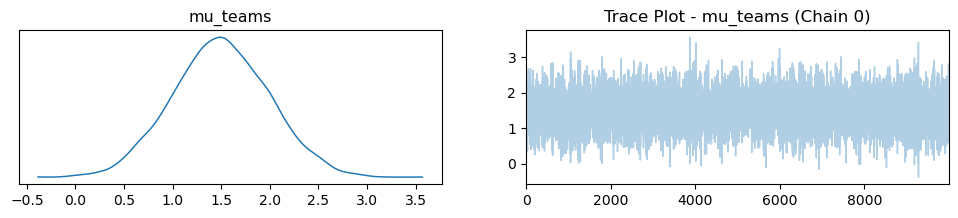

<Figure size 1000x400 with 0 Axes>

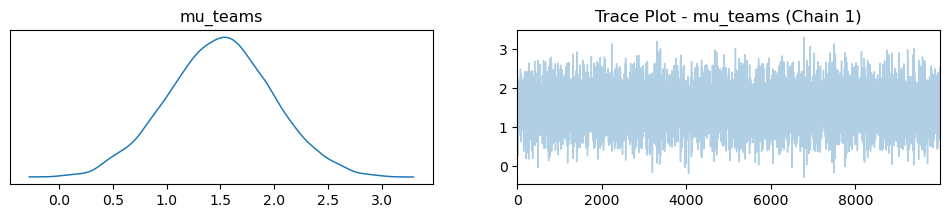

<Figure size 1000x400 with 0 Axes>

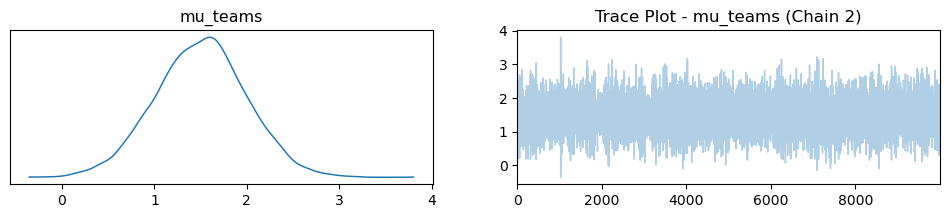

<Figure size 1000x400 with 0 Axes>

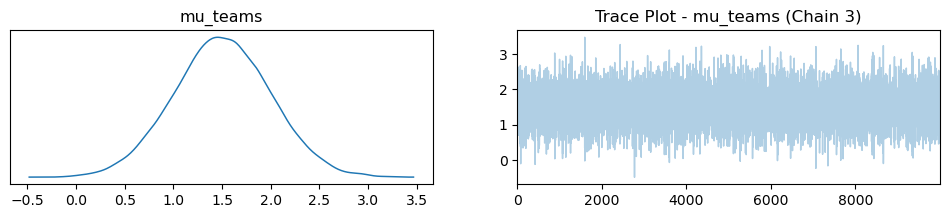

<Figure size 1000x400 with 0 Axes>

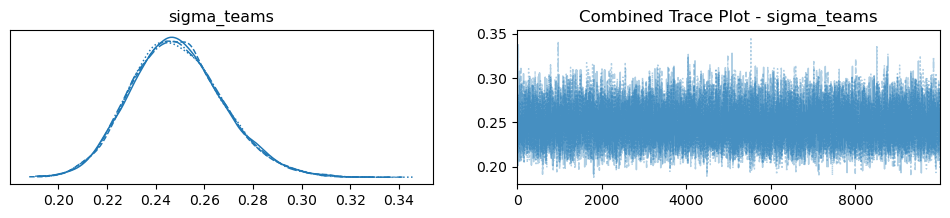

<Figure size 1000x400 with 0 Axes>

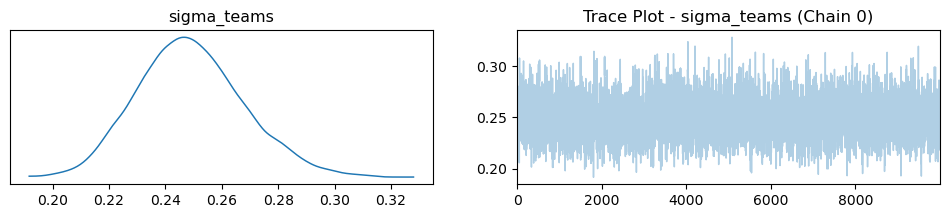

<Figure size 1000x400 with 0 Axes>

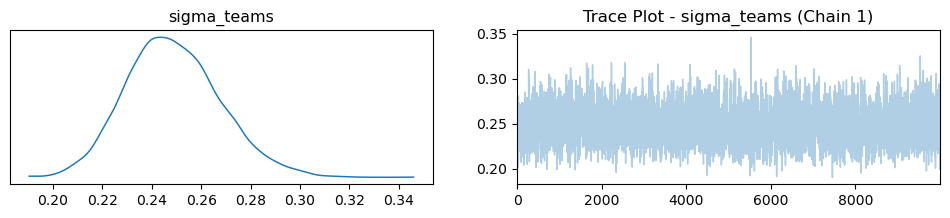

<Figure size 1000x400 with 0 Axes>

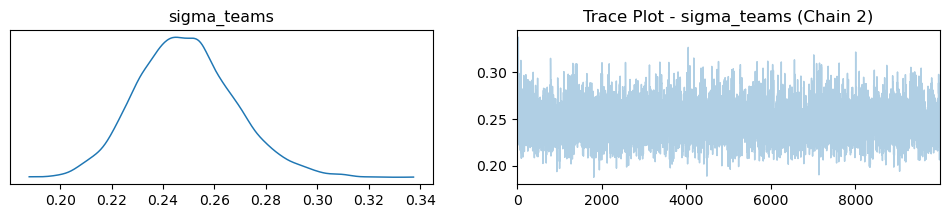

<Figure size 1000x400 with 0 Axes>

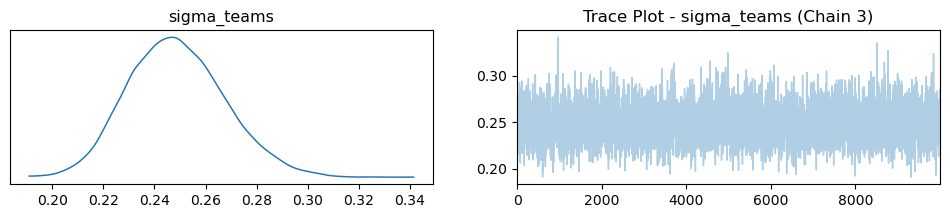

In [74]:
plot_trace_combined(trace_info_time_dep_non_centered_model, 'team_skills')
plot_trace_by_chain(trace_info_time_dep_non_centered_model, 'team_skills')
plot_trace_combined(trace_info_time_dep_non_centered_model, 'baseline_skill')
plot_trace_by_chain(trace_info_time_dep_non_centered_model, 'baseline_skill')
plot_trace_combined(trace_info_time_dep_non_centered_model, 'mu_teams')
plot_trace_by_chain(trace_info_time_dep_non_centered_model, 'mu_teams')
plot_trace_combined(trace_info_time_dep_non_centered_model, 'sigma_teams')
plot_trace_by_chain(trace_info_time_dep_non_centered_model, 'sigma_teams')

In [80]:
# save trace plots for all parameters
save_arviz_plots(trace_info_time_dep_non_centered_model, parameters=['team_skills', 'baseline_skill', 'home_advantage', 'mu_teams', 'sigma_teams'])

#### 1.3 Summary Statistics of Model Parameters

In [75]:
summarize_model(trace_info_time_dep_non_centered_model, "team_skills")

,mean,sd,hdi_3%,hdi_97%,mcse_mean,mcse_sd,ess_bulk,ess_tail,r_hat
"team_skills[0, 0]",1.586,0.506,0.620,2.528,0.002,0.001,65510.0,29513.0,1.0
"team_skills[0, 1]",1.392,0.507,0.422,2.334,0.002,0.002,66066.0,29878.0,1.0
"team_skills[0, 2]",1.140,0.505,0.176,2.080,0.002,0.002,65194.0,28817.0,1.0
"team_skills[0, 3]",1.089,0.505,0.125,2.028,0.002,0.002,65191.0,29598.0,1.0
"team_skills[0, 4]",1.453,0.506,0.509,2.417,0.002,0.002,65423.0,29486.0,1.0
...,...,...,...,...,...,...,...,...,...
"team_skills[5, 23]",1.498,0.556,0.429,2.524,0.002,0.002,67901.0,29391.0,1.0
"team_skills[5, 24]",1.498,0.551,0.444,2.514,0.002,0.002,67258.0,28511.0,1.0
"team_skills[5, 25]",1.429,0.506,0.477,2.378,0.002,0.002,65049.0,29112.0,1.0
"team_skills[5, 26]",1.360,0.506,0.424,2.331,0.002,0.002,65328.0,29181.0,1.0


In [76]:
summarize_model(trace_info_time_dep_non_centered_model, "baseline_skill")

,mean,sd,hdi_3%,hdi_97%,mcse_mean,mcse_sd,ess_bulk,ess_tail,r_hat
baseline_skill,0.205,0.019,0.17,0.24,0.0,0.0,65053.0,27731.0,1.0


In [77]:
summarize_model(trace_info_time_dep_non_centered_model, "home_advantage")

,mean,sd,hdi_3%,hdi_97%,mcse_mean,mcse_sd,ess_bulk,ess_tail,r_hat
home_advantage,0.384,0.017,0.352,0.416,0.0,0.0,65305.0,28261.0,1.0


In [78]:
summarize_model(trace_info_time_dep_non_centered_model, "mu_teams")

,mean,sd,hdi_3%,hdi_97%,mcse_mean,mcse_sd,ess_bulk,ess_tail,r_hat
mu_teams,1.499,0.496,0.559,2.426,0.002,0.001,68762.0,28573.0,1.0


In [79]:
summarize_model(trace_info_time_dep_non_centered_model, "sigma_teams")

,mean,sd,hdi_3%,hdi_97%,mcse_mean,mcse_sd,ess_bulk,ess_tail,r_hat
sigma_teams,0.249,0.019,0.214,0.285,0.0,0.0,12159.0,16765.0,1.0


#### 1.4 Posterior Predictive Checks (PPC) and Other Metrics

Sampling: [away_goals_observed, home_goals_observed]


Output()

PPC plot saved as 'ppc_time_dep_informative_non_centered_model.png'


<Figure size 1200x600 with 0 Axes>

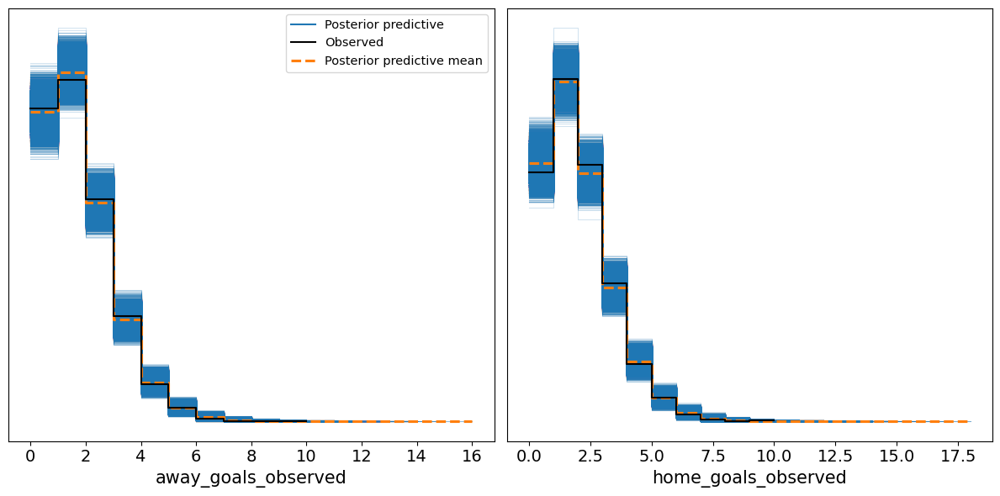

In [84]:
ppc_time_dep_informative_non_centered_model =save_ppc_plot(model_info_time_dep_non_centered_model,
                                                            trace_info_time_dep_non_centered_model, "ppc_time_dep_informative_non_centered_model.png")



#### 1.5 Model Comparison Metrics (LOO and WAIC)

In [83]:
gc.collect()

0

In [89]:
metrics = calculate_model_comparison_metrics(trace_info_time_dep_non_centered_model)

/Users/bymatchi/opt/anaconda3/envs/thesis/lib/python3.12/site-packages/arviz/stats/stats.py:1632: UserWarning: For one or more samples the posterior variance of the log predictive densities exceeds 0.4. This could be indication of WAIC starting to fail. 
See http://arxiv.org/abs/1507.04544 for details
  warnings.warn(


home_goals_observed - LOO: 
 Computed from 40000 posterior samples and 2280 observations log-likelihood matrix.

             Estimate       SE
deviance_loo  6934.57    63.45
p_loo           51.82        -
------

Pareto k diagnostic values:
                         Count   Pct.
(-Inf, 0.5]   (good)     2280  100.0%
 (0.5, 0.7]   (ok)          0    0.0%
   (0.7, 1]   (bad)         0    0.0%
   (1, Inf)   (very bad)    0    0.0%

home_goals_observed - WAIC: 
 Computed from 40000 posterior samples and 2280 observations log-likelihood matrix.

              Estimate       SE
deviance_waic  6934.48    63.45
p_waic           51.78        -

There has been a warning during the calculation. Please check the results.
away_goals_observed - LOO: 
 Computed from 40000 posterior samples and 2280 observations log-likelihood matrix.

             Estimate       SE
deviance_loo  6546.93    67.55
p_loo           45.94        -
------

Pareto k diagnostic values:
                         Count   Pct.
(

/Users/bymatchi/opt/anaconda3/envs/thesis/lib/python3.12/site-packages/arviz/stats/stats.py:1632: UserWarning: For one or more samples the posterior variance of the log predictive densities exceeds 0.4. This could be indication of WAIC starting to fail. 
See http://arxiv.org/abs/1507.04544 for details
  warnings.warn(


#### 1.6 Calculating error metrics (MAE and RMSE)

In [86]:
# Home teams goals
home_mae, home_rmse = calculate_errors(ppc_time_dep_informative_non_centered_model, df_18_24, 'Home_Goals', 'home_goals_observed')

# Away Teams  goals
away_mae, away_rmse = calculate_errors(ppc_time_dep_informative_non_centered_model, df_18_24, 'Away_Goals', 'away_goals_observed')

Home_Goals - MAE: 0.9397708662280703, RMSE: 1.1970355721699735
Away_Goals - MAE: 0.8861181140350878, RMSE: 1.1278955347010045


#### 1.7 Roc- Auc

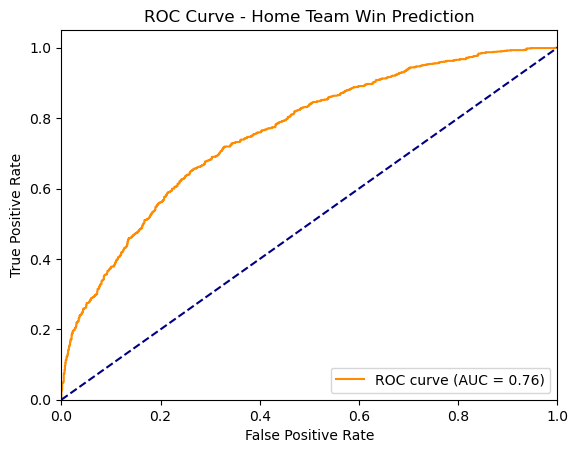

ROC AUC Value: 0.7581522056345766


In [85]:
roc_auc = calculate_and_plot_roc_auc_from_ppc(ppc_time_dep_informative_non_centered_model, df_18_24)
print(f"ROC AUC Value: {roc_auc}")

#### 1.8 Energy Plot

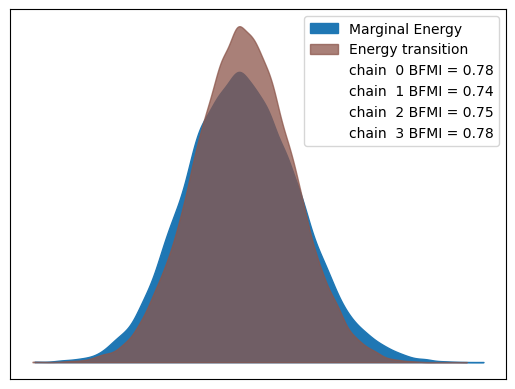

In [ ]:
plot_energy(trace_info_time_dep_non_centered_model)

#### 1.9 Shape of the main Parameters

In [ ]:
print_posterior_shapes(trace_info_time_dep_non_centered_model)

team_skills shape: (4, 10000, 6, 28)
baseline_skill shape: (4, 10000)


Plot saved as info_time_dep_non_centered_team_skill.png in the current working directory.


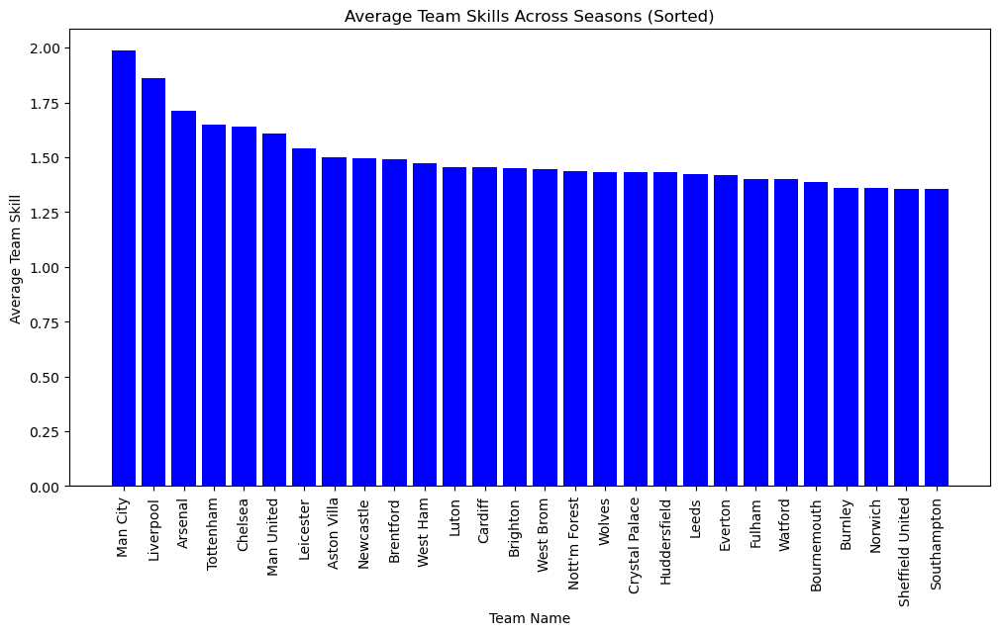

In [99]:
visualize_team_skills_time_dependent(df_18_24, trace_info_time_dep_non_centered_model, filename="info_time_dep_non_centered_team_skill.png")

Plot for Season 1 saved as info_time_dep_non_centered_season_skills_season_1.png in the current working directory.


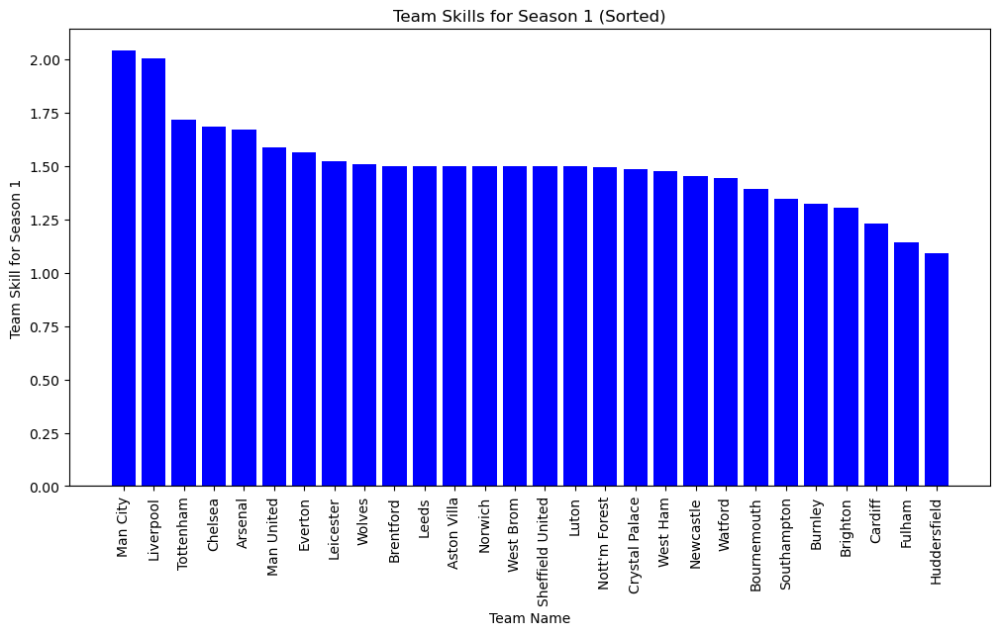

Plot for Season 2 saved as info_time_dep_non_centered_season_skills_season_2.png in the current working directory.


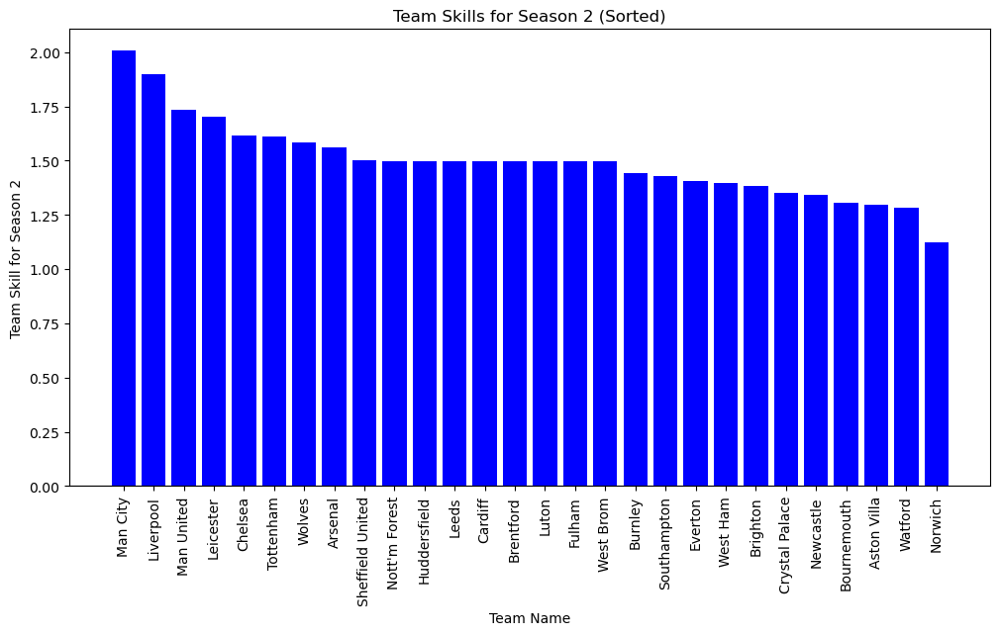

Plot for Season 3 saved as info_time_dep_non_centered_season_skills_season_3.png in the current working directory.


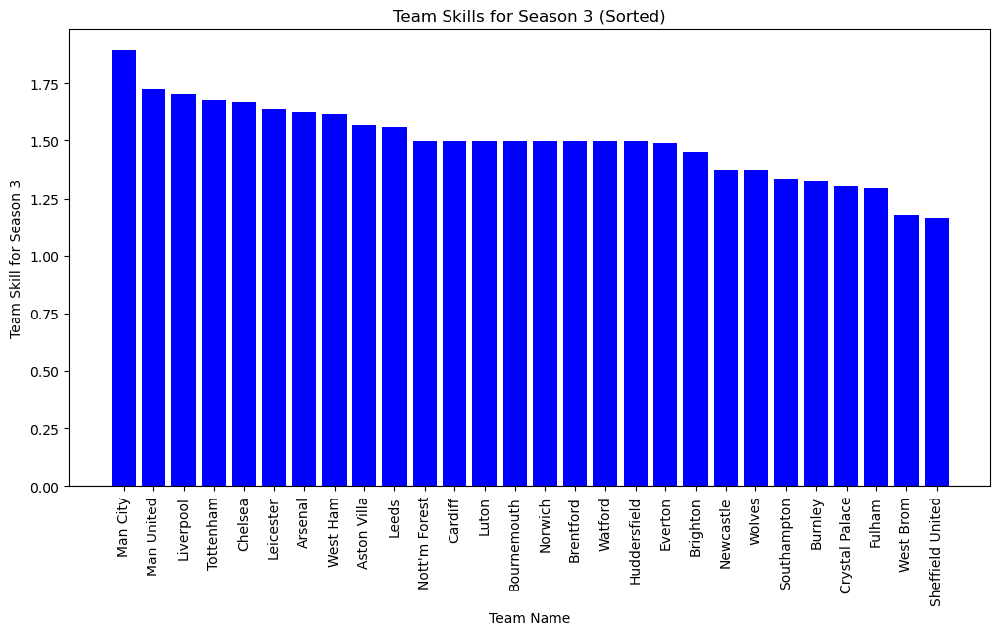

Plot for Season 4 saved as info_time_dep_non_centered_season_skills_season_4.png in the current working directory.


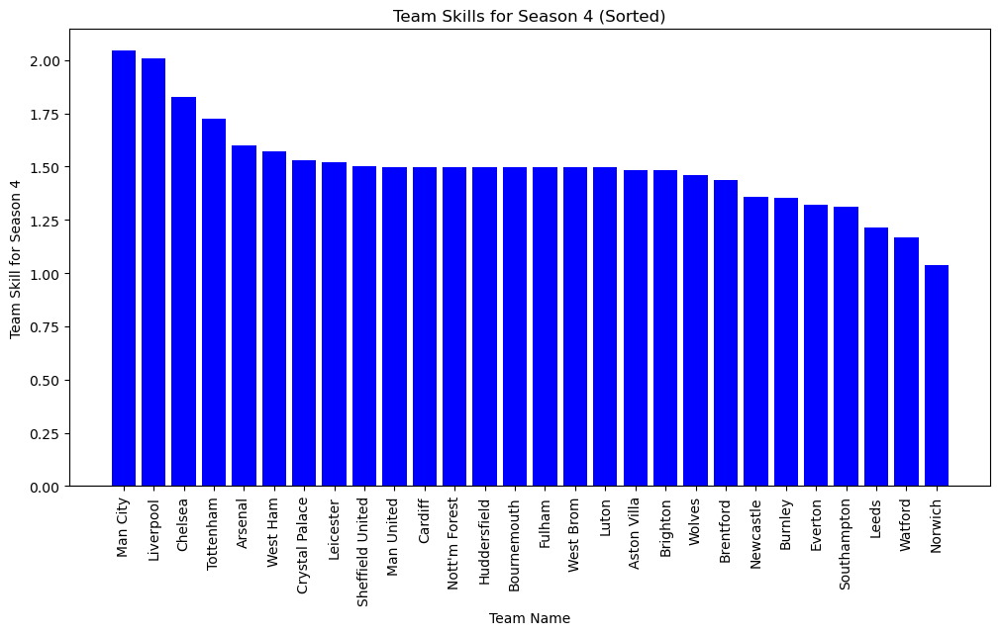

Plot for Season 5 saved as info_time_dep_non_centered_season_skills_season_5.png in the current working directory.


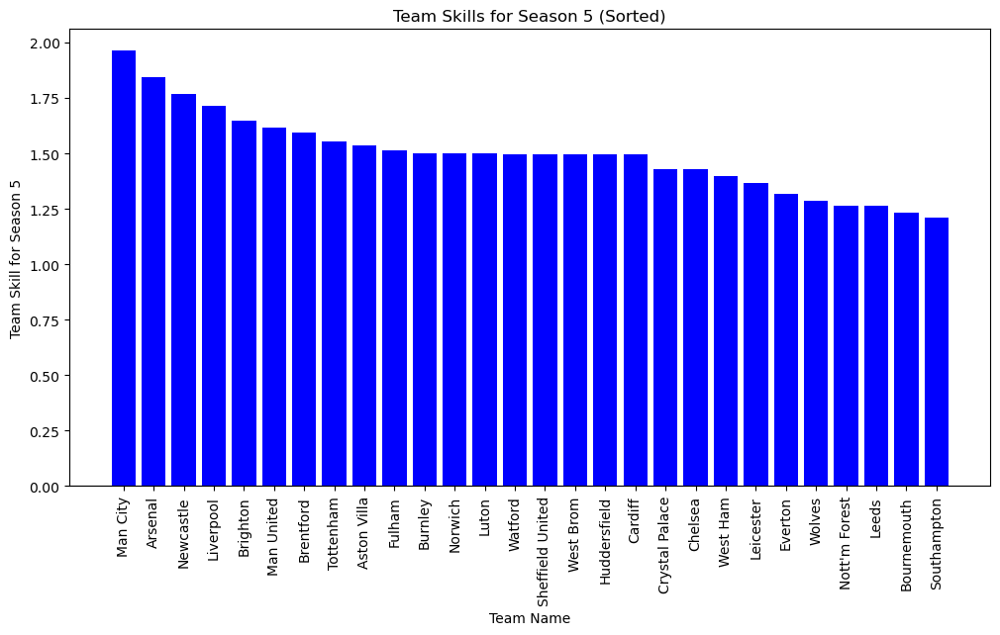

Plot for Season 6 saved as info_time_dep_non_centered_season_skills_season_6.png in the current working directory.


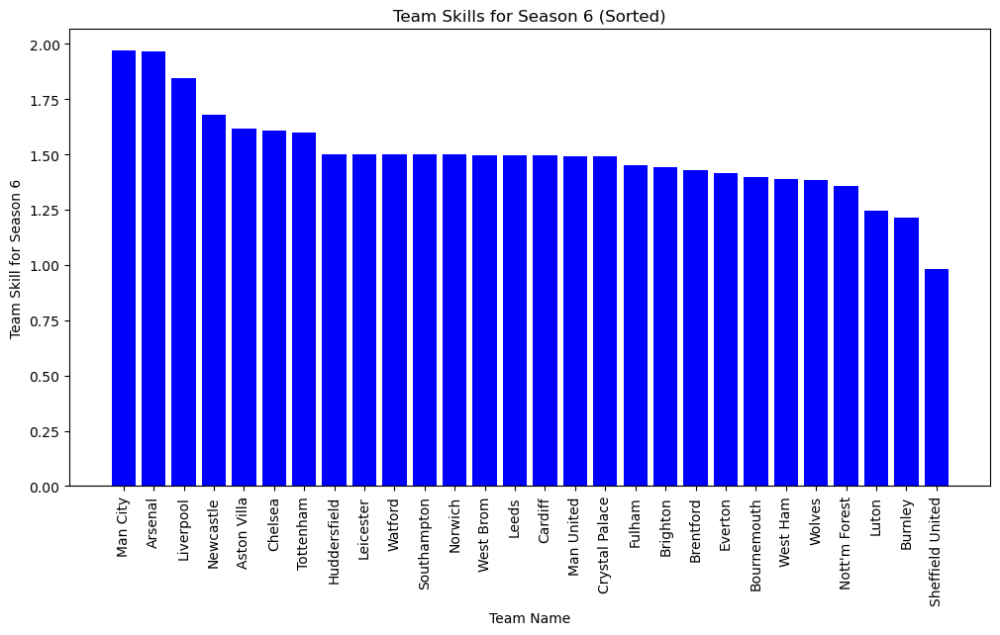

In [113]:
# visualizing team skills for each season
visualize_team_skills_seasonal(df_18_24, trace_info_time_dep_non_centered_model, filename_prefix="info_time_dep_non_centered_season_skills")

## Comparing Time Dependent Models

/Users/bymatchi/opt/anaconda3/envs/thesis/lib/python3.12/site-packages/arviz/stats/stats.py:1024: RuntimeWarning: overflow encountered in exp
  weights = 1 / np.exp(len_scale - len_scale[:, None]).sum(axis=1)
/Users/bymatchi/opt/anaconda3/envs/thesis/lib/python3.12/site-packages/numpy/core/_methods.py:49: RuntimeWarning: overflow encountered in reduce
  return umr_sum(a, axis, dtype, out, keepdims, initial, where)
/Users/bymatchi/opt/anaconda3/envs/thesis/lib/python3.12/site-packages/arviz/stats/stats.py:789: UserWarning: Estimated shape parameter of Pareto distribution is greater than 0.7 for one or more samples. You should consider using a more robust model, this is because importance sampling is less likely to work well if the marginal posterior and LOO posterior are very different. This is more likely to happen with a non-robust model and highly influential observations.
  warnings.warn(
/Users/bymatchi/opt/anaconda3/envs/thesis/lib/python3.12/site-packages/arviz/stats/stats.py:102

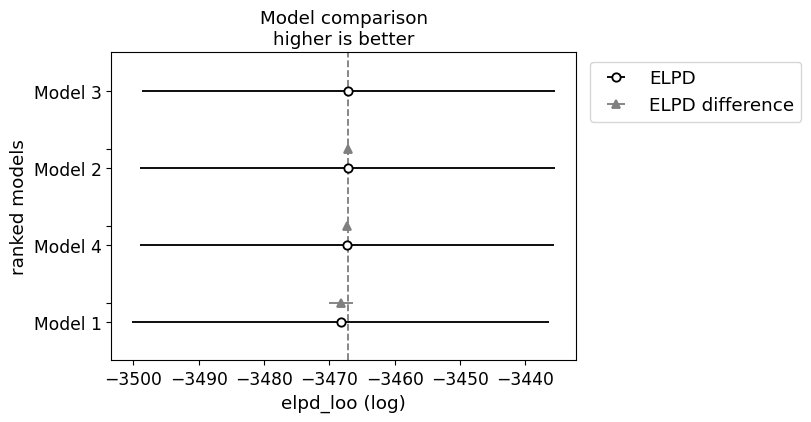

/Users/bymatchi/opt/anaconda3/envs/thesis/lib/python3.12/site-packages/arviz/stats/stats.py:1024: RuntimeWarning: overflow encountered in exp
  weights = 1 / np.exp(len_scale - len_scale[:, None]).sum(axis=1)
/Users/bymatchi/opt/anaconda3/envs/thesis/lib/python3.12/site-packages/numpy/core/_methods.py:49: RuntimeWarning: overflow encountered in reduce
  return umr_sum(a, axis, dtype, out, keepdims, initial, where)
/Users/bymatchi/opt/anaconda3/envs/thesis/lib/python3.12/site-packages/arviz/stats/stats.py:789: UserWarning: Estimated shape parameter of Pareto distribution is greater than 0.7 for one or more samples. You should consider using a more robust model, this is because importance sampling is less likely to work well if the marginal posterior and LOO posterior are very different. This is more likely to happen with a non-robust model and highly influential observations.
  warnings.warn(
/Users/bymatchi/opt/anaconda3/envs/thesis/lib/python3.12/site-packages/arviz/stats/stats.py:102

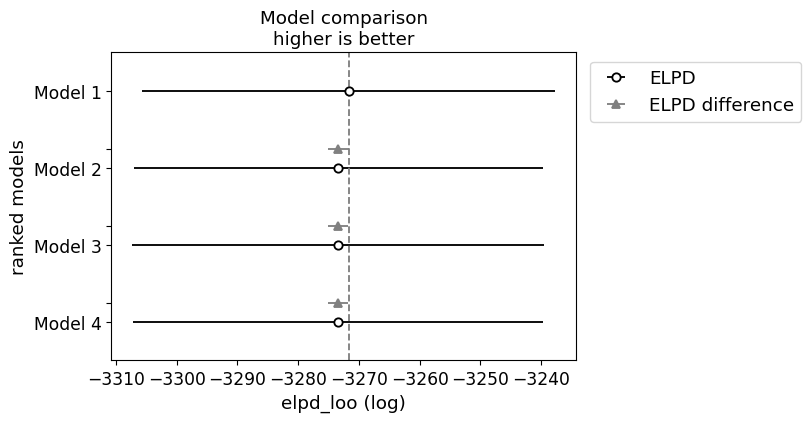

In [91]:
model_traces_for_time_dependent_models = {
    "Model 1": trace_time_dependent,
    "Model 2": trace_informative_time_dependent_model,
    "Model 3": trace_time_dep_non_centered,
     "Model 4": trace_info_time_dep_non_centered_model
     
}
# Home Goals
comparison_home_for_time_dependent_models = az.compare(model_traces_for_time_dependent_models, ic="loo", var_name="home_goals_observed")
az.plot_compare(comparison_home_for_time_dependent_models)

plt.savefig("time_dependent__models_comparison_home_goals.png", dpi=300, bbox_inches="tight") 
plt.show()  
plt.close() 
# Away Goals 
comparison_away_for_time_dependent_models = az.compare(model_traces_for_time_dependent_models, ic="loo", var_name="away_goals_observed")
az.plot_compare(comparison_away_for_time_dependent_models)

plt.savefig("time_dependent__models_comparison_away_goals.png", dpi=300, bbox_inches="tight")  
plt.show()
plt.close()



In [92]:
comparison_home_for_time_dependent_models

,rank,elpd_loo,p_loo,elpd_diff,weight,se,dse,warning,scale
Model 3,0,-3467.080267,51.662652,0.000000,8.624118e-01,31.624137,0.000000,False,log
Model 2,1,-3467.203403,51.694292,0.123135,1.444264e-15,31.744200,0.205690,False,log
Model 4,2,-3467.287482,51.823314,0.207214,0.000000e+00,31.726827,0.149091,False,log
Model 1,3,-3468.255114,49.723400,1.174847,1.375882e-01,31.910985,1.809914,True,log


In [93]:
comparison_away_for_time_dependent_models

,rank,elpd_loo,p_loo,elpd_diff,weight,se,dse,warning,scale
Model 1,0,-3271.686996,44.159247,0.000000,1.000000e+00,33.980820,0.000000,True,log
Model 2,1,-3273.403038,45.924772,1.716042,5.551115e-17,33.676280,1.707398,False,log
Model 3,2,-3273.412666,45.877884,1.725670,0.000000e+00,33.904945,1.684120,False,log
Model 4,3,-3273.463890,45.943429,1.776894,3.108624e-15,33.772719,1.685637,False,log


# Model Comperison for Seleceted Models.

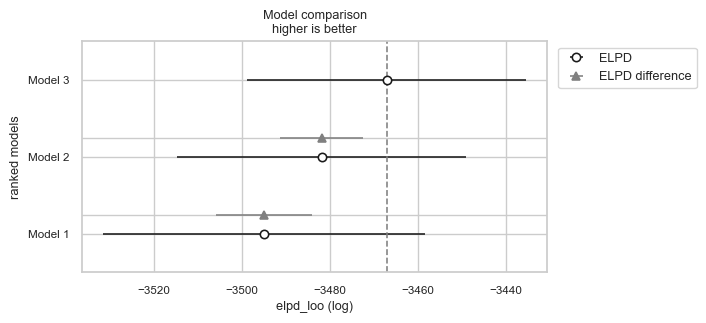

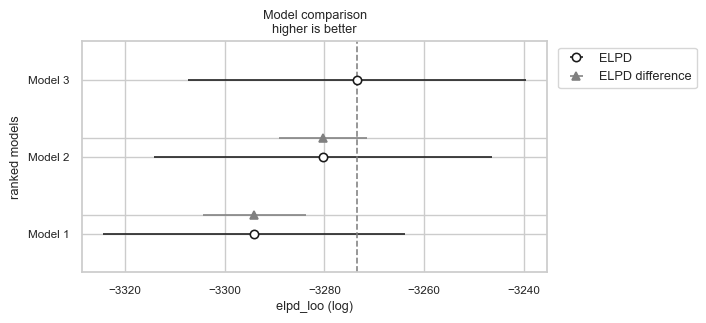

In [43]:
model_traces_for_the_best_one= {
    "Model 1": trace_base_non_centered,
    "Model 2": trace_home_adv_non_centered,
    "Model 3": trace_time_dep_non_centered,
    
     
}
# Home Goals
comparison_home_for_the_best = az.compare(model_traces_for_the_best_one, ic="loo", var_name="home_goals_observed")
az.plot_compare(comparison_home_for_the_best)

plt.savefig("time_dependent__models_comparison_home_goals.png", dpi=300, bbox_inches="tight") 
plt.show()  
plt.close() 
# Away Goals 
comparison_away_for_the_best = az.compare(model_traces_for_the_best_one, ic="loo", var_name="away_goals_observed")
az.plot_compare(comparison_away_for_the_best)

plt.savefig("time_dependent__models_comparison_away_goals.png", dpi=300, bbox_inches="tight")  
plt.show()
plt.close()

In [44]:
comparison_home_for_the_best

,rank,elpd_loo,p_loo,elpd_diff,weight,se,dse,warning,scale
Model 3,0,-3467.116845,51.696026,0.000000,0.669841,31.627762,0.000000,False,log
Model 2,1,-3481.926385,14.256178,14.809539,0.330159,32.736816,9.359601,False,log
Model 1,2,-3494.963471,13.959652,27.846626,0.000000,36.491874,10.843984,False,log


In [45]:
comparison_away_for_the_best

,rank,elpd_loo,p_loo,elpd_diff,weight,se,dse,warning,scale
Model 3,0,-3273.417408,45.911883,0.000000,0.587007,33.908153,0.000000,False,log
Model 2,1,-3280.271851,13.261623,6.854443,0.367292,33.979152,8.849549,False,log
Model 1,2,-3294.073216,12.869734,20.655808,0.045701,30.280248,10.368796,False,log


# Predictions and Use Cases


## Visualize Team Skills

### 1.1 Visualize Base Model

In [57]:
def visualize_team_skills(df, trace):
    """
    Visualizes team skills using team IDs and names, sorted from strongest to weakest.
    
    Parameters:
    - df: Pandas DataFrame containing the match data with team names and IDs.
    - trace: ArviZ trace object containing the team skills.
    
    Returns:
    - None (displays a sorted bar plot of team skills).
    """
    # Get the summary statistics for team skills from the trace
    summary_df = az.summary(trace, var_names=["team_skills"], fmt="wide")
    
    # Extract team IDs from the summary DataFrame's index
    team_ids = [int(col.split('[')[-1].strip(']')) for col in summary_df.index]
    
    # Create a mapping from team IDs to team names using the input DataFrame
    team_id_to_name = dict(zip(df['Home_Team_ID'], df['Home_Team']))
    
    # Map team IDs to names and extract the corresponding skill values
    team_names = [team_id_to_name[team_id] for team_id in team_ids]
    team_skills = summary_df['mean'].values
    
    # Sort teams by their skills
    sorted_indices = np.argsort(team_skills)[::-1]  # Sort descending
    sorted_team_names = np.array(team_names)[sorted_indices]
    sorted_team_skills = team_skills[sorted_indices]
    
    # Color coding for positive and negative skills
    colors = ['red' if skill < 0 else 'blue' for skill in sorted_team_skills]
    
    # Create the bar plot
    plt.figure(figsize=(12, 6))
    plt.bar(sorted_team_names, sorted_team_skills, color=colors)
    plt.xlabel('Team Name')
    plt.ylabel('Team Skill')
    plt.title('Team Skills (Sorted)')
    plt.xticks(rotation=90)
    plt.axhline(0, color='black', linewidth=0.8)  # Add a horizontal line at y=0
    plt.show()


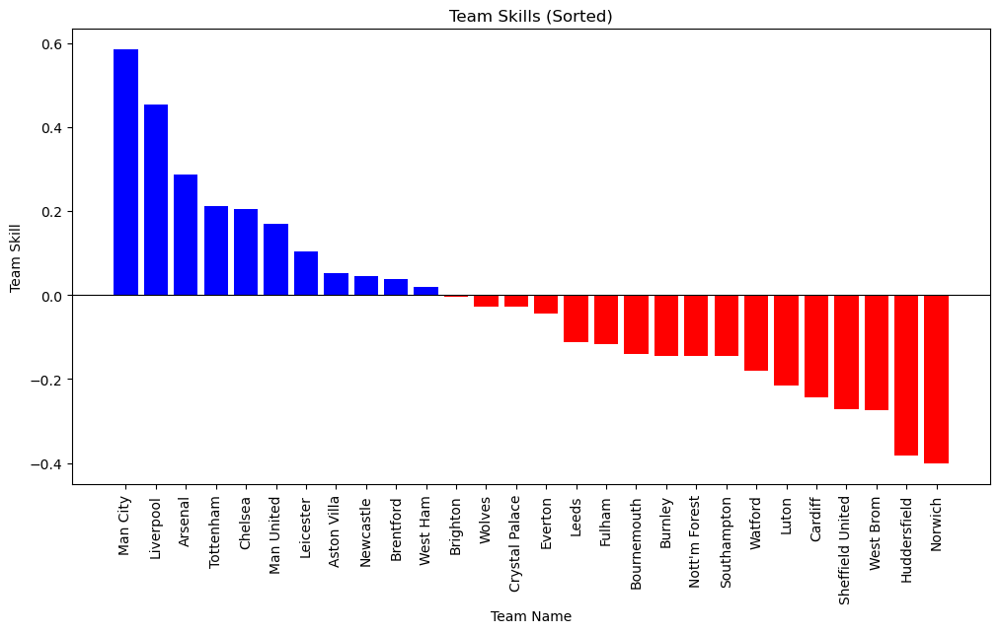

In [58]:
visualize_team_skills(df_18_24, trace_base_non_centered)

### 1.2 Home Advantage Model

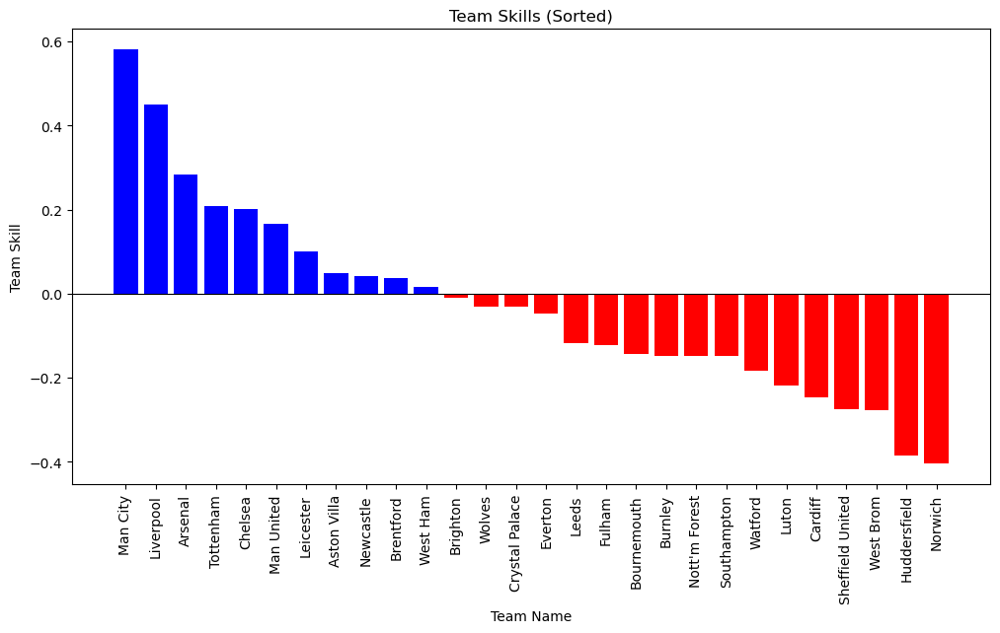

In [ ]:
visualize_team_skills(df_18_24, trace_home_adv_non_centered)    

### 1.3 Time Dependent Model  Visualization

In [ ]:
def visualize_team_skills_seasonal(df, trace, num_seasons=6):
    """
    Visualizes team skills for each season, highlighting positive and negative skills with different colors.
    
    Parameters:
    - df: Pandas DataFrame containing the match data with team names and IDs.
    - trace: ArviZ trace object containing the team skills.
    - num_seasons: Number of seasons to visualize (default is 6).
    
    Returns:
    - None (displays bar plots for each season).
    """
    # Extract the mean of team skills from the trace for each season and team
    team_skills_array = trace.posterior['team_skills'].mean(dim=("chain", "draw")).values

    # Compute the number of unique teams
    n_teams = team_skills_array.shape[1]  # Second dimension corresponds to the number of teams
    
    # Create a mapping from team IDs to team names using the input DataFrame
    unique_team_ids = np.unique(df['Home_Team_ID'])
    team_id_to_name = dict(zip(unique_team_ids, df['Home_Team'].unique()))

    # Iterate through each season and create a bar plot
    for season in range(min(num_seasons, team_skills_array.shape[0])):
        # Extract skills for the current season
        team_skills = team_skills_array[season]
        
        # Map team IDs to names and extract corresponding skill values
        team_names = [team_id_to_name[team_id] for team_id in range(n_teams)]
        
        # Sort teams by their skills
        sorted_indices = np.argsort(team_skills)[::-1]  # Sort descending
        sorted_team_names = np.array(team_names)[sorted_indices]
        sorted_team_skills = team_skills[sorted_indices]
        
        # Color coding for positive and negative skills
        colors = ['blue' if skill >= 0 else 'red' for skill in sorted_team_skills]
        
        # Create the bar plot
        plt.figure(figsize=(12, 6))
        plt.bar(sorted_team_names, sorted_team_skills, color=colors)
        plt.xlabel('Team Name')
        plt.ylabel('Team Skill for Season {}'.format(season + 1))
        plt.title(f'Team Skills for Season {season + 1} (Sorted)')
        plt.xticks(rotation=90)
        plt.axhline(0, color='black', linewidth=0.8)  # Add a horizontal line at y=0
        plt.show()

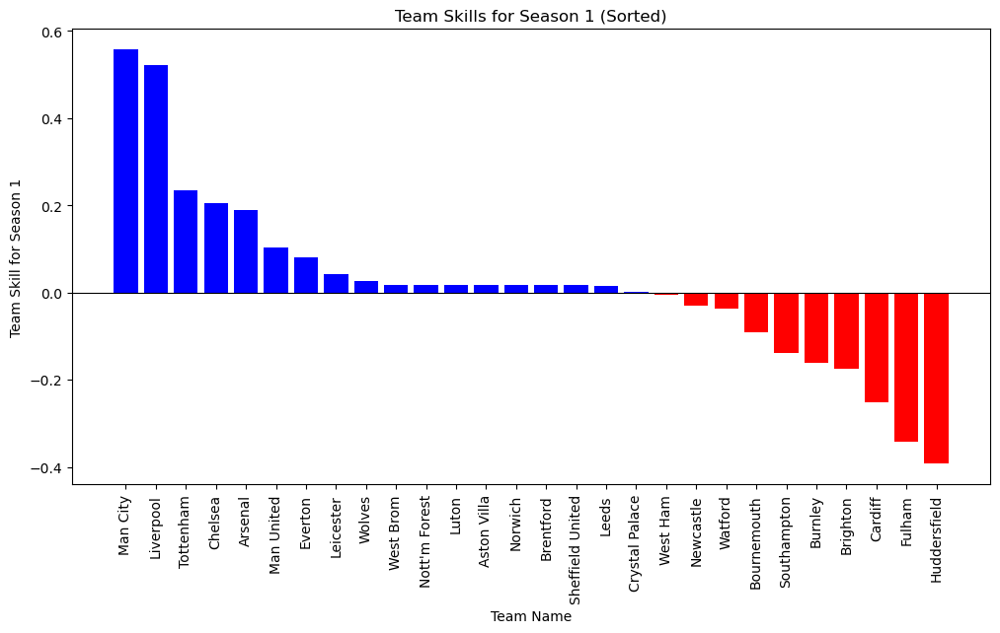

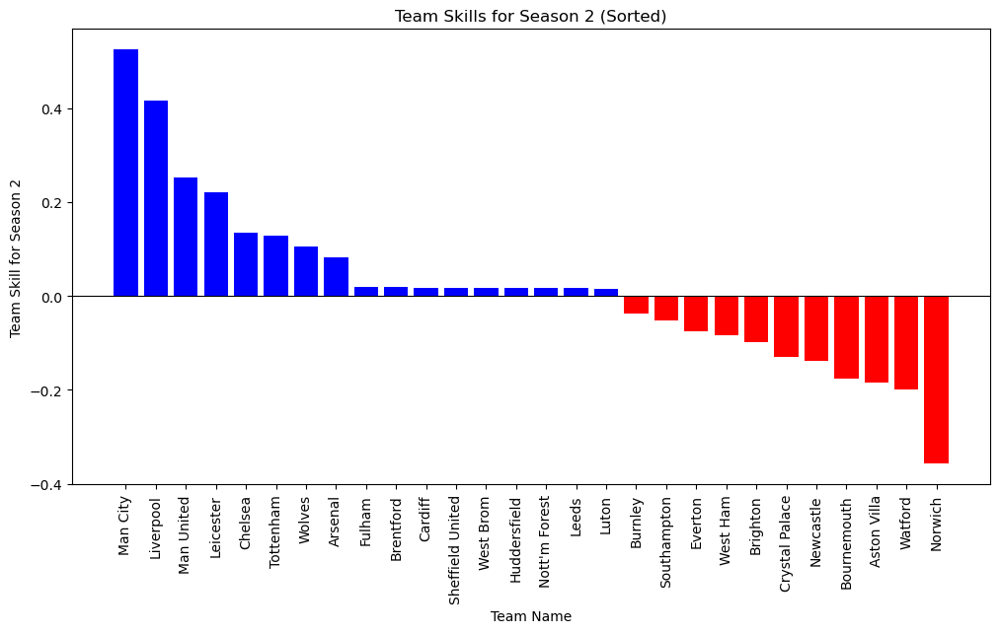

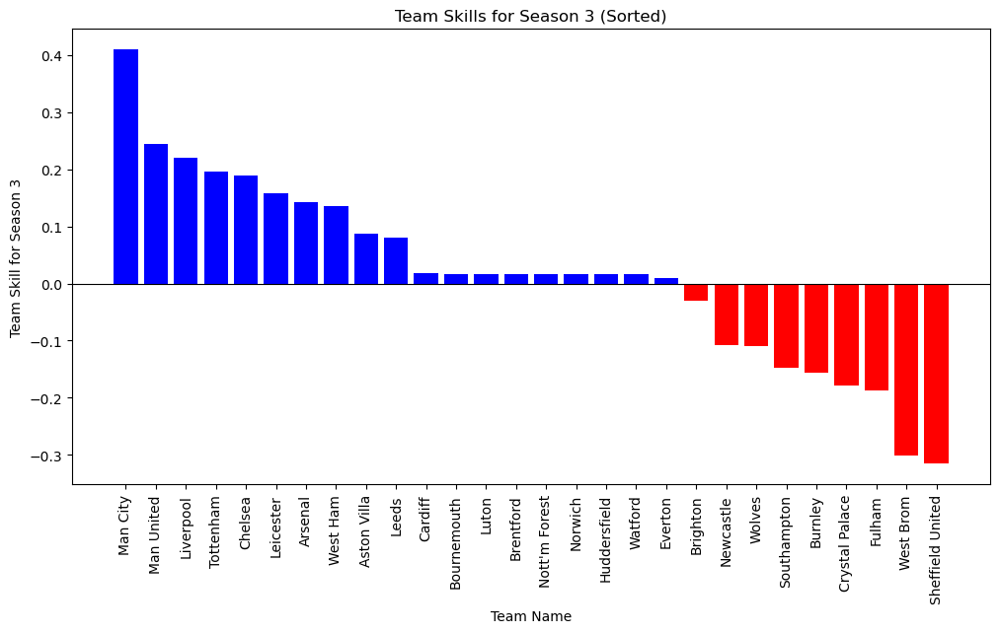

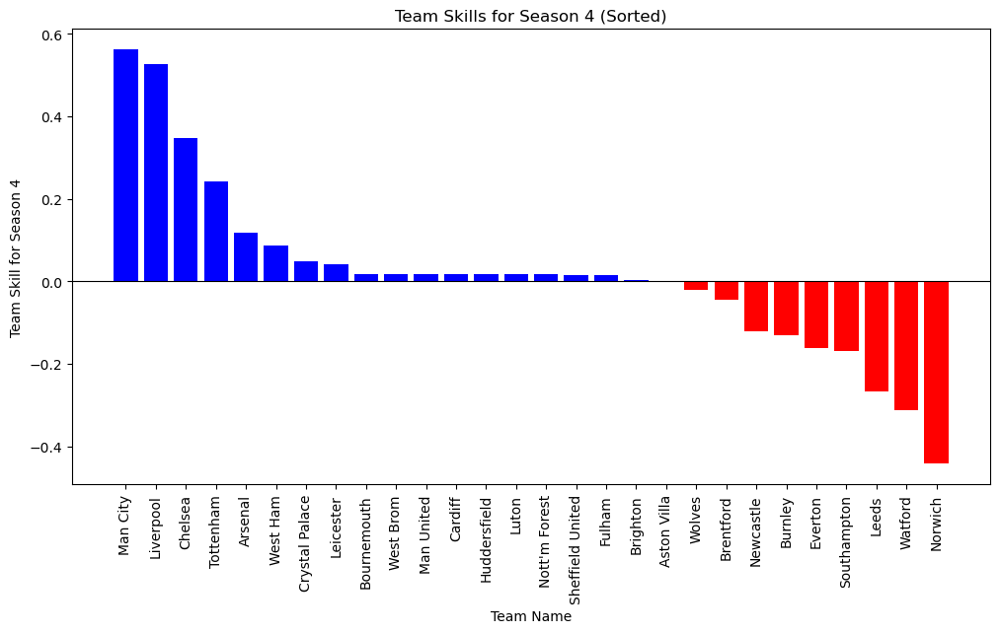

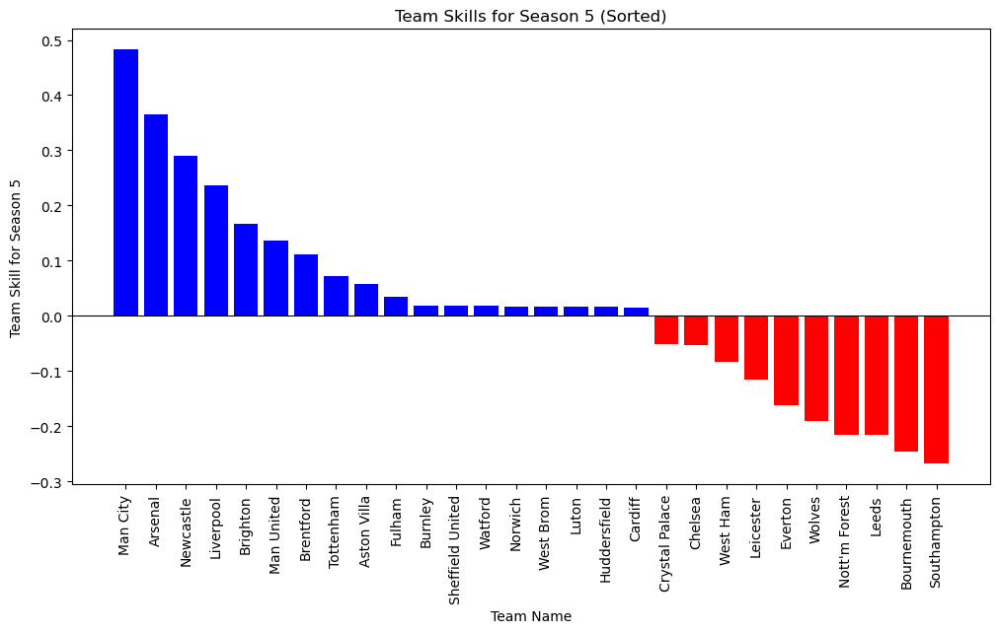

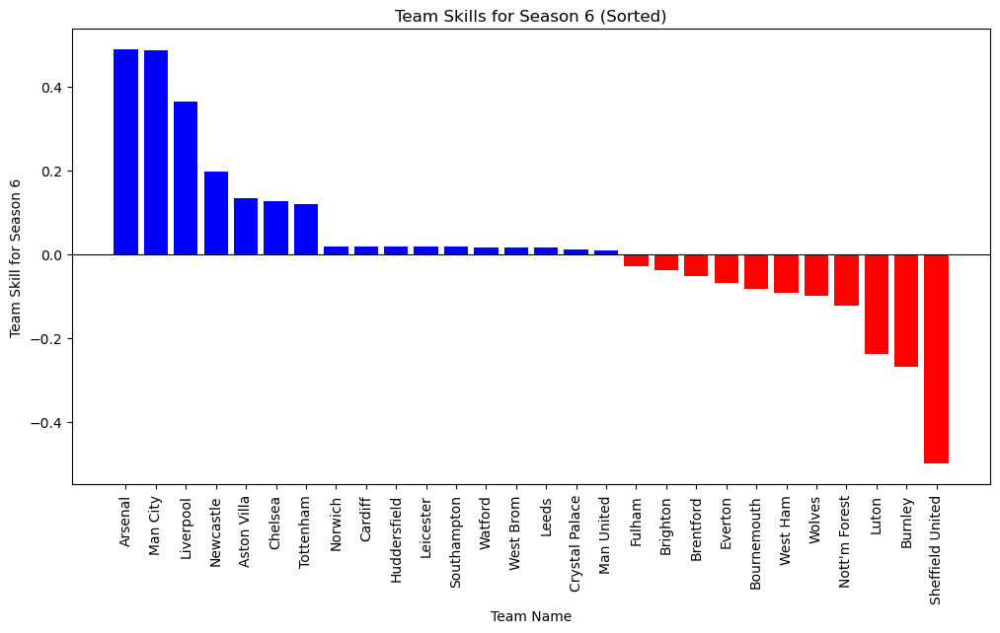

In [ ]:
visualize_team_skills_seasonal(df_18_24, trace_time_dep_non_centered)

In [ ]:
def visualize_average_team_skills(df, trace):
    """
    Visualizes the average team skills across all seasons, highlighting positive and negative skills with different colors.
    
    Parameters:
    - df: Pandas DataFrame containing the match data with team names and IDs.
    - trace: ArviZ trace object containing the team skills.
    
    Returns:
    - None (displays a bar plot of average team skills across all seasons).
    """
    # Extract the mean of team skills across chains and draws for each season and team
    team_skills_array = trace.posterior['team_skills'].mean(dim=("chain", "draw")).values

    # Compute the average skills across all seasons
    average_team_skills = team_skills_array.mean(axis=0)  # Average across the season dimension
    
    # Create a mapping from team IDs to team names using the input DataFrame
    unique_team_ids = np.unique(df['Home_Team_ID'])
    team_id_to_name = dict(zip(unique_team_ids, df['Home_Team'].unique()))
    
    # Map team IDs to names and extract corresponding average skill values
    n_teams = average_team_skills.shape[0]
    team_names = [team_id_to_name[team_id] for team_id in range(n_teams)]
    
    # Sort teams by their average skills
    sorted_indices = np.argsort(average_team_skills)[::-1]  # Sort descending
    sorted_team_names = np.array(team_names)[sorted_indices]
    sorted_average_team_skills = average_team_skills[sorted_indices]
    
    # Color coding for positive and negative skills
    colors = ['blue' if skill >= 0 else 'red' for skill in sorted_average_team_skills]
    
    # Create the bar plot
    plt.figure(figsize=(12, 6))
    plt.bar(sorted_team_names, sorted_average_team_skills, color=colors)
    plt.xlabel('Team Name')
    plt.ylabel('Average Team Skill')
    plt.title('Average Team Skills Across All Seasons (Sorted)')
    plt.xticks(rotation=90)
    plt.axhline(0, color='black', linewidth=0.8)  # Add a horizontal line at y=0
    plt.show()


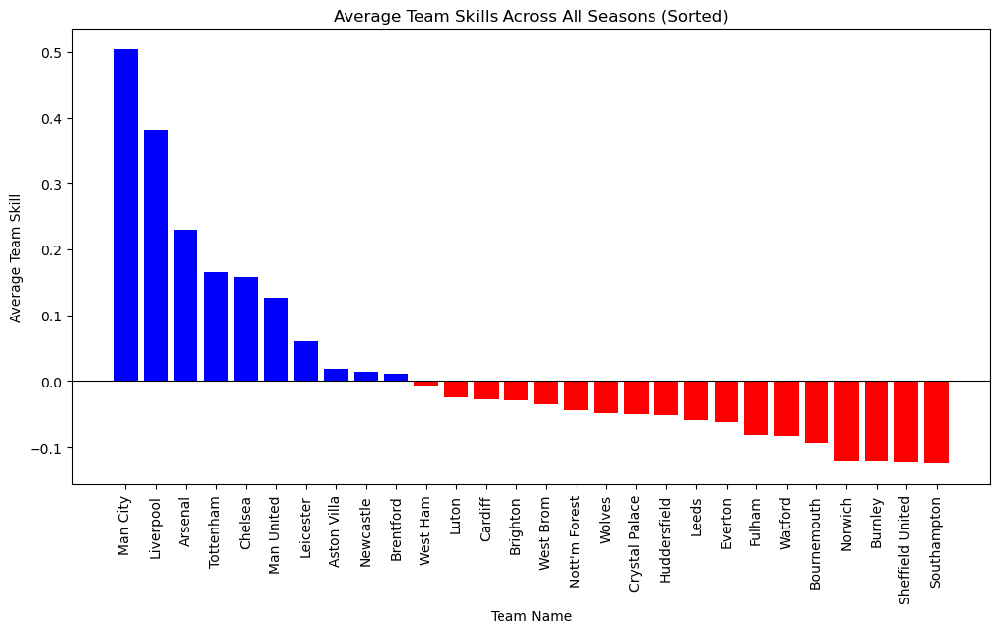

In [ ]:
visualize_average_team_skills(df_18_24, trace_time_dep_non_centered)

In [20]:

def visualize_team_skills_facets(df, trace):
    """
    Visualizes how team skills evolve over multiple seasons using FacetGrid from seaborn.
    
    Parameters:
    - df: Pandas DataFrame with match data containing team names, IDs, and seasons.
    - trace: ArviZ trace object containing the team skills over time.

    Returns:
    - None (displays FacetGrid line plots of team skills across seasons).
    """
    # Extract the mean of team skills for each season and team
    team_skills_array = trace.posterior['team_skills'].mean(dim=("chain", "draw")).values
    n_seasons, n_teams = team_skills_array.shape

    # Create a DataFrame for easier plotting
    season_ids = np.arange(n_seasons)
    team_data = {
        'Season': np.tile(season_ids, n_teams),
        'Team Skill': team_skills_array.flatten(),
        'Team': np.repeat(df['Home_Team'].unique(), n_seasons)
    }
    team_skills_df = pd.DataFrame(team_data)

    # Use seaborn's FacetGrid to create separate plots for each team
    g = sns.FacetGrid(team_skills_df, col="Team", col_wrap=4, height=2, aspect=1.5)
    g.map(sns.lineplot, "Season", "Team Skill", marker="o")
    g.set_titles("{col_name}")
    g.set_axis_labels("Season", "Skill Level")
    plt.xticks(rotation=45)
    plt.tight_layout()
    plt.show()


In [32]:
def visualize_team_skills_facets_save_large(df, trace):
    """
    Visualizes how team skills evolve over multiple seasons using a larger FacetGrid from seaborn and saves the plot.

    Parameters:
    - df: Pandas DataFrame with match data containing team names, IDs, and seasons.
    - trace: ArviZ trace object containing the team skills over time.

    Returns:
    - None (saves the enlarged FacetGrid line plots of team skills across seasons).
    """
    

    # Extract the mean of team skills for each season and team
    team_skills_array = trace.posterior['team_skills'].mean(dim=("chain", "draw")).values
    n_seasons, n_teams = team_skills_array.shape

    # Create a DataFrame for easier plotting
    season_ids = np.arange(n_seasons)
    team_data = {
        'Season': np.tile(season_ids, n_teams),
        'Team Skill': team_skills_array.flatten(),
        'Team': np.repeat(df['Home_Team'].unique(), n_seasons)
    }
    team_skills_df = pd.DataFrame(team_data)

    # Plot using Seaborn's FacetGrid with larger size
    sns.set_theme(style="whitegrid")
    g = sns.FacetGrid(team_skills_df, col="Team", col_wrap=3, height=4, aspect=1.8)  # Boyutlar artırıldı
    g.map_dataframe(sns.lineplot, x="Season", y="Team Skill", marker="o")
    g.set_titles("{col_name}")
    g.set_axis_labels("Season", "Skill Level")
    g.set_xticklabels(rotation=45)
    g.fig.suptitle("Evolution of Team Skills Across Seasons", fontsize=20)
    g.tight_layout()
    plt.subplots_adjust(top=0.92)

    # Save the plot with higher dpi
    output_dir = "figures"
    os.makedirs(output_dir, exist_ok=True)
    plot_filename = os.path.join(output_dir, "large_team_skills_facet_plot.png")
    plt.savefig(plot_filename, dpi=400, bbox_inches="tight")
    plt.close()  # Close the plot to avoid display issues

    # Print the save location
    print(f"Plot successfully saved as: {os.path.abspath(plot_filename)}")


In [33]:
visualize_team_skills_facets_save_large(df_18_24, trace_time_dep_non_centered)

Plot successfully saved as: /Users/bymatchi/Desktop/GitHub/figures/large_team_skills_facet_plot.png


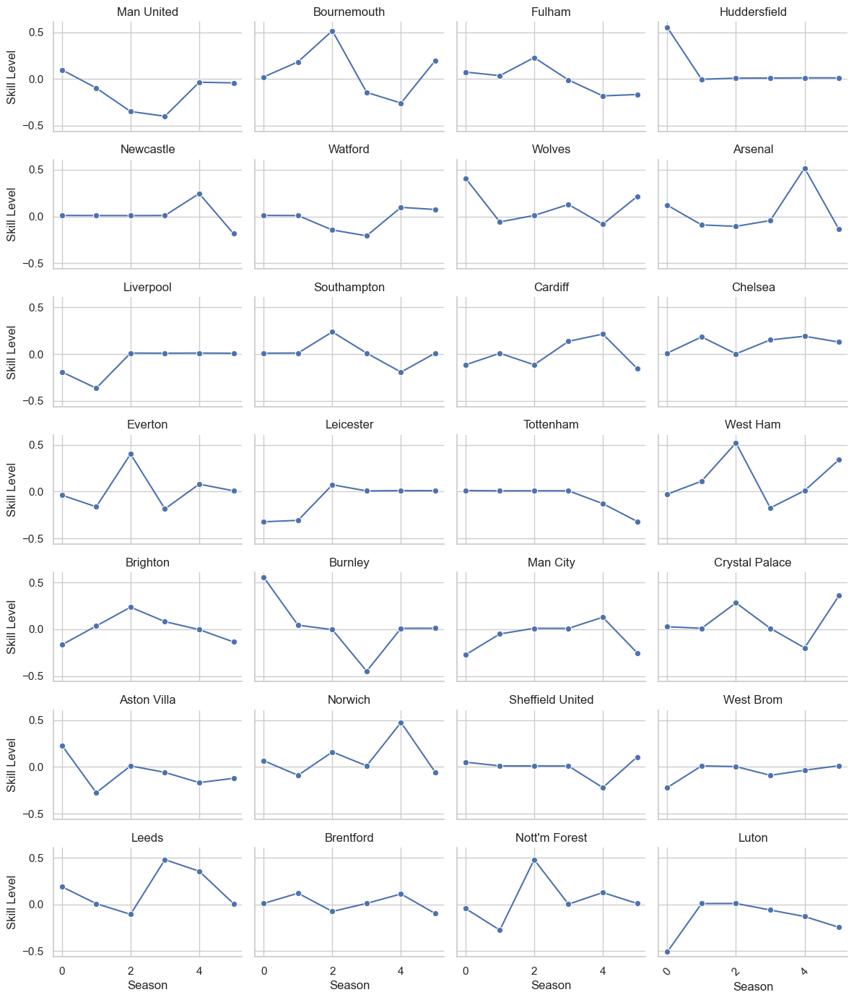

In [25]:
visualize_team_skills_facets(df_18_24, trace_time_dep_non_centered)

## Use Cases

### 1.1 Functions for Match Outcome Predictions

#### Base Model

In [59]:
def simulate_match_outcome_base_model(home_team_name, away_team_name, df, trace, show_plot=True):

    # Map team names to their corresponding IDs
    team_name_to_id = dict(zip(df['Home_Team'], df['Home_Team_ID']))
    home_team_id = team_name_to_id[home_team_name]
    away_team_id = team_name_to_id[away_team_name]

    # Extract samples from the trace
    team_skills_samples = trace.posterior['team_skills'].values
    baseline_skill_samples = trace.posterior['baseline_skill'].values

    # Calculate lambda values for both home and away teams
    lambda_home = np.exp(baseline_skill_samples + team_skills_samples[:, :, home_team_id] - team_skills_samples[:, :, away_team_id])
    lambda_away = np.exp(baseline_skill_samples + team_skills_samples[:, :, away_team_id] - team_skills_samples[:, :, home_team_id])

    # Simulate goals using Poisson distribution
    home_goals = np.random.poisson(lambda_home)
    away_goals = np.random.poisson(lambda_away)

    # Calculate probabilities for match outcomes
    home_win_prob = round(np.mean(home_goals > away_goals), 3)
    away_win_prob = round(np.mean(away_goals > home_goals), 3)
    draw_prob = round(np.mean(home_goals == away_goals), 3)

    # Store probabilities in a dictionary
    probabilities = {
        f"{home_team_name} Win Probability": home_win_prob,
        f"{away_team_name} Win Probability": away_win_prob,
        "Draw Probability": draw_prob
    }

    # Optional bar plot visualization
    if show_plot:
        plt.figure(figsize=(6, 4))
        plt.bar([home_team_name, away_team_name, "Draw"], probabilities.values(), color=['blue', 'red', 'green'])
        plt.xlabel('Match Outcome')
        plt.ylabel('Probability')
        plt.title(f"Match Outcome Probabilities: {home_team_name} vs {away_team_name}")
        plt.show()
    else:
        plt.close()  # Ensure the plot is closed when not showing

    # Return only the probabilities dictionary
    return probabilities


#### Home Advantage model 

In [60]:
def simulate_match_outcome_home_adv(home_team_name, away_team_name, df, trace, show_plot=True):
    """
    Simulates matches between two teams using a model that includes Home Advantage.

    Parameters:
    - home_team_name: Name of the home team.
    - away_team_name: Name of the away team.
    - df: DataFrame containing the match data.
    - trace: Trace object from a Bayesian model with Home Advantage included.
    - show_plot: Boolean, if True, shows the bar plot (default is False).

    Returns:
    - probabilities: A dictionary with the probabilities of home win, away win, and draw.
    """
    # Team name to ID mapping
    team_name_to_id = dict(zip(df['Home_Team'], df['Home_Team_ID']))
    
    # Convert team names to IDs
    home_team_id = team_name_to_id[home_team_name]
    away_team_id = team_name_to_id[away_team_name]
    
    # Extract samples from the trace
    team_skills_samples = trace.posterior['team_skills'].values
    baseline_skill_samples = trace.posterior['baseline_skill'].values
    home_advantage_samples = trace.posterior['home_advantage'].values
    
    # Calculate lambda values including Home Advantage
    lambda_home = np.exp(home_advantage_samples + baseline_skill_samples +
                         team_skills_samples[:, :, home_team_id] - team_skills_samples[:, :, away_team_id])
    lambda_away = np.exp(baseline_skill_samples +
                         team_skills_samples[:, :, away_team_id] - team_skills_samples[:, :, home_team_id])
    
    # Simulate goals
    home_goals = np.random.poisson(lambda_home)
    away_goals = np.random.poisson(lambda_away)
    
    # Calculate probabilities
    home_win_prob = round(np.mean(home_goals > away_goals), 3)
    away_win_prob = round(np.mean(away_goals > home_goals), 3)
    draw_prob = round(np.mean(home_goals == away_goals), 3)

    # Store probabilities in a dictionary
    probabilities = {
        f"{home_team_name} Win Probability": home_win_prob,
        f"{away_team_name} Win Probability": away_win_prob,
        "Draw Probability": draw_prob
    }

    # Optional Bar Plot
    if show_plot:
        plt.figure(figsize=(6, 4))
        plt.bar([home_team_name, away_team_name, "Draw"], probabilities.values(), color=['blue', 'red', 'green'])
        plt.xlabel('Match Outcome')
        plt.ylabel('Probability')
        plt.title(f"Match Outcome Probabilities: {home_team_name} vs {away_team_name}")
        plt.show()
    else:
        plt.close()  # Ensure the plot is closed when not showing

    # Return only the probabilities dictionary
    return probabilities


#### Time Dependent Model

In [61]:
def simulate_match_outcome_time_dependent(home_team_name, away_team_name, season, df, trace, show_plot=True):

    # Team name to ID mapping
    team_name_to_id = dict(zip(df['Home_Team'], df['Home_Team_ID']))
    home_team_id = team_name_to_id[home_team_name]
    away_team_id = team_name_to_id[away_team_name]

    # Extract samples from the trace
    team_skills_samples = trace.posterior['team_skills'].values
    baseline_skill_samples = trace.posterior['baseline_skill'].values

    # Indexing based on the dimensions of the samples
    if team_skills_samples.ndim == 4:
        team_skills_home_samples = team_skills_samples[:, :, season, home_team_id]
        team_skills_away_samples = team_skills_samples[:, :, season, away_team_id]
    elif team_skills_samples.ndim == 3:
        team_skills_home_samples = team_skills_samples[:, :, home_team_id]
        team_skills_away_samples = team_skills_samples[:, :, away_team_id]
    else:
        raise ValueError("Unexpected dimensions: `team_skills` array could not be indexed correctly.")

    # Calculate lambda values
    lambda_home = np.exp(baseline_skill_samples + team_skills_home_samples)
    lambda_away = np.exp(baseline_skill_samples + team_skills_away_samples)

    # Simulate goals
    home_goals = np.random.poisson(lambda_home)
    away_goals = np.random.poisson(lambda_away)

    # Calculate probabilities
    total_matches = home_goals.size
    home_win_prob = round(np.mean(home_goals > away_goals), 3)
    away_win_prob = round(np.mean(away_goals > home_goals), 3)
    draw_prob = round(np.mean(home_goals == away_goals), 3)

    probabilities = {
        f"{home_team_name} Win Probability": home_win_prob,
        f"{away_team_name} Win Probability": away_win_prob,
        "Draw Probability": draw_prob
    }

    # Optional Bar Plot
    if show_plot:
        plt.figure(figsize=(6, 4))
        plt.bar([home_team_name, away_team_name, "Draw"], probabilities.values(), color=['blue', 'red', 'green'])
        plt.xlabel('Match Outcome')
        plt.ylabel('Probability')
        plt.title(f"Match Outcome Probabilities: {home_team_name} vs {away_team_name}")
        plt.show()
    else:
        plt.close()  # Close the plot to avoid automatic display

    return probabilities


### Aplication of Fuctions 

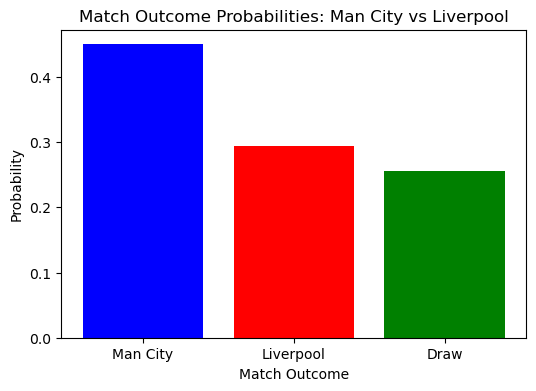

{'Man City Win Probability': 0.45,
 'Liverpool Win Probability': 0.294,
 'Draw Probability': 0.256}

In [65]:
simulate_match_outcome_base_model('Man City', 'Liverpool', df_18_24, trace_base_non_centered)

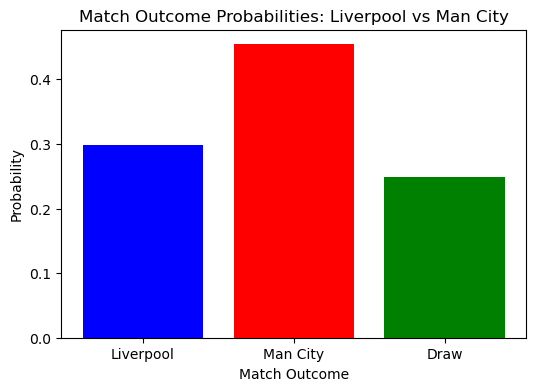

{'Liverpool Win Probability': 0.299,
 'Man City Win Probability': 0.454,
 'Draw Probability': 0.248}

In [66]:
simulate_match_outcome_base_model('Liverpool','Man City', df_18_24, trace_base_non_centered)

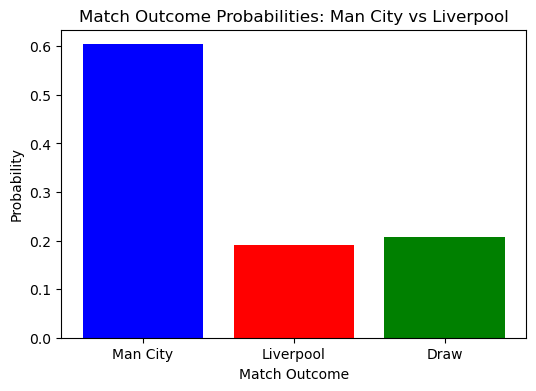

{'Man City Win Probability': 0.604,
 'Liverpool Win Probability': 0.19,
 'Draw Probability': 0.207}

In [67]:
simulate_match_outcome_home_adv('Man City', 'Liverpool', df_18_24, trace_home_adv_non_centered)

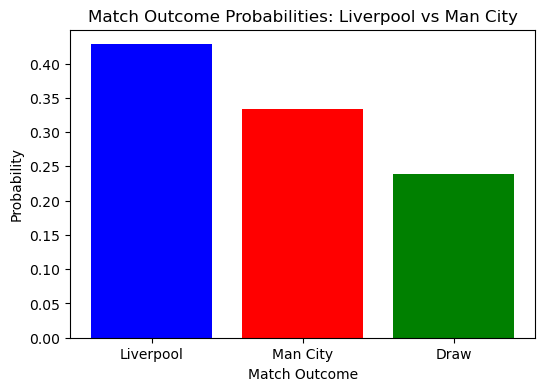

{'Liverpool Win Probability': 0.428,
 'Man City Win Probability': 0.333,
 'Draw Probability': 0.239}

In [68]:
simulate_match_outcome_home_adv('Liverpool','Man City', df_18_24, trace_home_adv_non_centered)

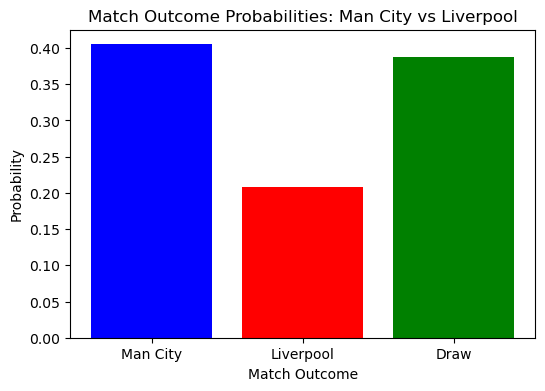

{'Man City Win Probability': 0.405,
 'Liverpool Win Probability': 0.208,
 'Draw Probability': 0.387}

In [69]:
simulate_match_outcome_time_dependent('Man City', 'Liverpool', 5, df_18_24, trace_time_dep_non_centered)

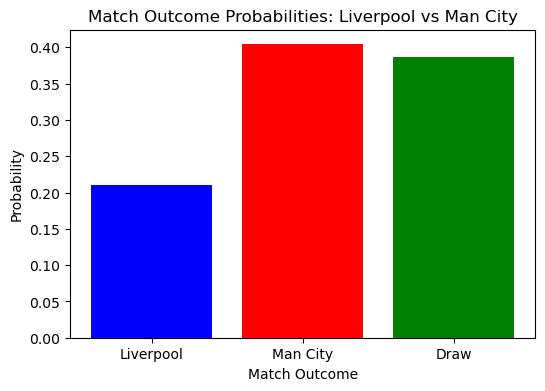

{'Liverpool Win Probability': 0.21,
 'Man City Win Probability': 0.404,
 'Draw Probability': 0.386}

In [70]:
simulate_match_outcome_time_dependent( 'Liverpool', 'Man City',5, df_18_24,trace_time_dep_non_centered)

In [79]:
# base modle prediction for  5 matcahes

result_1 = simulate_match_outcome_base_model('Arsenal', 'Man City', df_18_24, trace_base_non_centered, show_plot=False)
result_2 = simulate_match_outcome_base_model('Liverpool', 'Arsenal', df_18_24, trace_base_non_centered, show_plot=False)
result_3 = simulate_match_outcome_base_model('Liverpool', 'Chelsea', df_18_24, trace_base_non_centered, show_plot=False)
result_4 = simulate_match_outcome_base_model('Man City', 'Tottenham', df_18_24, trace_base_non_centered, show_plot=False)
result_5 = simulate_match_outcome_base_model('Chelsea', 'Newcastle', df_18_24, trace_base_non_centered, show_plot=False)
result_6 = simulate_match_outcome_base_model('Man City', 'Luton', df_18_24, trace_base_non_centered, show_plot=False)
result_7 = simulate_match_outcome_base_model('Luton', 'Norwich', df_18_24, trace_base_non_centered, show_plot=False)


# Base Model Predictions for Matches
match_results = [
    ["Arsenal", "Man City", result_1],
    ["Liverpool", "Arsenal", result_2],
    ["Liverpool", "Chelsea", result_3],
    ["Man City", "Tottenham", result_4],
    ["Chelsea", "Newcastle", result_5],
    ["Man City", "Luton", result_6],
    ["Luton", "Norwich", result_7]
]

# Define table headers
headers = ["Home Team", "Away Team", "Prediction Result"]

# Print the table using tabulate
print(tabulate(match_results, headers=headers, tablefmt="grid"))


+-------------+-------------+----------------------------------------------------------------------------------------------------+
| Home Team   | Away Team   | Prediction Result                                                                                  |
+=============+=============+====================================================================================================+
| Arsenal     | Man City    | {'Arsenal Win Probability': 0.206, 'Man City Win Probability': 0.566, 'Draw Probability': 0.227}   |
+-------------+-------------+----------------------------------------------------------------------------------------------------+
| Liverpool   | Arsenal     | {'Liverpool Win Probability': 0.481, 'Arsenal Win Probability': 0.272, 'Draw Probability': 0.248}  |
+-------------+-------------+----------------------------------------------------------------------------------------------------+
| Liverpool   | Chelsea     | {'Liverpool Win Probability': 0.532, 'Chelsea Win Pro

In [80]:
# Home Advantage Model predictions for 5 matches (plots disabled)

result_home_adv_1 = simulate_match_outcome_home_adv('Arsenal', 'Man City', df_18_24, trace_home_adv_non_centered, show_plot=False)
result_home_adv_2 = simulate_match_outcome_home_adv('Man City', 'Arsenal', df_18_24, trace_home_adv_non_centered, show_plot=False)
result_home_adv_3 = simulate_match_outcome_home_adv('Liverpool', 'Arsenal', df_18_24, trace_home_adv_non_centered, show_plot=False)
result_home_adv_4 = simulate_match_outcome_home_adv('Arsenal', 'Liverpool', df_18_24, trace_home_adv_non_centered, show_plot=False)
result_home_adv_5 = simulate_match_outcome_home_adv('Man City', 'Tottenham', df_18_24, trace_home_adv_non_centered, show_plot=False)
result_home_adv_6 = simulate_match_outcome_home_adv('Tottenham', 'Man City', df_18_24, trace_home_adv_non_centered, show_plot=False)
result_home_adv_7 = simulate_match_outcome_home_adv('Liverpool', 'Chelsea', df_18_24, trace_home_adv_non_centered, show_plot=False)
result_home_adv_8 = simulate_match_outcome_home_adv('Chelsea', 'Liverpool', df_18_24, trace_home_adv_non_centered, show_plot=False)
result_home_adv_9 = simulate_match_outcome_home_adv('Chelsea', 'Newcastle', df_18_24, trace_home_adv_non_centered, show_plot=False)
result_home_adv_10 = simulate_match_outcome_home_adv('Newcastle', 'Chelsea', df_18_24, trace_home_adv_non_centered, show_plot=False)
result_home_adv_11= simulate_match_outcome_home_adv('Man City', 'Luton', df_18_24, trace_home_adv_non_centered, show_plot=False)
result_home_adv_12 = simulate_match_outcome_home_adv('Luton', 'Man City', df_18_24, trace_home_adv_non_centered, show_plot=False)
result_home_adv_13 = simulate_match_outcome_base_model('Luton', 'Norwich', df_18_24, trace_base_non_centered, show_plot=False)
result_home_adv_14 = simulate_match_outcome_base_model('Norwich', 'Luton', df_18_24, trace_base_non_centered, show_plot=False)



# Match results for Home Advantage Model in a list of lists
home_adv_results = [
    ["Arsenal", "Man City", result_home_adv_1],
    ["Man City", "Arsenal", result_home_adv_2],
    ["Liverpool", "Arsenal", result_home_adv_3],
    ["Arsenal", "Liverpool", result_home_adv_4],
    ["Man City", "Tottenham", result_home_adv_5],
    ["Tottenham", "Man City", result_home_adv_6],
    ["Liverpool", "Chelsea", result_home_adv_7],
    ["Chelsea", "Liverpool", result_home_adv_8],
    ["Chelsea", "Newcastle", result_home_adv_9],
    ["Newcastle", "Chelsea", result_home_adv_10],
    ["Man City", "Luton", result_home_adv_11],
    ["Luton", "Man City", result_home_adv_12],
    ["Luton", "Norwich", result_home_adv_13],
    ["Norwich", "Luton", result_home_adv_14]
]

# Define table headers
headers = ["Home Team", "Away Team", "Prediction Result"]

# Print the table
print(tabulate(home_adv_results, headers=headers, tablefmt="grid"))


+-------------+-------------+----------------------------------------------------------------------------------------------------+
| Home Team   | Away Team   | Prediction Result                                                                                  |
+=============+=============+====================================================================================================+
| Arsenal     | Man City    | {'Arsenal Win Probability': 0.315, 'Man City Win Probability': 0.446, 'Draw Probability': 0.239}   |
+-------------+-------------+----------------------------------------------------------------------------------------------------+
| Man City    | Arsenal     | {'Man City Win Probability': 0.71, 'Arsenal Win Probability': 0.124, 'Draw Probability': 0.166}    |
+-------------+-------------+----------------------------------------------------------------------------------------------------+
| Liverpool   | Arsenal     | {'Liverpool Win Probability': 0.629, 'Arsenal Win Pro

In [81]:
# Time-Dependent Model predictions for matches (plots disabled)
result_time_dep_1 = simulate_match_outcome_time_dependent('Arsenal', 'Man City', 5, df_18_24, trace_time_dep_non_centered, show_plot=False)
result_time_dep_2 = simulate_match_outcome_time_dependent('Man City', 'Arsenal', 5, df_18_24, trace_time_dep_non_centered, show_plot=False)
result_time_dep_3 = simulate_match_outcome_time_dependent('Liverpool', 'Arsenal', 5, df_18_24, trace_time_dep_non_centered, show_plot=False)
result_time_dep_4 = simulate_match_outcome_time_dependent('Arsenal', 'Liverpool', 5, df_18_24, trace_time_dep_non_centered, show_plot=False)
result_time_dep_5 = simulate_match_outcome_time_dependent('Man City', 'Tottenham', 5, df_18_24, trace_time_dep_non_centered, show_plot=False)
result_time_dep_6 = simulate_match_outcome_time_dependent('Tottenham', 'Man City', 5, df_18_24, trace_time_dep_non_centered, show_plot=False)
result_time_dep_7 = simulate_match_outcome_time_dependent('Liverpool', 'Chelsea', 5, df_18_24, trace_time_dep_non_centered, show_plot=False)
result_time_dep_8 = simulate_match_outcome_time_dependent('Chelsea', 'Liverpool', 5, df_18_24, trace_time_dep_non_centered, show_plot=False)
result_time_dep_9 = simulate_match_outcome_time_dependent('Chelsea', 'Newcastle', 5, df_18_24, trace_time_dep_non_centered, show_plot=False)
result_time_dep_10 = simulate_match_outcome_time_dependent('Newcastle', 'Chelsea', 5, df_18_24, trace_time_dep_non_centered, show_plot=False)
result_time_dep_11 = simulate_match_outcome_time_dependent('Man City', 'Luton', 5, df_18_24, trace_time_dep_non_centered, show_plot=False)
result_time_dep_12 = simulate_match_outcome_time_dependent('Luton', 'Man City', 5, df_18_24, trace_time_dep_non_centered, show_plot=False)
result_time_dep_13 = simulate_match_outcome_time_dependent('Luton', 'Norwich', 5, df_18_24, trace_time_dep_non_centered, show_plot=False)
result_time_dep_14 = simulate_match_outcome_time_dependent('Norwich', 'Luton', 5, df_18_24, trace_time_dep_non_centered, show_plot=False)

# Match results for Time-Dependent Model in a list of lists
time_dep_results = [
    ["Arsenal", "Man City", result_time_dep_1],
    ["Man City", "Arsenal", result_time_dep_2],
    ["Liverpool", "Arsenal", result_time_dep_3],
    ["Arsenal", "Liverpool", result_time_dep_4],
    ["Man City", "Tottenham", result_time_dep_5],
    ["Tottenham", "Man City", result_time_dep_6],
    ["Liverpool", "Chelsea", result_time_dep_7],
    ["Chelsea", "Liverpool", result_time_dep_8],
    ["Chelsea", "Newcastle", result_time_dep_9],
    ["Newcastle", "Chelsea", result_time_dep_10],
    ["Man City", "Luton", result_time_dep_11],
    ["Luton", "Man City", result_time_dep_12],
    ["Luton", "Norwich", result_time_dep_13],
    ["Norwich", "Luton", result_time_dep_14]
]

# Define table headers
headers = ["Home Team", "Away Team", "Prediction Result"]

# Print the table
print(tabulate(time_dep_results, headers=headers, tablefmt="grid"))



+-------------+-------------+----------------------------------------------------------------------------------------------------+
| Home Team   | Away Team   | Prediction Result                                                                                  |
+=============+=============+====================================================================================================+
| Arsenal     | Man City    | {'Arsenal Win Probability': 0.309, 'Man City Win Probability': 0.309, 'Draw Probability': 0.382}   |
+-------------+-------------+----------------------------------------------------------------------------------------------------+
| Man City    | Arsenal     | {'Man City Win Probability': 0.31, 'Arsenal Win Probability': 0.311, 'Draw Probability': 0.38}     |
+-------------+-------------+----------------------------------------------------------------------------------------------------+
| Liverpool   | Arsenal     | {'Liverpool Win Probability': 0.212, 'Arsenal Win Pro

### Analysis of Match Outcome: Base Model vs. Home Advantage Model vs. Time-Dependent Model

#### 1. Overview of Models
- **Base Model**: Assumes constant team strengths and does not factor in home advantage or temporal dynamics.
- **Home Advantage Model**: Incorporates the impact of home field advantage on match outcomes.
- **Time-Dependent Model**: Accounts for variations in team performances over time, capturing temporal dynamics in match predictions.

---

#### 2. Key Observations

##### 2.1 Arsenal vs. Man City
- **Base Model**: Predicts a significant advantage for Man City (56.6% win probability) compared to Arsenal (20.6%), with a 22.7% chance of a draw.
- **Home Advantage Model**: Reduces Man City's dominance, predicting a 44.6% win probability for Man City and 31.5% for Arsenal, with a 23.9% chance of a draw.
- **Time-Dependent Model**: Predicts an evenly balanced match with both Arsenal and Man City having ~30.9% win probabilities and a higher draw probability (38.2%).

**Analysis**: The Time-Dependent Model highlights a more balanced contest, likely reflecting fluctuations in team performances over time, while the Base Model strongly favors Man City.

---

#### 2.2 Liverpool vs. Arsenal
- **Base Model**: Favors Liverpool with a 62.9% win probability, while Arsenal's chances are at 17.4%, and a draw is 19.8%.
- **Home Advantage Model**: Reduces Liverpool's dominance, predicting 48.1% for Liverpool, 27.2% for Arsenal, and 24.8% for a draw.
- **Time-Dependent Model**: Reflects increased uncertainty, predicting 40.3% for Arsenal, 21.2% for Liverpool, and a high 38.4% draw probability when Arsenal hosts.

**Analysis**: The Home Advantage Model adjusts Liverpool's dominance, reflecting the advantage of Arsenal playing at home. The Time-Dependent Model, however, suggests significant performance shifts between the teams over time.

---

#### 2.3 Man City vs. Tottenham
- **Base Model**: Strongly favors Man City with a 75.8% win probability, while Tottenham's win probability is only 9.7%.
- **Home Advantage Model**: Still favors Man City but reduces its dominance (61.4%), with Tottenham at 17.2%.
- **Time-Dependent Model**: Highlights a closer contest with Man City at 50.1%, Tottenham at 11.2%, and a substantial draw probability of 38.6%.

**Analysis**: The Time-Dependent Model reflects higher draw probabilities, indicating temporal factors that level the playing field more than static assessments in the Base Model.

---

#### 2.4 Chelsea vs. Newcastle
- **Base Model**: Strongly favors Chelsea with a 62.4% win probability, Newcastle at 17.5%, and a draw at 20.1%.
- **Home Advantage Model**: Slightly reduces Chelsea's edge (47.8% for Chelsea, 27.9% for Newcastle) and increases the draw probability.
- **Time-Dependent Model**: Predicts Newcastle having a marginal advantage in some scenarios, with probabilities for Chelsea and Newcastle nearly equal (~35%).

**Analysis**: Temporal performance data in the Time-Dependent Model narrows the gap between Chelsea and Newcastle, highlighting potential periods of stronger Newcastle performance.

---

#### 2.5 Luton vs. Norwich
- **Base Model**: Predicts a balanced match with a slight edge for Luton (49.7% win probability) over Norwich (26.2%), and a draw at 24.1%.
- **Home Advantage Model**: Adjusts Luton's probability (49.4%) slightly downwards, giving Norwich 26.6%.
- **Time-Dependent Model**: Reflects a major shift in dynamics, with Norwich gaining a significant edge (40.5% win probability), and draw probabilities increasing to 42.7%.

**Analysis**: The Time-Dependent Model suggests a potential period where Norwich has outperformed expectations, whereas the Base and Home Advantage Models maintain a steady view favoring Luton.

---

#### 3. Comparative Insights
1. **Base Model**:
   - Strong static predictions.
   - Man City and Liverpool consistently dominate weaker teams.
   - Draw probabilities are generally lower.

2. **Home Advantage Model**:
   - Accounts for home field advantage effectively.
   - Adjusts for the home team’s improved chances while reducing dominance of stronger away teams.

3. **Time-Dependent Model**:
   - Reflects temporal variations, increasing draw probabilities in historically even matchups.
   - Provides balanced insights into fluctuating performances (e.g., Arsenal vs. Man City, Chelsea vs. Newcastle).
   - More conservative in assigning extreme probabilities to one team.

---

#### 4. Conclusion
The models provide unique perspectives:
- **Base Model**: Ideal for overall static assessments but lacks nuance for specific contexts like home advantage or time-dependent factors.
- **Home Advantage Model**: Captures the significance of match location, making predictions more realistic.
- **Time-Dependent Model**: Offers the most dynamic predictions, accounting for performance trends and temporal changes.

For scenarios requiring long-term predictions, the **Base Model** is sufficient. However, for detailed match-level forecasts, especially involving recent trends or fluctuating team forms, the **Time-Dependent Model** proves to be the most insightful.


### 1.2 Functions for  Calculating Score Probabilities

In [122]:
def calculate_and_visualize_score_probability_with_base_model(
    home_team_name, away_team_name, target_home_goals, target_away_goals, df, trace, show_plot=True):
    """
    Simulates matches between two teams, calculates the probability of a specific scoreline,
    and optionally visualizes the probability distribution in a formatted, readable way.

    Parameters:
    - home_team_name: Name of the home team.
    - away_team_name: Name of the away team.
    - target_home_goals: Target number of goals for the home team.
    - target_away_goals: Target number of goals for the away team.
    - df: DataFrame containing the match data.
    - trace: Trace object from a Bayesian model containing posterior distributions.
    - show_plot: Boolean to control whether to display the plot (default is True).
    """
    # Create the team name to ID mapping
    team_name_to_id = dict(zip(df['Home_Team'], df['Home_Team_ID']))
    home_team_id = team_name_to_id[home_team_name]
    away_team_id = team_name_to_id[away_team_name]
    
    # Extract samples from the trace
    team_skills_samples = trace.posterior['team_skills'].values
    baseline_skill_samples = trace.posterior['baseline_skill'].values
    
    # Calculate lambda values for home and away teams
    lambda_home = np.exp(baseline_skill_samples + team_skills_samples[:, :, home_team_id] - team_skills_samples[:, :, away_team_id])
    lambda_away = np.exp(baseline_skill_samples + team_skills_samples[:, :, away_team_id] - team_skills_samples[:, :, home_team_id])
    
    # Simulate goals for all matches
    home_goals = np.random.poisson(lambda_home)
    away_goals = np.random.poisson(lambda_away)
    
    # Calculate the number of times the specific scoreline occurred
    score_occurrences = np.sum((home_goals == target_home_goals) & (away_goals == target_away_goals))
    
    # Calculate probability of the specific scoreline
    total_matches = home_goals.size
    score_probability = score_occurrences / total_matches
    score_probability_percentage = score_probability * 100  # Convert to percentage

    # Display results in a formatted, readable way
    print("\n" + "="*50)
    print("Total Simulated Matches:".ljust(25), f"{total_matches}")
    print(f"{home_team_name} vs {away_team_name}".ljust(25), f"{target_home_goals}-{target_away_goals}")
    print("Score Occurrences:".ljust(25), f"{score_occurrences}")
    print("Score Probability:".ljust(25), f"{score_probability:.4f} ({score_probability_percentage:.2f}%)")
    print("="*50 + "\n")

    if show_plot:
        # Determine the maximum number of goals to set up the plot
        max_goals = max(home_goals.max(), away_goals.max())
        score_probabilities = np.zeros((max_goals + 1, max_goals + 1))
        
        # Compute the probabilities for all possible scorelines
        for i in range(max_goals + 1):
            for j in range(max_goals + 1):
                score_probabilities[i, j] = np.sum((home_goals == i) & (away_goals == j)) / total_matches
        
        # Set up a 3D surface plot for the probability distribution
        home_goals_grid, away_goals_grid = np.meshgrid(np.arange(max_goals + 1), np.arange(max_goals + 1))
        
        fig = plt.figure(figsize=(10, 6))
        ax = fig.add_subplot(111, projection='3d')
        
        # Create the surface plot with a high-contrast color map and transparency
        surf = ax.plot_surface(home_goals_grid, away_goals_grid, score_probabilities, cmap='viridis', alpha=0.7, edgecolor='none')
        
        # Highlight the specific scoreline with a distinct color and larger size
        ax.scatter(target_home_goals, target_away_goals, score_probability, color='red', s=200, label=f'Score {target_home_goals}-{target_away_goals}', edgecolor='black', zorder=10)
        
        # Set labels and title for the plot
        ax.set_xlabel('Home Goals')
        ax.set_ylabel('Away Goals')
        ax.set_zlabel('Probability')
        ax.set_title(f'Probability Distribution: {home_team_name} vs {away_team_name}')
        
        # Add a color bar to show the scale
        fig.colorbar(surf, ax=ax, shrink=0.5, aspect=5)
        # Add a legend to highlight the specific scoreline
        ax.legend()

        # Display the plot
        plt.show()


In [126]:
def calculate_and_visualize_score_probability_with_home_advantage(
    home_team_name, away_team_name, target_home_goals, target_away_goals, df, trace, show_plot=True):
    """
    Simulates matches between two teams, incorporating Home Advantage, and calculates the probability of a specific scoreline.
    Optionally visualizes the probability distribution of all possible scorelines.

    Parameters:
    - home_team_name: Name of the home team.
    - away_team_name: Name of the away team.
    - target_home_goals: Target number of goals for the home team.
    - target_away_goals: Target number of goals for the away team.
    - df: DataFrame containing the match data.
    - trace: Trace object from a Bayesian model with Home Advantage.
    - show_plot: Boolean to control whether to display the plot (default is True).

    Returns:
    - score_probability: Probability of the specific scoreline occurring.
    - total_matches: Total number of simulated matches.
    - score_occurrences: Number of times the specific scoreline occurred.
    """
    # Create the team name to ID mapping
    team_name_to_id = dict(zip(df['Home_Team'], df['Home_Team_ID']))
    home_team_id = team_name_to_id[home_team_name]
    away_team_id = team_name_to_id[away_team_name]
    
    # Extract samples from the trace
    team_skills_samples = trace.posterior['team_skills'].values
    baseline_skill_samples = trace.posterior['baseline_skill'].values
    home_advantage_samples = trace.posterior['home_advantage'].values  # Include Home Advantage
    
    # Calculate lambda values, incorporating Home Advantage
    lambda_home = np.exp(home_advantage_samples + baseline_skill_samples + team_skills_samples[:, :, home_team_id] - team_skills_samples[:, :, away_team_id])
    lambda_away = np.exp(baseline_skill_samples + team_skills_samples[:, :, away_team_id] - team_skills_samples[:, :, home_team_id])
    
    # Simulate goals for all matches
    home_goals = np.random.poisson(lambda_home)
    away_goals = np.random.poisson(lambda_away)
    
    # Calculate occurrences and probability of the target scoreline
    score_occurrences = np.sum((home_goals == target_home_goals) & (away_goals == target_away_goals))
    total_matches = home_goals.size
    score_probability = score_occurrences / total_matches
    score_probability_percentage = score_probability * 100  # Convert to percentage

    # Display results in a formatted way
    print("\n" + "="*50)
    print("Total Simulated Matches:".ljust(25), f"{total_matches}")
    print(f"{home_team_name} vs {away_team_name}".ljust(25), f"{target_home_goals} - {target_away_goals}")
    print("Score Occurrences:".ljust(25), f"{score_occurrences}")
    print("Score Probability:".ljust(25), f"{score_probability:.4f} ({score_probability_percentage:.2f}%)")
    print("="*50 + "\n")

    if show_plot:
        # Visualization of score probability distribution
        max_goals = max(home_goals.max(), away_goals.max())
        score_probabilities = np.zeros((max_goals + 1, max_goals + 1))

        for i in range(max_goals + 1):
            for j in range(max_goals + 1):
                score_probabilities[i, j] = np.sum((home_goals == i) & (away_goals == j)) / total_matches

        home_goals_grid, away_goals_grid = np.meshgrid(np.arange(max_goals + 1), np.arange(max_goals + 1))
        fig = plt.figure(figsize=(10, 6))
        ax = fig.add_subplot(111, projection='3d')
        surf = ax.plot_surface(home_goals_grid, away_goals_grid, score_probabilities, cmap='viridis', alpha=0.7, edgecolor='none')
        ax.scatter(target_home_goals, target_away_goals, score_probability, color='red', s=200, label=f'Score {target_home_goals}-{target_away_goals}', edgecolor='black', zorder=10)
        ax.set_xlabel('Home Goals')
        ax.set_ylabel('Away Goals')
        ax.set_zlabel('Probability')
        ax.set_title(f'Probability Distribution: {home_team_name} vs {away_team_name}')
        fig.colorbar(surf, ax=ax, shrink=0.5, aspect=5)
        ax.legend()
        plt.show()


In [130]:
def calculate_and_visualize_score_probability_time_dependent(
    home_team_name, away_team_name, target_home_goals, target_away_goals, season, df, trace, show_plot=True):
    """
    Simulates matches between two teams using a time-dependent model (with seasonal adjustments),
    calculates the probability of a specific scoreline, and optionally visualizes the probability distribution.

    Parameters:
    - home_team_name: Name of the home team.
    - away_team_name: Name of the away team.
    - target_home_goals: Target number of goals for the home team.
    - target_away_goals: Target number of goals for the away team.
    - season: The season index to consider for time-dependent modeling.
    - df: DataFrame containing the match data.
    - trace: Trace object from a Bayesian model with seasonal effects.
    - show_plot: Boolean to control whether to display the plot (default is True).

    Returns:
    - score_probability: Probability of the specific scoreline occurring.
    - total_matches: Total number of simulated matches.
    - score_occurrences: Number of times the specific scoreline occurred.
    """
    # Create the team name to ID mapping
    team_name_to_id = dict(zip(df['Home_Team'], df['Home_Team_ID']))
    home_team_id = team_name_to_id[home_team_name]
    away_team_id = team_name_to_id[away_team_name]
    
    # Extract samples from the trace
    team_skills_samples = trace.posterior['team_skills'].values
    baseline_skill_samples = trace.posterior['baseline_skill'].values

    # Adjust for time-dependent effects based on season
    if team_skills_samples.ndim == 4:  # If 4-dimensional (chains, draws, seasons, teams)
        team_skills_home_samples = team_skills_samples[:, :, season, home_team_id]
        team_skills_away_samples = team_skills_samples[:, :, season, away_team_id]
    else:
        team_skills_home_samples = team_skills_samples[:, :, home_team_id]
        team_skills_away_samples = team_skills_samples[:, :, away_team_id]

    # Calculate lambda values
    lambda_home = np.exp(baseline_skill_samples + team_skills_home_samples - team_skills_away_samples)
    lambda_away = np.exp(baseline_skill_samples + team_skills_away_samples - team_skills_home_samples)
    
    # Simulate goals for all matches
    home_goals = np.random.poisson(lambda_home)
    away_goals = np.random.poisson(lambda_away)
    
    # Calculate occurrences and probability of the target scoreline
    score_occurrences = np.sum((home_goals == target_home_goals) & (away_goals == target_away_goals))
    total_matches = home_goals.size
    score_probability = score_occurrences / total_matches
    score_probability_percentage = score_probability * 100  # Convert to percentage

    # Display results in a formatted way
    print("\n" + "="*50)
    print("Total Simulated Matches:".ljust(25), f"{total_matches}")
    print(f"{home_team_name} vs {away_team_name}".ljust(25), f"{target_home_goals} - {target_away_goals}")
    print("Score Occurrences:".ljust(25), f"{score_occurrences}")
    print("Score Probability:".ljust(25), f"{score_probability:.4f} ({score_probability_percentage:.2f}%)")
    print("="*50 + "\n")

    if show_plot:
        # Visualization of score probability distribution
        max_goals = max(home_goals.max(), away_goals.max())
        score_probabilities = np.zeros((max_goals + 1, max_goals + 1))

        for i in range(max_goals + 1):
            for j in range(max_goals + 1):
                score_probabilities[i, j] = np.sum((home_goals == i) & (away_goals == j)) / total_matches

        home_goals_grid, away_goals_grid = np.meshgrid(np.arange(max_goals + 1), np.arange(max_goals + 1))
        fig = plt.figure(figsize=(10, 6))
        ax = fig.add_subplot(111, projection='3d')
        surf = ax.plot_surface(home_goals_grid, away_goals_grid, score_probabilities, cmap='viridis', alpha=0.7, edgecolor='none')
        ax.scatter(target_home_goals, target_away_goals, score_probability, color='red', s=200, label=f'Score {target_home_goals}-{target_away_goals}', edgecolor='black', zorder=10)
        ax.set_xlabel('Home Goals')
        ax.set_ylabel('Away Goals')
        ax.set_zlabel('Probability')
        ax.set_title(f'Probability Distribution: {home_team_name} vs {away_team_name}')
        fig.colorbar(surf, ax=ax, shrink=0.5, aspect=5)
        ax.legend()
        plt.show()



Total Simulated Matches:  40000
Man City vs Arsenal       1-0
Score Occurrences:        4174
Score Probability:        0.1043 (10.44%)



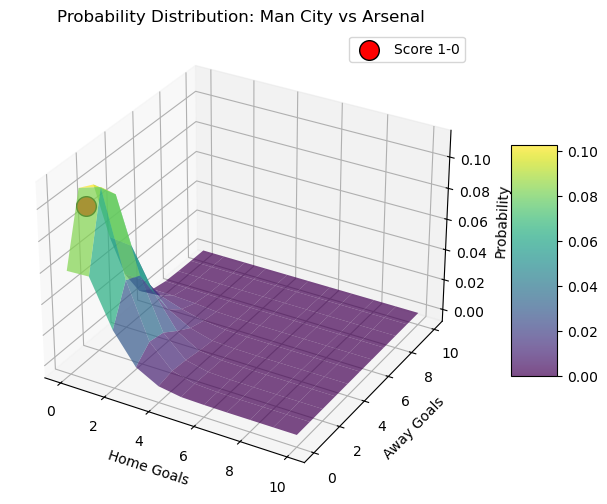

In [140]:
calculate_and_visualize_score_probability_with_base_model('Man City', 'Arsenal', 1, 0, df_18_24, trace_base_non_centered)


Total Simulated Matches:  40000
Man City vs Arsenal       1 - 0
Score Occurrences:        3317
Score Probability:        0.0829 (8.29%)



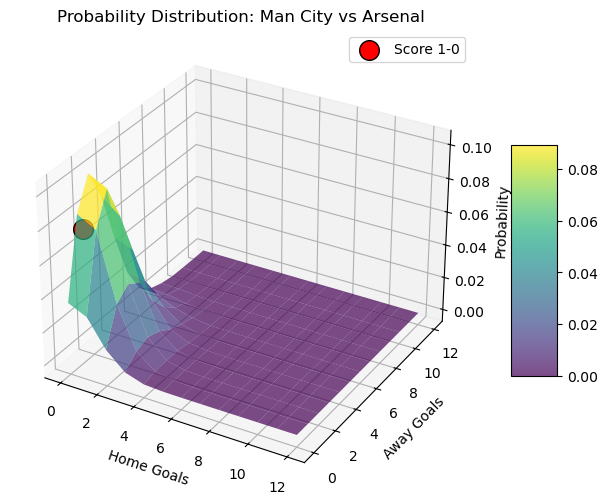

In [127]:
# Example usage
calculate_and_visualize_score_probability_with_home_advantage('Man City', 'Arsenal', 1, 0, df_18_24, trace_home_adv_non_centered)


Total Simulated Matches:  40000
Man City vs Arsenal       1 - 0
Score Occurrences:        4111
Score Probability:        0.1028 (10.28%)



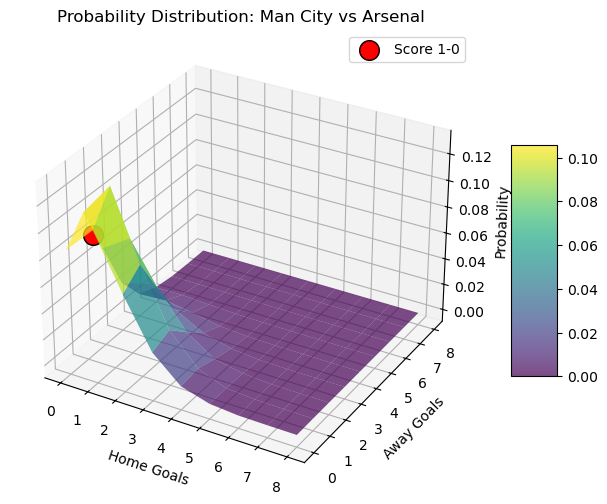

In [131]:
calculate_and_visualize_score_probability_time_dependent('Man City', 'Arsenal', 1, 0, 5, df_18_24, trace_time_dep_non_centered)


Total Simulated Matches:  40000
Man City vs Arsenal       1 - 0
Score Occurrences:        4607
Score Probability:        0.1152 (11.52%)



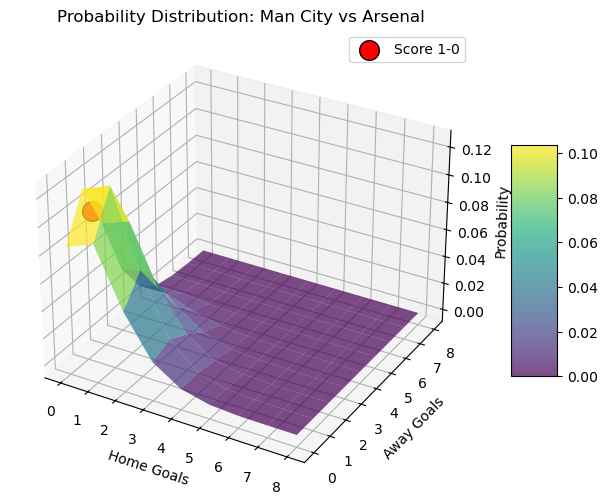

In [111]:
calculate_and_visualize_score_probability_time_dependent('Man City', 'Arsenal', 1, 0, 4, df_18_24, trace_time_dep_non_centered)


Total Simulated Matches:  40000
Man City vs Arsenal       1 - 0
Score Occurrences:        5212
Score Probability:        0.1303 (13.03%)



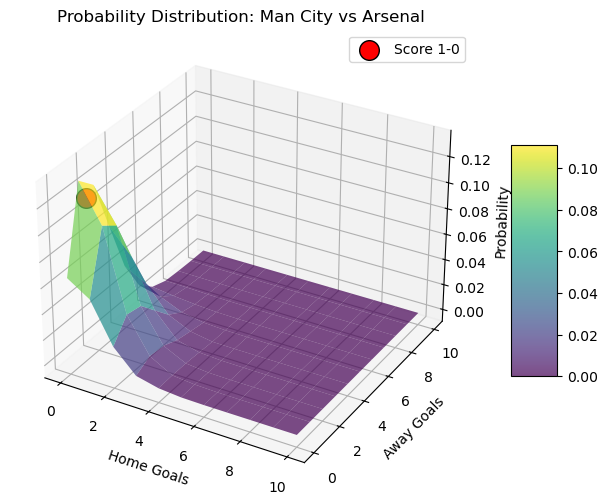

In [112]:
calculate_and_visualize_score_probability_time_dependent('Man City', 'Arsenal', 1, 0, 3, df_18_24, trace_time_dep_non_centered)


Total Simulated Matches:  40000
Man City vs Arsenal       5-0
Score Occurrences:        416
Score Probability:        0.0104 (1.04%)



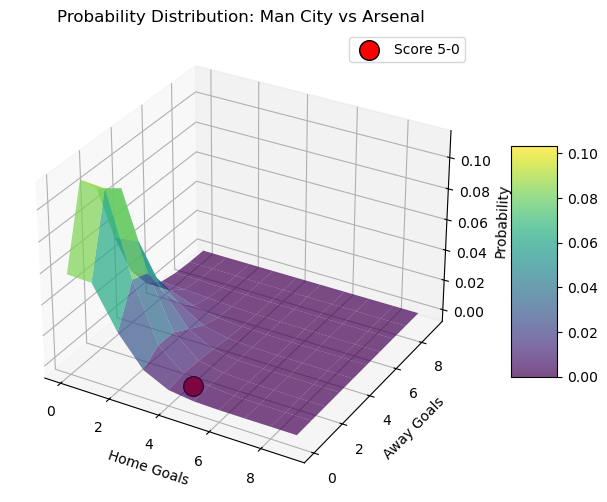

In [117]:
calculate_and_visualize_score_probability_with_base_model('Man City', 'Arsenal', 5, 0, df_18_24, trace_base_non_centered)


Total Simulated Matches:  40000
Man City vs Luton         5-0
Score Occurrences:        2218
Score Probability:        0.0554 (5.54%)



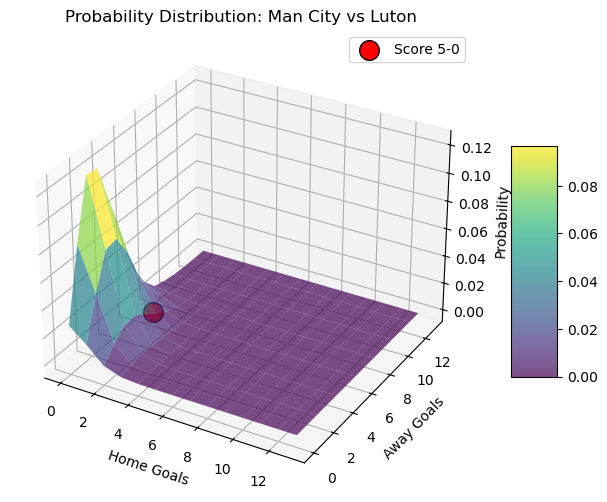

In [118]:
calculate_and_visualize_score_probability_with_base_model('Man City', 'Luton', 5, 0, df_18_24, trace_base_non_centered)

#### Base Model

In [138]:
def simulate_league_table(df, trace):
    """
    Uses the trace from the Bayesian model to calculate league table rankings.
    
    Parameters:
    - df: DataFrame containing the match data.
    - trace: Trace object from a Bayesian model containing posterior distributions.
    
    Returns:
    - league_table: A DataFrame showing each team's average position and the probability distribution of their rankings.
    """
    # Extract team names and IDs
    team_name_to_id = dict(zip(df['Home_Team'], df['Home_Team_ID']))
    team_ids = list(team_name_to_id.values())
    num_teams = len(team_ids)

    # Initialize an array to store ranking counts
    rank_counts = np.zeros((num_teams, num_teams))
    
    # Get the number of chains and draws from the trace
    team_skills_samples = trace.posterior['team_skills'].values
    baseline_skill_samples = trace.posterior['baseline_skill'].values
    n_chains, n_draws, _ = team_skills_samples.shape

    # Iterate over each sample in the trace
    for chain in range(n_chains):
        for draw in range(n_draws):
            points = np.zeros(num_teams)
            
            for home_team_name, away_team_name in zip(df['Home_Team'], df['Away_Team']):
                home_team_id = team_name_to_id[home_team_name]
                away_team_id = team_name_to_id[away_team_name]
                
                # Calculate lambda values for this sample
                lambda_home = np.exp(baseline_skill_samples[chain, draw] + team_skills_samples[chain, draw, home_team_id] - team_skills_samples[chain, draw, away_team_id])
                lambda_away = np.exp(baseline_skill_samples[chain, draw] + team_skills_samples[chain, draw, away_team_id] - team_skills_samples[chain, draw, home_team_id])
                
                # Simulate goals for this match
                home_goals = np.random.poisson(lambda_home)
                away_goals = np.random.poisson(lambda_away)
                
                # Assign points based on the match outcome
                if home_goals > away_goals:
                    points[home_team_id] += 3
                elif home_goals < away_goals:
                    points[away_team_id] += 3
                else:
                    points[home_team_id] += 1
                    points[away_team_id] += 1
            
            # Rank the teams by points for this sample
            rankings = np.argsort(-points)
            
            for rank, team_id in enumerate(rankings):
                rank_counts[team_id, rank] += 1
    
    # Calculate the probability for each ranking position
    total_samples = n_chains * n_draws
    rank_probabilities = rank_counts / total_samples
    
    # Create a DataFrame to store the results
    league_table = pd.DataFrame(rank_probabilities, columns=[f'Position {i+1}' for i in range(num_teams)])
    league_table.index = [team for team in team_name_to_id]
    
    return league_table



In [139]:
league_table = simulate_league_table(df_18_24, trace_base_non_centered)
league_table

,Position 1,Position 2,Position 3,Position 4,Position 5,Position 6,Position 7,Position 8,Position 9,Position 10,...,Position 19,Position 20,Position 21,Position 22,Position 23,Position 24,Position 25,Position 26,Position 27,Position 28
Man United,0.00000,0.000175,0.043100,0.152625,0.275600,0.426450,0.073650,0.019550,0.005650,0.002200,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
Bournemouth,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.263400,0.059900,0.013075,0.001300,0.000050,0.000000,0.000000,0.000000,0.000000,0.000000
Fulham,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.190850,0.040825,0.007025,0.000525,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
Huddersfield,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000100,0.021250,0.080000,0.149700,0.257550,0.491400
Newcastle,0.00000,0.000000,0.000275,0.002400,0.014625,0.065700,0.330025,0.215350,0.140425,0.094575,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
Watford,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.049650,0.280000,0.461900,0.170400,0.025450,0.000425,0.000000,0.000000,0.000000,0.000000
Wolves,0.00000,0.000000,0.000000,0.000150,0.000900,0.006550,0.061100,0.101525,0.126250,0.138675,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
Arsenal,0.00015,0.024125,0.667875,0.206150,0.077375,0.023225,0.001025,0.000050,0.000025,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
Liverpool,0.05870,0.914250,0.025950,0.000925,0.000125,0.000050,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
Southampton,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000075,...,0.014075,0.001525,0.000125,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000


#### Home Advantage Model

In [142]:
def simulate_league_table_with_home_advantage(df, trace):
    """
    Uses the trace from the Bayesian model to calculate league table rankings, including Home Advantage.
    
    Parameters:
    - df: DataFrame containing the match data.
    - trace: Trace object from a Bayesian model containing posterior distributions, including Home Advantage.
    
    Returns:
    - league_table: A DataFrame showing each team's average position and the probability distribution of their rankings.
    """
    # Extract team names and IDs
    team_name_to_id = dict(zip(df['Home_Team'], df['Home_Team_ID']))
    team_ids = list(team_name_to_id.values())
    num_teams = len(team_ids)

    # Initialize an array to store ranking counts
    rank_counts = np.zeros((num_teams, num_teams))
    
    # Get the number of chains and draws from the trace
    team_skills_samples = trace.posterior['team_skills'].values
    baseline_skill_samples = trace.posterior['baseline_skill'].values
    home_advantage_samples = trace.posterior['home_advantage'].values  # Extract Home Advantage samples
    n_chains, n_draws, _ = team_skills_samples.shape

    # Iterate over each sample in the trace
    for chain in range(n_chains):
        for draw in range(n_draws):
            points = np.zeros(num_teams)
            
            for home_team_name, away_team_name in zip(df['Home_Team'], df['Away_Team']):
                home_team_id = team_name_to_id[home_team_name]
                away_team_id = team_name_to_id[away_team_name]
                
                # Calculate lambda values for this sample, including Home Advantage
                lambda_home = np.exp(
                    home_advantage_samples[chain, draw] + 
                    baseline_skill_samples[chain, draw] + 
                    team_skills_samples[chain, draw, home_team_id] - 
                    team_skills_samples[chain, draw, away_team_id]
                )
                lambda_away = np.exp(
                    baseline_skill_samples[chain, draw] + 
                    team_skills_samples[chain, draw, away_team_id] - 
                    team_skills_samples[chain, draw, home_team_id]
                )
                
                # Simulate goals for this match
                home_goals = np.random.poisson(lambda_home)
                away_goals = np.random.poisson(lambda_away)
                
                # Assign points based on the match outcome
                if home_goals > away_goals:
                    points[home_team_id] += 3
                elif home_goals < away_goals:
                    points[away_team_id] += 3
                else:
                    points[home_team_id] += 1
                    points[away_team_id] += 1
            
            # Rank the teams by points for this sample
            rankings = np.argsort(-points)
            
            for rank, team_id in enumerate(rankings):
                rank_counts[team_id, rank] += 1
    
    # Calculate the probability for each ranking position
    total_samples = n_chains * n_draws
    rank_probabilities = rank_counts / total_samples
    
    # Create a DataFrame to store the results
    league_table = pd.DataFrame(rank_probabilities, columns=[f'Position {i+1}' for i in range(num_teams)])
    league_table.index = [team for team in team_name_to_id]
    
    return league_table


In [143]:
league_table_home_adv = simulate_league_table_with_home_advantage(df_18_24, trace_home_adv_non_centered)
league_table_home_adv

,Position 1,Position 2,Position 3,Position 4,Position 5,Position 6,Position 7,Position 8,Position 9,Position 10,...,Position 19,Position 20,Position 21,Position 22,Position 23,Position 24,Position 25,Position 26,Position 27,Position 28
Man United,0.000000,0.000325,0.041600,0.153400,0.275900,0.434525,0.069000,0.017250,0.005175,0.001900,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
Bournemouth,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.265325,0.057975,0.011650,0.000950,0.000025,0.000000,0.000000,0.000000,0.000000,0.000000
Fulham,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.194375,0.036800,0.006200,0.000500,0.000025,0.000000,0.000000,0.000000,0.000000,0.000000
Huddersfield,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000100,0.017325,0.079725,0.145625,0.259075,0.498150
Newcastle,0.000000,0.000000,0.000200,0.002200,0.012550,0.064200,0.341175,0.221075,0.136300,0.091400,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
Watford,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.045750,0.274100,0.472800,0.171950,0.023975,0.000325,0.000000,0.000000,0.000000,0.000000
Wolves,0.000000,0.000000,0.000000,0.000000,0.000675,0.005925,0.059775,0.099700,0.130450,0.141200,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
Arsenal,0.000075,0.022625,0.677575,0.200625,0.075450,0.022600,0.000975,0.000050,0.000025,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
Liverpool,0.057725,0.917050,0.023950,0.001175,0.000075,0.000025,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
Southampton,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.014175,0.001175,0.000175,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000


#### Time Dependent Model

In [144]:
def simulate_league_table_with_time_dependent(df, trace, season):
    """
    Uses the trace from the Bayesian model to calculate league table rankings, including time dependency for a specific season.
    
    Parameters:
    - df: DataFrame containing the match data.
    - trace: Trace object from a Bayesian model containing posterior distributions.
    - season: The season index to consider for time-dependent modeling.
    
    Returns:
    - league_table: A DataFrame showing each team's average position and the probability distribution of their rankings for the specified season.
    """
    # Extract team names and IDs
    team_name_to_id = dict(zip(df['Home_Team'], df['Home_Team_ID']))
    team_ids = list(team_name_to_id.values())
    num_teams = len(team_ids)

    # Initialize an array to store ranking counts
    rank_counts = np.zeros((num_teams, num_teams))
    
    # Extract samples from the trace
    team_skills_samples = trace.posterior['team_skills'].values
    baseline_skill_samples = trace.posterior['baseline_skill'].values

    # Adjust for time-dependent effects based on season
    if team_skills_samples.ndim == 4:  # If 4-dimensional (chains, draws, seasons, teams)
        team_skills_samples = team_skills_samples[:, :, season, :]
    elif team_skills_samples.ndim != 3:
        raise ValueError(f"Unexpected shape of team_skills_samples: {team_skills_samples.shape}")

    # Get the number of chains and draws
    n_chains, n_draws, _ = team_skills_samples.shape

    # Iterate over each sample in the trace
    for chain in range(n_chains):
        for draw in range(n_draws):
            points = np.zeros(num_teams)
            
            for home_team_name, away_team_name in zip(df['Home_Team'], df['Away_Team']):
                home_team_id = team_name_to_id[home_team_name]
                away_team_id = team_name_to_id[away_team_name]
                
                # Calculate lambda values for this sample
                lambda_home = np.exp(baseline_skill_samples[chain, draw] + team_skills_samples[chain, draw, home_team_id] - team_skills_samples[chain, draw, away_team_id])
                lambda_away = np.exp(baseline_skill_samples[chain, draw] + team_skills_samples[chain, draw, away_team_id] - team_skills_samples[chain, draw, home_team_id])
                
                # Simulate goals for this match
                home_goals = np.random.poisson(lambda_home)
                away_goals = np.random.poisson(lambda_away)
                
                # Assign points based on the match outcome
                if home_goals > away_goals:
                    points[home_team_id] += 3
                elif home_goals < away_goals:
                    points[away_team_id] += 3
                else:
                    points[home_team_id] += 1
                    points[away_team_id] += 1
            
            # Rank the teams by points for this sample
            rankings = np.argsort(-points)
            
            for rank, team_id in enumerate(rankings):
                rank_counts[team_id, rank] += 1
    
    # Calculate the probability for each ranking position
    total_samples = n_chains * n_draws
    rank_probabilities = rank_counts / total_samples
    
    # Create a DataFrame to store the results
    league_table = pd.DataFrame(rank_probabilities, columns=[f'Position {i+1}' for i in range(num_teams)])
    league_table.index = [team for team in team_name_to_id]
    
    return league_table


In [145]:
league_table_time_dependent = simulate_league_table_with_time_dependent(df_18_24, trace_time_dep_non_centered, 5)
league_table_time_dependent

,Position 1,Position 2,Position 3,Position 4,Position 5,Position 6,Position 7,Position 8,Position 9,Position 10,...,Position 19,Position 20,Position 21,Position 22,Position 23,Position 24,Position 25,Position 26,Position 27,Position 28
Man United,0.000025,0.000125,0.002075,0.025350,0.057350,0.096775,0.126075,0.131500,0.127375,0.119075,...,0.000150,0.000075,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
Bournemouth,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000075,0.000350,...,0.139300,0.077575,0.031000,0.006700,0.000275,0.000025,0.000000,0.000000,0.000000,0.000000
Fulham,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000025,0.000375,0.001075,...,0.076400,0.035225,0.011325,0.001550,0.000025,0.000000,0.000000,0.000000,0.000000,0.000000
Huddersfield,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000225,0.002625,0.019800,0.065225,0.144975,0.196700,0.210475,0.193775,0.166200
Newcastle,0.002525,0.015125,0.099100,0.360725,0.231850,0.132225,0.073300,0.039625,0.021575,0.011950,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
Watford,0.000000,0.000000,0.000000,0.000000,0.000000,0.000025,0.000225,0.000550,0.001025,0.002425,...,0.126300,0.138225,0.145350,0.086050,0.036750,0.017375,0.009875,0.006050,0.003450,0.001500
Wolves,0.000000,0.000000,0.000125,0.001925,0.006150,0.016025,0.032800,0.047600,0.067700,0.087600,...,0.003775,0.001250,0.000225,0.000050,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
Arsenal,0.456800,0.384100,0.138600,0.017350,0.002750,0.000275,0.000100,0.000000,0.000025,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
Liverpool,0.077925,0.204175,0.535525,0.131450,0.034850,0.011225,0.003300,0.000975,0.000400,0.000100,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
Southampton,0.001325,0.003750,0.012450,0.039750,0.045600,0.047800,0.048875,0.050025,0.052150,0.051500,...,0.037500,0.030675,0.023900,0.012050,0.004400,0.001725,0.000825,0.000675,0.000300,0.000275


In [99]:
def display_average_rank_league_table(league_table):
    """
    Displays a league table based on the average (expected) rank of each team,
    ensuring a fair and logical ranking based on overall probabilities.

    Parameters:
    - league_table: A DataFrame containing each team's probability distribution for positions.

    Returns:
    - None: The function prints the formatted league table for all teams.
    """
    # Calculate the average (expected) rank for each team
    expected_ranks = []
    for team in league_table.index:
        avg_rank = np.sum(
            league_table.loc[team].values * np.arange(1, league_table.shape[1] + 1)
        )
        expected_ranks.append((avg_rank, team))
    
    # Sort teams based on the average rank
    sorted_teams = sorted(expected_ranks, key=lambda x: x[0])

    # Create the ranking table
    table_data = []
    for rank, (avg_rank, team) in enumerate(sorted_teams, start=1):
        table_data.append([f"Position {rank}", team, f"{avg_rank:.2f}"])

    # Create a DataFrame and print the table
    result_df = pd.DataFrame(table_data, columns=["Position", "Team", "Average Rank"])

    print("Average Rank League Table".center(50))
    print("="*50 + "\n")
    print(result_df.to_string(index=False))


In [100]:
display_average_rank_league_table(league_table)

            Average Rank League Table             

   Position             Team Average Rank
 Position 1         Man City         1.06
 Position 2        Liverpool         1.97
 Position 3          Arsenal         3.42
 Position 4        Tottenham         4.62
 Position 5          Chelsea         4.77
 Position 6       Man United         5.42
 Position 7        Newcastle         8.35
 Position 8         West Ham         9.14
 Position 9         Brighton        10.01
Position 10           Wolves        10.81
Position 11   Crystal Palace        10.82
Position 12        Leicester        10.86
Position 13          Everton        11.36
Position 14      Aston Villa        12.48
Position 15          Burnley        15.69
Position 16      Southampton        15.78
Position 17           Fulham        17.61
Position 18      Bournemouth        17.93
Position 19        Brentford        18.24
Position 20            Leeds        20.24
Position 21          Watford        20.81
Position 22 Sheffield Un

In [101]:
display_average_rank_league_table(league_table_home_adv)


            Average Rank League Table             

   Position             Team Average Rank
 Position 1         Man City         1.06
 Position 2        Liverpool         1.97
 Position 3          Arsenal         3.41
 Position 4        Tottenham         4.62
 Position 5          Chelsea         4.76
 Position 6       Man United         5.42
 Position 7        Newcastle         8.32
 Position 8         West Ham         9.12
 Position 9         Brighton         9.99
Position 10           Wolves        10.82
Position 11   Crystal Palace        10.84
Position 12        Leicester        10.89
Position 13          Everton        11.37
Position 14      Aston Villa        12.50
Position 15          Burnley        15.68
Position 16      Southampton        15.77
Position 17           Fulham        17.61
Position 18      Bournemouth        17.92
Position 19        Brentford        18.25
Position 20            Leeds        20.25
Position 21          Watford        20.82
Position 22 Sheffield Un

In [102]:
display_average_rank_league_table(league_table_time_dependent)


            Average Rank League Table             

   Position             Team Average Rank
 Position 1         Man City         1.72
 Position 2          Arsenal         1.73
 Position 3        Liverpool         2.90
 Position 4        Newcastle         5.00
 Position 5          Chelsea         6.33
 Position 6        Tottenham         6.49
 Position 7       Man United         9.17
 Position 8   Crystal Palace         9.18
 Position 9      Aston Villa         9.64
Position 10         Brighton        10.46
Position 11          Everton        11.32
Position 12         West Ham        11.95
Position 13           Wolves        12.13
Position 14      Southampton        12.42
Position 15        Leicester        12.43
Position 16           Fulham        16.44
Position 17      Bournemouth        17.32
Position 18          Burnley        18.11
Position 19          Watford        18.81
Position 20            Leeds        18.89
Position 21        Brentford        19.80
Position 22          Nor

In [87]:
def get_team_position_probability(league_table, team_name, position):
    """
    Gets the probability of a specific team finishing in a specific position.
    
    Parameters:
    - league_table: DataFrame containing the league table with position probabilities.
    - team_name: The name of the team.
    - position: The desired position (1 for 1st place, 2 for 2nd place, etc.).
    
    Returns:
    - position_probability: The probability of the team finishing in the specified position.
    """
    # Check if the team exists in the league table
    if team_name not in league_table.index:
        raise ValueError(f"Team {team_name} not found in the league table.")
    
    # Check if the position is valid
    if position < 1 or position > league_table.shape[1]:
        raise ValueError(f"Invalid position {position}. Must be between 1 and {league_table.shape[1]}.")
    
    # Retrieve the probability of the team finishing in the specified position
    position_probability = league_table.loc[team_name, f'Position {position}']
    
    return position_probability
get_team_position_probability(league_table, 'Man City', 1)


0.938725

In [ ]:
get_team_position_probability(league_table, 'Man City', 1)

0.940675

In [ ]:
get_team_position_probability(league_table_home_adv, 'Man City', 1)

0.94105

In [ ]:
get_team_position_probability(league_table_time_dependent, 'Man City', 1)

0.45995

In [147]:
def visualize_team_position_probabilities(league_table, team_name):
    """
    Visualizes the probabilities of a team finishing in each possible position, with improved aesthetics.
    
    Parameters:
    - league_table: DataFrame containing the league table with position probabilities.
    - team_name: The name of the team to visualize.
    
    Returns:
    - None (displays an enhanced bar plot of the position probabilities).
    """
    # Check if the team exists in the league table
    if team_name not in league_table.index:
        raise ValueError(f"Team {team_name} not found in the league table.")
    
    # Retrieve all position probabilities for the team
    position_probabilities = league_table.loc[team_name]
    
    # Customize position labels
    position_labels = position_probabilities.index.tolist()
    position_labels[0] = "Champion"  # Rename Position 1 to Champion
    if len(position_labels) > 17:
        for i in range(17, len(position_labels)):
            position_labels[i] = "Relegation Zone"  # Rename bottom positions

    # Set the style
    sns.set(style="whitegrid")
    
    # Create a bar plot with a color gradient
    plt.figure(figsize=(12, 6))
    colors = sns.color_palette("coolwarm", len(position_probabilities))
    plt.bar(position_labels, position_probabilities.values, color=colors)
    plt.xlabel('Position', fontsize=8)
    plt.ylabel('Probability (%)', fontsize=10)
    plt.title(f'Probability Distribution of {team_name} Finishing in Each Position', fontsize=14)
    plt.xticks(rotation=45, fontsize=10)
    plt.tight_layout()
    plt.show()


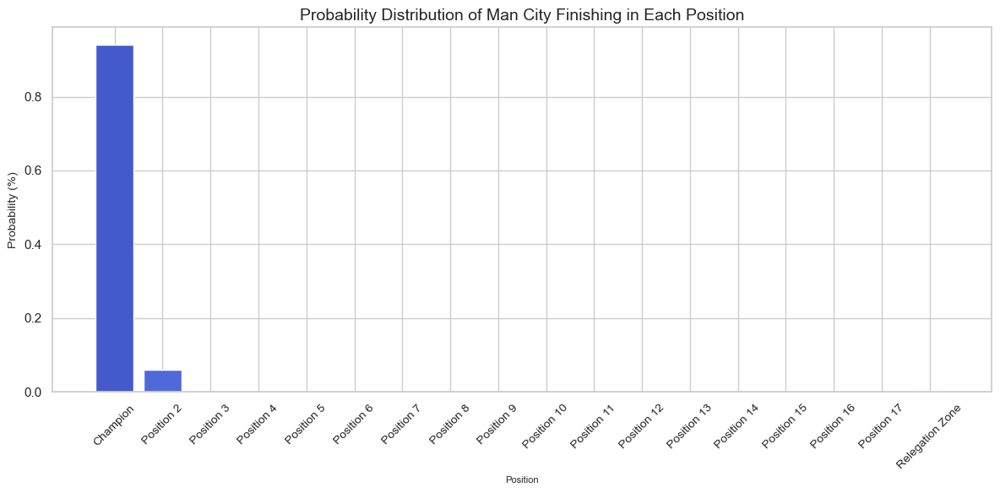

In [148]:
visualize_team_position_probabilities(league_table , 'Man City')

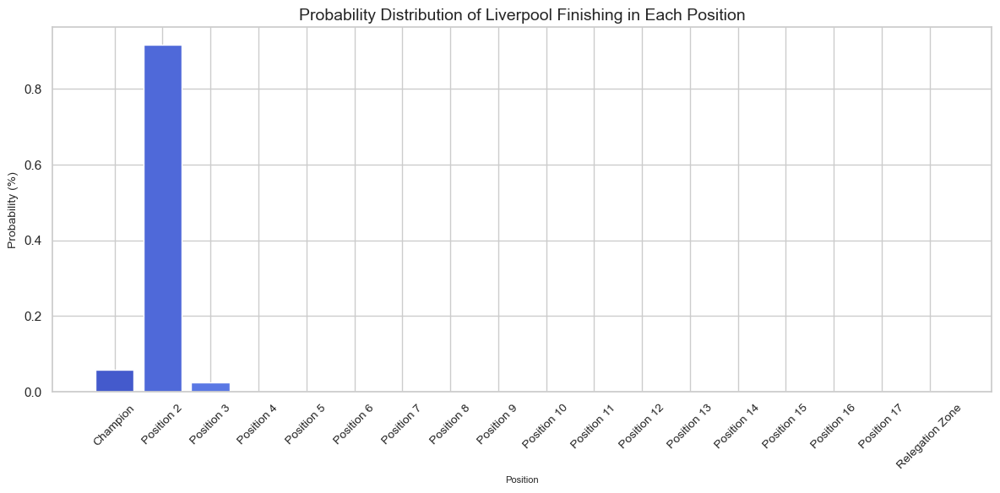

In [150]:
visualize_team_position_probabilities(league_table_home_adv, 'Liverpool')

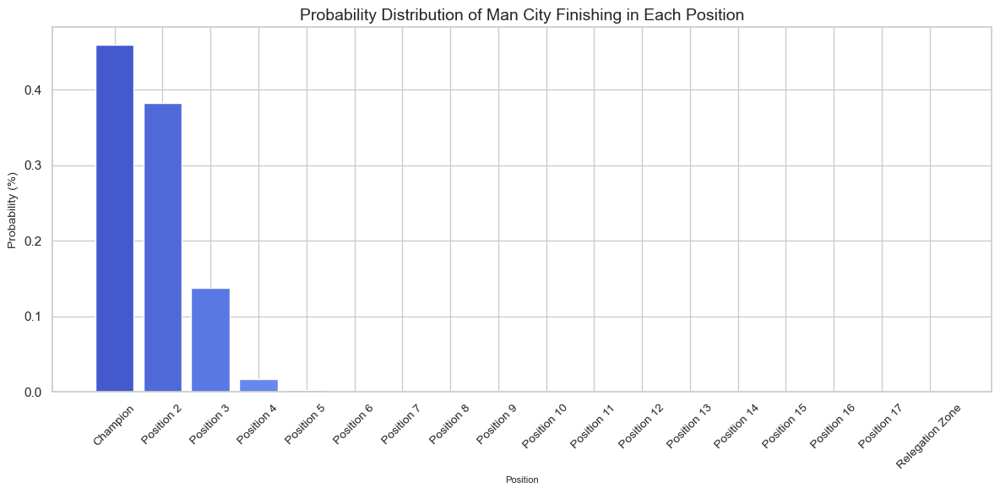

In [149]:
visualize_team_position_probabilities(league_table_time_dependent, 'Man City')



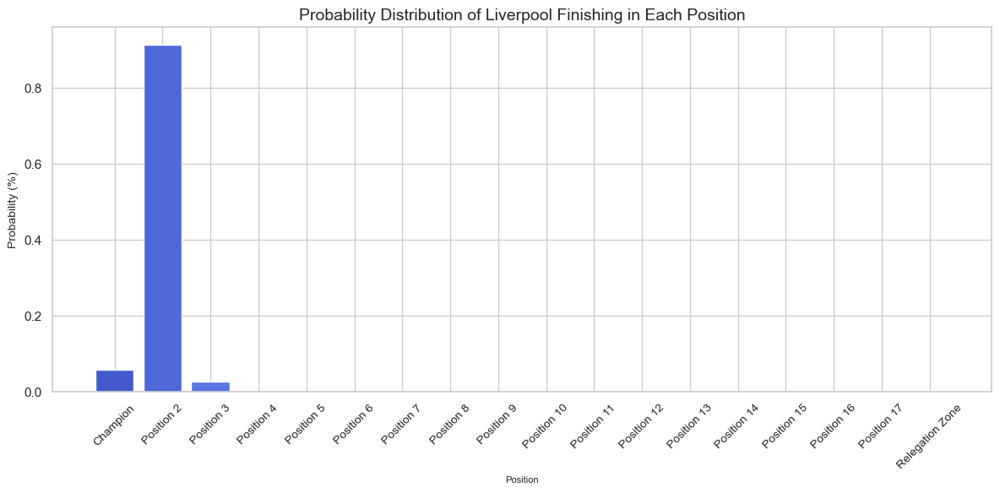

In [151]:
visualize_team_position_probabilities(league_table, 'Liverpool')

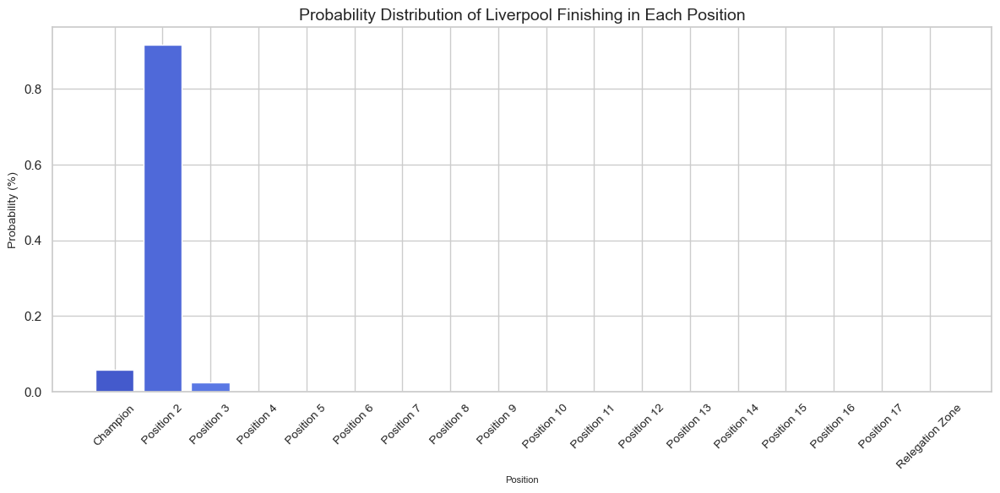

In [152]:
visualize_team_position_probabilities(league_table_home_adv, 'Liverpool')

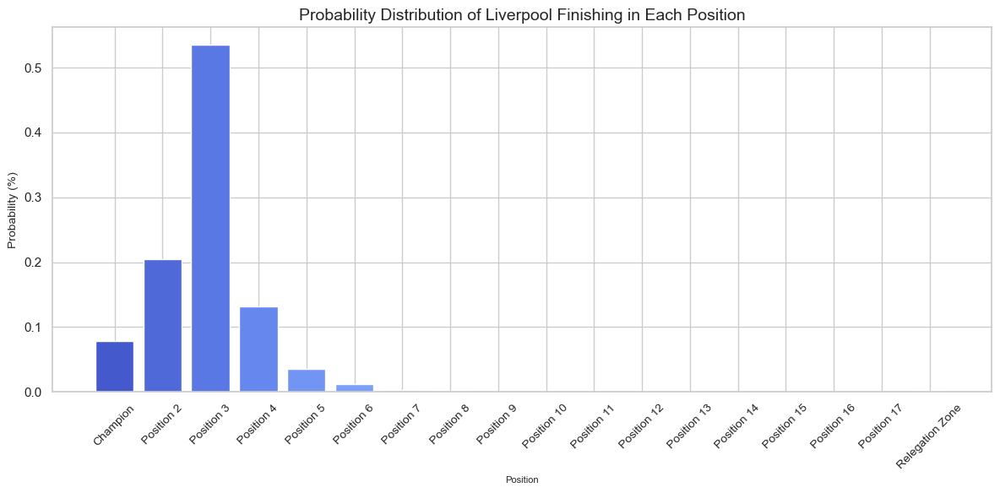

In [153]:
visualize_team_position_probabilities(league_table_time_dependent, 'Liverpool')